In [6]:
require(Seurat)
require(SeuratDisk)
require(tidyverse)
require(harmony)
require(RColorBrewer)
require(ComplexHeatmap)
require(pheatmap)
require(circlize)
require(SC2P)
require("mygene")

Loading required package: Seurat

Loading required package: SeuratDisk

Registered S3 method overwritten by 'cli':
  method     from    
  print.boxx spatstat

Registered S3 method overwritten by 'SeuratDisk':
  method            from  
  as.sparse.H5Group Seurat

Loading required package: tidyverse

── Attaching packages ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────── tidyverse 1.3.0 ──

✔ ggplot2 3.3.2     ✔ purrr   0.3.4
✔ tibble  3.0.4     ✔ dplyr   1.0.2
✔ tidyr   1.1.2     ✔ stringr 1.4.0
✔ readr   1.3.1     ✔ forcats 0.5.0

── Conflicts ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::collapse()   masks IRanges::collapse()
✖ dplyr::combine()    masks Biobase::combine(), BiocGenerics::combine()
✖ dplyr::desc()       masks IRanges::desc()
✖ ti

In [7]:
packageVersion("harmony")

[1] ‘1.0’

In [8]:
source("utils.R")

In [9]:
packageVersion("tidyverse")

[1] ‘1.3.0’

In [17]:
citation("tidyverse")


  Wickham et al., (2019). Welcome to the tidyverse. Journal of Open
  Source Software, 4(43), 1686, https://doi.org/10.21105/joss.01686

A BibTeX entry for LaTeX users is

  @Article{,
    title = {Welcome to the {tidyverse}},
    author = {Hadley Wickham and Mara Averick and Jennifer Bryan and Winston Chang and Lucy D'Agostino McGowan and Romain François and Garrett Grolemund and Alex Hayes and Lionel Henry and Jim Hester and Max Kuhn and Thomas Lin Pedersen and Evan Miller and Stephan Milton Bache and Kirill Müller and Jeroen Ooms and David Robinson and Dana Paige Seidel and Vitalie Spinu and Kohske Takahashi and Davis Vaughan and Claus Wilke and Kara Woo and Hiroaki Yutani},
    year = {2019},
    journal = {Journal of Open Source Software},
    volume = {4},
    number = {43},
    pages = {1686},
    doi = {10.21105/joss.01686},
  }


In [3]:
#load("12082020_image.RData")

In [6]:
#Convert("MERFISH_10192020_renamed.h5ad", dest = "h5seurat", overwrite = TRUE)

Warning message:
“Unknown file type: h5ad”
Warning message:
“'assay' not set, setting to 'RNA'”
Creating h5Seurat file for version 3.1.5.9900

Adding X as scale.data

Adding raw/X as data

Adding raw/X as counts

Adding meta.features from raw/var

Merging dispersions from scaled feature-level metadata



ERROR: Error in self$write_low_level(value, file_space = self_space_id, mem_space = mem_space_id, : Number of objects in robj is not the same and not a multiple of number of elements selected in file: expected are 249 but provided are 253


In [405]:
counts = readr::read_csv("MERFISH_10192020_renamed/X.csv",col_names = FALSE)
dim(counts)

Parsed with column specification:
cols(
  .default = col_double()
)

See spec(...) for full column specifications.



[1] 190541    253

In [76]:
counts[1:5,1:5]

X1,X2,X3,X4,X5
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
-0.3894457,0.6078538,1.167247,0.47767496,1.8227983
-0.3894457,-0.5490971,-0.557854,-1.17497240,-0.7304081
-0.3894457,-0.5490971,-0.557854,0.01286117,-0.7304081
-0.3894457,2.7947390,2.155495,-1.17497240,-0.7304081
-0.3894457,-0.5490971,-0.557854,0.80770300,-0.7304081


In [406]:
geneNames = readr::read_csv("MERFISH_10192020_renamed/var.csv")

Warning message:
“Missing column names filled in: 'X1' [1]”
Parsed with column specification:
cols(
  X1 = col_character(),
  highly_variable = col_logical(),
  means = col_double(),
  dispersions = col_double(),
  dispersions_norm = col_double(),
  mean = col_double(),
  std = col_double()
)



In [408]:
grep("Drd1",geneNames$X1,value = T)

[1] "Drd1a"

In [12]:
#geneNames$X1 = gsub("Drd1","Drd1a",geneNames$X1 )
#geneNames$X1  = gsub("Lamp5","6330527O06Rik",geneNames$X1 )
#geneNames$X1  = gsub("Kmt2d","Mll2",geneNames$X1 )
#geneNames$X1  = gsub("Brinp3","Fam5c",geneNames$X1 )
#head(geneNames)

X1,highly_variable,means,dispersions,dispersions_norm,mean,std
<chr>,<lgl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
3/1/2018,FALSE,0.009603797,-2.749378,-0.8512975,0.009312388,0.02391190
4930452B06Rik,FALSE,0.032296246,-2.190308,0.4319985,0.030683471,0.05587986
Adk,FALSE,0.041669700,-1.938815,-0.3776565,0.039099804,0.07008968
Adora1,FALSE,0.161816080,-1.941730,-0.7979466,0.153132772,0.13032882
Adora2a,TRUE,0.159635252,-1.038182,0.6166576,0.140031120,0.19171628
Adra1a,TRUE,0.029450945,-2.047155,0.7605942,0.027778814,0.05663621


In [409]:
meta = readr::read_csv("MERFISH_10192020_renamed/obs.csv")
head(meta)

Warning message:
“Missing column names filled in: 'X1' [1]”
Parsed with column specification:
cols(
  X1 = col_double(),
  sliceNumber = col_double(),
  datasetName = col_character(),
  clusterLabel = col_character(),
  StriatumCells = col_character(),
  cellType = col_character(),
  Batch = col_character(),
  leiden = col_double(),
  clus = col_character(),
  OldAnno = col_character(),
  NewAnno = col_character()
)



X1,sliceNumber,datasetName,clusterLabel,StriatumCells,cellType,Batch,leiden,clus,OldAnno,NewAnno
<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>
2.700421e+38,13,200704_D4,D2_0,Slice13_D,D2,D,7,others,None,"D2_0,2"
1.035516e+38,13,200313_C4,D1_3,Slice13_C,D1,C,3,others,None,D1_15
1.390721e+38,12,200701_D3,D1_14,Slice12_D,D1,D,3,others,None,D1_10
2.687361e+38,2,200315_C2,D1_12,Slice2_C,D1,C,6,others,D1_4,"D1_0,2"
8.164594e+37,8,200315_C2,oligodendrocytes,Slice8_C,oligodendrocytes,C,1,others,oligodendrocytes,oligodendrocytes
1.974379e+38,12,200309_C3,D1_3,Slice12_C,D1,C,5,others,D1_0,"D1_1,0"


In [25]:
table(meta$clusterLabel)


      astrocytes             D1_0             D1_1            D1_10 
           16947            10986             8290             4559 
           D1_11            D1_12            D1_13            D1_14 
            4392             4282             3665             3134 
           D1_15            D1_17             D1_2             D1_3 
            2784             1294             5580             7375 
            D1_4             D1_5             D1_6             D1_7 
            4884             5914             5255             4914 
            D1_8             D1_9             D2_0             D2_1 
            4935             4759             9053             7515 
           D2_10            D2_11             D2_2             D2_4 
            1477             1404             7365             3682 
            D2_5             D2_6             D2_7             D2_8 
            2666             2654             2329             2244 
            D2_9             IN_0

In [410]:
projections = readr::read_csv("MERFISH_10192020_renamed/obsm.csv")

Parsed with column specification:
cols(
  .default = col_double()
)

See spec(...) for full column specifications.



In [411]:
counts= t(data.matrix(counts))
dim(counts)

[1]    253 190541

In [9]:
dim(geneNames)

[1] 253   7

In [10]:
dim(meta)

[1] 190541     11

In [412]:
rownames(counts) =  geneNames$X1
colnames(counts) = meta$X1
counts[1:5,1:5]

,2.70042071063326e+38,1.03551627122072e+38,1.39072088797649e+38,2.68736140669033e+38,8.16459407573371e+37
3/1/2018,-0.3894457,-0.3894457,-0.38944575,-0.3894457,-0.3894457
4930452B06Rik,0.6078538,-0.5490971,-0.54909710,2.7947390,-0.5490971
Adk,1.1672473,-0.5578540,-0.55785400,2.1554947,-0.5578540
Adora1,0.4776750,-1.1749724,0.01286117,-1.1749724,0.8077030
Adora2a,1.8227983,-0.7304081,-0.73040810,-0.7304081,-0.7304081


In [413]:
meta = as.data.frame(meta,stringsAsFactors= FALSE)
rownames(meta) = meta$X1
meta$X1 = NULL

In [414]:
counts = expm1(counts)
counts[counts < 0] = 0

In [415]:
merFISH_sobj = CreateSeuratObject(counts = counts,
                                  meta.data = meta,
                                  project = "merFISH")

In [417]:
merFISH_sobj=  merFISH_sobj %>% NormalizeData() %>% FindVariableFeatures() %>% ScaleData() 

Centering and scaling data matrix



In [418]:
min(merFISH_sobj[['RNA']]@scale.data)

[1] -1.167631

In [60]:
merFISH_sobj =  merFISH_sobj %>% RunPCA()

PC_ 1 
Positive:  Arpp21, Scn4b, Rgs9, Ppp3ca, Ppp1r1b, Kcna4, Grm5, Meis2, Rgs4, Foxp1 
	   Camk4, Drd1aaa, Pcp4l1, Oprk1, Penk, Chrm1, Ncdn, Grin2a, Arpp19, Reln 
	   Kcnh1, Kcnb1, Kcnk2, Rxrg, 6330527O06Rik, Gabrg3, Grm1, Snap25, Cacna1i, Nefl 
Negative:  Ptn, Nfix, S100a16, Gnas, Mobp, Pea15a, Cldn11, Stmn1, Aldoc, Gja1 
	   Fabp5, Edil3, Mfge8, Tppp3, Tmeff2, Ncald, Pla2g7, Chd7, Marcksl1, Tcf7l2 
	   Pcdh9, Tmem176b, Cadm1, Cacng7, Fdft1, Grm3, Gstm7, Kcnk1, Csdc2, Serpine2 
PC_ 2 
Positive:  Vsnl1, Gng2, Cacna1g, Pde1a, Cpne7, Sphkap, Kcnc2, Gabra3, Hpcal1, Ralyl 
	   Fxyd6, Grin3a, Kcnh2, Oprl1, Gad1, Resp18, Hcn3, Cpne4, Kcnab3, Clstn2 
	   Nrip3, Otof, Lhx6, Elavl4, Isl1, Pcdh19, Ncald, Elfn1, Gpr149, Tacr1 
Negative:  Scn4b, Rgs4, Nrgn, Ppp3ca, Reln, Arpp19, Arpp21, Grm3, Foxp1, Ppp1r1b 
	   Adora2a, Ccnd2, Cnr1, Kcnk2, Kcna4, Ddit4l, Drd2, Calb1, Pcp4, Camk4 
	   Ptn, Serpine2, Aldoc, Rgs9, Spry2, Rxrg, Gja1, Mobp, Kcnk1, Fabp5 
PC_ 3 
Positive:  Mfge8, Gja1, Pla2g7, Aldoc,

In [419]:
pcs = readr::read_csv("MERFISH_10192020_renamed/obsm.csv")
colnames(pcs)

Parsed with column specification:
cols(
  .default = col_double()
)

See spec(...) for full column specifications.



[1] "X_pca1"          "X_pca2"          "X_pca3"          "X_pca4"         
  [5] "X_pca5"          "X_pca6"          "X_pca7"          "X_pca8"         
  [9] "X_pca9"          "X_pca10"         "X_pca11"         "X_pca12"        
 [13] "X_pca13"         "X_pca14"         "X_pca15"         "X_pca16"        
 [17] "X_pca17"         "X_pca18"         "X_pca19"         "X_pca20"        
 [21] "X_pca21"         "X_pca22"         "X_pca23"         "X_pca24"        
 [25] "X_pca25"         "X_pca26"         "X_pca27"         "X_pca28"        
 [29] "X_pca29"         "X_pca30"         "X_pca31"         "X_pca32"        
 [33] "X_pca33"         "X_pca34"         "X_pca35"         "X_pca36"        
 [37] "X_pca37"         "X_pca38"         "X_pca39"         "X_pca40"        
 [41] "X_pca41"         "X_pca42"         "X_pca43"         "X_pca44"        
 [45] "X_pca45"         "X_pca46"         "X_pca47"         "X_pca48"        
 [49] "X_pca49"         "X_pca50"         "X_pca_harmony1"  "X_pca_harmony2" 
 [53] "X_pca_harmony3"  "X_pca_harmony4"  "X_pca_harmony5"  "X_pca_harmony6" 
 [57] "X_pca_harmony7"  "X_pca_harmony8"  "X_pca_harmony9"  "X_pca_harmony10"
 [61] "X_pca_harmony11" "X_pca_harmony12" "X_pca_harmony13" "X_pca_harmony14"
 [65] "X_pca_harmony15" "X_pca_harmony16" "X_pca_harmony17" "X_pca_harmony18"
 [69] "X_pca_harmony19" "X_pca_harmony20" "X_pca_harmony21" "X_pca_harmony22"
 [73] "X_pca_harmony23" "X_pca_harmony24" "X_pca_harmony25" "X_pca_harmony26"
 [77] "X_pca_harmony27" "X_pca_harmony28" "X_pca_harmony29" "X_pca_harmony30"
 [81] "X_pca_harmony31" "X_pca_harmony32" "X_pca_harmony33" "X_pca_harmony34"
 [85] "X_pca_harmony35" "X_pca_harmony36" "X_pca_harmony37" "X_pca_harmony38"
 [89] "X_pca_harmony39" "X_pca_harmony40" "X_pca_harmony41" "X_pca_harmony42"
 [93] "X_pca_harmony43" "X_pca_harmony44" "X_pca_harmony45" "X_pca_harmony46"
 [97] "X_pca_harmony47" "X_pca_harmony48" "X_pca_harmony49" "X_pca_harmony50"
[101] "X_tsne1"         "X_tsne2"         "X_umap1"         "X_umap2"

In [420]:
pcs_harmony = pcs[,grep("harmony",colnames(pcs))]
head(pcs_harmony)

X_pca_harmony1,X_pca_harmony2,X_pca_harmony3,X_pca_harmony4,X_pca_harmony5,X_pca_harmony6,X_pca_harmony7,X_pca_harmony8,X_pca_harmony9,X_pca_harmony10,⋯,X_pca_harmony41,X_pca_harmony42,X_pca_harmony43,X_pca_harmony44,X_pca_harmony45,X_pca_harmony46,X_pca_harmony47,X_pca_harmony48,X_pca_harmony49,X_pca_harmony50
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
-3.216858,-0.83275056,-0.4782782,-0.2696694,-2.4197910,0.12952177,-0.5236422,0.4244319,-0.1537406,0.8212261,⋯,-0.4734787,-0.38651794,0.3304599,-0.16848211,0.67525697,-0.09118912,0.2432885,-0.26510078,0.3888813,-0.3586624
-2.122332,0.04764535,0.1061604,-0.3628911,0.8618257,-1.04907550,0.8960954,2.5477645,-0.0359222,0.2147592,⋯,0.4631657,0.18732733,-1.8796445,0.27106047,1.13816000,-0.43062120,0.5872732,-1.98874350,1.5512064,0.7486004
-2.246618,0.41596100,-0.0504462,-0.9421327,1.1375033,0.06889067,-0.1786741,0.3683181,0.3206210,1.4367032,⋯,0.3595561,-0.12557855,-0.3198977,-0.09745088,-0.07710719,0.52480716,0.2398672,-0.02966235,-0.7082370,-0.4803246
-2.042828,-0.77676870,-0.2903649,-0.8635982,2.7425058,1.77309510,-1.4511353,2.4681475,0.4193649,-0.4806273,⋯,-0.2104321,-0.08922152,1.4124107,0.56481510,0.80019280,0.32043160,0.6569977,0.79315764,-0.7143465,0.2578639
6.229431,-0.41790855,-4.8264880,-1.6865460,-0.7865908,-1.26202820,-1.2516540,-0.4049864,-0.7969255,-0.1849074,⋯,0.2741281,0.56501540,-0.8086844,0.18624787,0.94469434,0.46014777,0.1399280,0.22784033,0.5332912,-0.3597951
-3.023863,-0.32959148,-1.8014396,-0.6721718,0.3340692,-2.35812000,2.5952547,0.2741940,-0.8176996,-1.1858965,⋯,0.2356105,-0.25765392,-0.7067821,-0.75588630,-0.17235535,-0.37109607,-0.3520266,0.80229210,1.6486230,-1.5668508


In [421]:
hrmony_pca =  CreateDimReducObject(
    embeddings = data.matrix(pcs_harmony),
    key = "harmonyPC_",
    assay = "RNA",
    global = TRUE
  )

In [422]:
merFISH_sobj[['harmony']] = hrmony_pca

In [1105]:
dim(pcs_umap)

[1] 190541      2

In [430]:
pcs_umap = pcs[,grep("umap",colnames(pcs))]
rownames(pcs_umap) =  colnames(merFISH_sobj)
colnames(pcs_umap) = glue::glue("UMAP_{1:2}")
merFISH_umap =  CreateDimReducObject(
    embeddings = data.matrix(pcs_umap),
    key = "UMAP_",
    assay = "RNA",
    global = TRUE
  )
merFISH_sobj[['umap']] = merFISH_umap

Warning message:
“Setting row names on a tibble is deprecated.”


In [1103]:
merFISH_sobj

An object of class Seurat 
253 features across 190541 samples within 1 assay 
Active assay: RNA (253 features, 252 variable features)
 2 dimensional reductions calculated: harmony, umap

In [800]:
head(merFISH_sobj@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,sliceNumber,datasetName,clusterLabel,StriatumCells,cellType,Batch,leiden,clus,OldAnno,NewAnno
,<fct>,<dbl>,<int>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>
2.70042071063326e+38,merFISH,240.6989,93,13,200704_D4,D2_0,Slice13_D,D2,D,7,others,None,"D2_0,2"
1.03551627122072e+38,merFISH,222.3513,36,13,200313_C4,D1_3,Slice13_C,D1,C,3,others,None,D1_15
1.39072088797649e+38,merFISH,328.7685,87,12,200701_D3,D1_14,Slice12_D,D1,D,3,others,None,D1_10
2.68736140669033e+38,merFISH,562.5790,65,2,200315_C2,D1_12,Slice2_C,D1,C,6,others,D1_4,"D1_0,2"
8.16459407573371e+37,merFISH,512.3846,43,8,200315_C2,oligodendrocytes,Slice8_C,oligodendrocytes,C,1,others,oligodendrocytes,oligodendrocytes
1.97437949745504e+38,merFISH,320.1653,46,12,200309_C3,D1_3,Slice12_C,D1,C,5,others,D1_0,"D1_1,0"


In [1110]:
pcs_tsne = data.matrix(pcs[,grep("tsne",colnames(pcs))])
rownames(pcs_tsne) =  colnames(merFISH_sobj)
colnames(pcs_tsne) = glue::glue("tSNE_{1:2}")
merFISH_tsne =  CreateDimReducObject(
    embeddings = pcs_tsne,
    key = "tSNE_",
    assay = "RNA",
    global = TRUE
  )
merFISH_sobj[['tsne']] = merFISH_tsne

In [1112]:
str(merFISH_sobj[['tsne']])

Formal class 'DimReduc' [package "Seurat"] with 9 slots
  ..@ cell.embeddings           : num [1:190541, 1:2] 23558 522 39419 6497 18223 ...
  .. ..- attr(*, "dimnames")=List of 2
  .. .. ..$ : chr [1:190541] "2.70042071063326e+38" "1.03551627122072e+38" "1.39072088797649e+38" "2.68736140669033e+38" ...
  .. .. ..$ : 'glue' chr [1:2] "tSNE_1" "tSNE_2"
  ..@ feature.loadings          : num[0 , 0 ] 
  ..@ feature.loadings.projected: num[0 , 0 ] 
  ..@ assay.used                : chr "RNA"
  ..@ global                    : logi TRUE
  ..@ stdev                     : num(0) 
  ..@ key                       : chr "tSNE_"
  ..@ jackstraw                 :Formal class 'JackStrawData' [package "Seurat"] with 4 slots
  .. .. ..@ empirical.p.values     : num[0 , 0 ] 
  .. .. ..@ fake.reduction.scores  : num[0 , 0 ] 
  .. .. ..@ empirical.p.values.full: num[0 , 0 ] 
  .. .. ..@ overall.p.values       : num[0 , 0 ] 
  ..@ misc                      : list()


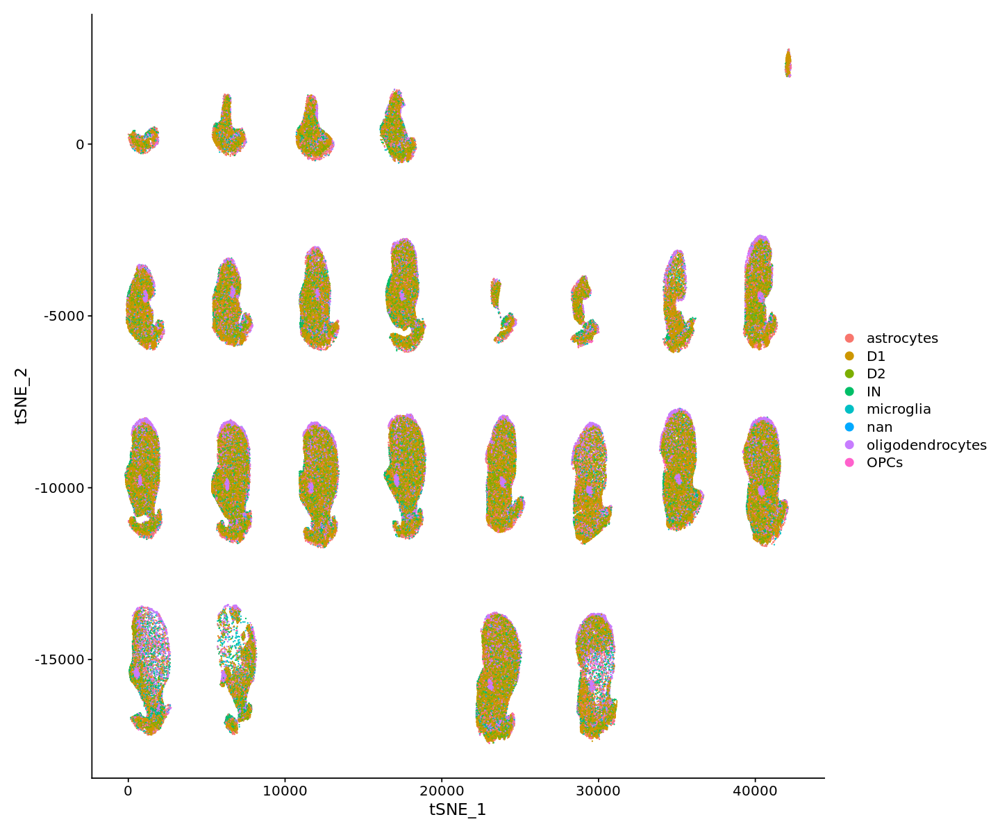

In [1109]:
options(repr.plot.height = 10, repr.plot.width = 12)
DimPlot(merFISH_sobj,reduction = "tsne", group.by="cellType")

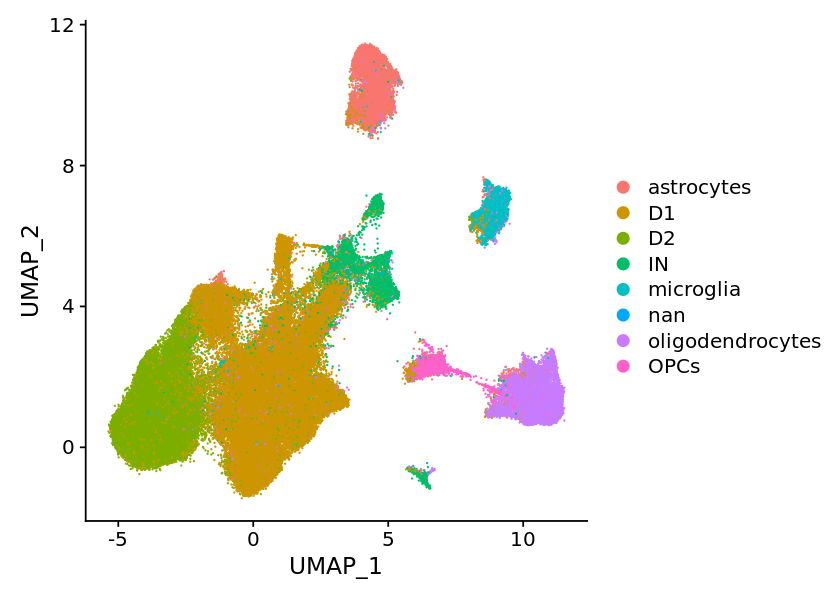

In [434]:
options(repr.plot.height = 5, repr.plot.width = 7)
DimPlot(merFISH_sobj,reduction = "umap", group.by="cellType")

In [11]:
merFISH_sobj = LoadH5Seurat("MERFISH_10192020.h5seurat")

Validating h5Seurat file

Initializing RNA with data

Adding counts for RNA

Adding scale.data for RNA

Adding feature-level metadata for RNA

Adding reduction pca

Adding cell embeddings for pca

Adding feature loadings for pca

Adding miscellaneous information for pca

Adding reduction pca_harmony

Adding cell embeddings for pca_harmony

Adding miscellaneous information for pca_harmony

Warning message:
“Cannot add objects with duplicate keys (offending key: PC_), setting key to 'pca_harmony_'”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from pca_harmony_ to pcaharmony_”
Adding reduction tsne

Adding cell embeddings for tsne

Adding miscellaneous information for tsne

Adding reduction umap

Adding cell embeddings for umap

Adding miscellaneous information for umap

Adding command information

Adding cell-level metadata

Adding miscellaneous information

Adding tool-specific results



In [12]:
load("../MERFISH/NAc_cells_all_filtered.RData")

In [13]:
NAc_cells_all_filtered = UpdateSeuratObject(NAc_cells_all_filtered)

Updating from v2.X to v3.X

Validating object structure

Updating object slots

Ensuring keys are in the proper strucutre

Ensuring feature names don't have underscores or pipes

Object representation is consistent with the most current Seurat version



In [22]:
head(NAc_cells_all_filtered@meta.data)

,orig.ident,percent.mito,Sample,tree.ident,CellType,L2_Clustering,L1_Clustering,nCount_RNA,nFeature_RNA
,<fct>,<dbl>,<fct>,<int>,<fct>,<fct>,<fct>,<dbl>,<int>
AAACCTGAGTGAACGC.NAc_Sample1,D2_2,0.03336185,NAc_Sample1,6,D2,D2_2,D2_2,4676,2065
AACCGCGTCAGCTCTC.NAc_Sample1,D2_2,0.02126563,NAc_Sample1,6,D2,D2_2,D2_2,7759,2721
ACACCCTAGCTGAACG.NAc_Sample1,D2_2,0.02026795,NAc_Sample1,6,D2,D2_2,D2_2,5822,2387
CCGTGGAAGCTACCGC.NAc_Sample1,D2_2,0.02747928,NAc_Sample1,6,D2,D2_2,D2_2,6514,2656
CCTCAGTTCTTCCTTC.NAc_Sample1,D2_2,0.01888489,NAc_Sample1,6,D2,D2_2,D2_2,7784,2768
CCTCTGAGTATATGAG.NAc_Sample1,D2_2,0.03979717,NAc_Sample1,6,D2,D2_2,D2_2,6508,2644


In [24]:
NAc_cells_all_filtered = SetSamplesLabels_metaData(NAc_cells_all_filtered)

In [25]:
table(NAc_cells_all_filtered@meta.data$Sample, paste0(NAc_cells_all_filtered@meta.data$treatment,"_",NAc_cells_all_filtered@meta.data$Period))

              
               Cocaine_Maintenance Cocaine_withdraw_15d Cocaine_withdraw_48h
  NAc_Sample1                 4636                    0                    0
  NAc_Sample10                   0                 6122                    0
  NAc_Sample11                   0                    0                    0
  NAc_Sample2                    0                    0                    0
  NAc_Sample3                    0                    0                    0
  NAc_Sample4                 2498                    0                    0
  NAc_Sample5                    0                    0                    0
  NAc_Sample6                    0                    0                 3414
  NAc_Sample7                    0                    0                    0
  NAc_Sample8                    0                    0                 5650
  NAc_Sample9                    0                 6016                    0
              
               Saline_Maintenance Saline_withd

In [28]:
NAc_cells_all_filtered@reductions$ica = NULL

In [37]:
class(NAc_cells_all_filtered@assays$RNA@counts)

[1] "dgCMatrix"
attr(,"package")
[1] "Matrix"

In [39]:
SaveH5Seurat(NAc_cells_all_filtered,filename = "NAc_cells_all_filtered.H5Seurat",overwrite = T)

Warning message:
“Overwriting previous file NAc_cells_all_filtered.H5Seurat”
Creating h5Seurat file for version 3.1.5.9900

Adding counts for RNA

Adding data for RNA

Adding scale.data for RNA

Adding variable features for RNA

No feature-level metadata found for RNA

Adding cell embeddings for pca

Adding loadings for pca

No projected loadings for pca

Adding standard deviations for pca

No JackStraw data for pca

Adding cell embeddings for tsne

No loadings for tsne

No projected loadings for tsne

No standard deviations for tsne

No JackStraw data for tsne



In [40]:
SeuratDisk::Convert(source = "NAc_cells_all_filtered.H5Seurat",dest = "NAc_cells_all_filtered.h5ad",overwrite = T)

Validating h5Seurat file

Adding scale.data from RNA as X

Adding data from RNA as raw



ERROR: Error in assay.group$obj_copy_to(dst_loc = dfile[["raw"]], dst_name = "X", : HDF5-API Errors:
    error #000: H5Ocopy.c in H5Ocopy(): line 233: unable to copy object
        class: HDF5
        major: Object header
        minor: Unable to copy object

    error #001: H5Ocopy.c in H5O__copy(): line 317: unable to copy object
        class: HDF5
        major: Object header
        minor: Unable to copy object

    error #002: H5Ocopy.c in H5O__copy_obj(): line 1221: unable to copy object
        class: HDF5
        major: Object header
        minor: Unable to copy object

    error #003: H5Ocopy.c in H5O__copy_header(): line 1165: unable to copy object
        class: HDF5
        major: Object header
        minor: Unable to copy object

    error #004: H5Ocopy.c in H5O__copy_header_real(): line 872: unable to perform 'post copy' operation on message
        class: HDF5
        major: Object header
        minor: Unable to initialize object

    error #005: H5Ostab.c in H5O__stab_post_copy_file(): line 398: iteration operator failed
        class: HDF5
      


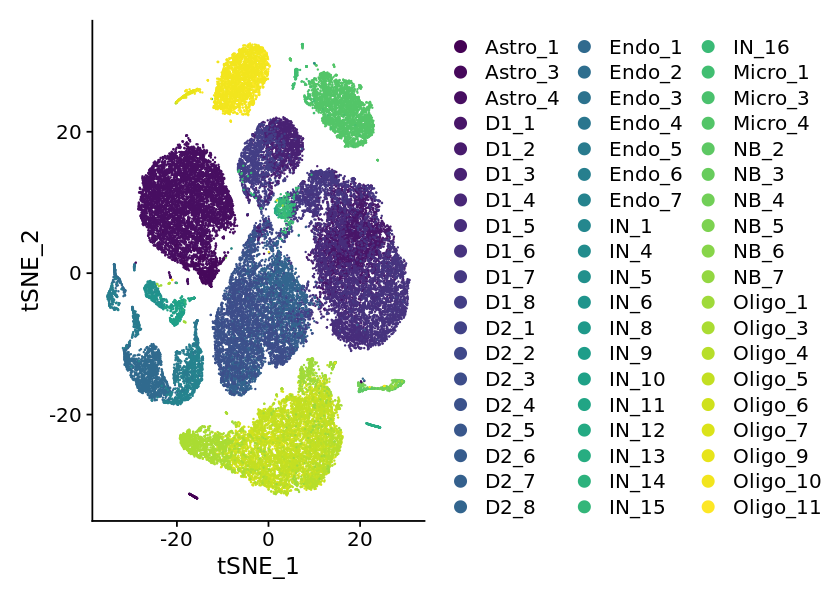

In [426]:
options(repr.plot.height = 5, repr.plot.width = 7)
DimPlot(NAc_cells_all_filtered,reduction = "tsne")

In [7]:
merFISH_sobj

An object of class Seurat 
253 features across 190541 samples within 1 assay 
Active assay: RNA (253 features, 0 variable features)
 4 dimensional reductions calculated: pca, pca_harmony, tsne, umap

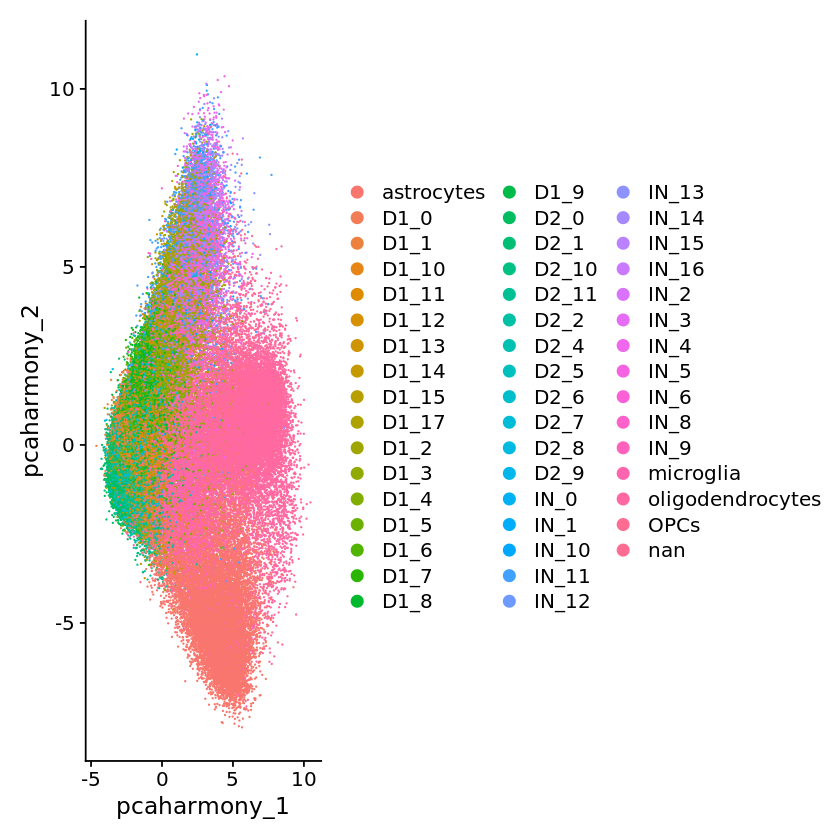

In [8]:
DimPlot(merFISH_sobj, reduction = "pca_harmony",group.by = "clusterLabel")

In [334]:
Idents(merFISH_sobj) = merFISH_sobj@meta.data$clusterLabel

ERROR: Error in eval(expr, envir, enclos): object 'merFISH_sobj' not found


In [24]:
#merFISH_sobj <- merFISH_sobj %>% FindVariableFeatures()

Warning message in eval(predvars, data, env):
“NaNs produced”
Warning message in hvf.info$variance.expected[not.const] <- 10^fit$fitted:
“number of items to replace is not a multiple of replacement length”


In [26]:
merFISH_sobj

An object of class Seurat 
253 features across 190541 samples within 1 assay 
Active assay: RNA (253 features, 252 variable features)
 1 dimensional reduction calculated: harmony

In [31]:
setdiff(rownames(merFISH_sobj), rownames(NAc_cells_all_filtered))

[1] "3/1/2018"

In [32]:
NAc_cells_all_filtered2 = NAc_cells_all_filtered[rownames(merFISH_sobj),]
NAc_cells_all_filtered2

An object of class Seurat 
252 features across 47576 samples within 1 assay 
Active assay: RNA (252 features, 132 variable features)
 3 dimensional reductions calculated: pca, ica, tsne

In [33]:
merFISH_sobj2 = merFISH_sobj[rownames(NAc_cells_all_filtered2),]

In [403]:
min(merFISH_sobj2[['RNA']]@counts)

[1] 0

In [36]:
assay_ = CreateAssayObject(data = merFISH_sobj@assays$RNA@data[rownames(NAc_cells_all_filtered2),],min.cells = 0,min.features = 0)

In [37]:
assay_

Assay data with 252 features for 190541 cells
First 10 features:
 4930452B06Rik, Adk, Adora1, Adora2a, Adra1a, Adrb2, Afap1, Arhgap36,
Bhlhe41, Fam5c 

In [38]:
all(rownames(NAc_cells_all_filtered2) == rownames(merFISH_sobj2))

[1] TRUE

In [ ]:
NAc_cells_all_filtered2[['merFISH']] = merFISH_sobj2[['RNA']]

In [42]:
NAc_cells_all_filtered2@meta.data$Source= 'scRNASeq'
merFISH_sobj2@meta.data$Source = "merFISH"

In [61]:
NAc_cells_all_filtered2

ERROR: Error in eval(expr, envir, enclos): object 'NAc_cells_all_filtered2' not found


In [ ]:
bm <- FindMultiModalNeighbors(
  bm, reduction.list = list("pca", "apca"), 
  dims.list = list(1:30, 1:18), modality.weight.name = "RNA.weight"
)

In [488]:
require(harmony)

In [44]:
unintegrated = merge(NAc_cells_all_filtered2,merFISH_sobj2) %>%
    NormalizeData(verbose = FALSE) %>%
    FindVariableFeatures(selection.method = "vst", nfeatures = 2000) %>% 
    ScaleData(verbose = FALSE) %>% 
    RunPCA(pc.genes = merFISH_sobj2@var.genes, npcs = 20, verbose = FALSE)

In [50]:
unintegrated

An object of class Seurat 
252 features across 238117 samples within 1 assay 
Active assay: RNA (252 features, 252 variable features)
 1 dimensional reduction calculated: pca

In [3]:
require(cowplot)

Loading required package: cowplot



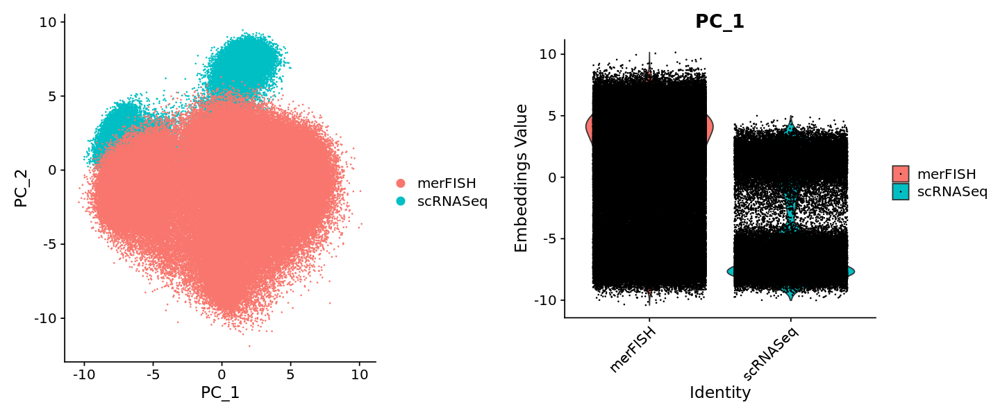

In [49]:
options(repr.plot.height = 5, repr.plot.width = 12)
p1 <- DimPlot(object = unintegrated, reduction = "pca", pt.size = .1, group.by = "Source")
p2 <- VlnPlot(object = unintegrated, features = "PC_1", group.by = "Source", pt.size = .1)
plot_grid(p1,p2)

Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 11905850)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 11905850)”
Warning message:
“did not converge in 25 iterations”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 11905850)”
Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony converged after 3 iterations

Warning message:
“Invalid name supplied, making object name syntactically valid. New object name is Seurat..ProjectDim.RNA.harmony; see ?make.names for more details on syntax validity”


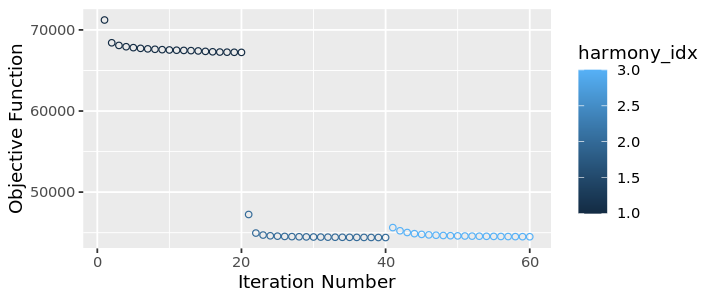

In [51]:
options(repr.plot.height = 2.5, repr.plot.width = 6)
hm.integrated <- RunHarmony(
  object = unintegrated,
  group.by.vars = 'Source',
    plot_convergence = TRUE
)

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
14:10:20 UMAP embedding parameters a = 0.9922 b = 1.112

14:10:21 Read 238117 rows and found 20 numeric columns

14:10:21 Using Annoy for neighbor search, n_neighbors = 30

14:10:21 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

14:11:11 Writing NN index file to temp file /tmp/Rtmph5F6nQ/file9a93325daaa

14:11:11 Searching Annoy index using 1 thread, search_k = 3000

14:14:37 Annoy recall = 100%

14:14:37 Commencing smooth kNN distance calibration using 1 thread

14:15:06 Initializing fr

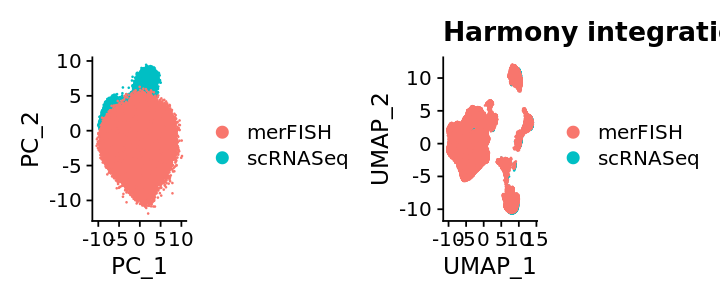

In [53]:
# re-compute the UMAP using corrected LSI embeddings
hm.integrated <- RunUMAP(hm.integrated, dims = 1:20, reduction = 'harmony')

In [59]:
head(hm.integrated@meta.data)

,orig.ident,percent.mito,Sample,tree.ident,CellType,L2_Clustering,L1_Clustering,nCount_RNA,nFeature_RNA,Source,sliceNumber,datasetName,clusterLabel,StriatumCells,cellType,Batch,leiden,clus,OldAnno,NewAnno
,<chr>,<dbl>,<chr>,<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>
AAACCTGAGTGAACGC.NAc_Sample1,D2_2,0.03336185,NAc_Sample1,6,D2,D2_2,D2_2,177,55,scRNASeq,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
AACCGCGTCAGCTCTC.NAc_Sample1,D2_2,0.02126563,NAc_Sample1,6,D2,D2_2,D2_2,267,54,scRNASeq,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
ACACCCTAGCTGAACG.NAc_Sample1,D2_2,0.02026795,NAc_Sample1,6,D2,D2_2,D2_2,180,65,scRNASeq,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
CCGTGGAAGCTACCGC.NAc_Sample1,D2_2,0.02747928,NAc_Sample1,6,D2,D2_2,D2_2,212,54,scRNASeq,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
CCTCAGTTCTTCCTTC.NAc_Sample1,D2_2,0.01888489,NAc_Sample1,6,D2,D2_2,D2_2,323,61,scRNASeq,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
CCTCTGAGTATATGAG.NAc_Sample1,D2_2,0.03979717,NAc_Sample1,6,D2,D2_2,D2_2,226,67,scRNASeq,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA


In [60]:
pos <- is.na(hm.integrated@meta.data$CellType)
hm.integrated@meta.data$CellType[pos] = hm.integrated@meta.data$cellType[pos]

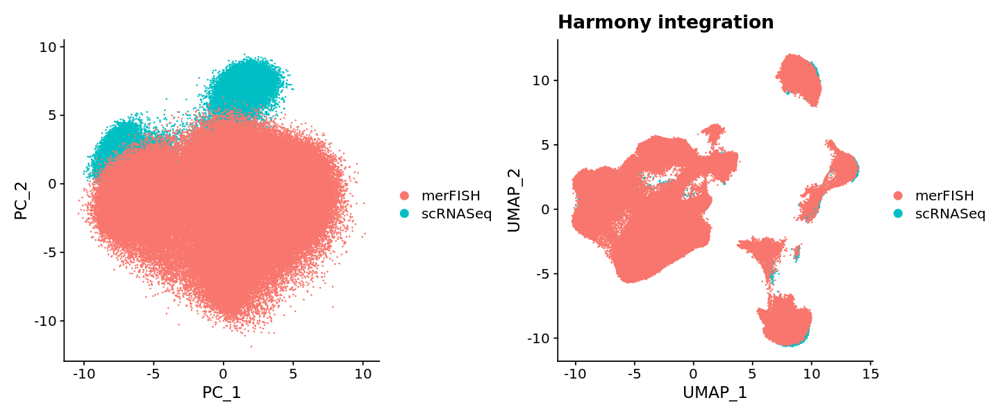

In [64]:
options(repr.plot.height = 5, repr.plot.width = 12)
p5 <- DimPlot(hm.integrated, group.by = 'Source', pt.size = 0.1) + ggplot2::ggtitle("Harmony integration")
p1 + p5

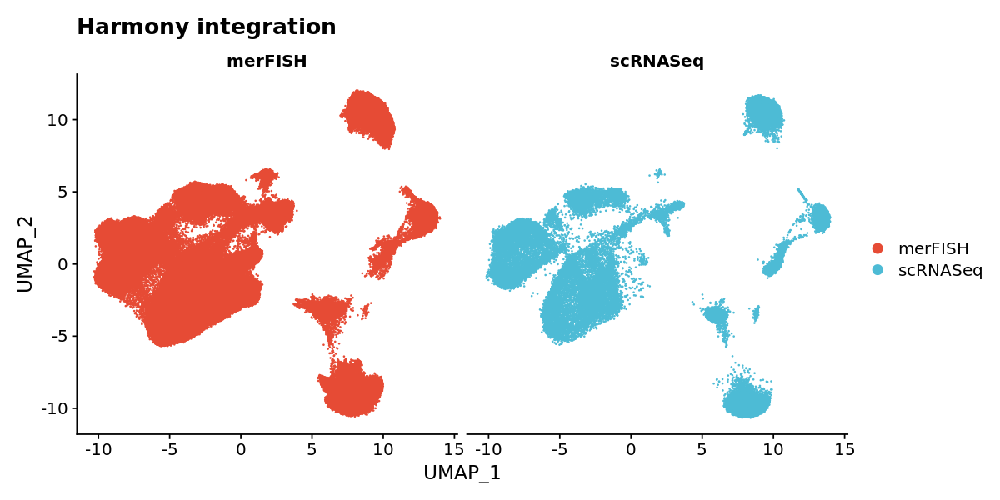

In [78]:
options(repr.plot.height = 5, repr.plot.width = 10)
p7 <- DimPlot(hm.integrated, group.by = 'Source',split.by = "Source", pt.size = 0.1,cols = ggsci::pal_npg()(10)) + ggplot2::ggtitle("Harmony integration")
p7

In [72]:
hm.integrated = subset(hm.integrated, CellType != "nan")

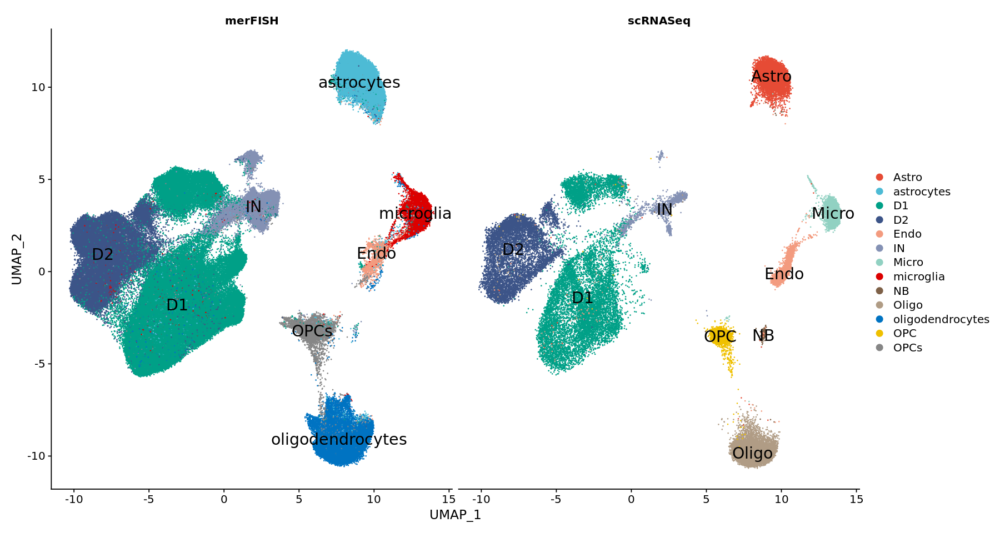

In [435]:
options(repr.plot.height = 8, repr.plot.width = 15)
p6 <- DimPlot(hm.integrated, group.by = 'CellType',split.by = "Source", pt.size = 0.1,cols = c(ggsci::pal_npg()(10), ggsci::pal_jco()(10)),label = TRUE,label.size = 6)
p6

## Find Endothelial cells.

In [436]:
merFISH_endo = subset(hm.integrated, Source=="merFISH")
merFISH_endo

An object of class Seurat 
252 features across 2119 samples within 1 assay 
Active assay: RNA (252 features, 252 variable features)
 3 dimensional reductions calculated: pca, harmony, umap

In [439]:
merFISH_sobj2 = merFISH_sobj
merFISH_sobj2@meta.data[colnames(merFISH_endo),]$cellType = "Endo"

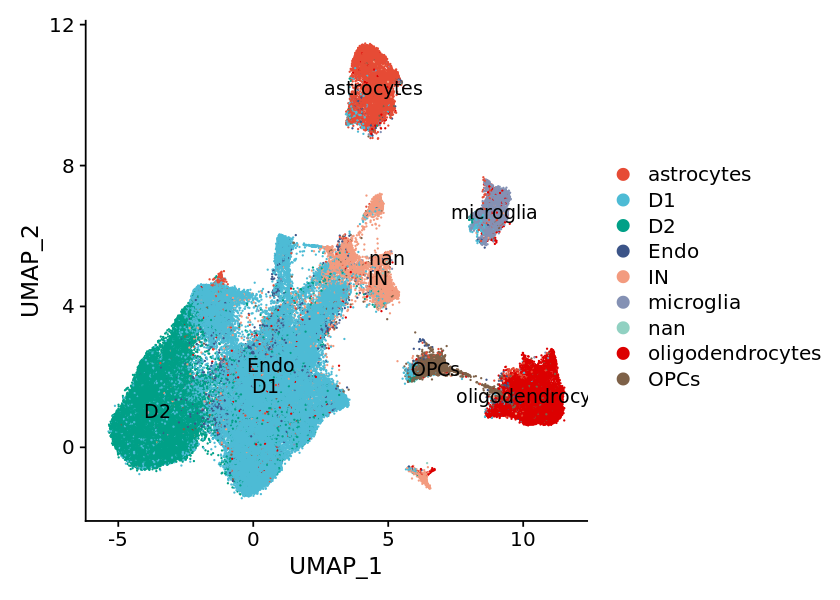

In [441]:
options(repr.plot.height = 5, repr.plot.width = 7)
DimPlot(merFISH_sobj2,reduction = "umap", group.by="cellType", cols= c(ggsci::pal_npg()(10), ggsci::pal_jco()(10)), label=TRUE)

In [71]:
table(hm.integrated@meta.data$Sample)


 NAc_Sample1 NAc_Sample10 NAc_Sample11  NAc_Sample2  NAc_Sample3  NAc_Sample4 
        4636         6122         6434         4269         2068         2498 
 NAc_Sample5  NAc_Sample6  NAc_Sample7  NAc_Sample8  NAc_Sample9 
        2882         3414         3587         5650         6016 

In [77]:
hm.integrated <- FindNeighbors(object = hm.integrated, reduction = 'harmony', dims = 1:20)
hm.integrated <- FindClusters(object = hm.integrated, verbose = FALSE, algorithm = 3)

Computing nearest neighbor graph

Computing SNN



In [75]:
head(Idents(hm.integrated))

AAACCTGAGTGAACGC.NAc_Sample1 AACCGCGTCAGCTCTC.NAc_Sample1 
                        D2_2                         D2_2 
ACACCCTAGCTGAACG.NAc_Sample1 CCGTGGAAGCTACCGC.NAc_Sample1 
                        D2_2                         D2_2 
CCTCAGTTCTTCCTTC.NAc_Sample1 CCTCTGAGTATATGAG.NAc_Sample1 
                        D2_2                         D2_2 
77 Levels: Astro_1 Astro_3 Astro_4 astrocytes D1_0 D1_1 D1_10 D1_11 ... OPCs

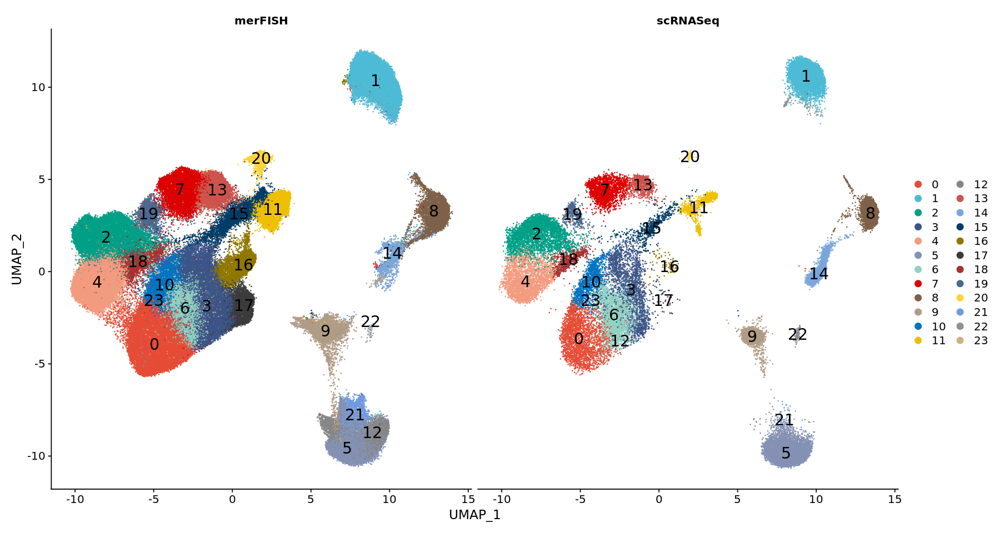

In [72]:
DimPlot(hm.integrated, split.by = "Source", pt.size = 0.1,cols = c(ggsci::pal_npg()(10), ggsci::pal_jco()(10), ggsci::pal_simpsons()(10)),label = TRUE,label.size = 6)

In [243]:
pdf("Interegrated_merFISH_scRNASeq_global_UMAP.pdf",width = 15,height = 8)
print(p6)
dev.off()

png 
  2

In [69]:
load("batchC_sobj.RData")

In [70]:
head(batchC_sobj@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,sliceNumber,datasetName,clusterLabel,Striatum,CellTypes,NewAnno
,<fct>,<dbl>,<int>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>
1.00007234251809e+38,merFISH_bathC,29.78353,119,7,200302_C1,D1_2,Slice7,D1,D1_10
1.000141209037e+38,merFISH_bathC,27.86266,119,4,200302_C1,D1_3,Slice4,D1,D1_9
1.00030246073117e+38,merFISH_bathC,28.56512,88,7,200302_C1,D1_8,Slice7,D1,D1_8
1.00050010440598e+38,merFISH_bathC,22.96811,40,7,200302_C1,D1_0,Slice7,D1,D1_1
1.00065337861754e+38,merFISH_bathC,29.10968,125,4,200302_C1,D1_13,Slice4,D1,D2_2
1.00074022101017e+38,merFISH_bathC,29.08969,93,7,200302_C1,D1_4,Slice7,D1,D1_9


In [79]:
table(batchC_sobj@meta.data[pos,]$CellTypes)


    Astrocytes             D1             D2    Endothelial      Ependymal 
          7486          42953          21093            429            102 
     Microglia Oligodenrocyte            OPC 
          3147           6097           2663 

In [84]:
pos <- match(colnames(batchC_sobj),colnames(hm.integrated))
hm.integrated@

[1] 150931 190355 183720 195652  61948 165268

In [71]:
pos = intersect(colnames(hm.integrated), colnames(batchC_sobj))
hm.integrated@meta.data$batchCInfo = "None"
hm.integrated@meta.data[pos,]$batchCInfo = batchC_sobj@meta.data[pos,]$CellTypes

In [72]:
table(hm.integrated@meta.data$batchCInfo, Idents(hm.integrated))

                
                 Astro_1 Astro_3 Astro_4 astrocytes  D1_0  D1_1 D1_10 D1_11
  Astrocytes           0       0       0       7204    12     0     4    49
  D1                   0       0       0        118  5403  4031  2076  2361
  D2                   0       0       0          4    44   122   209     7
  Endothelial          0       0       0        249     6     5     1     9
  Ependymal            0       0       0         77     0     0     5     0
  Microglia            0       0       0         21    11     5     0     1
  None               105     495    6937       9212  5504  5894  2263  1963
  Oligodenrocyte       0       0       0         45     0     0     0     0
  OPC                  0       0       0         17     6     4     1     2
                
                 D1_12 D1_13 D1_14 D1_15 D1_17  D1_2  D1_3  D1_4  D1_5  D1_6
  Astrocytes        17     5    33     2     4     5    21     0     4     0
  D1              2084  1751  1302   724   653  2734

In [80]:
x = Seurat::WhichCells(hm.integrated,idents = "14")
head(x)

[1] "CCTTTCTCACCGAAAG.NAc_Sample1"  "TAAGTGCTCCTGCTTG.NAc_Sample10"
[3] "CTCGGGAAGCCCAGCT.NAc_Sample10" "TATCTCATCACAAACC.NAc_Sample11"
[5] "AGCGTATCATGTCCTC.NAc_Sample1"  "AGCGTCGAGACTTTCG.NAc_Sample1"

In [81]:
x = Seurat::WhichCells(hm.integrated,idents = "14")
head(x)

[1] "CCTTTCTCACCGAAAG.NAc_Sample1"  "TAAGTGCTCCTGCTTG.NAc_Sample10"
[3] "CTCGGGAAGCCCAGCT.NAc_Sample10" "TATCTCATCACAAACC.NAc_Sample11"
[5] "AGCGTATCATGTCCTC.NAc_Sample1"  "AGCGTCGAGACTTTCG.NAc_Sample1"

In [90]:
hm.integrated@meta.data[x,]$CellType = "Endo"

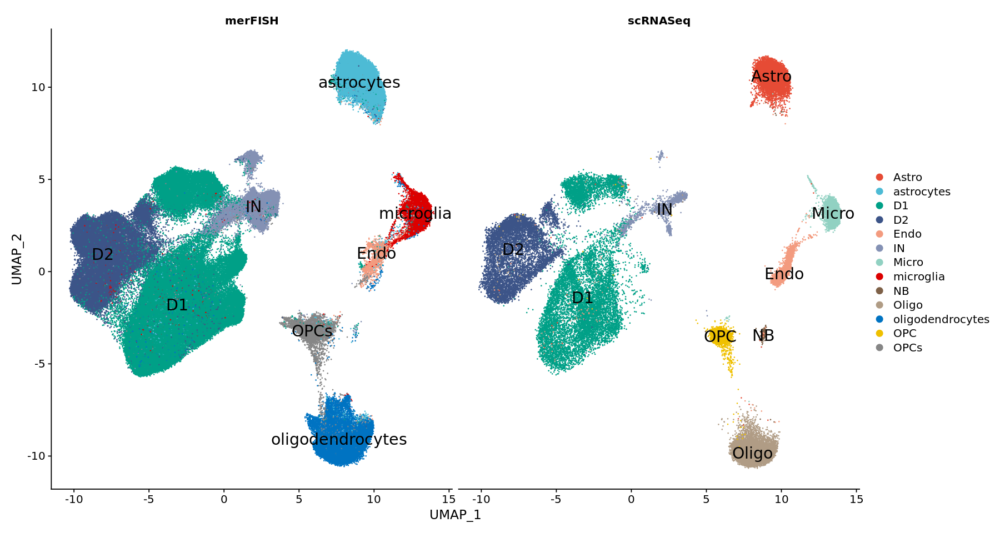

In [83]:
options(repr.plot.height = 8, repr.plot.width = 15)
p6 <- DimPlot(hm.integrated, group.by = 'CellType',split.by = "Source", pt.size = 0.1,cols = c(ggsci::pal_npg()(10), ggsci::pal_jco()(10)),label = TRUE,label.size = 6)
p6

In [79]:
save(hm.integrated, file="hm.integrated.RData")

In [3]:
load("hm.integrated.RData")

In [4]:
head(hm.integrated@meta.data)

,orig.ident,percent.mito,Sample,tree.ident,CellType,L2_Clustering,L1_Clustering,nCount_RNA,nFeature_RNA,Source,sliceNumber,datasetName,clusterLabel,StriatumCells,cellType,Batch,leiden,clus,OldAnno,NewAnno
,<chr>,<dbl>,<chr>,<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>
AAACCTGAGTGAACGC.NAc_Sample1,D2_2,0.03336185,NAc_Sample1,6,D2,D2_2,D2_2,177,55,scRNASeq,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
AACCGCGTCAGCTCTC.NAc_Sample1,D2_2,0.02126563,NAc_Sample1,6,D2,D2_2,D2_2,267,54,scRNASeq,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
ACACCCTAGCTGAACG.NAc_Sample1,D2_2,0.02026795,NAc_Sample1,6,D2,D2_2,D2_2,180,65,scRNASeq,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
CCGTGGAAGCTACCGC.NAc_Sample1,D2_2,0.02747928,NAc_Sample1,6,D2,D2_2,D2_2,212,54,scRNASeq,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
CCTCAGTTCTTCCTTC.NAc_Sample1,D2_2,0.01888489,NAc_Sample1,6,D2,D2_2,D2_2,323,61,scRNASeq,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
CCTCTGAGTATATGAG.NAc_Sample1,D2_2,0.03979717,NAc_Sample1,6,D2,D2_2,D2_2,226,67,scRNASeq,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA


In [337]:
table(hm.integrated@meta.data$CellType,hm.integrated@meta.data$Source)

                  
                   merFISH scRNASeq
  Astro                  0     7535
  astrocytes         16782        0
  D1                 85934    12342
  D2                 42064     7687
  Endo                2119     3540
  IN                 12221     1330
  Micro                  0     3208
  microglia           7044        0
  NB                     0      483
  Oligo                  0     8420
  oligodendrocytes   18448        0
  OPC                    0     3031
  OPCs                5878        0

ERROR: Error in eval(expr, envir, enclos): object 'merFISH_sobj' not found


## Get merFISH markers

In [123]:
merFISH_sobj2 = subset(hm.integrated,Source=="merFISH")
merFISH_sobj2

An object of class Seurat 
252 features across 190490 samples within 1 assay 
Active assay: RNA (252 features, 252 variable features)
 3 dimensional reductions calculated: pca, harmony, umap

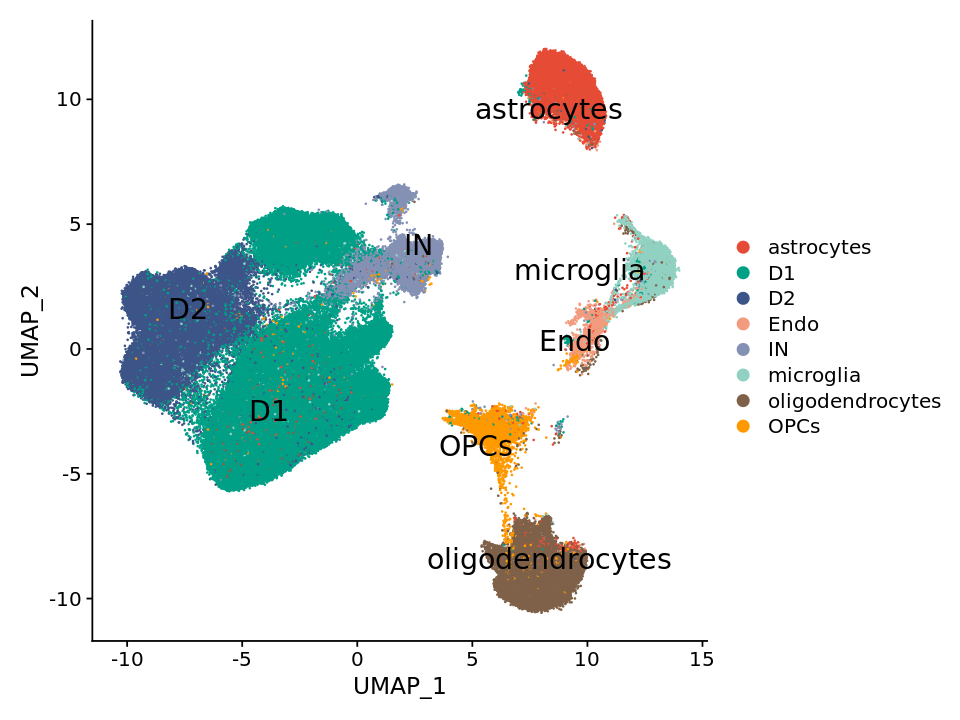

In [124]:
options(repr.plot.height = 6, repr.plot.width = 8)
p1= DimPlot(merFISH_sobj2, group.by = 'CellType', pt.size = 0.1,
            cols =  c(ggsci::pal_npg()(10)[-c(2,8,10)], ggsci::pal_ucscgb()(7)[-1] ),
            label = TRUE,
            repel = TRUE,
            label.size = 6)
#pdf("UMAP_merFISH_withEndo_WithLabels.pdf",width = 8, height = 6)
#print(p1)
#dev.off()
p1

png 
  2

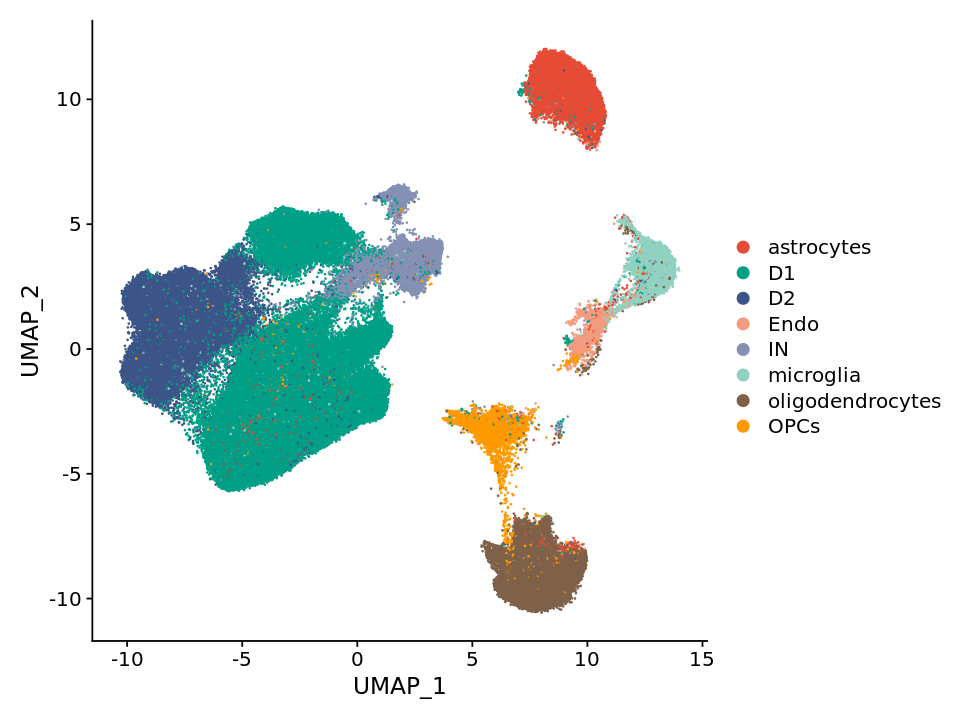

In [456]:
options(repr.plot.height = 6, repr.plot.width = 8)
p2= DimPlot(merFISH_sobj2, group.by = 'CellType', pt.size = 0.1,
             cols =  c(ggsci::pal_npg()(10)[-c(2,8,10)], ggsci::pal_ucscgb()(7)[-1] ),
            label = FALSE,label.size = 6)
pdf("UMAP_merFISH_withEndo_NOLabels.pdf",width = 8, height = 6)
print(p2)
dev.off()
p2

In [125]:
save(merFISH_sobj2, file="merFISH_sobj2.RData")

In [126]:
getwd()

[1] "/nfs2/nadhir/Projects/scRNA_renchao_drug_NAc/MERFISH_combined"

png 
  2

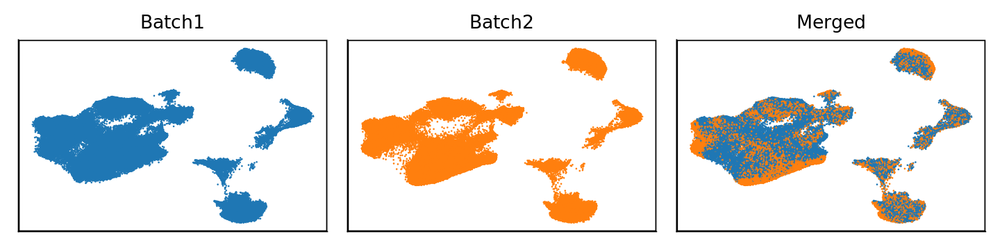

In [608]:
options(repr.plot.height = 3, repr.plot.width = 12)
p_g1= DimPlot(merFISH_sobj2[,merFISH_sobj2$Batch=="C"], group.by = 'Batch',pt.size = 0.1,
             cols =  ggsci::pal_d3()(10)[1],
            label = FALSE,label.size = 6) + 
            cowplot::panel_border(color = "black") + 
             theme(plot.title = element_text(hjust = 0.5,face = "plain"),
                   axis.title=element_blank(),
                   axis.text=element_blank(),
                   axis.ticks=element_blank(), legend.position = "none") + ggtitle("Batch1")

p_g2= DimPlot(merFISH_sobj2[,merFISH_sobj2$Batch=="D"], group.by = 'Batch',pt.size = 0.1,
             cols =  ggsci::pal_d3()(10)[2],
            label = FALSE,label.size = 6) + 
            cowplot::panel_border(color = "black") + 
             theme(plot.title = element_text(hjust = 0.5,face = "plain"),
                   axis.title=element_blank(),
                   axis.text=element_blank(),
                   axis.ticks=element_blank(),legend.position = "none") + ggtitle("Batch2")

p_g3= DimPlot(merFISH_sobj2, group.by = 'Batch',  pt.size = 0.1,
             cols =  ggsci::pal_d3()(10),
            label = FALSE,label.size = 6) +
            cowplot::panel_border(color = "black") + 
             theme(plot.title = element_text(hjust = 0.5,face = "plain"),
                   axis.title=element_blank(),
                   axis.text=element_blank(),
                   axis.ticks=element_blank(),legend.position = "none") + ggtitle("Merged")
pdf("FigS3G_updated.pdf",width = 12, height = 3)
print(p_g1 + p_g2 + p_g3)
dev.off()
p_g1 + p_g2 + p_g3

In [478]:
tbl = as.matrix(table(merFISH.hm@meta.data$CellType, merFISH.hm@meta.data$Batch))
tbl_norm = apply(tbl,1,function(x) x/sum(x))
tbl_norm_mrg = reshape2::melt(tbl_norm)
tbl_norm_mrg$value = 100 * tbl_norm_mrg$value               
colnames(tbl_norm_mrg)= c("Batch","CellType","Percentage")      
head(tbl_norm_mrg)            

,Batch,CellType,Percentage
,<fct>,<fct>,<dbl>
1,C,astrocytes,55.82171
2,D,astrocytes,44.17829
3,C,D1,56.25364
4,D,D1,43.74636
5,C,D2,56.09310
6,D,D2,43.90690


png 
  2

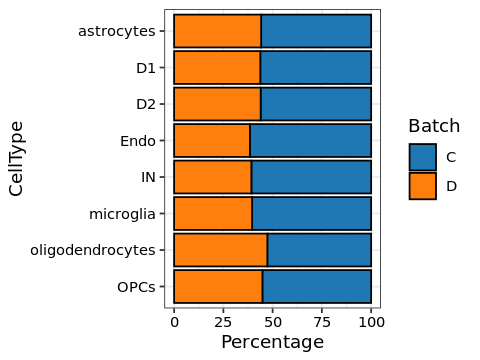

In [491]:
options(repr.plot.height = 3, repr.plot.width = 4)
p = ggplot(tbl_norm_mrg, aes(x=CellType, y=Percentage, fill=Batch)) + 
                 geom_bar(stat = "identity",color="black") + 
                 #scale_fill_manual(values = ggsci::pal_d3()(10)) +
                 ggsci::scale_fill_d3() + 
                 scale_x_discrete(limits = rev(levels(tbl_norm_mrg$CellType))) +
                 theme_bw() +coord_flip() +
                theme(axis.text = element_text(color="black"))
pdf("FigS3H.pdf",width = 9,height = 5)
print(p)
dev.off()
p

In [341]:
Idents(merFISH_sobj2) = merFISH_sobj2@meta.data$CellType
merFISH_mrks = FindAllMarkers(merFISH_sobj2)

Calculating cluster D2

Calculating cluster D1

Calculating cluster oligodendrocytes

Calculating cluster IN

Calculating cluster astrocytes

Calculating cluster OPCs

Calculating cluster microglia

Calculating cluster Endo



In [329]:
readr::write_csv(merFISH_mrks, "merFISH_global_markers.csv")

In [353]:
head(subset(merFISH_mrks, cluster == "Endo" & pct.1 > pct.2))

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
Ly6c1.3,0.000000e+00,2.6993406,0.344,0.099,0.000000e+00,Endo,Ly6c1
Rgs5.5,3.190409e-247,2.8435847,0.386,0.159,8.039830e-245,Endo,Rgs5
Gnas.7,1.215807e-175,1.3256261,0.683,0.425,3.063835e-173,Endo,Gnas
Aldoc.6,9.985001e-123,0.6410508,0.595,0.361,2.516220e-120,Endo,Aldoc
Gnb1.3,3.043183e-43,1.1780426,0.603,0.540,7.668822e-41,Endo,Gnb1
Pea15a.6,8.438880e-31,0.9000500,0.526,0.448,2.126598e-28,Endo,Pea15a


#### Select markers

In [342]:
selected_markers = subset(merFISH_mrks, (pct.1-pct.2)/pct.1 > 0.5 )
table(selected_markers$cluster)


              D2               D1 oligodendrocytes               IN 
               7                9               19               45 
      astrocytes             OPCs        microglia             Endo 
              16               20                8                2 

In [382]:
head(subset(selected_markers, cluster == "OPCs"),10)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
Pdgfra.5,0,5.429866,0.898,0.218,0,OPCs,Pdgfra
Elfn1.5,0,3.384978,0.679,0.201,0,OPCs,Elfn1
Ncald.5,0,3.016811,0.900,0.295,0,OPCs,Ncald
Spon1.5,0,2.722865,0.830,0.269,0,OPCs,Spon1
Fam5c.3,0,2.622627,0.629,0.172,0,OPCs,Fam5c
Grin3a.4,0,2.530268,0.613,0.190,0,OPCs,Grin3a
Fxyd6.4,0,2.493172,0.721,0.245,0,OPCs,Fxyd6
Tmem176b.5,0,2.396150,0.759,0.244,0,OPCs,Tmem176b
Scrg1.2,0,2.351046,0.548,0.147,0,OPCs,Scrg1


In [252]:
pdf(fout,width = 25,height = 8 * ceiling(length(markers))/35 )
  plotMarkersHeatmap_v3(
        all_cell_inDD_sobj,
        markers = markers,
        clustersColors = cols,slotToUse = "data",
        #markerClusters = clus_names,
        #identlevels = clus_lvls,
        clusterCols = FALSE
      )
  dev.off()

[1] "/nfs2/nadhir/Projects/scRNA_renchao_drug_NAc/MERFISH_combined"

In [357]:
require(tidyverse)

In [359]:
top5_markers = split(selected_markers,selected_markers$cluster) %>% 
              map(.f =function(x){
                  tmp = head(x,5)
                  x$gene
              }) %>%
            unlist()

In [370]:
levels(Idents(merFISH_sobj2))

[1] "D2"               "D1"               "oligodendrocytes" "IN"              
[5] "astrocytes"       "OPCs"             "microglia"        "Endo"

In [371]:
#pdf("Excitatory/TFs_expression.pdf",width = 10,height = 150)
MarkerViolonPlot(merFISH_sobj2,
                 features = top5_markers,
                 cell.ident = Idents(merFISH_sobj2), 
                 cols.use = generateColors(28),inGrid = T)
#dev.off()

ERROR: Error in get(name, envir = asNamespace(pkg), inherits = FALSE): object 'SetIfNull' not found


In [379]:
write.csv(merFISH_sobj2@meta.data,"merFISH_12022020_metadata.csv")

In [380]:
getwd()

[1] "/nfs2/nadhir/Projects/scRNA_renchao_drug_NAc/MERFISH_combined"

In [375]:
SaveH5Seurat(merFISH_sobj2,filename = "merFISH_12022020.H5Seurat")

Creating h5Seurat file for version 3.1.5.9900

Adding counts for RNA

Adding data for RNA

Adding scale.data for RNA

Adding variable features for RNA

Adding feature-level metadata for RNA

Adding cell embeddings for pca

Adding loadings for pca

No projected loadings for pca

Adding standard deviations for pca

No JackStraw data for pca

Adding cell embeddings for harmony

Adding loadings for harmony

Adding projected loadings for harmony

Adding standard deviations for harmony

No JackStraw data for harmony

Adding cell embeddings for umap

No loadings for umap

No projected loadings for umap

No standard deviations for umap

No JackStraw data for umap



In [376]:
SeuratDisk::Convert(source = "merFISH_12022020.H5Seurat",dest = "merFISH_12022020.H5ad")

Validating h5Seurat file

Adding scale.data from RNA as X

Transfering meta.features to var

Adding data from RNA as raw

Transfering meta.features to raw/var

Transfering meta.data to obs



ERROR: Error in self$exists(name): HDF5-API Errors:
    error #000: H5L.c in H5Lexists(): line 845: unable to get link info
        class: HDF5
        major: Links
        minor: Can't get value

    error #001: H5L.c in H5L__exists(): line 2932: path doesn't exist
        class: HDF5
        major: Links
        minor: Object already exists

    error #002: H5Gtraverse.c in H5G_traverse(): line 848: internal path traversal failed
        class: HDF5
        major: Symbol table
        minor: Object not found

    error #003: H5Gtraverse.c in H5G__traverse_real(): line 579: can't look up component
        class: HDF5
        major: Symbol table
        minor: Object not found

    error #004: H5Gobj.c in H5G__obj_lookup(): line 1135: can't locate object
        class: HDF5
        major: Symbol table
        minor: Object not found

    error #005: H5Gstab.c in H5G__stab_lookup(): line 880: unable to protect symbol table heap
        class: HDF5
        major: Symbol table
        minor: Protected metadata error

    


## Find the nearest neighbours between scRNASeq and MERFISH

In [5]:
table(hm.integrated@meta.data$Source)


 merFISH scRNASeq 
  190490    47576 

In [87]:
dim(hm.integrated@reductions$harmony@cell.embeddings)

[1] 238066     20

In [6]:
scRNACells =  colnames(hm.integrated)[which(hm.integrated@meta.data$Source == "scRNASeq")]
merFISHCells =  colnames(hm.integrated)[which(hm.integrated@meta.data$Source == "merFISH")]

In [7]:
NN <- Seurat:::FindNN(
    object = hm.integrated,
    cells1 = scRNACells,
    cells2 = merFISHCells,
    internal.neighbors = NULL,
    dims = 1:20,
    reduction = "harmony",
    #reduction.2 = reduction.2,
    nn.reduction = "harmony",
    k = 30,
    nn.method = "rann",
    eps = 0,
    verbose = TRUE
  )

Finding neighborhoods



In [180]:
?GetIntegrationData

GetIntegrationData {Seurat},R Documentation
object,Seurat object
integration.name,Name of integration object
slot,Which slot in integration object to get


In [8]:
neighbors <- GetIntegrationData(object = NN, integration.name = "integrated", slot = 'neighbors')
class(neighbors)

[1] "list"

In [9]:
str(neighbors[['nnab']])

Formal class 'Neighbor' [package "Seurat"] with 5 slots
  ..@ nn.idx    : int [1:47576, 1:30] 24933 119827 38198 124806 14900 179385 19737 154886 38806 141303 ...
  ..@ nn.dist   : num [1:47576, 1:30] 3.39 3.27 2.77 2.3 3.06 ...
  ..@ alg.idx   : NULL
  ..@ alg.info  : list()
  ..@ cell.names: chr [1:47576] "AAACCTGAGTGAACGC.NAc_Sample1" "AACCGCGTCAGCTCTC.NAc_Sample1" "ACACCCTAGCTGAACG.NAc_Sample1" "CCGTGGAAGCTACCGC.NAc_Sample1" ...


In [108]:
length(scRNACells)

[1] 47576

In [109]:
length(merFISHCells)

[1] 190490

## Get D1 & D2 cells From scRNA-Seq and merFISH that have D1/D2 neirghbours from the other experiment type

In [10]:
dim(neighbors[['nnab']]@nn.idx)

[1] 47576    30

In [11]:
dim(neighbors[['nnba']]@nn.idx)

[1] 190490     30

In [685]:
dim(neighbors[['nnba']]@nn.idx)

[1] 190490     30

In [91]:
merFISH.hm = hm.integrated[,merFISHCells]

In [92]:
scRNASeq.hm = hm.integrated[,scRNACells]

## Mean expression correlation

In [93]:
Idents(scRNASeq.hm) = scRNASeq.hm@meta.data$CellType
scRNASeq.hm.avg = Seurat::AverageExpression(scRNASeq.hm)

Finished averaging RNA for cluster D2

Finished averaging RNA for cluster D1

Finished averaging RNA for cluster IN

Finished averaging RNA for cluster NB

Finished averaging RNA for cluster Oligo

Finished averaging RNA for cluster OPC

Finished averaging RNA for cluster Astro

Finished averaging RNA for cluster Endo

Finished averaging RNA for cluster Micro



In [94]:
table( scRNASeq.hm@meta.data$CellType)


Astro    D1    D2  Endo    IN Micro    NB Oligo   OPC 
 7535 12342  7687  3540  1330  3208   483  8420  3031 

In [26]:
max(scRNASeq.hm.avg$RNA)

[1] 3368.838

In [95]:
Idents(merFISH.hm) = merFISH.hm@meta.data$CellType
merFISH.hm.avg = Seurat::AverageExpression(merFISH.hm)

Finished averaging RNA for cluster D2

Finished averaging RNA for cluster D1

Finished averaging RNA for cluster oligodendrocytes

Finished averaging RNA for cluster IN

Finished averaging RNA for cluster astrocytes

Finished averaging RNA for cluster OPCs

Finished averaging RNA for cluster microglia

Finished averaging RNA for cluster Endo



In [609]:
pdf("Fig3F_pie.pdf",width = 10,height = 10)
pct = table(merFISH.hm@meta.data$CellType)/length(merFISH.hm@meta.data$CellType)
pct =pct = scales::percent(as.numeric(pct))
lbls = paste0(names(table(merFISH.hm@meta.data$CellType))," (",pct,")")
pie(table(merFISH.hm@meta.data$CellType),col = c(ggsci::pal_npg()(10)[-c(2,8,10)], ggsci::pal_ucscgb()(7)[-1] ),labels = lbls)
dev.off()

png 
  2

In [499]:
pct = table(merFISH.hm@meta.data$CellType)/length(merFISH.hm@meta.data$CellType)
pct = scales::percent(as.numeric(pct))
pct

[1] "8.81%"  "45.11%" "22.08%" "1.11%"  "6.42%"  "3.70%"  "9.68%"  "3.09%"

In [684]:
merFISH.hm

An object of class Seurat 
252 features across 190490 samples within 1 assay 
Active assay: RNA (252 features, 252 variable features)
 3 dimensional reductions calculated: pca, harmony, umap

In [96]:
common_genes = intersect(rownames(merFISH.hm), rownames(scRNASeq.hm))
length(common_genes)

[1] 252

In [101]:
scRNA_merFISH_cormat = matrix(0, nrow=ncol(scRNASeq.hm.avg$RNA), ncol=  ncol(merFISH.hm.avg$RNA))
rownames(scRNA_merFISH_cormat) = colnames(scRNASeq.hm.avg$RNA)
colnames(scRNA_merFISH_cormat) = colnames(merFISH.hm.avg$RNA)

for(i in rownames(scRNA_merFISH_cormat)){
    x =  log2(scRNASeq.hm.avg$RNA[,i]+0.01)
    for(j in colnames(scRNA_merFISH_cormat)){
        y = log2(merFISH.hm.avg$RNA[,j]+0.01)
        scRNA_merFISH_cormat[i,j] = cor(x,y)
    }
}

In [100]:
dim(scRNASeq.hm.avg$RNA)

[1] 252   9

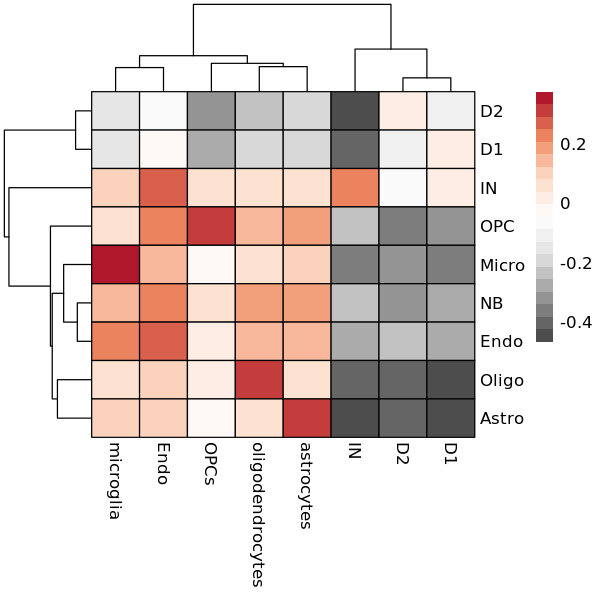

In [103]:
options(repr.plot.height = 5, repr.plot.width = 5)
col = colorRampPalette(rev(brewer.pal(n = 7, name ="RdGy")))(20)
pheatmap::pheatmap(scRNA_merFISH_cormat,color = col,border_color = "black")

In [303]:
Idents(merFISH.hm) <- merFISH.hm@meta.data$CellType

In [ ]:
merFISH.mrks = FindAllMarkers()

In [698]:
getDominatingmerFISHLabel <- function(x, thr=0.5){
    nn = merFISH.hm@meta.data$CellType[x]
    pct = table(nn)/length(x)
    res = names(pct)[which(pct>= thr)]
    if(length(res)==0){
        res ="NULL"
    }
    res[1]
    }

In [691]:
getDominatingscRNASeqLabel <- function(x, thr=0.5){
    nn = scRNASeq.hm@meta.data$CellType[x]
    pct = table(nn)/length(x)
    res = names(pct)[which(pct>= thr)]
    if(length(res)==0){
        res ="NULL"
    }
    res[1]
    }

In [699]:
label.merFISH_NN = apply(neighbors[['nnab']]@nn.idx,1,getDominatingmerFISHLabel)

In [151]:
label.scRNASeq_NN = apply(neighbors[['nnba']]@nn.idx,1,getDominatingscRNASeqLabel)

In [152]:
table(hm.integrated[,merFISHCells]@meta.data$CellType, label.scRNASeq_NN)

                  label.scRNASeq_NN
                   Astro    D1    D2  Endo    IN Micro    NB  NULL Oligo   OPC
  astrocytes       15188   657     5   213    69    22    25   453   106    44
  D1                 140 81846  1552    93   237   105   136  1766     3    56
  D2                  22  1607 38947    23    39    16     4  1402     0     4
  Endo                 3     0     0  2000     0     5    17    91     2     1
  IN                  45   569   157    42 10035    26   112  1190    18    27
  microglia           31   373   287   218    36  5897     0   200     1     1
  oligodendrocytes   284   714    15   312    30   209    74   865 15926    19
  OPCs                54   363   204   129    54    36    16   309   262  4451

In [696]:
100 * table(label.merFISH_NN)/length(label.merFISH_NN)

label.merFISH_NN
      astrocytes               D1               D2             Endo 
       15.816798        25.380444        16.169918         6.042963 
              IN        microglia             NULL oligodendrocytes 
        2.894316         6.709265         3.030940        17.655961 
            OPCs 
        6.299395 

In [123]:
sim = table(hm.integrated[,scRNACells]@meta.data$CellType, label.merFISH_NN)
sim

ERROR: Error in order(y): unimplemented type 'list' in 'orderVector1'



In [690]:
table(label.merFISH_NN)

ERROR: Error in base::table(...): all arguments must have the same length


In [61]:
require(ComplexHeatmap)
require(pheatmap)
require(RColorBrewer)

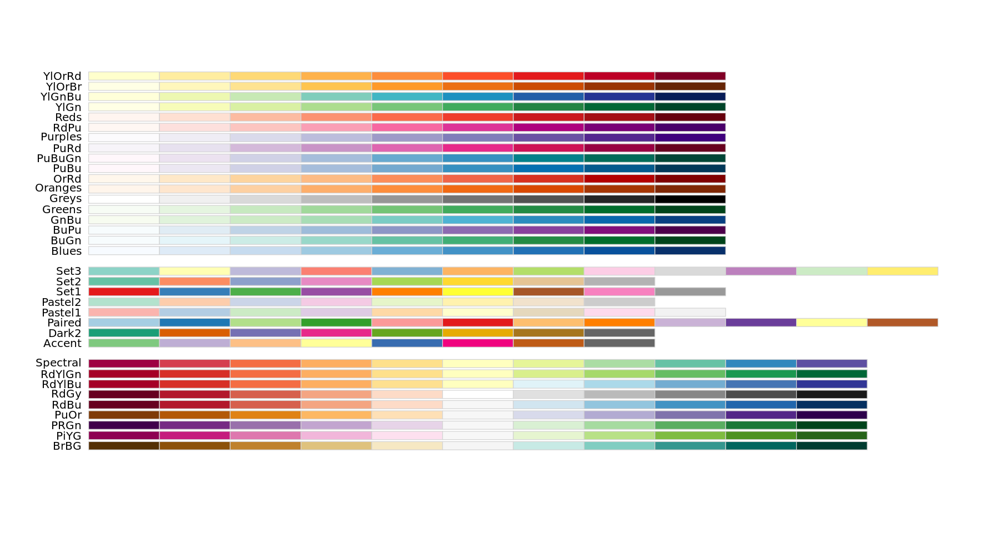

In [334]:
display.brewer.all()

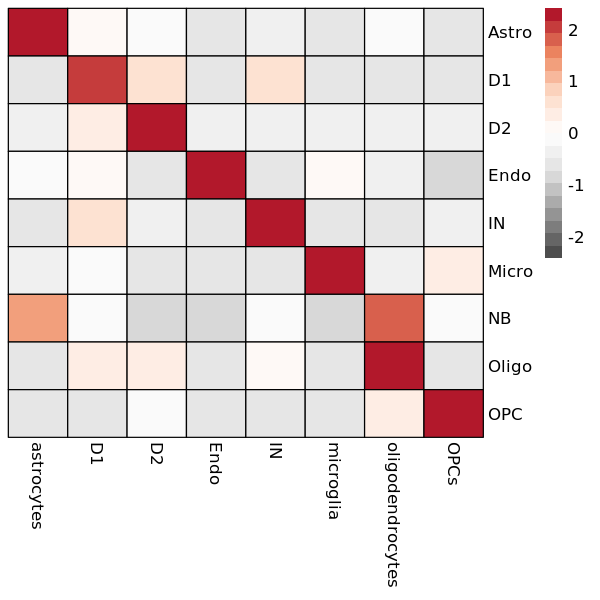

In [126]:
mat = as.data.frame.matrix(sim) %>% data.matrix()
mat_norm = pheatmap:::scale_rows(mat)
col = colorRampPalette(rev(brewer.pal(n = 7, name ="RdGy")))(20)
options(repr.plot.height = 5, repr.plot.width = 5)
#pdf("MainCellTypes_similarity.pdf",width=5,height = 5)
#pheatmap(log2(mat+1)[,c(1:6,8:9,7)],cluster_cols = FALSE,cluster_rows = FALSE,scale = "row",color = col,border_color = "black")
#dev.off()
pheatmap(log2(mat+1)[,c(1:6,8:9)],cluster_cols = FALSE,cluster_rows = FALSE,scale = "row",color = col,border_color = "black")

In [792]:
mat = as.data.frame.matrix(sim) %>% data.matrix()
mat_norm = apply(log2(mat+1),1,function(x) x/sum(x)) %>% t()

options(repr.plot.height = 6, repr.plot.width = 6)
hcols <- c("white",colorRampPalette(brewer.pal(n = 9, name ="Reds"))(10))
cl = colorRamp2(seq(0, 0.7, length.out = length(hcols)), hcols)


H = Heatmap(mat_norm[,c(1:6,8:9)], col = cl, name="Similarity",
            border = TRUE,cluster_columns = F,cluster_rows = F,
            rect_gp = gpar(col = "black", lwd = 1)
)

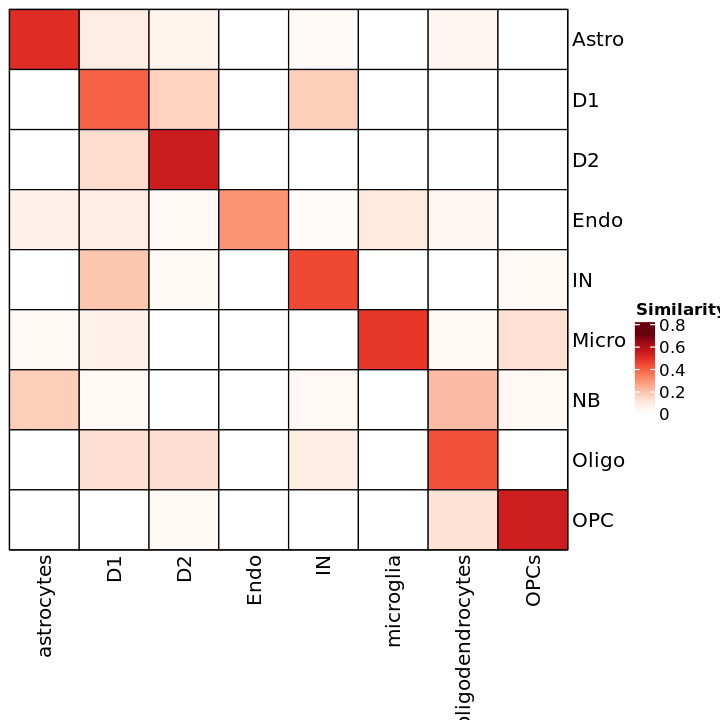

In [793]:
draw(H)

In [787]:
save(sim, file="sim.RData")

In [785]:
mat_norm

,astrocytes,D1,D2,Endo,IN,microglia,NULL,oligodendrocytes,OPCs
Astro,0.9915063039,0.0006635700,0.0003981420,0.0000000,0.0001327140,0.000000000,0.007033842,0.0002654280,0.0000000000
D1,0.0000000000,0.9644304003,0.0045373521,0.0000000,0.0059147626,0.000000000,0.025117485,0.0000000000,0.0000000000
D2,0.0000000000,0.0014309874,0.9778847405,0.0000000,0.0000000000,0.000000000,0.020684272,0.0000000000,0.0000000000
Endo,0.0022598870,0.0033898305,0.0005649718,0.6813559,0.0002824859,0.004519774,0.306779661,0.0008474576,0.0000000000
IN,0.0000000000,0.0187969925,0.0007518797,0.0000000,0.9285714286,0.000000000,0.051127820,0.0000000000,0.0007518797
Micro,0.0003117207,0.0009351621,0.0000000000,0.0000000,0.0000000000,0.984413965,0.010910224,0.0003117207,0.0031172070
NB,0.0248447205,0.0020703934,0.0000000000,0.0000000,0.0020703934,0.000000000,0.925465839,0.0434782609,0.0020703934
Oligo,0.0000000000,0.0023752969,0.0026128266,0.0000000,0.0009501188,0.000000000,0.005106888,0.9889548694,0.0000000000
OPC,0.0000000000,0.0000000000,0.0003299241,0.0000000,0.0000000000,0.000000000,0.018805675,0.0023094688,0.9785549324


In [127]:
save(mat, file="mat.RData")

Warning message in cells.idents["NA"] <- names(x = which(x = is.na(x = Idents(object = object)[cells]))):
“number of items to replace is not a multiple of replacement length”


png 
  2

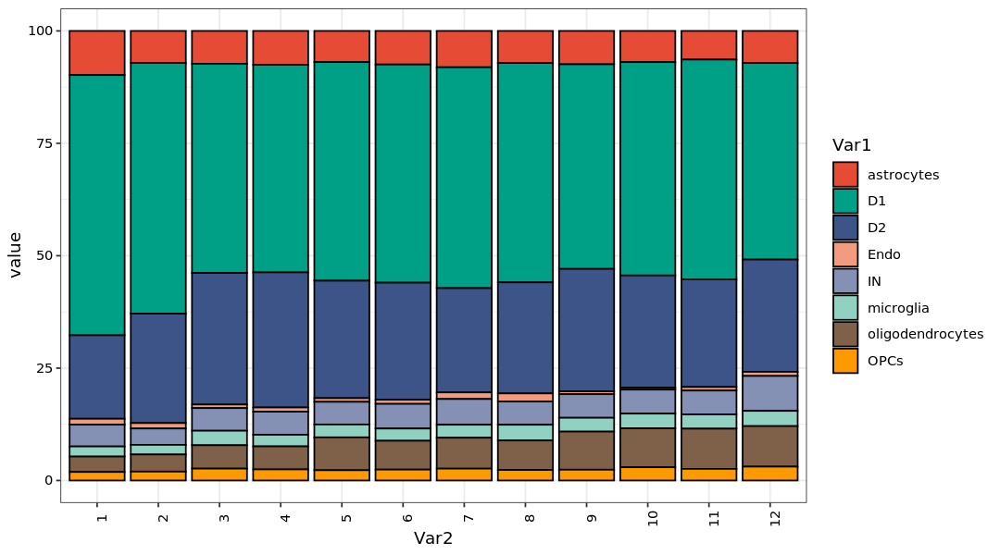

In [457]:
merFISH_BatchC.hm = subset(merFISH.hm, Batch == "C")
tbl = as.matrix(table(merFISH_BatchC.hm@meta.data$CellType, merFISH_BatchC.hm@meta.data$StriatumCells))
tbl_norm = apply(tbl,2,function(x) x/sum(x))
tbl_norm_mrg = reshape2::melt(tbl_norm)
tbl_norm_mrg$Var2 = gsub("Slice|_C","",tbl_norm_mrg$Var2)
tbl_norm_mrg = subset(tbl_norm_mrg, Var2 %in% glue::glue("{1:12}"))
tbl_norm_mrg$Var2 = factor(tbl_norm_mrg$Var2,levels = glue::glue("{1:12}"))

tbl_norm_mrg$value = 100 * tbl_norm_mrg$value

options(repr.plot.height = 5, repr.plot.width = 9)

p = ggplot(tbl_norm_mrg, aes(x=Var2, y=value, fill=Var1)) + geom_bar(stat = "identity",color="black") + 
                 scale_fill_manual(values = c(ggsci::pal_npg()(10)[-c(2,8,10)], ggsci::pal_ucscgb()(7)[-1] )) +
                 #ggsci::scale_fill_npg() + 
                 theme_bw() +
theme(axis.text = element_text(color="black"),axis.text.x = element_text(angle = 90))
pdf("Fig3H.pdf",width = 9,height = 5)
print(p)
dev.off()
p

In [142]:
head(tbl_norm_mrg)

,Var1,Var2,value
,<fct>,<fct>,<dbl>
1,astrocytes,NA,0.12391159
2,D1,NA,0.52578701
3,D2,NA,0.13797723
4,Endo,NA,0.01473543
5,IN,NA,0.07769591
6,microglia,NA,0.03482920


## Calculate expression correlation

In [ ]:
Idents(scRNASeq.hm) = scRNASeq.hm@meta

In [343]:
quantile(mat_norm)

0%        25%        50%        75%       100% 
-0.4699044 -0.3471160 -0.3383110 -0.3286380  2.6666294

In [154]:
merFISH.hm@meta.data$NewLabel = label.scRNASeq_NN

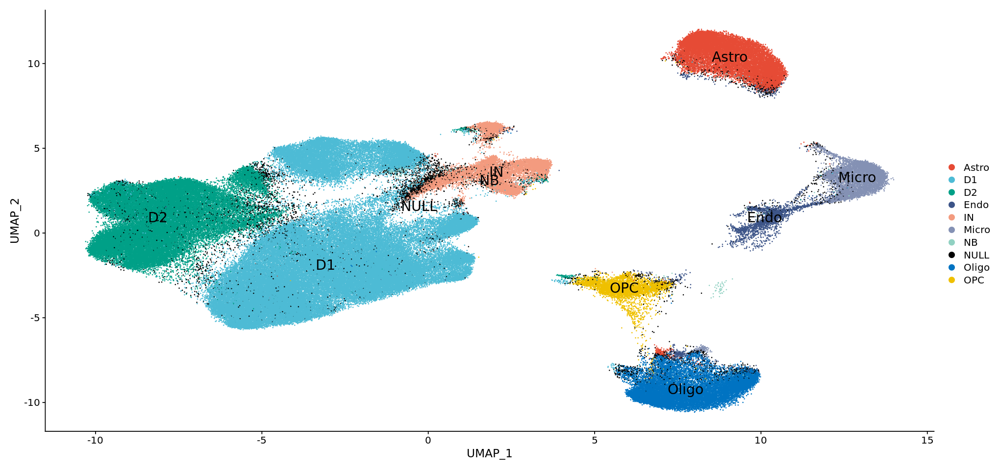

In [155]:
options(repr.plot.height = 8, repr.plot.width = 17)
DimPlot(merFISH.hm, group.by = "NewLabel",label.size = 6,pt.size = 0.1, cols = c(ggsci::pal_npg()(7),"black", ggsci::pal_jco()(10)),label = TRUE)

In [156]:
head(merFISH.hm)

An object of class Seurat 
1 features across 190490 samples within 1 assay 
Active assay: RNA (1 features, 1 variable features)
 3 dimensional reductions calculated: pca, harmony, umap

## UMAP of D1

In [450]:
merFISH.hm.D1 = subset(merFISH.hm, NewLabel == "D1" & CellType == "D1")
merFISH.hm.D1

An object of class Seurat 
252 features across 81846 samples within 1 assay 
Active assay: RNA (252 features, 252 variable features)
 3 dimensional reductions calculated: pca, harmony, umap

In [1071]:
library(future)
plan("multiprocess", workers = 22)

In [452]:

merFISH.hm.D1@meta.data$clusterLabel = gsub("D1_","",merFISH.hm.D1@meta.data$clusterLabel) %>% as.character() %>% as.numeric()
merFISH.hm.D1@meta.data$clusterLabel = merFISH.hm.D1@meta.data$clusterLabel + 1
merFISH.hm.D1@meta.data$clusterLabel = paste0("D1_", merFISH.hm.D1@meta.data$clusterLabel)
merFISH.hm.D1@meta.data$clusterLabel = factor(merFISH.hm.D1@meta.data$clusterLabel,levels = glue::glue("D1_{1:18}"))
pos <- which(!merFISH.hm.D1@meta.data$clusterLabel %in% c("D1_16","D1_18"))
merFISH.hm.D1 = merFISH.hm.D1[,pos]
merFISH.hm.D1

An object of class Seurat 
252 features across 79422 samples within 1 assay 
Active assay: RNA (252 features, 252 variable features)
 3 dimensional reductions calculated: pca, harmony, umap

PC_ 1 
Positive:  Scn4b, Ppp3ca, Rgs4, Reln, Arpp21, Cnr1, Kcna4, Ppp1r1b, Foxp1, Calb1 
	   Camk4, Drd1a, Arpp19, Rgs9, Nrgn, Ddit4l, Grm5, Pcp4, Ccnd2, Ebf1 
	   Nexn, Kcnk2, Rasgrp2, Cdh13, Rxrg, Serpine2, Nefm, Grm1, Scn9a, Oprk1 
Negative:  Stmn1, Vsnl1, Gng2, Tshz1, Pde1a, Gnas, Gabra3, Marcksl1, Pdcd4, Tmeff2 
	   Cacna1g, Otof, Sphkap, Ncald, Gad1, Cpne7, Kcnc2, Gpr149, Kcnab3, Ralyl 
	   Nfix, Grin3a, Hpcal1, Fxyd6, Cacng7, Tagln3, Cpne4, Pea15a, Camk1, Kcnh2 
PC_ 2 
Positive:  Dlk1, Crym, Ncdn, Pdyn, Wfs1, Scg2, Pea15a, Fxyd6, Nnat, Ctxn1 
	   Crim1, Peg10, Arpp21, Bhlhe41, Cadm1, Igfbp4, Calb1, Trhr, Htr2c, Pde1a 
	   Cartpt, Zbtb20, Kctd4, Oprm1, Kcna4, Gpr101, Gabrg1, Arhgap36, Stard5, Hpcal1 
Negative:  Nefm, Otof, Pcp4, Necab1, Nefl, Ntm, Tshz1, Gucy1a3, Rab3b, Pcp4l1 
	   Kcnk2, Pcdh7, Grin2a, Cnr1, Foxp2, Nrgn, Snap25, Stmn1, Kcnab3, Gpr149 
	   Spry2, Rasgrf2, Rgs4, Gabra3, Cacna2d2, Ccnd2, Gnb1, 4930452B06Rik, Rxrg, Tac1 
PC_ 3 
Positive:  Npy1r, Isl1, Gpr149, Rgs9, 

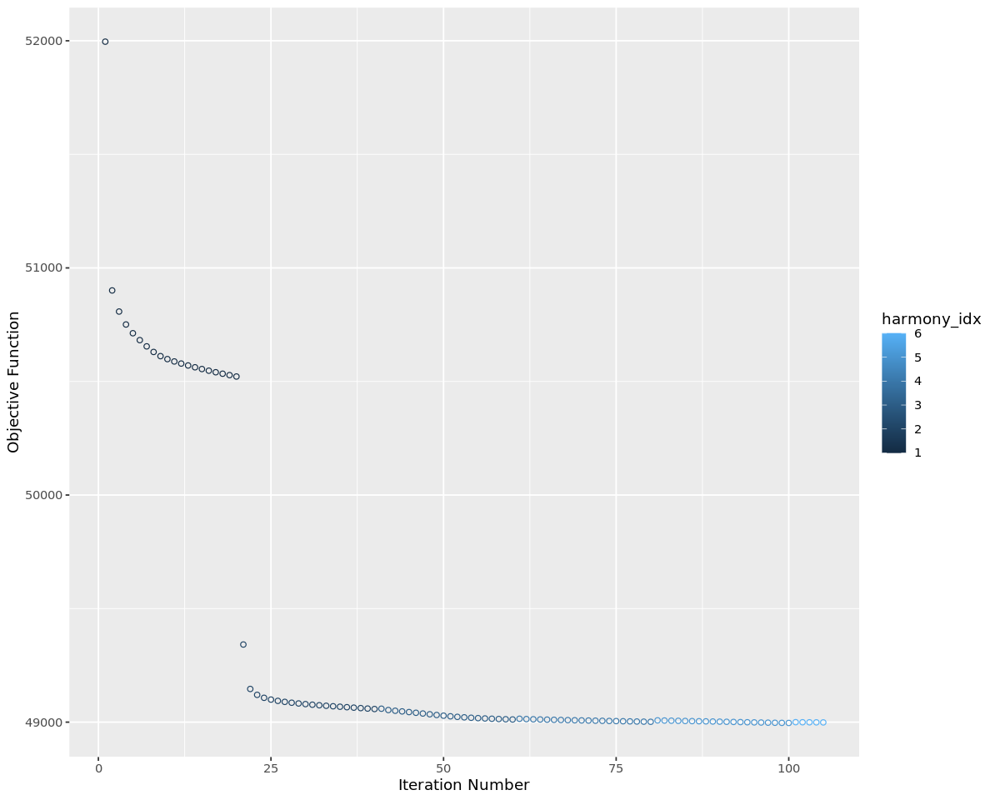

In [453]:
merFISH.hm.D1 = merFISH.hm.D1 %>%
    NormalizeData(verbose = FALSE) %>%
    FindVariableFeatures(nfeatures = 300) %>% 
    ScaleData(verbose = FALSE) %>% 
    RunPCA() %>%
    RunHarmony(group.by.vars = 'Batch',plot_convergence = TRUE) %>%
    RunUMAP(reduction = "harmony",dims = 1:20,n_threads=10,umap.method = "uwot",min.dist = 0.1,verbose = FALSE)

In [454]:
colnames(merFISH.hm.D1@meta.data)

[1] "orig.ident"      "percent.mito"    "Sample"          "tree.ident"     
 [5] "CellType"        "L2_Clustering"   "L1_Clustering"   "nCount_RNA"     
 [9] "nFeature_RNA"    "Source"          "sliceNumber"     "datasetName"    
[13] "clusterLabel"    "StriatumCells"   "cellType"        "Batch"          
[17] "leiden"          "clus"            "OldAnno"         "NewAnno"        
[21] "batchCInfo"      "RNA_snn_res.0.8" "seurat_clusters" "NewLabel"

In [232]:
tmp = merFISH.hm.D1@meta.data$clusterLabel

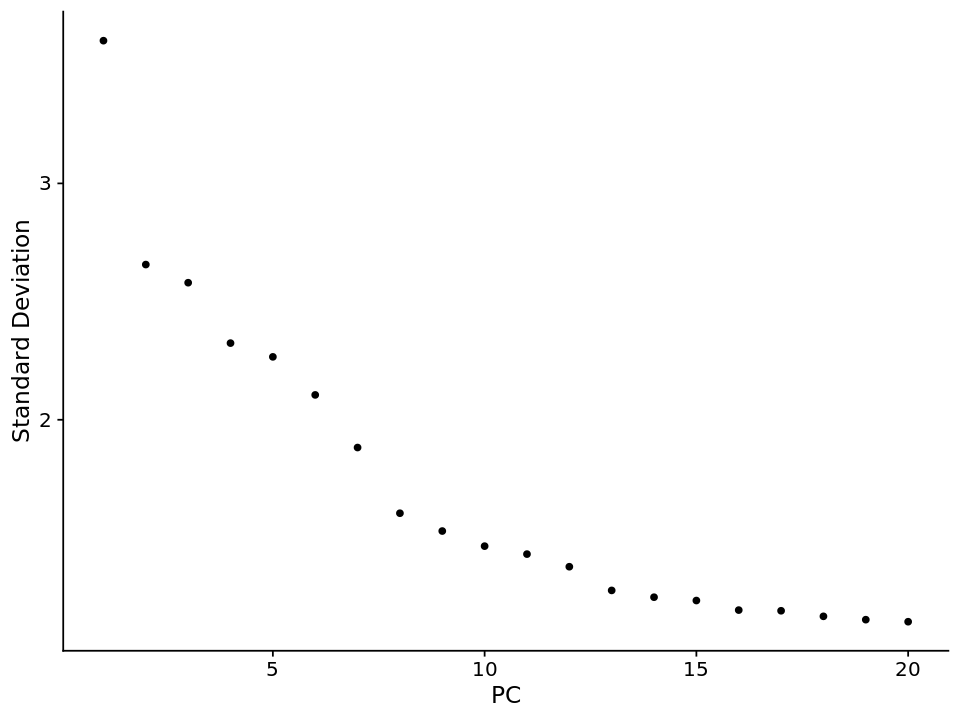

In [440]:
ElbowPlot(merFISH.hm.D1)

In [202]:
merFISH.hm.D1 = RunUMAP(object = merFISH.hm.D1,reduction = "pca",dims = 1:20,n_threads=10,n.neighbors = 20,umap.method = "uwot",min.dist = 0.1,verbose = FALSE)

Warning message:
“The following arguments are not used: n_threads”


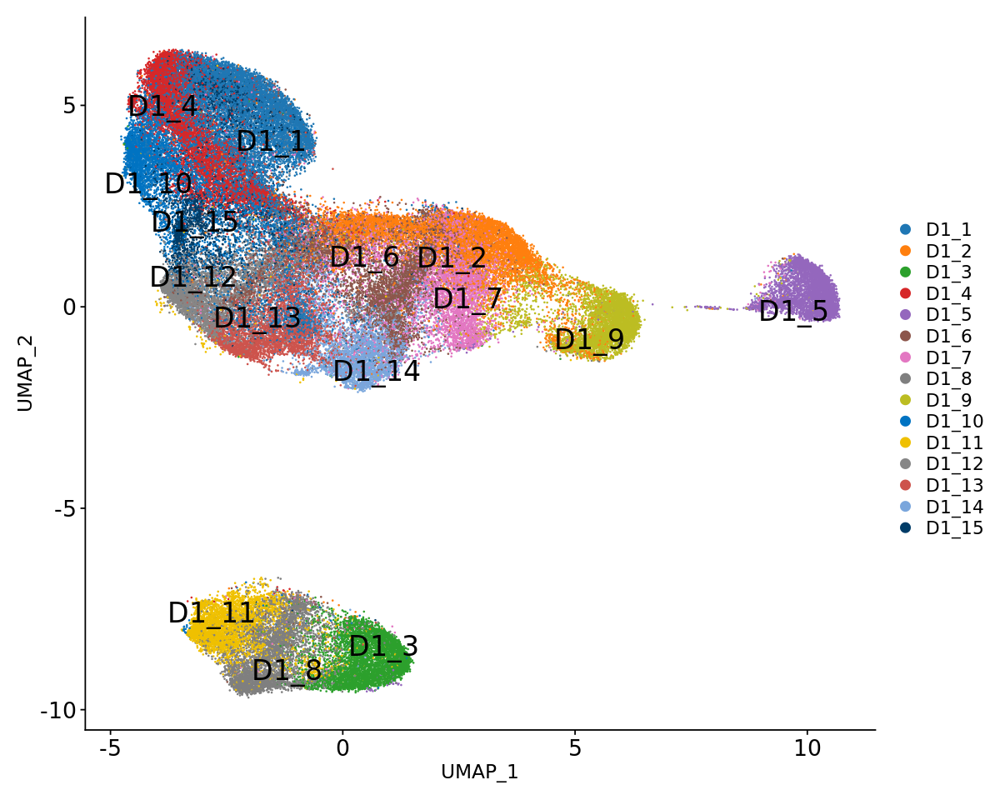

In [455]:
options(repr.plot.height = 8, repr.plot.width = 10)
p = DimPlot(merFISH.hm.D1, 
        group.by = "clusterLabel",
        label.size = 7,pt.size = 0.1, 
        cols = c(ggsci::pal_d3()(10)[-10], ggsci::pal_jco()(10)),
        label = TRUE,repel = TRUE)  +
        theme(axis.text = element_text(color = "black",size = 16), 
              legend.text = element_text(color = "black", size = 13)
             )  
print(p)

In [384]:
colnames(merFISH.hm.D1@meta.data)

[1] "orig.ident"      "percent.mito"    "Sample"          "tree.ident"     
 [5] "CellType"        "L2_Clustering"   "L1_Clustering"   "nCount_RNA"     
 [9] "nFeature_RNA"    "Source"          "sliceNumber"     "datasetName"    
[13] "clusterLabel"    "StriatumCells"   "cellType"        "Batch"          
[17] "leiden"          "clus"            "OldAnno"         "NewAnno"        
[21] "batchCInfo"      "RNA_snn_res.0.8" "seurat_clusters" "NewLabel"

An object of class Seurat 
248 features across 79422 samples within 1 assay 
Active assay: RNA (248 features, 247 variable features)
 3 dimensional reductions calculated: pca, harmony, umap

In [442]:
table(merFISH.hm.D1@meta.data$clusterLabel)


 D1_1  D1_2  D1_3  D1_4  D1_5  D1_6  D1_7  D1_8  D1_9 D1_10 D1_11 D1_12 D1_13 
10863  8053  4858  7120  4253  5852  5162  4818  4820  4722  4199  4309  3928 
D1_14 D1_15 D1_16 D1_17 D1_18 
 3401  3064     0     0     0 

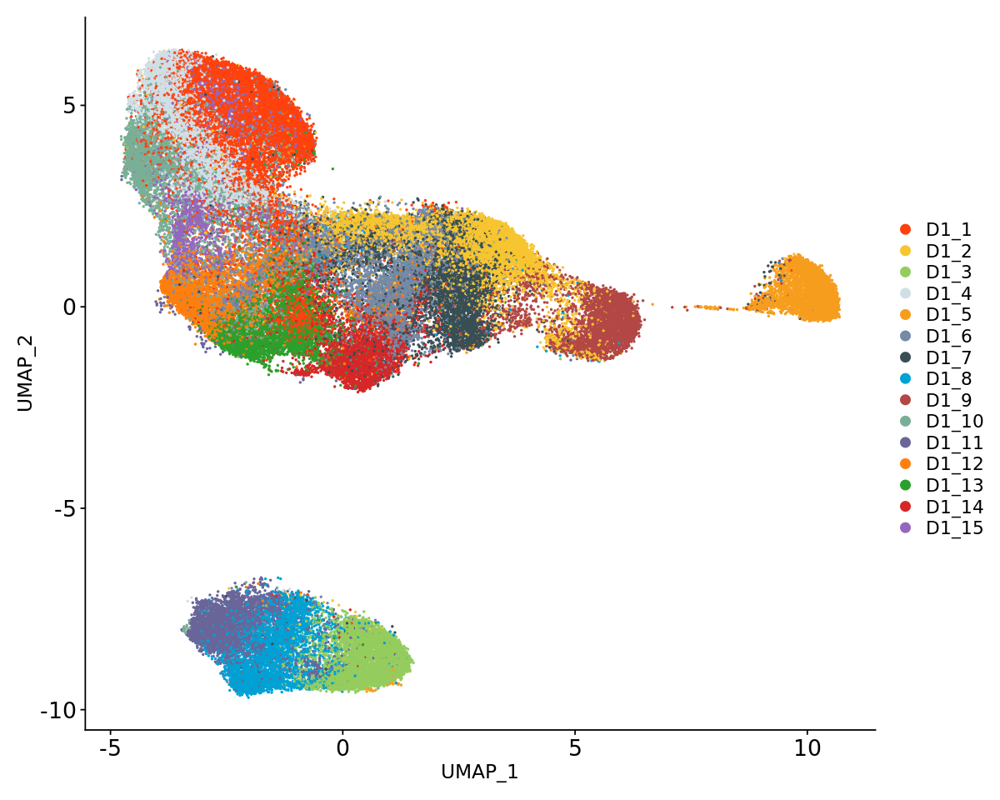

In [690]:
options(repr.plot.height = 8, repr.plot.width = 10)
p = DimPlot(merFISH.hm.D1, 
        group.by = "clusterLabel",
        label.size = 7,
            pt.size = 0.3, 
        cols = c(ggsci::pal_tron()(7)[-2], ggsci::pal_jama()(6)[-2], ggsci::pal_d3()(5)[-1], ggsci::pal_simpsons()(4)),
        label = FALSE,
            repel = TRUE)  +
        theme(axis.text = element_text(color = "black",size = 16), 
              legend.text = element_text(color = "black", size = 13)
             )  
print(p)

In [732]:
pdf("D1_merFISH_UMAP_noNames.pdf",width=8,height = 6)
print(p)
dev.off()

png 
  2

## Plot D1 by batch

png 
  2

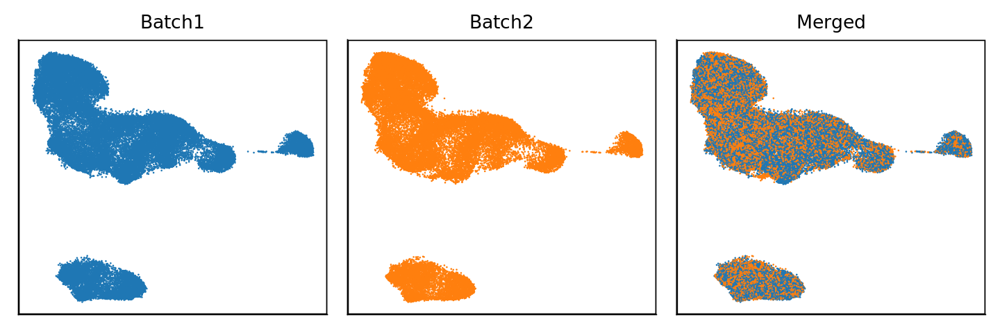

In [732]:
options(repr.plot.height = 4, repr.plot.width = 12)
p_g1= DimPlot(merFISH.hm.D1[,merFISH.hm.D1$Batch=="C"], group.by = 'Batch',pt.size = 0.1,
             cols =  ggsci::pal_d3()(10)[1],
            label = FALSE,label.size = 6) + 
            cowplot::panel_border(color = "black") + 
             theme(plot.title = element_text(hjust = 0.5,face = "plain"),
                   axis.title=element_blank(),
                   axis.text=element_blank(),
                   axis.ticks=element_blank(), legend.position = "none") + ggtitle("Batch1")

p_g2= DimPlot(merFISH.hm.D1[,merFISH.hm.D1$Batch=="D"], group.by = 'Batch',pt.size = 0.1,
             cols =  ggsci::pal_d3()(10)[2],
            label = FALSE,label.size = 6) + 
            cowplot::panel_border(color = "black") + 
             theme(plot.title = element_text(hjust = 0.5,face = "plain"),
                   axis.title=element_blank(),
                   axis.text=element_blank(),
                   axis.ticks=element_blank(),legend.position = "none") + ggtitle("Batch2")

p_g3= DimPlot(merFISH.hm.D1, group.by = 'Batch',  pt.size = 0.1,
             cols =  ggsci::pal_d3()(10),
            label = FALSE,label.size = 6) +
            cowplot::panel_border(color = "black") + 
             theme(plot.title = element_text(hjust = 0.5,face = "plain"),
                   axis.title=element_blank(),
                   axis.text=element_blank(),
                   axis.ticks=element_blank(),legend.position = "none") + ggtitle("Merged")
pdf("FigS4A.pdf",width = 12, height = 4)
print(p_g1 + p_g2 + p_g3)
dev.off()
p_g1 + p_g2 + p_g3

In [733]:
tbl = as.matrix(table(merFISH.hm.D1@meta.data$clusterLabel, merFISH.hm.D1@meta.data$Batch))
tbl_norm = apply(tbl,1,function(x) x/sum(x))
tbl_norm_mrg = reshape2::melt(tbl_norm)
tbl_norm_mrg$value = 100 * tbl_norm_mrg$value               
colnames(tbl_norm_mrg)= c("Batch","Cluster","Percentage")      
head(tbl_norm_mrg)   

,Batch,Cluster,Percentage
,<fct>,<fct>,<dbl>
1,C,D1_1,53.91697
2,D,D1_1,46.08303
3,C,D1_2,57.25816
4,D,D1_2,42.74184
5,C,D1_3,57.98683
6,D,D1_3,42.01317


png 
  2

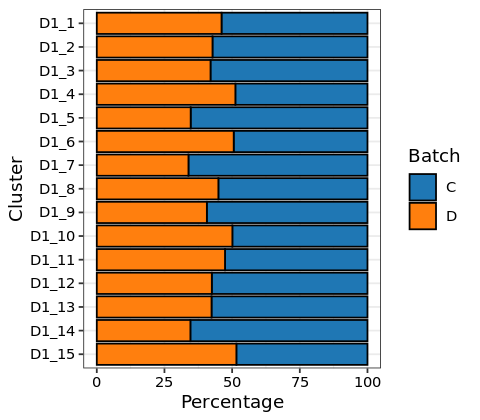

In [738]:
options(repr.plot.height = 3.5, repr.plot.width = 4)
p = ggplot(tbl_norm_mrg, aes(x=Cluster, y=Percentage, fill=Batch)) + 
                 geom_bar(stat = "identity",color="black") + 
                 #scale_fill_manual(values = ggsci::pal_d3()(10)) +
                 ggsci::scale_fill_d3() + 
                 scale_x_discrete(limits = rev(levels(tbl_norm_mrg$Cluster))) +
                 theme_bw() +coord_flip() +
                theme(axis.text = element_text(color="black"))
pdf("FigS4C.pdf",width = 4,height = 3.5)
print(p)
dev.off()
p

## Get enrichment by slice

In [716]:
table(merFISH.hm.D1@meta.data$Batch)


    C     D 
44375 35047 

In [813]:
merFISH.hm.D1_filtered = subset(merFISH.hm.D1, sliceNumber %in% 1:12 & Batch == "C")

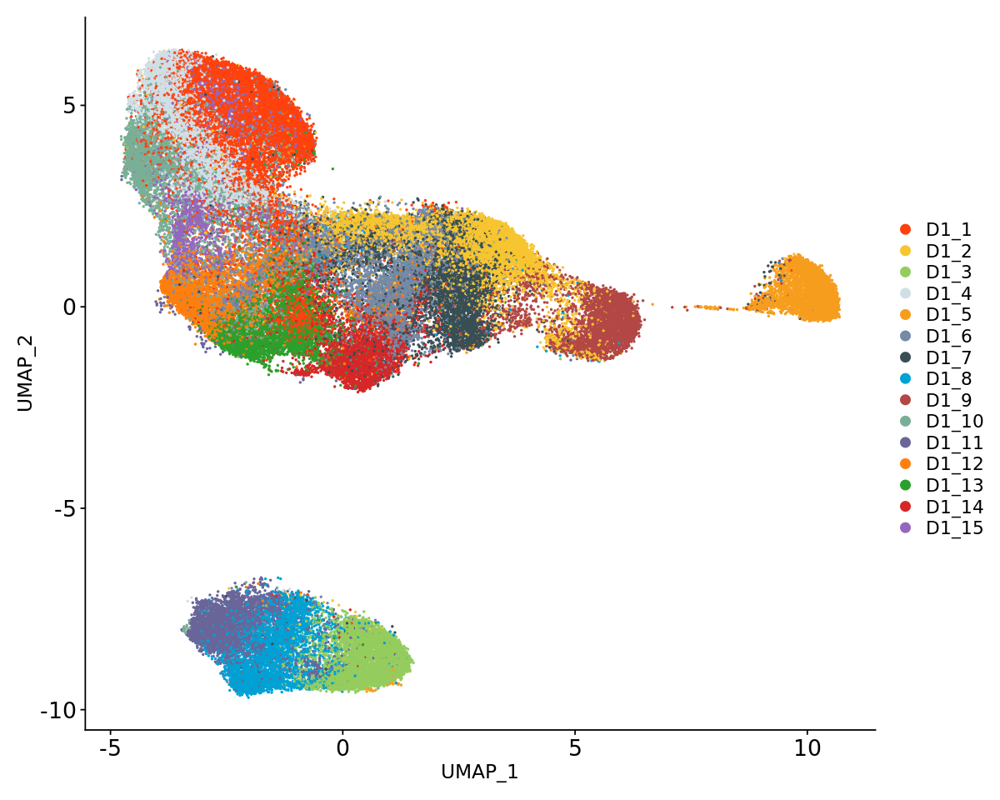

In [719]:
options(repr.plot.height = 8, repr.plot.width = 10)
DimPlot(merFISH.hm.D1, 
        group.by = "clusterLabel",
        label.size = 7,
            pt.size = 0.3, 
        cols = c(ggsci::pal_tron()(7)[-2], ggsci::pal_jama()(6)[-2], ggsci::pal_d3()(5)[-1], ggsci::pal_simpsons()(4)),
        label = FALSE,
            repel = TRUE)  +
        theme(axis.text = element_text(color = "black",size = 16), 
              legend.text = element_text(color = "black", size = 13)
             )  

In [815]:
tbl = table(merFISH.hm.D1_filtered$clusterLabel, merFISH.hm.D1_filtered$sliceNumber)
tbl = tbl %>% as.matrix()
tbl = apply(tbl,2,function(x) 100 * x/sum(x))
tbl[glue::glue("D1_{c(9,2,8,12,6,11,5,15,10,13,1,3,7,14,4)}"),]

,1,2,3,4,5,6,7,8,9,10,11,12
D1_9,35.4447439,8.0296128,5.27859238,10.3317536,15.5351682,12.3401890,3.598240,2.264410,1.848249,5.6429414,7.3203883,1.8972698
D1_2,37.6010782,18.9635535,16.32453568,15.1184834,11.3455657,9.1439689,9.448615,10.247027,9.192607,7.6877703,5.5728155,6.4090699
D1_8,5.9299191,15.2619590,12.21896383,6.5876777,6.8195719,7.6709283,6.342221,4.940531,4.036965,4.2469524,3.2621359,3.1235539
D1_12,0.9433962,13.6104784,20.96774194,24.7393365,10.0611621,10.2001112,7.248253,3.019213,1.629377,0.8257963,0.4271845,0.3933364
D1_6,7.8167116,6.2072893,5.13196481,12.0853081,15.5963303,10.2834908,10.173440,6.015554,4.547665,4.5025560,4.3689320,2.2211939
D1_11,0.9433962,7.3462415,7.08699902,7.3933649,5.9021407,6.8927182,7.610665,6.175663,4.912451,3.8930397,2.9902913,2.7302175
D1_5,5.9299191,12.4145786,11.38807429,3.7914692,5.7186544,10.0333519,8.697903,7.548033,3.842412,3.7947306,3.1456311,4.6274873
D1_15,0.4043127,0.9111617,2.44379277,2.9857820,3.9449541,5.7531962,3.986539,4.483074,3.015564,2.5167125,3.6893204,2.8921795
D1_10,0.0000000,1.1389522,1.22189638,1.4218009,3.7920489,3.8354641,4.374838,10.361391,6.493191,6.2327959,7.9805825,6.6867191
D1_13,0.0000000,2.8473804,2.88367546,1.9905213,2.9357798,3.1684269,4.607818,7.708143,7.563230,7.7270940,5.7475728,4.3498380


In [773]:
o = apply(tbl,2,which.max)
order(o)

[1] 12  6  9  5  8 15 11  2 10  7 13  3  4 14  1

In [817]:
options(repr.plot.height = 4, repr.plot.width = 5)
graphics.off()
hcols <-hcols <- colorRampPalette(brewer.pal(n = 9, name ="Reds"))(4)
cl = colorRamp2(seq(0, quantile(tbl, probs = 0.90), length.out = length(hcols)), hcols)
D1_clus_ord = glue::glue("D1_{c(9,2,8,12,6,11,5,15,10,13,1,3,7,14,4)}")
D1_clus_ord = glue::glue("D1_{c(9,2,8,5,12,6,15,11,10,13,1,3,7,14,4)}")
H = Heatmap(t(tbl)[,D1_clus_ord],#glue::glue("D1_{c(9,2,8,12,6,11,5,15,10,13,1,3,7,14,4)}")] ,
            cluster_columns = FALSE,cluster_rows = FALSE,
            col = cl,
            border = TRUE,
            rect_gp = gpar(col = "black", lwd = 1)
           )
H

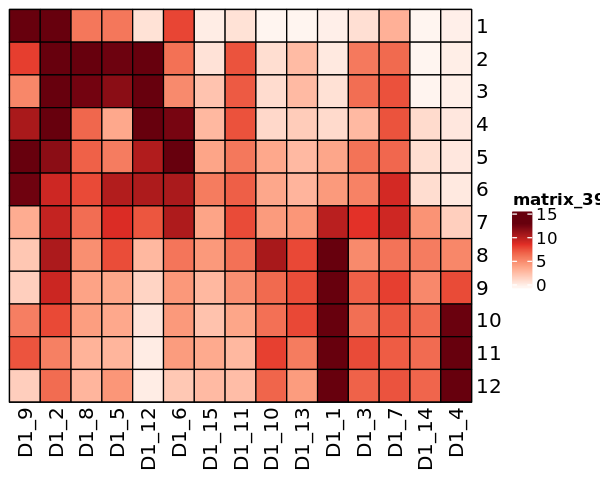

In [818]:
options(repr.plot.height = 4, repr.plot.width = 5)
H

In [781]:
pdf("D1_batchC_distribution.pdf",width=5,height = 4)
H
dev.off()

png 
  2

In [692]:
save.image("12082020_image.RData")

## UMAP of D2

In [471]:
merFISH.hm.D2 = subset(merFISH.hm, NewLabel == "D2" & CellType == "D2")
merFISH.hm.D2

An object of class Seurat 
252 features across 38947 samples within 1 assay 
Active assay: RNA (252 features, 252 variable features)
 3 dimensional reductions calculated: pca, harmony, umap

In [472]:
table(merFISH.hm.D2@meta.data$clusterLabel)


 D2_0  D2_1 D2_10 D2_11  D2_2  D2_4  D2_5  D2_6  D2_7  D2_8  D2_9 
 8973  7190  1459   993  7150  3631  2269  2140  2276  1093  1773 

In [473]:

merFISH.hm.D2@meta.data$clusterLabel = gsub("D2_","",merFISH.hm.D2@meta.data$clusterLabel) %>% as.character() %>% as.numeric()
merFISH.hm.D2@meta.data$clusterLabel = merFISH.hm.D2@meta.data$clusterLabel + 1
merFISH.hm.D2@meta.data$clusterLabel = paste0("D2_", merFISH.hm.D2@meta.data$clusterLabel)
merFISH.hm.D2@meta.data$clusterLabel = factor(merFISH.hm.D2@meta.data$clusterLabel,levels = glue::glue("D2_{1:12}"))

In [474]:
table(merFISH.hm.D2@meta.data$clusterLabel)


 D2_1  D2_2  D2_3  D2_4  D2_5  D2_6  D2_7  D2_8  D2_9 D2_10 D2_11 D2_12 
 8973  7190  7150     0  3631  2269  2140  2276  1093  1773  1459   993 

In [475]:
pos <- which(!merFISH.hm.D2@meta.data$clusterLabel %in% c("D2_9","D2_12"))
merFISH.hm.D2 = merFISH.hm.D2[,pos]
merFISH.hm.D2

An object of class Seurat 
252 features across 36861 samples within 1 assay 
Active assay: RNA (252 features, 252 variable features)
 3 dimensional reductions calculated: pca, harmony, umap

In [476]:
table(merFISH.hm.D2@meta.data$clusterLabel)


 D2_1  D2_2  D2_3  D2_4  D2_5  D2_6  D2_7  D2_8  D2_9 D2_10 D2_11 D2_12 
 8973  7190  7150     0  3631  2269  2140  2276     0  1773  1459     0 

PC_ 1 
Positive:  Scn4b, Rgs4, Nrgn, Cnr1, Reln, Ppp3ca, Ccnd2, Rgs9, Drd2, Kcnk2 
	   Adora2a, Arpp19, Ddit4l, Ppp1r1b, Pcp4, Cacna1i, Grm1, Parm1, Rasgrp2, Camk4 
	   Rxrg, Pbx3, Oprd1, Penk, Foxp1, Ntm, Spry2, Nexn, Arpp21, Calb1 
Negative:  Nnat, Wfs1, Crym, Pea15a, Gnas, Cadm1, Scg2, Stard5, Pde1a, Dlk1 
	   Cpne7, Ralyl, Pdcd4, Vsnl1, Peg10, Ncald, Csdc2, Cartpt, Zbtb20, Ddc 
	   Htr2c, Stmn1, Tagln3, Fxyd6, Mfge8, Cacna2d2, Cpne4, Fabp5, Tcerg1l, Hpcal1 
PC_ 2 
Positive:  Gnb1, Mobp, Cnr1, Tac1, Rxrg, Aldoc, Ntm, Stmn1, Snap25, Rab3b 
	   Ptn, Gnas, Foxp2, Pcp4, S100a16, Nrgn, Nfix, Rgs4, Spon1, Kcnk2 
	   Tagln3, Gja1, Scg2, Spry2, Serpine2, Ccnd2, Nefm, Tshz1, Pla2g7, Necab1 
Negative:  Penk, Rgs9, Oprd1, Adora2a, Upb1, Chrm1, Drd2, Wfs1, Synpr, Htr1f 
	   Ncdn, Rasgrp2, Htr2c, Bhlhe41, Kcnj12, Rgs12, Rbp1, Ramp3, Ctxn1, 6330527O06Rik 
	   Arpp21, Lamb3, Kcna4, Crym, Ppp1r1b, Rprm, Ddc, Socs2, Kcnv1, Cacna2d2 
PC_ 3 
Positive:  Ncdn, Ppp1r1b, Ctxn1, Nrgn, Calb1, Gnas, 6330527O

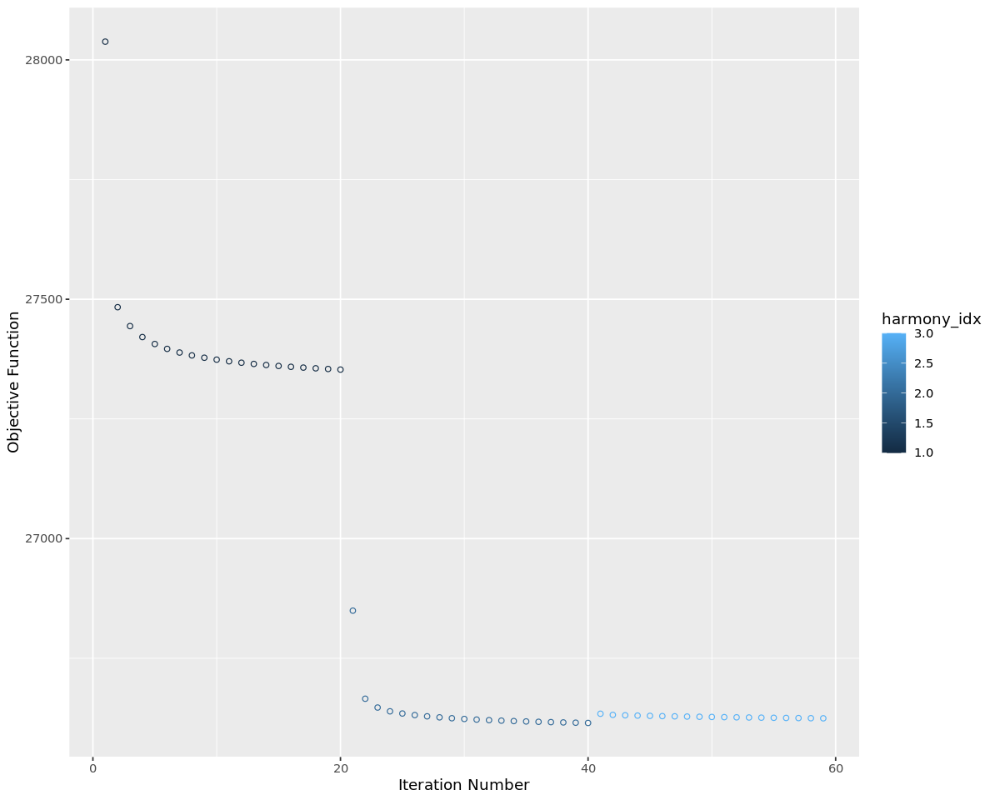

In [477]:
merFISH.hm.D2 = merFISH.hm.D2 %>%
    NormalizeData(verbose = FALSE) %>%
    FindVariableFeatures(nfeatures = 300) %>% 
    ScaleData(verbose = FALSE) %>% 
    RunPCA() %>%
    RunHarmony(group.by.vars = 'Batch',plot_convergence = TRUE) %>%
    RunUMAP(reduction = "harmony",dims = 1:20,n_threads=10,umap.method = "uwot",min.dist = 0.1,verbose = FALSE)

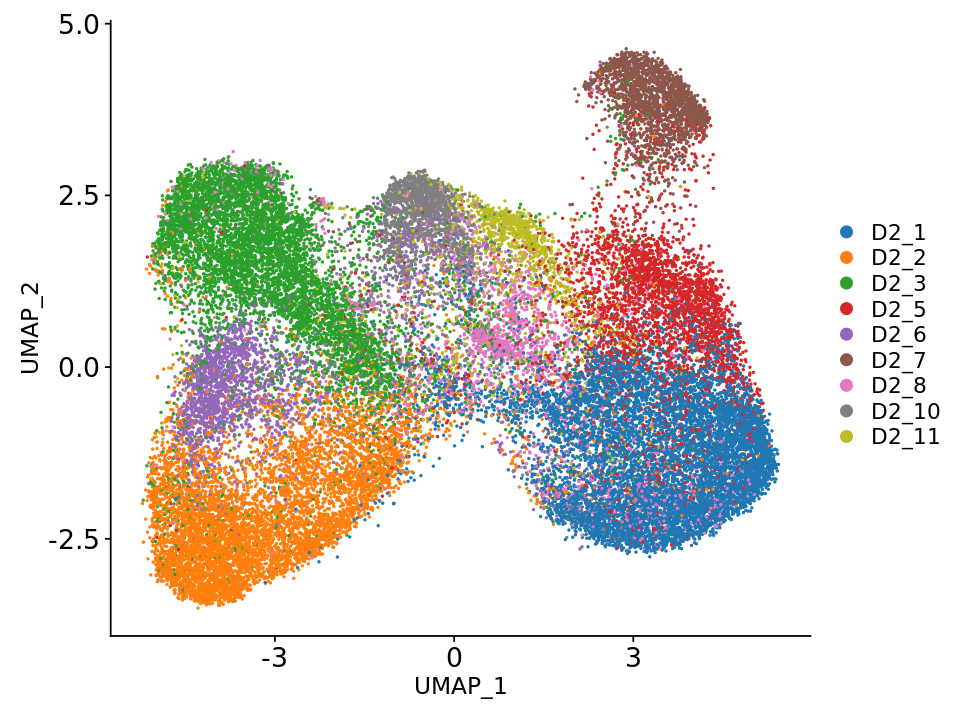

In [628]:
options(repr.plot.height = 6, repr.plot.width = 8)
p = DimPlot(merFISH.hm.D2, 
        group.by = "clusterLabel",
        label.size = 7,
            pt.size = 0.3, 
        cols = c(ggsci::pal_d3()(10),"brown", ggsci::pal_simpsons()(10)),
        label = FALSE,
        repel = TRUE)  +
        theme(axis.text = element_text(color = "black",size = 16), 
              legend.text = element_text(color = "black", size = 13)
             )  
print(p)

In [629]:
pdf("D2_merFISH_UMAP_NoNames.pdf",width=8,height = 6)
print(p)
dev.off()

png 
  2

## D2 Cell distribution by Batch

png 
  2

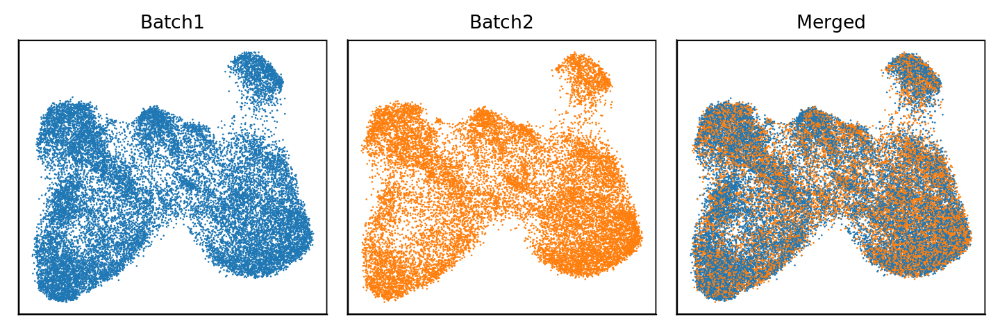

In [739]:
options(repr.plot.height = 4, repr.plot.width = 12)
p_g1= DimPlot(merFISH.hm.D2[,merFISH.hm.D2$Batch=="C"], group.by = 'Batch',pt.size = 0.1,
             cols =  ggsci::pal_d3()(10)[1],
            label = FALSE,label.size = 6) + 
            cowplot::panel_border(color = "black") + 
             theme(plot.title = element_text(hjust = 0.5,face = "plain"),
                   axis.title=element_blank(),
                   axis.text=element_blank(),
                   axis.ticks=element_blank(), legend.position = "none") + ggtitle("Batch1")

p_g2= DimPlot(merFISH.hm.D2[,merFISH.hm.D2$Batch=="D"], group.by = 'Batch',pt.size = 0.1,
             cols =  ggsci::pal_d3()(10)[2],
            label = FALSE,label.size = 6) + 
            cowplot::panel_border(color = "black") + 
             theme(plot.title = element_text(hjust = 0.5,face = "plain"),
                   axis.title=element_blank(),
                   axis.text=element_blank(),
                   axis.ticks=element_blank(),legend.position = "none") + ggtitle("Batch2")

p_g3= DimPlot(merFISH.hm.D2, group.by = 'Batch',  pt.size = 0.1,
             cols =  ggsci::pal_d3()(10),
            label = FALSE,label.size = 6) +
            cowplot::panel_border(color = "black") + 
             theme(plot.title = element_text(hjust = 0.5,face = "plain"),
                   axis.title=element_blank(),
                   axis.text=element_blank(),
                   axis.ticks=element_blank(),legend.position = "none") + ggtitle("Merged")
pdf("FigS4B.pdf",width = 12, height = 4)
print(p_g1 + p_g2 + p_g3)
dev.off()
p_g1 + p_g2 + p_g3

In [746]:
merFISH.hm.D2@meta.data$clusterLabel = droplevels(merFISH.hm.D2@meta.data$clusterLabel,)
tbl = as.matrix(table(merFISH.hm.D2@meta.data$clusterLabel, merFISH.hm.D2@meta.data$Batch))
tbl_norm = apply(tbl,1,function(x) x/sum(x))
tbl_norm_mrg = reshape2::melt(tbl_norm)
tbl_norm_mrg$value = 100 * tbl_norm_mrg$value               
colnames(tbl_norm_mrg)= c("Batch","Cluster","Percentage") 
tbl_norm_mrg$Cluster = droplevels(tbl_norm_mrg$Cluster)
head(tbl_norm_mrg)

,Batch,Cluster,Percentage
,<fct>,<fct>,<dbl>
1,C,D2_1,49.96099
2,D,D2_1,50.03901
3,C,D2_2,60.37552
4,D,D2_2,39.62448
5,C,D2_3,56.19580
6,D,D2_3,43.80420


In [747]:
levels(merFISH.hm.D2@meta.data$clusterLabel)

[1] "D2_1"  "D2_2"  "D2_3"  "D2_5"  "D2_6"  "D2_7"  "D2_8"  "D2_10" "D2_11"

png 
  2

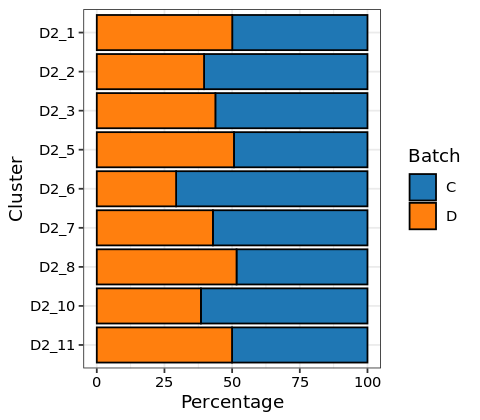

In [750]:
options(repr.plot.height = 3.5, repr.plot.width = 4)
p = ggplot(tbl_norm_mrg, aes(x=Cluster, y=Percentage, fill=Batch)) + 
                 geom_bar(stat = "identity",color="black") + 
                 #scale_fill_manual(values = ggsci::pal_d3()(10)) +
                 ggsci::scale_fill_d3() + 
                 scale_x_discrete(limits = rev(levels(tbl_norm_mrg$Cluster))) +
                 theme_bw() +coord_flip() +
                theme(axis.text = element_text(color="black"))
pdf("FigS4D.pdf",width = 4,height = 3.5)
print(p)
dev.off()
p

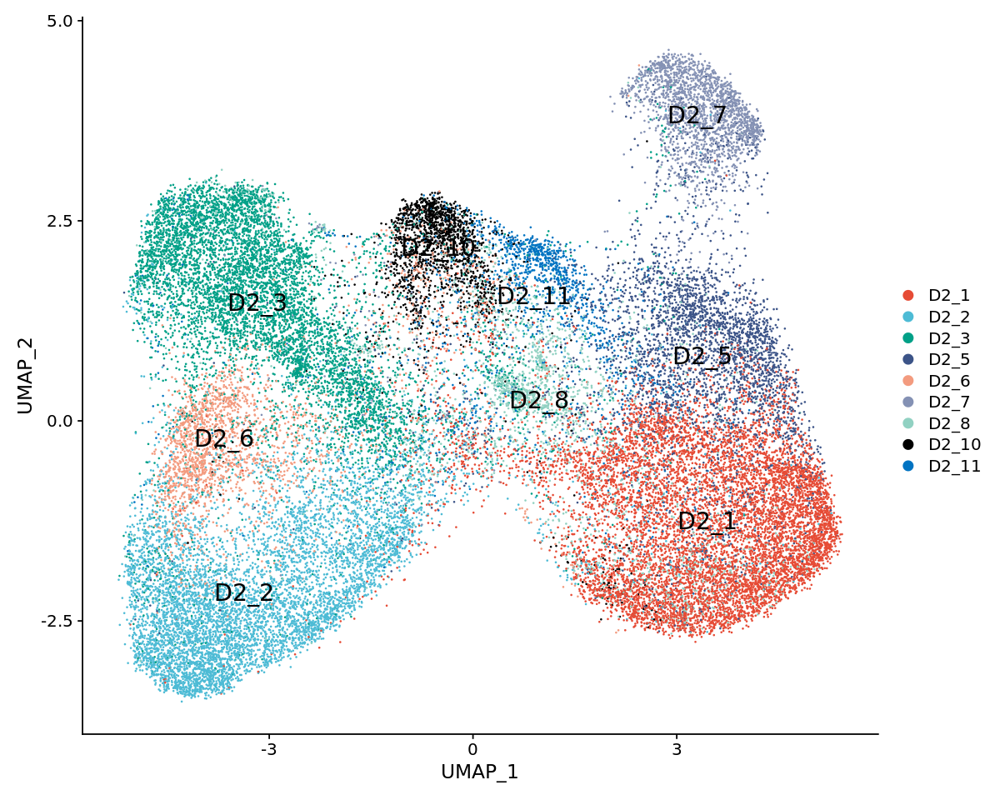

In [586]:
DimPlot(merFISH.hm.D2, group.by = "clusterLabel",label.size = 6,pt.size = 0.1, cols = c(ggsci::pal_npg()(7),"black", ggsci::pal_jco()(10)),label = TRUE)

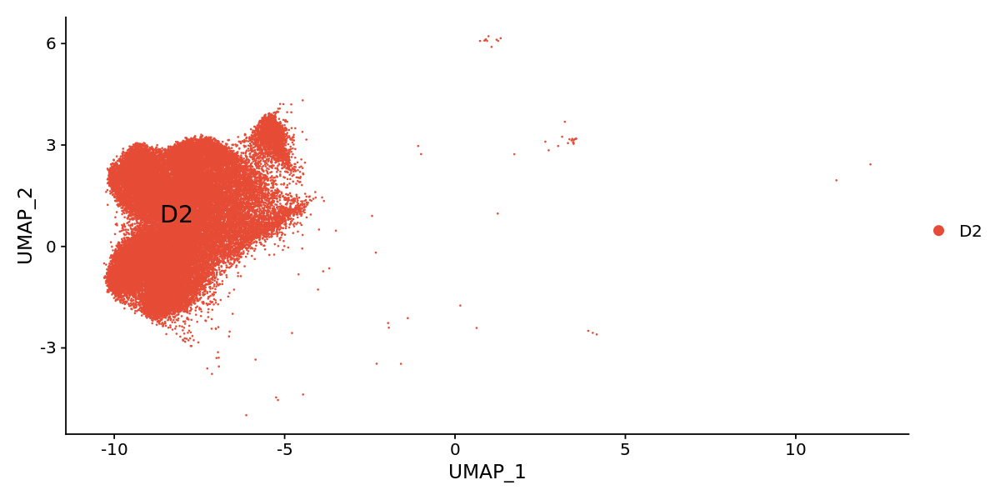

In [162]:
DimPlot(merFISH.hm.D2, group.by = "NewLabel",label.size = 6,pt.size = 0.1, cols = c(ggsci::pal_npg()(7),"black", ggsci::pal_jco()(10)),label = TRUE)

In [50]:
merFISH.hm.D2_filtered = subset(merFISH.hm.D2,  Batch == "C")

tbl = table(merFISH.hm.D2_filtered$clusterLabel, merFISH.hm.D2_filtered$sliceNumber)
tbl = tbl %>% as.matrix()
tbl = apply(tbl,1,function(x) 100 * x/sum(x))
tbl = tbl[,glue::glue("D2_{c(2,3,11,7,8,6,10,1,5)}")]
tbl

,D2_2,D2_3,D2_11,D2_7,D2_8,D2_6,D2_10,D2_1,D2_5
1,2.672195,0.42309607,0.2739726,0.000000,0.0000000,0.0000000,0.0000000,0.04461298,0.0000000
2,5.067957,4.52961672,9.0410959,3.927987,1.1807448,0.4987531,0.8249313,0.06691947,0.8375209
3,6.496199,12.91687407,10.0000000,5.482815,2.0890100,1.3715711,0.0000000,0.11153246,0.6141820
4,6.473163,16.89895470,6.8493151,6.628478,4.5413261,1.4339152,0.5499542,0.17845193,1.6192071
5,7.878369,14.95769039,11.2328767,10.065466,4.7229791,3.9900249,1.2832264,0.44612982,3.6292574
6,7.532827,15.05724241,15.8904110,11.783961,10.5358765,6.7331671,1.5582035,0.75842070,6.0859855
7,6.127620,13.68840219,15.7534247,12.274959,8.8101726,8.4164589,6.0494959,2.11911666,6.3651591
8,9.053214,7.29218517,7.8082192,10.556465,13.6239782,10.2244389,11.6406966,9.14566139,14.0703518
9,10.734854,5.52513688,6.1643836,7.610475,10.3542234,13.5910224,17.1402383,15.39147892,13.4561697
10,10.320203,4.35540070,5.6164384,7.364975,11.7166213,19.0149626,21.4482126,18.02364488,12.6186488


In [51]:
options(repr.plot.height = 4, repr.plot.width = 5)
hcols <- c("white",colorRampPalette(brewer.pal(n = 9, name ="Reds"))(10))
cl = colorRamp2(seq(0, quantile(tbl, probs = 0.90), length.out = length(hcols)), hcols)
#D2_clus_ord = glue::glue("D2_{c(9,2,8,12,6,11,5,15,10,13,1,3,7,14,4)}")
D2_clus_ord = glue::glue("D2_{c(2,3,11,7,8,6,10,1,5)}")
H = Heatmap(tbl[1:12,D2_clus_ord],#glue::glue("D2_{c(9,2,8,12,6,11,5,15,10,13,1,3,7,14,4)}")] ,
            cluster_columns = FALSE,cluster_rows = FALSE,
            col = cl,
            border = TRUE,
            rect_gp = gpar(col = "black", lwd = 1)
           )

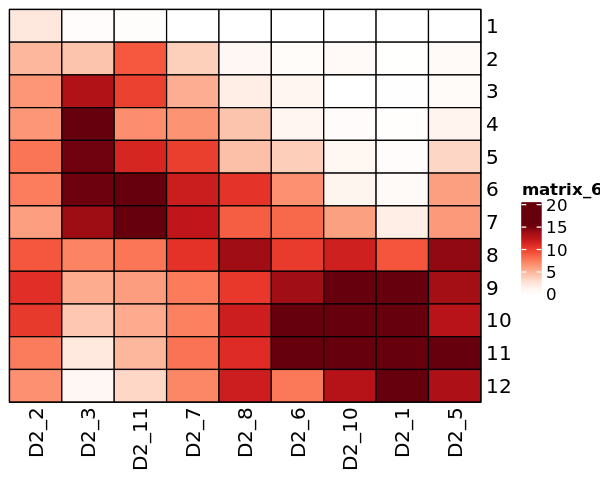

In [52]:
options(repr.plot.height = 4, repr.plot.width = 5)
H

In [54]:
pdf("D2_batchC_distribution.pdf",width=5,height = 4)
H
dev.off()

png 
  2

## Predict the identity of D1 cells

In [589]:
scD1Cells = colnames(subset(hm.integrated, CellType == "D1" & Source == "scRNASeq"))
length(scD1Cells)

[1] 12342

In [590]:
D1_cells = c(scD1Cells, colnames(merFISH.hm.D1))
length(D1_cells)

[1] 91764

In [591]:
D1_cells.hm = hm.integrated[,D1_cells]
D1_cells.hm

An object of class Seurat 
252 features across 91764 samples within 1 assay 
Active assay: RNA (252 features, 252 variable features)
 3 dimensional reductions calculated: pca, harmony, umap

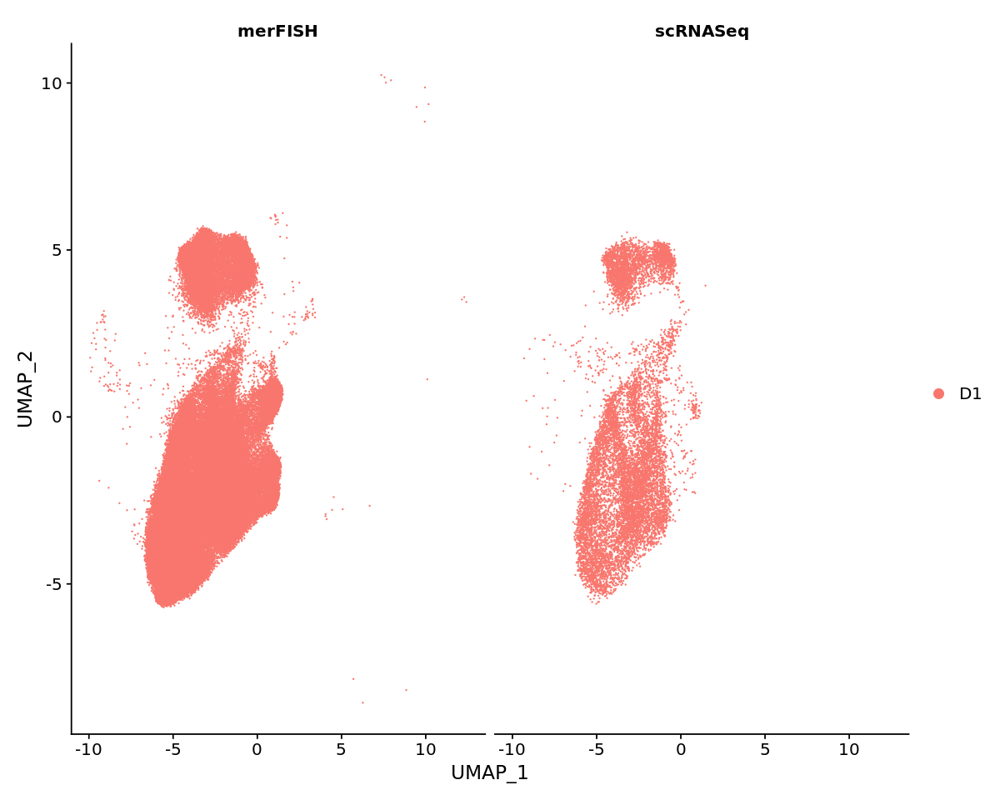

In [592]:
DimPlot(D1_cells.hm, split.by = "Source",group.by = "CellType")

### Re-run harmony to get a ore detailed assignment

Warning message:
“did not converge in 25 iterations”
Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony 4/10

Harmony 5/10

Harmony converged after 5 iterations

Warning message:
“Invalid name supplied, making object name syntactically valid. New object name is Seurat..ProjectDim.RNA.harmony; see ?make.names for more details on syntax validity”


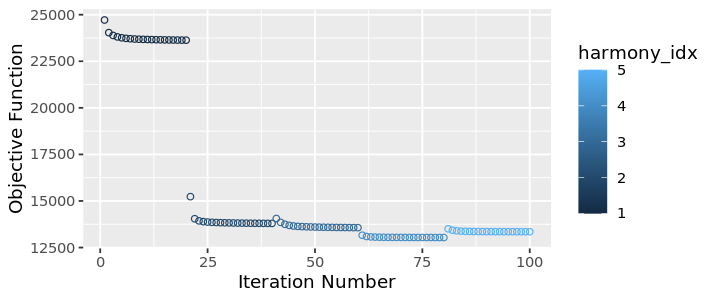

In [593]:
options(repr.plot.height = 2.5, repr.plot.width = 6)
D1.hm.integrated <- RunHarmony(
  object = D1_cells.hm,
  group.by.vars = 'Source',
plot_convergence = TRUE
)

In [594]:
# re-compute the UMAP using corrected LSI embeddings
D1.hm.integrated <- RunUMAP(D1.hm.integrated, dims = 1:20, reduction = 'harmony')

18:50:01 UMAP embedding parameters a = 0.9922 b = 1.112

18:50:01 Read 91764 rows and found 20 numeric columns

18:50:01 Using Annoy for neighbor search, n_neighbors = 30

18:50:01 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

18:50:19 Writing NN index file to temp file /tmp/RtmpH3HXgA/file30b959ce1ed2

18:50:19 Searching Annoy index using 12 threads, search_k = 3000

18:50:25 Annoy recall = 100%

18:50:26 Commencing smooth kNN distance calibration using 12 threads

18:50:35 Initializing from normalized Laplacian + noise

18:50:43 Commencing optimization for 200 epochs, with 4140160 positive edges

18:53:52 Optimization finished



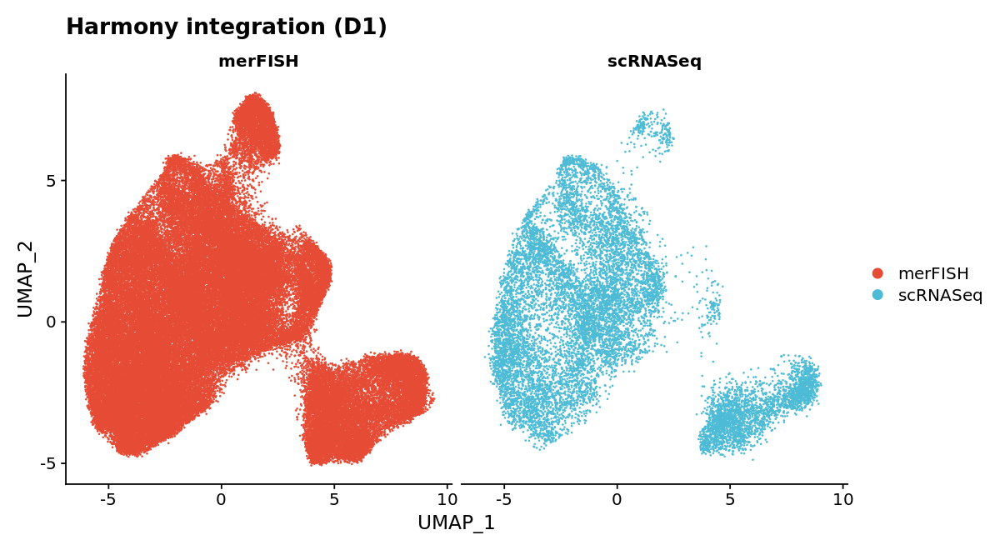

In [721]:
options(repr.plot.height = 5.5, repr.plot.width = 10)
p = DimPlot(D1.hm.integrated, group.by = 'Source',split.by = "Source", pt.size = 0.1,cols = ggsci::pal_npg()(10)) + ggplot2::ggtitle("Harmony integration (D1)")
#pdf("Interegrated_D1_umap.pdf",width = 10,height = 5.5)
#print(p)
#dev.off()
p

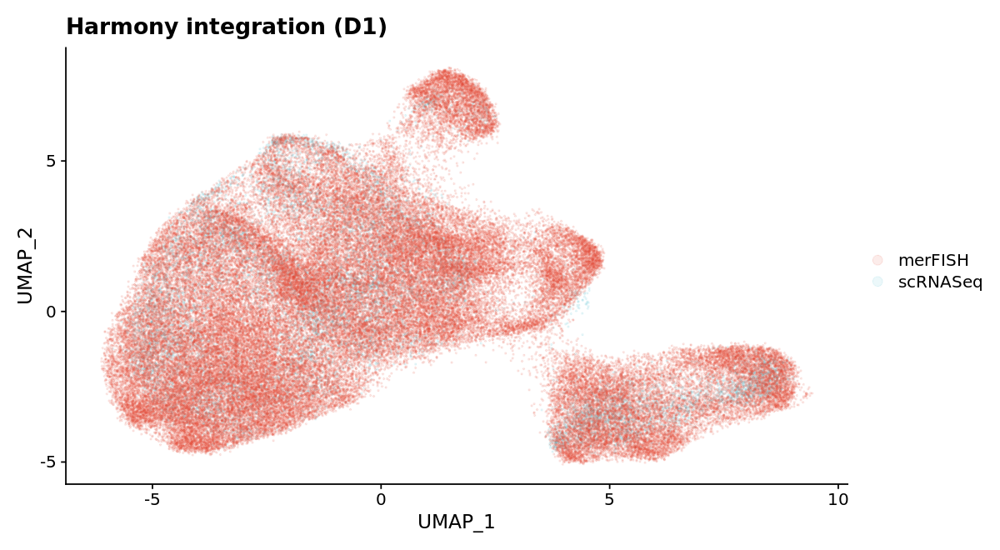

In [729]:
options(repr.plot.height = 5.5, repr.plot.width = 10)
p = DimPlot(D1.hm.integrated, group.by = 'Source', pt.size = 0.3,cols = ggsci::pal_npg()(10),combine = T) + ggplot2::ggtitle("Harmony integration (D1)")
#pdf("Interegrated_D1_umap.pdf",width = 10,height = 5.5)
#print(p)
#dev.off()
p[[1]]$layers[[1]]$aes_params$alpha = .1
p

Warning message:
“Removed 15 rows containing missing values (geom_text).”


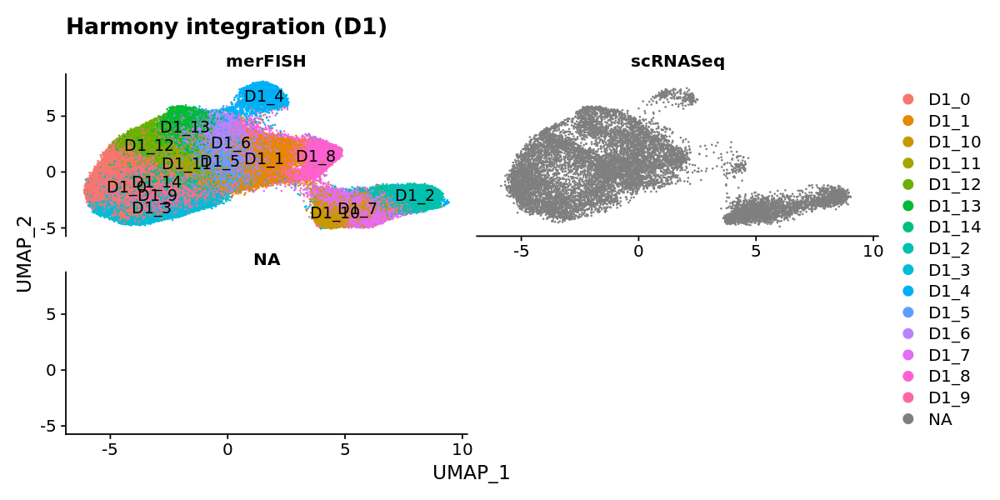

In [597]:
options(repr.plot.height = 5, repr.plot.width = 10)
D1.hm.integrated@meta.data$clusterLabel[D1.hm.integrated@meta.data$clusterLabel == ""] = "other"
DimPlot(D1.hm.integrated, group.by = 'clusterLabel',split.by = "Source", pt.size = 0.1, label=TRUE) + ggplot2::ggtitle("Harmony integration (D1)")

In [73]:
table(D1.hm.integrated@meta.data$clusterLabel)


 D1_1  D1_2  D1_3  D1_4  D1_5  D1_6  D1_7  D1_8  D1_9 D1_10 D1_11 D1_12 D1_13 
10863  8053  4858  7120  4253  5852  5162  4818  4820  4722  4199  4309  3928 
D1_14 D1_15 D1_16 D1_17 D1_18 
 3401  3064     0     0     0 

In [599]:
D1.hm.integrated@meta.data$clusterLabel = gsub("D1_","",D1.hm.integrated@meta.data$clusterLabel) %>% as.character() %>% as.numeric()
D1.hm.integrated@meta.data$clusterLabel = D1.hm.integrated@meta.data$clusterLabel + 1
D1.hm.integrated@meta.data$clusterLabel = paste0("D1_", D1.hm.integrated@meta.data$clusterLabel)
D1.hm.integrated@meta.data$clusterLabel = factor(D1.hm.integrated@meta.data$clusterLabel,levels = glue::glue("D1_{1:18}"))

In [101]:
D1_scRNASeq.hm = subset(D1.hm.integrated, Source == "scRNASeq")
D1_merFISH.hm = subset(D1.hm.integrated, Source == "merFISH")

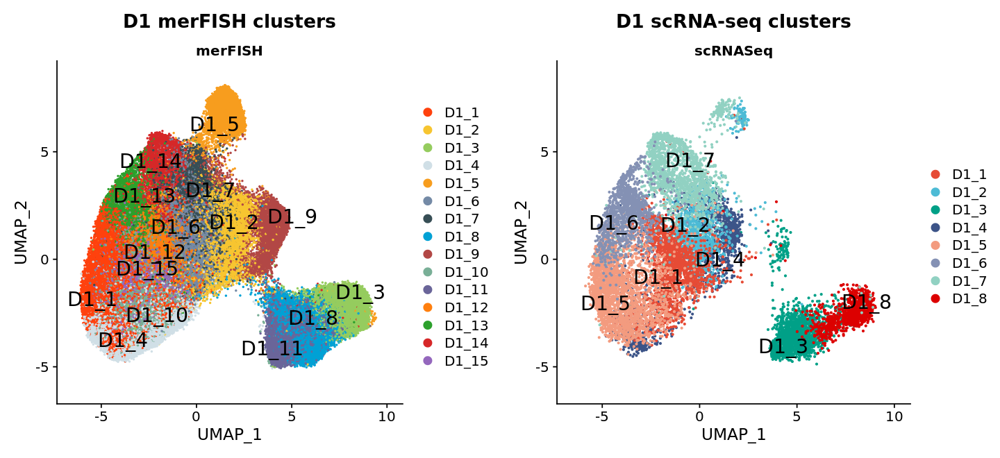

In [184]:
p1 = DimPlot(D1_merFISH.hm, 
             group.by = 'clusterLabel',
             split.by = "Source", 
             pt.size = 0.3, 
             label=TRUE,
             repel = TRUE,
             cols = c(ggsci::pal_tron()(7)[-2], ggsci::pal_jama()(6)[-2], ggsci::pal_d3()(5)[-1], ggsci::pal_simpsons()(4)), #c(ggsci::pal_npg()(10), ggsci::pal_rickandmorty()(8),ggsci::pal_d3("category20c")(20)),
             label.size = 6) + ggtitle("D1 merFISH clusters") + theme(plot.title = element_text(hjust = 0.5)) + 
             xlim(-6.5,10) + ylim(-6,8.5)

p2 = DimPlot(D1_scRNASeq.hm, 
             group.by = 'L1_Clustering',
             split.by = "Source", 
             pt.size = 0.5, 
             label=TRUE,
             repel = TRUE,
             cols = c(ggsci::pal_npg()(10), ggsci::pal_rickandmorty()(8),ggsci::pal_d3("category20c")(20)),
             label.size = 6) + ggtitle("D1 scRNA-seq clusters") + theme(plot.title = element_text(hjust = 0.5)) + 
             xlim(-6.5,10) + ylim(-6,8.5)

options(repr.plot.height = 5.5, repr.plot.width = 12)
#pdf("Interegrated_D1_scRNASeq_L1_clusters_UMAP_noNames.pdf",width = 12,height = 5.5)
#cowplot::plot_grid(p1,p2)
#dev.off()
cowplot::plot_grid(p1,p2)


In [670]:
max(p1$data$UMAP_2)

[1] 8.098794

In [662]:
p1_legend <- cowplot::get_legend(p1)
p2_legend <- cowplot::get_legend(p2)
grid.newpage()
options(repr.plot.height = 5.5, repr.plot.width = 8)
pdf("Interegrated_D1_scRNASeq_L1_clusters_UMAP_legends.pdf",width = 8,height = 5.5)
cowplot::plot_grid(p1_legend,p2_legend, labels= c("D1 merFISH legend","D1 scRNA-seq legend"))
dev.off()

png 
  2

png 
  2

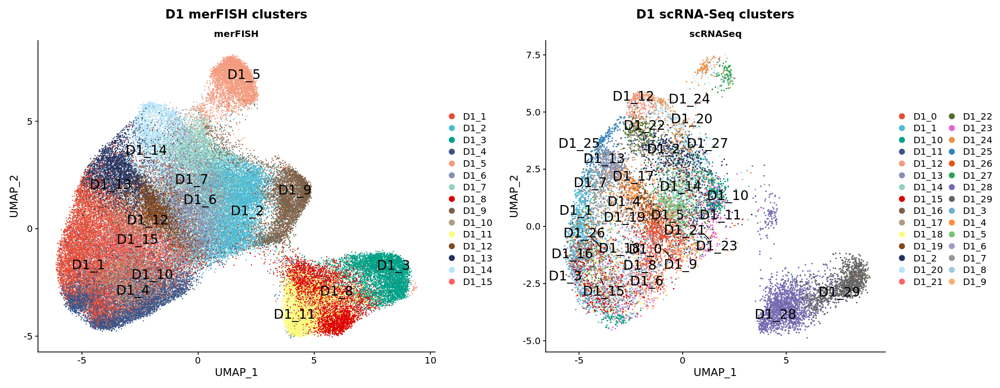

In [602]:
p1 = DimPlot(obj2, 
             group.by = 'clusterLabel',
             split.by = "Source", 
             pt.size = 0.1, 
             label=TRUE, repel = TRUE,
             cols = c(ggsci::pal_npg()(10), ggsci::pal_rickandmorty()(8),ggsci::pal_d3("category20c")(20)),
             label.size = 6) + ggtitle("D1 merFISH clusters") + theme(plot.title = element_text(hjust = 0.5))

p2 = DimPlot(obj1, repel = TRUE,
             group.by = 'L2_Clustering',
             split.by = "Source", 
             pt.size = 0.3, 
             label=TRUE,
             cols = c(ggsci::pal_npg()(10), ggsci::pal_rickandmorty()(8),ggsci::pal_d3("category20c")(20)),
             label.size = 6) + ggtitle("D1 scRNA-Seq clusters") + theme(plot.title = element_text(hjust = 0.5))

options(repr.plot.height = 7, repr.plot.width = 18)
pdf("Interegrated_D1_scRNASeq_L2_clusters_UMAP.pdf",width = 18,height = 7)
cowplot::plot_grid(p1,p2)
dev.off()
cowplot::plot_grid(p1,p2)

In [241]:
getwd()

[1] "/nfs2/nadhir/Projects/scRNA_renchao_drug_NAc/MERFISH_combined"

In [183]:
save(D1.hm.integrated, file="D1.hm.integrated.RData")

In [76]:
D1_scRNACells =  colnames(D1.hm.integrated)[which(D1.hm.integrated@meta.data$Source == "scRNASeq")]
D1_merFISHCells =  colnames(D1.hm.integrated)[which(D1.hm.integrated@meta.data$Source == "merFISH")]
D1_NN <- Seurat:::FindNN(
    object = D1.hm.integrated,
    cells1 = D1_scRNACells,
    cells2 = D1_merFISHCells,
    internal.neighbors = NULL,
    dims = 1:20,
    reduction = "harmony",
    #reduction.2 = reduction.2,
    nn.reduction = "harmony",
    k = 30,
    nn.method = "rann",
    eps = 0,
    verbose = TRUE
  )

Finding neighborhoods



In [78]:
D1_neighbors <- GetIntegrationData(object = D1_NN, integration.name = "integrated", slot = 'neighbors')
class(D1_neighbors)

[1] "list"

In [79]:
names(D1_neighbors)

[1] "nnaa"   "nnab"   "nnba"   "nnbb"   "cells1" "cells2"

In [385]:
head( D1_merFISH.hm@meta.data)

,orig.ident,percent.mito,Sample,tree.ident,CellType,L2_Clustering,L1_Clustering,nCount_RNA,nFeature_RNA,Source,sliceNumber,datasetName,clusterLabel,StriatumCells,cellType,Batch,leiden,clus,OldAnno,NewAnno
,<chr>,<dbl>,<chr>,<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>
1.03551627122072e+38,merFISH,NA,NA,NA,D1,NA,NA,222.3513,36,merFISH,13,200313_C4,D1_3,Slice13_C,D1,C,3,others,None,D1_15
1.39072088797649e+38,merFISH,NA,NA,NA,D1,NA,NA,328.7685,87,merFISH,12,200701_D3,D1_14,Slice12_D,D1,D,3,others,None,D1_10
2.68736140669033e+38,merFISH,NA,NA,NA,D1,NA,NA,562.5790,65,merFISH,2,200315_C2,D1_12,Slice2_C,D1,C,6,others,D1_4,"D1_0,2"
1.97437949745504e+38,merFISH,NA,NA,NA,D1,NA,NA,320.1653,46,merFISH,12,200309_C3,D1_3,Slice12_C,D1,C,5,others,D1_0,"D1_1,0"
1.36055939133604e+38,merFISH,NA,NA,NA,D1,NA,NA,954.4648,98,merFISH,14,200704_D4,D1_2,Slice14_D,D1,D,14,others,None,"D1_4,1"
1.94110149165846e+38,merFISH,NA,NA,NA,D1,NA,NA,417.8851,94,merFISH,9,200309_C3,D1_12,Slice9_C,D1,C,6,others,D1_4,"D1_0,0"


In [147]:
getDominatingmerD1FISHLabel <- function(x, thr=0.5){
    nn = D1_merFISH.hm@meta.data$clusterLabel[x]
    pct = table(nn)/length(x)
    res = names(pct)[which(pct>= thr)]
    if(length(res)==0){
        res ="AMBIGIOUS"
    }else{
        res = res[1]
    }
    res
    #pct
}

In [81]:
dim(D1_neighbors[['nnba']]@nn.idx)

[1] 79422    30

In [106]:
head(D1_neighbors[['nnab']]@nn.idx)

5344,4972,43835,37511,66602,76639,44055,53758,36290,3956,⋯,71038,45147,75327,42878,22219,18439,78459,67847,76059,5936
39609,46776,58026,49643,5961,57541,33151,57090,33431,37092,⋯,55562,42559,17339,16759,2516,54050,5260,19551,78052,46120
66844,42461,59645,1247,35286,75346,22819,56465,46567,75415,⋯,32066,46549,64446,38048,78622,8551,54041,24083,17944,71048
55562,53661,57560,58672,41672,5313,50498,30346,56612,37511,⋯,14425,30826,26095,69303,41952,11654,45459,42365,12501,77506
68231,64518,1432,44431,50505,38261,73422,72106,6970,9846,⋯,5972,5936,58143,30570,59692,66805,28306,61418,58740,53007
29032,8551,6090,22219,77526,7761,46549,31199,31212,45034,⋯,50452,72145,79412,76466,57838,23042,60654,13969,63747,53100


In [143]:
table(D1_merFISH.hm@meta.data$clusterLabel[ D1_neighbors[['nnab']]@nn.idx[1,] ])


 D1_1  D1_2  D1_3  D1_4  D1_5  D1_6  D1_7  D1_8  D1_9 D1_10 D1_11 D1_12 D1_13 
    0     0     0     0     0     0     0     0     0     0    30     0     0 
D1_14 D1_15 D1_16 D1_17 D1_18 
    0     0     0     0     0 

In [148]:
D1label.scRNASeq_NN = apply(D1_neighbors[['nnab']]@nn.idx,1,getDominatingmerD1FISHLabel)

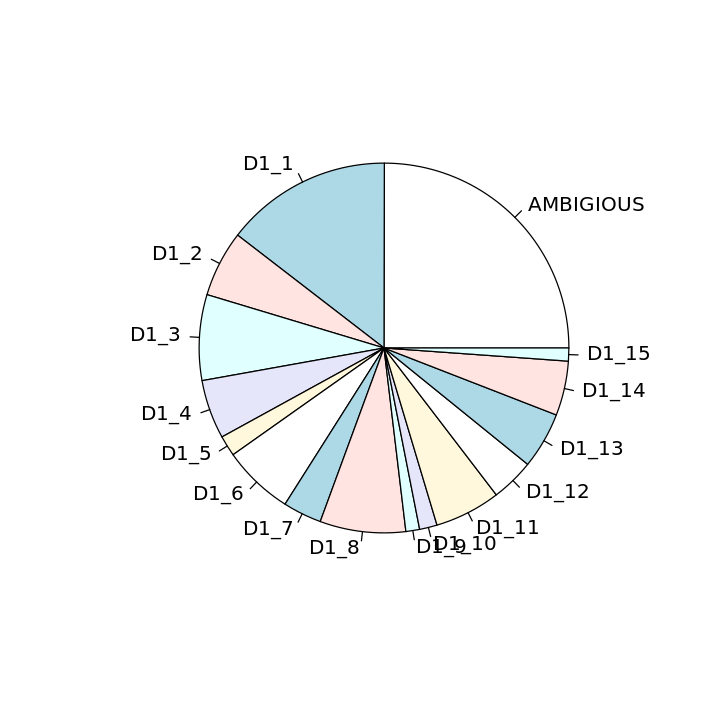

In [752]:
options(repr.plot.height = 6, repr.plot.width = 6)
pie(table(D1label.scRNASeq_NN))

In [770]:
install.packages("colorBlindness")

Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done



png 
  2

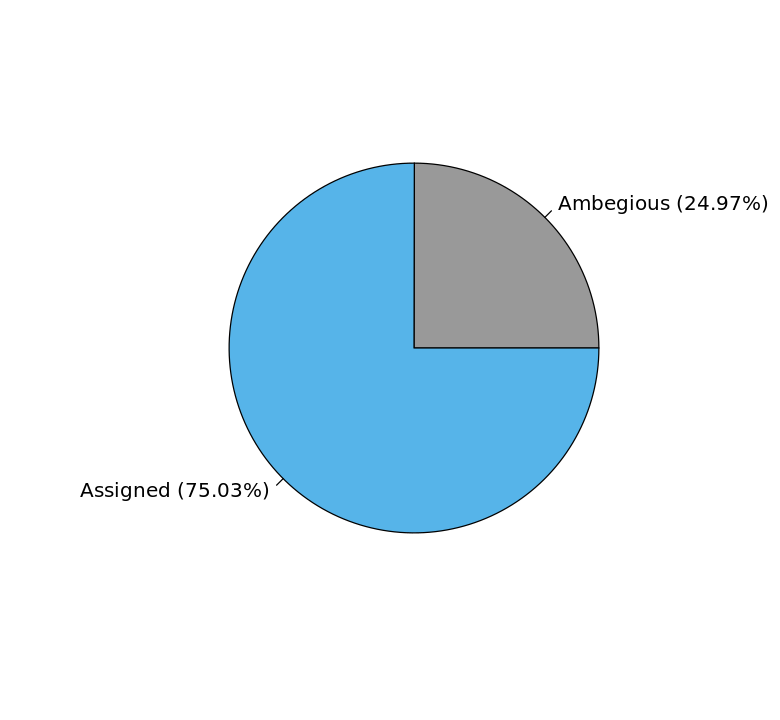

In [776]:
options(repr.plot.height = 6, repr.plot.width = 6.5)
pdf("FigS4H_D1pie.pdf",width = 6.5,height = 6)
D1_prediction_prop = ifelse(D1label.scRNASeq_NN == "AMBIGIOUS", "Ambegious","Assigned")
pct = table(D1_prediction_prop)/length(D1_prediction_prop)
pct =pct = scales::percent(as.numeric(pct),accuracy = 0.01)
lbls = paste0(names(table(D1_prediction_prop))," (",pct,")")
pie(table(D1_prediction_prop),col = c("#999999","#56B4E9"),labels = lbls)
dev.off()
pie(table(D1_prediction_prop),col = c("#999999","#56B4E9"),labels = lbls)

ERROR: Error in UseMethod("round_any"): no applicable method for 'round_any' applied to an object of class "table"


png 
  2

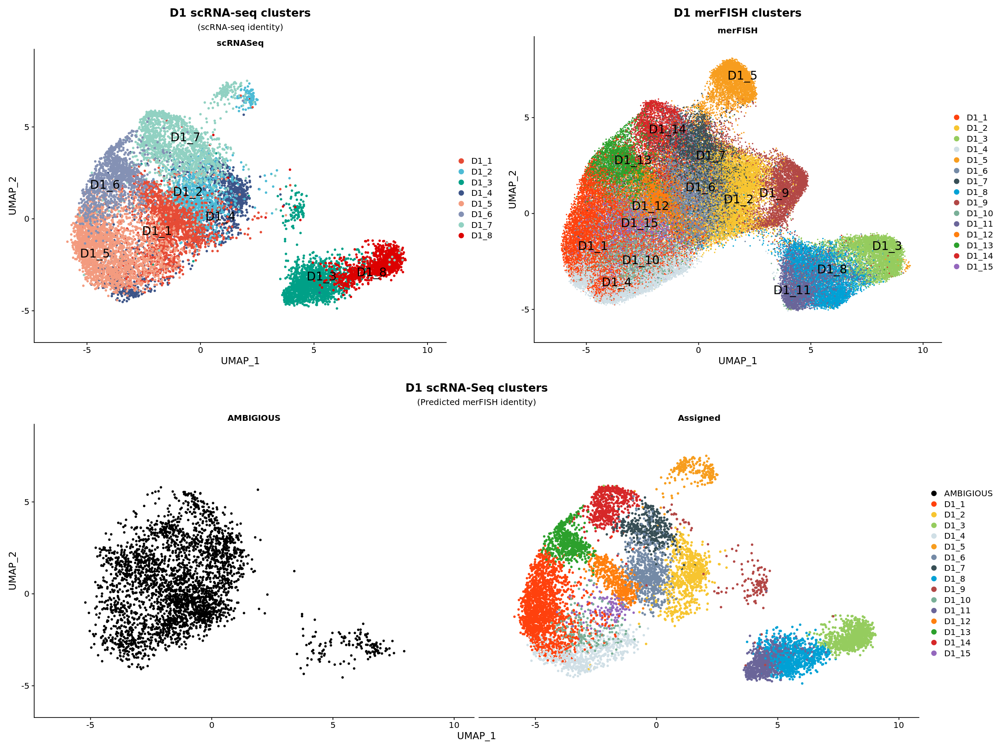

In [204]:
options(repr.plot.height = 15, repr.plot.width = 20)
D1label.scRNASeq_NN = factor(D1label.scRNASeq_NN,levels  = c("AMBIGIOUS",glue::glue("D1_{1:15}")))
Idents(D1_scRNASeq.hm) =  D1label.scRNASeq_NN
D1_scRNASeq.hm@meta.data$NN = D1label.scRNASeq_NN
D1_scRNASeq.hm@meta.data$ambigious = ifelse(D1label.scRNASeq_NN == "AMBIGIOUS","AMBIGIOUS", "Assigned")

p1 = DimPlot(D1_scRNASeq.hm, 
             group.by = 'L1_Clustering',
             split.by = "Source", 
             pt.size = 1, 
             label=TRUE,
             repel = TRUE,
             cols = c(ggsci::pal_npg()(10), ggsci::pal_rickandmorty()(8),ggsci::pal_d3("category20c")(20)),
             label.size = 6) + ggtitle("D1 scRNA-seq clusters", subtitle="(scRNA-seq identity)") + 
             theme(plot.title = element_text(hjust = 0.5),
                   plot.subtitle = element_text(hjust = 0.5)
                  ) + 
             xlim(-6.5,10) + ylim(-6,8.5)


p2 = DimPlot(D1_merFISH.hm, 
             group.by = 'clusterLabel',
             split.by = "Source", 
             pt.size = 0.3, 
             label=TRUE,
             repel = TRUE,
             cols = c(ggsci::pal_tron()(7)[-2], ggsci::pal_jama()(6)[-2], ggsci::pal_d3()(5)[-1], ggsci::pal_simpsons()(4)), #c(ggsci::pal_npg()(10), ggsci::pal_rickandmorty()(8),ggsci::pal_d3("category20c")(20)),
             label.size = 6) + ggtitle("D1 merFISH clusters") + 
             theme(plot.title = element_text(hjust = 0.5),
                   plot.subtitle = element_text(hjust = 0.5)
                  ) + 
             xlim(-6.5,10) + ylim(-6,8.5)

p3 = DimPlot(D1_scRNASeq.hm, repel = TRUE, ncol = 2,
             group.by = 'NN',
             split.by = "ambigious", 
             pt.size = 1, 
             label=FALSE,
             cols = c("black", ggsci::pal_tron()(7)[-2], ggsci::pal_jama()(6)[-2], ggsci::pal_d3()(5)[-1], ggsci::pal_simpsons()(4)),
             label.size = 6) + ggtitle("D1 scRNA-Seq clusters", subtitle="(Predicted merFISH identity)") + 
             theme(plot.title = element_text(hjust = 0.5),
                   plot.subtitle = element_text(hjust = 0.5)
                  ) +
             xlim(-6.5,10) + ylim(-6,8.5)

pdf("Predicted_scRNAseq_D1_identity.pdf",width = 20,height = 15)
toprow = cowplot::plot_grid(p1,p2, ncol = 2)
cowplot::plot_grid(toprow,p3,ncol = 1)
dev.off()
toprow = cowplot::plot_grid(p1,p2, ncol = 2)
cowplot::plot_grid(toprow,p3,ncol = 1)

In [183]:
require("seriation")

Loading required package: seriation



In [701]:
table(D1_scRNASeq.hm@meta.data$NN)/length(D1_scRNASeq.hm@meta.data$NN)


 AMBIGIOUS       D1_1       D1_2       D1_3       D1_4       D1_5       D1_6 
0.24971642 0.14576244 0.05793226 0.07486631 0.05161238 0.01806838 0.06214552 
      D1_7       D1_8       D1_9      D1_10      D1_11      D1_12      D1_13 
0.03386809 0.07494733 0.01199157 0.01539459 0.05760817 0.03775725 0.04934370 
     D1_14      D1_15 
0.04764220 0.01134338 

In [219]:
D1_similarity = table(D1_scRNASeq.hm@meta.data$NN, D1_scRNASeq.hm@meta.data$L1_Clustering) %>%  as.matrix() %>% apply(MARGIN = 2,FUN = function(x) x/sum(x))
o = seriate(max(D1_similarity) - D1_similarity, method = "BEA_TSP")
o1 = seriate(dist(D1_similarity), method = "TSP")
o2 = seriate(dist(t(D1_similarity)), method = "TSP")

In [231]:
imports <- parent.env(getNamespace('ComplexHeatmap'))
unlockBinding('dev.new', imports)
assign('dev.new', function() {}, envir = imports)

In [244]:
options(repr.plot.height = 6, repr.plot.width = 6)
hcols <- c(ggsci::pal_material("red")(10))(100)
cl = colorRamp2(seq(0, 0.7, length.out = length(hcols)), hcols)

o1 = glue::glue("D1_{c(3,8,11,14,7,6,12,2,4,1,13,5,9,10,15)}")
o2 = glue::glue("D1_{c(8,3,7,2,1,4,5,6)}")

H = Heatmap(D1_similarity[o1,o2], col = cl, name="Similarity",
            border = TRUE,cluster_columns = F,cluster_rows = F,
            rect_gp = gpar(col = "black", lwd = 1)
)
draw(H)

ERROR: Error in eval(expr, envir, enclos): attempt to apply non-function


In [232]:
H

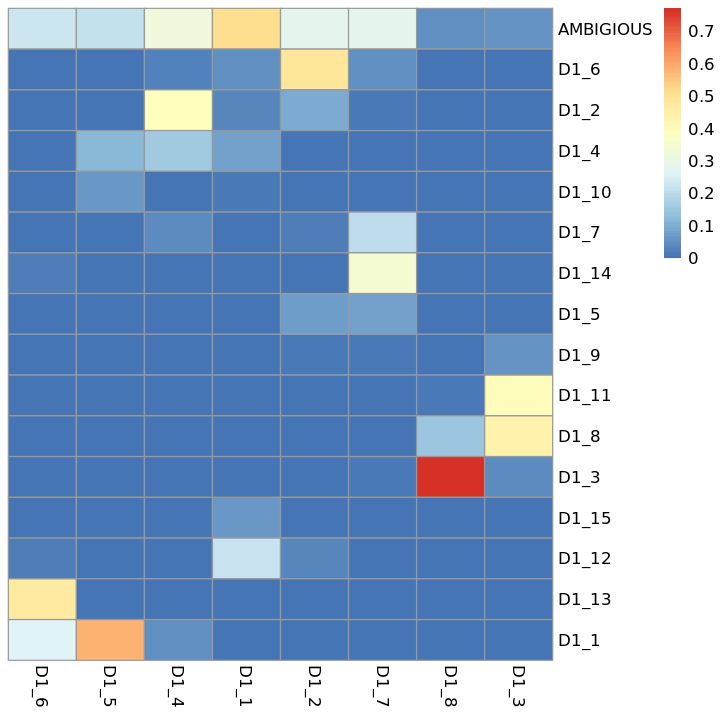

In [233]:
pheatmap(D1_similarity[get_order(o, 1),get_order(o, 2)],cluster_cols = FALSE,cluster_rows = F)

In [240]:
row_ord = apply(D1_similarity[-1,],2,which.max) %>% unique()

In [241]:
D1_similarity

,D1_1,D1_2,D1_3,D1_4,D1_5,D1_6,D1_7,D1_8
AMBIGIOUS,0.5155279503,0.282251082,0.0615735462,0.321156773,0.2119177507,0.229653505,0.2850182704,0.0508317930
D1_1,0.0045172219,0.000000000,0.0000000000,0.053272451,0.5832983634,0.254633360,0.0054811206,0.0055452865
D1_2,0.0321852061,0.097835498,0.0005701254,0.392694064,0.0012589173,0.000000000,0.0146163216,0.0009242144
D1_3,0.0000000000,0.000000000,0.0438996579,0.000000000,0.0000000000,0.000000000,0.0079171742,0.7707948244
D1_4,0.0796160361,0.000000000,0.0000000000,0.159056317,0.1204364247,0.000000000,0.0000000000,0.0000000000
D1_5,0.0011293055,0.075324675,0.0005701254,0.000000000,0.0000000000,0.001611604,0.0791717418,0.0009242144
D1_6,0.0513833992,0.480519481,0.0000000000,0.027397260,0.0008392782,0.000000000,0.0499390987,0.0009242144
D1_7,0.0000000000,0.021645022,0.0000000000,0.040334855,0.0025178347,0.001611604,0.2009744214,0.0018484288
D1_8,0.0000000000,0.000000000,0.4355758267,0.000761035,0.0000000000,0.000000000,0.0000000000,0.1478743068
D1_9,0.0050818746,0.007792208,0.0570125428,0.001522070,0.0008392782,0.000000000,0.0115712546,0.0064695009


In [243]:
save(D1_similarity, file="D1_similarity.RData")

In [242]:
row_ord

[1] 12  6  8  2  1 13 14  3

In [236]:
pheatmap(D1_similarity[row_ord,],cluster_cols = FALSE,cluster_rows = F)

ERROR: Error in rownames(mat): object 'row_ord' not found


## Find the IVSA differentially expressed genes in different stages

In [246]:
D1_scRNASeq_all = NAc_cells_all_filtered[,colnames(D1_scRNASeq.hm)]
all(colnames(D1_scRNASeq_all) == colnames(D1_scRNASeq.hm))

[1] TRUE

In [247]:
D1_scRNASeq_all@meta.data$NN = D1_scRNASeq.hm@meta.data$NN

In [256]:
D1_scRNASeq_all= SetSamplesLabels_metaData(D1_scRNASeq_all)

In [249]:
D1_scRNASeq_all = D1_scRNASeq_all[,D1_scRNASeq_all@meta.data$NN !="AMBIGIOUS"]
D1_scRNASeq_all

An object of class Seurat 
26145 features across 9260 samples within 1 assay 
Active assay: RNA (26145 features, 1052 variable features)
 3 dimensional reductions calculated: pca, ica, tsne

In [253]:
D1_scRNASeq_all@meta.data$NN = droplevels(D1_scRNASeq_all@meta.data$NN)
levels(D1_scRNASeq_all@meta.data$NN)

[1] "D1_1"  "D1_2"  "D1_3"  "D1_4"  "D1_5"  "D1_6"  "D1_7"  "D1_8"  "D1_9" 
[10] "D1_10" "D1_11" "D1_12" "D1_13" "D1_14" "D1_15"

In [257]:
table(D1_scRNASeq_all@meta.data$Period)


 Maintenance withdraw_15d withdraw_48h 
        2645         3905         2710 

In [251]:
require(SC2P)

Loading required package: SC2P

Loading required package: Biobase

Loading required package: BiocGenerics

Loading required package: parallel


Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:parallel’:

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport, clusterMap, parApply, parCapply, parLapply,
    parLapplyLB, parRapply, parSapply, parSapplyLB


The following objects are masked from ‘package:dplyr’:

    combine, intersect, setdiff, union


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    anyDuplicated, append, as.data.frame, basename, cbind, colnames,
    dirname, do.call, duplicated, eval, evalq, Filter, Find, get, grep,
    grepl, intersect, is.unsorted, lapply, Map, mapply, match, mget,
    order, paste, pmax, pmax.int, pmin, pmin.int, Position, rank,
    rbind, Reduce, rownames, sapply, setdiff, sort, table, tapply,
  

In [273]:
NAc_D1_sc_merfish_DEG <- list()
for(clus in levels(D1_scRNASeq_all@meta.data$NN) ){
  NAc_D1_sc_merfish_DEG[[clus]] <- list()
  for(period in unique(D1_scRNASeq_all@meta.data$Period)){
      message(paste("cluster",clus,"period",period))
      NAc_D1_sc_merfish_DEG[[clus]][[period]] <- list()
      tmp_sobj <- subset(D1_scRNASeq_all, NN == clus & Period == period)
      
    Y = as.matrix(tmp_sobj[['RNA']]@counts)
    # remove extreme values
    #outlayer = quantile(Y,0.99)
    nbCells = apply(Y,1,function(x) sum(x>0))
    Y = Y[nbCells>=3,]
    #qt = apply(Y, 2, quantile,0.90)
    #Y = Y[,qt>0]
    
    # Remove problematic cells
    Cell0 = colMeans(Y == 0)
    par1 = apply(Y, 2, function(yy) {
                          yy = yy[yy <= 15]
                          SC2P:::RobustPoi0(yy)
                          })
       
    pi0.hat = Cell0/(par1[1, ] + (1 - par1[1, ]) * dpois(0, par1[2,]))
    
    tokeep = which(pi0.hat<=1)  
    Y = Y[,tokeep]
    
    qt = apply(Y, 2, quantile,0.99)
    Y = Y[,qt>1]
    
    design = tmp_sobj@meta.data[,c("nCount_RNA","treatment")]
    design$treatment = factor(design$treatment,levels = c("Saline","Cocaine"))
    design$class = as.numeric(design$treatment)
    design = design[colnames(Y),]
    
    if(min(table(design$treatment))>3){
      
      #tmp_sobj <- SetIdent(tmp_sobj,ident.use = tmp_sobj@meta.data$treatment)
      #ae = AverageDetectionRate(tmp_sobj)[rownames(Y),]
      #rm = apply(ae, 1, max)
      #Y = Y[rm>=0.1,]
      NAc_D1_sc_merfish_DEG[[clus]][[period]] =tryCatch({
      phenoData <- new("AnnotatedDataFrame", data=design)
      eset <- ExpressionSet(assayData=Y, phenoData=phenoData)
      data <- eset2Phase(eset,low.prob = 0.9)
      twoPhaseDE(data, design=c("treatment"), test.which=1, offset="sf")
      }, error = function(cond){return(NA)})
    }
  }
}

cluster D1_1 period withdraw_48h

Warning message:
“Partial NA coefficients for 275 probe(s)”
cluster D1_1 period withdraw_15d

Warning message:
“Partial NA coefficients for 293 probe(s)”
cluster D1_1 period Maintenance

Warning message:
“Partial NA coefficients for 301 probe(s)”
cluster D1_2 period withdraw_48h

Warning message:
“Partial NA coefficients for 247 probe(s)”
cluster D1_2 period withdraw_15d

Warning message:
“Partial NA coefficients for 287 probe(s)”
cluster D1_2 period Maintenance

Warning message:
“Partial NA coefficients for 254 probe(s)”
cluster D1_3 period withdraw_48h

Warning message:
“Partial NA coefficients for 134 probe(s)”
cluster D1_3 period withdraw_15d

Warning message:
“Partial NA coefficients for 168 probe(s)”
cluster D1_3 period Maintenance

Warning message:
“Zero sample variances detected, have been offset away from zero”
Warning message:
“Partial NA coefficients for 204 probe(s)”
cluster D1_4 period withdraw_48h

Warning message:
“Partial NA coefficient

In [285]:
names(NAc_D1_sc_merfish_DEG)

[1] "D1_1"  "D1_2"  "D1_3"  "D1_4"  "D1_5"  "D1_6"  "D1_7"  "D1_8"  "D1_9" 
[10] "D1_10" "D1_11" "D1_12" "D1_13" "D1_14" "D1_15"

In [315]:
dir.create("D1_DEG",showWarnings = FALSE)
NAc_D1_sc_merfish_DEG_sig = list()

for(cellType in names(NAc_D1_sc_merfish_DEG)){
  
  NAc_D1_sc_merfish_DEG_sig[[cellType]] =  list()
  for(period in names(NAc_D1_sc_merfish_DEG[[cellType]])){
    
    NAc_D1_sc_merfish_DEG_sig[[cellType]][[period]] = list()
    
    if(is.data.frame(NAc_D1_sc_merfish_DEG[[cellType]][[period]])){
      df1  = topGene(NAc_D1_sc_merfish_DEG[[cellType]][[period]],phase = "both",
          number = 30000,p.value = 0.05)
      NAc_D1_sc_merfish_DEG_sig[[cellType]][[period]] <- subset(df1, Phase2 == "Y")
      fname = paste0("D1_DEG/",cellType, "_",period, "_DEG.csv")
      write.csv(NAc_D1_sc_merfish_DEG_sig[[cellType]][[period]],fname)
    }
  }
}

In [286]:
NAc_D1_sc_merfish_nbDEG_perCluster <- data.frame()

for(period in names(NAc_D1_sc_merfish_DEG[[1]])){
  for(clus in names(NAc_D1_sc_merfish_DEG)){
    
    if(is.data.frame(NAc_D1_sc_merfish_DEG[[clus]][[period]])){
      df1  = topGene(NAc_D1_sc_merfish_DEG[[clus]][[period]],phase = "both",
          number = 30000,p.value = 0.05)
      tmp1 <- subset(df1, Phase2 == "Y")
      
      df = data.frame(cluster=clus, period = period, nbDEG=nrow(tmp1))
      
      NAc_D1_sc_merfish_nbDEG_perCluster <- rbind(NAc_D1_sc_merfish_nbDEG_perCluster,df)  
    }
  }
}


NAc_D1_sc_merfish_nbDEG_perCluster$cluster <- factor(NAc_D1_sc_merfish_nbDEG_perCluster$cluster, 
                                               levels = paste0("D1_",1:15))

NAc_D1_sc_merfish_nbDEG_perCluster <- subset(NAc_D1_sc_merfish_nbDEG_perCluster, nbDEG > 0)

In [18]:
df1  = topGene(NAc_D1_sc_merfish_DEG[['D1_2']][['withdraw_15d']],phase = "both",number = 30000,p.value = 0.05)
tmp1 <- subset(df1, Phase2 == "Y")
tmp1

,Gene.name,p1,p2,Ph1.coef,Ph1.fdr,m1,m2,Ph2.coef,marLogFC,Ph2.fdr,Phase1,Phase2,Comb.fdr,Category
,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>
1,Ppp1r1b,0.464,0.847,1.85,1.6e-05,3.8,4.4,0.58,0.84987,1.4e-11,Y,Y,4.0e-11,++
2,Rtn1,0.946,0.993,2.13,5.3e-01,4.6,5.0,0.40,0.52429,3.7e-10,N,Y,1.0e-09,++
4,Rab3a,0.571,0.860,1.53,2.1e-03,3.6,4.1,0.46,0.70165,5.2e-09,Y,Y,1.1e-08,++
5,Fkbp1a,0.429,0.820,1.80,1.6e-05,3.6,4.1,0.49,0.71319,1.1e-07,Y,Y,2.4e-07,++
7,Slc25a3,0.125,0.527,2.05,1.3e-05,3.2,3.8,0.64,0.93190,4.0e-04,Y,Y,1.1e-05,++
8,Itm2b,0.125,0.487,1.89,8.9e-05,3.1,3.6,0.48,0.79362,3.5e-02,Y,Y,1.3e-04,++
10,Ppia,0.929,0.820,-1.05,5.3e-01,4.4,4.1,-0.29,-0.23396,1.3e-04,N,Y,1.8e-04,--
12,Penk,0.018,0.033,0.64,7.6e-01,3.2,5.0,1.75,0.16082,6.0e-04,N,Y,9.6e-04,++
13,mt-Nd1,NA,NA,NA,NA,5.6,5.4,-0.23,-0.12138,2.6e-03,NA,Y,4.5e-03,NA


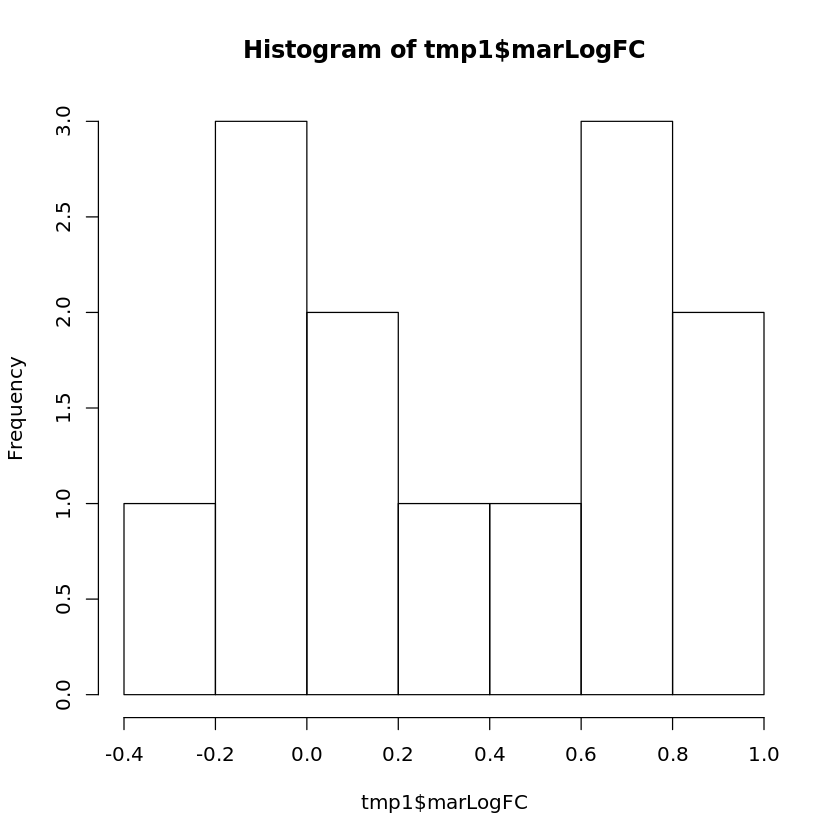

In [14]:
tmp1$marLogFC = as.numeric(tmp1$marLogFC)
hist(tmp1$marLogFC)

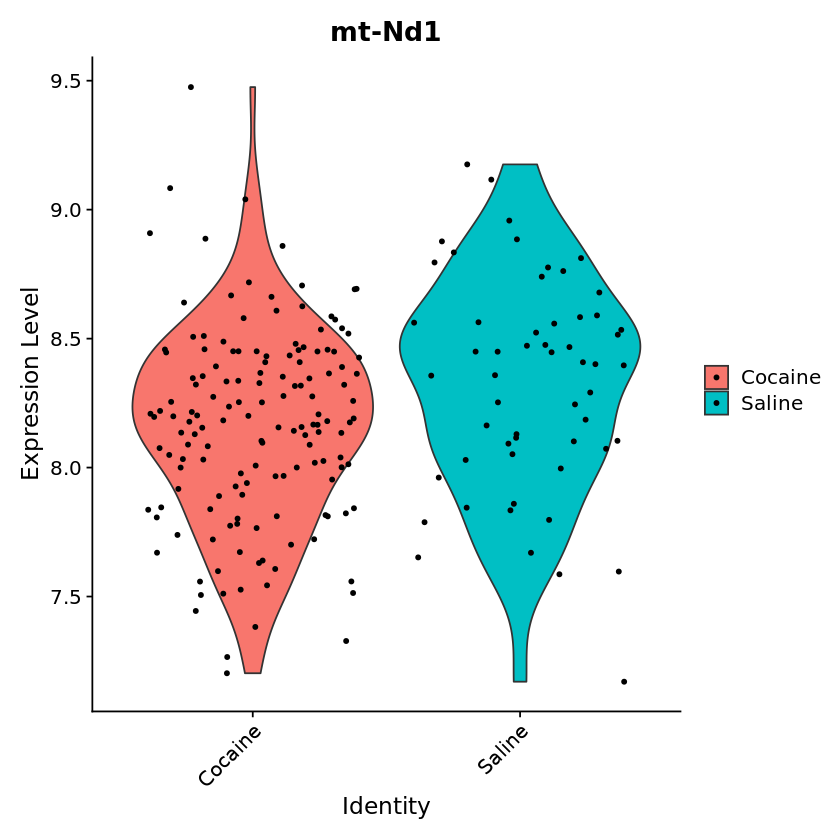

In [20]:
tmp_sobj = subset(D1_scRNASeq_all, NN == "D1_2" & Period == "withdraw_15d")
VlnPlot(tmp_sobj, "mt-Nd1",group.by = "treatment" )

In [874]:
levels(NAc_D1_sc_merfish_nbDEG_perCluster$cluster)

[1] "D1_1"  "D1_2"  "D1_3"  "D1_4"  "D1_5"  "D1_6"  "D1_7"  "D1_8"  "D1_9" 
[10] "D1_10" "D1_11" "D1_12" "D1_13" "D1_14" "D1_15"

png 
  2

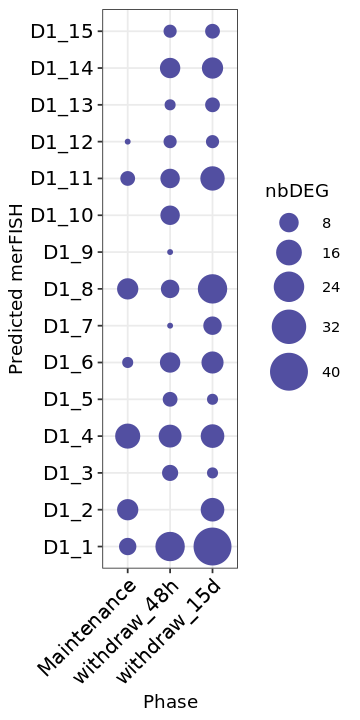

In [913]:
options(repr.plot.height = 6, repr.plot.width = 3)
NAc_D1_sc_merfish_nbDEG_perCluster$period =  factor(NAc_D1_sc_merfish_nbDEG_perCluster$period, c("Maintenance","withdraw_48h","withdraw_15d"))
NAc_D1_sc_merfish_nbDEG_perCluster = subset(NAc_D1_sc_merfish_nbDEG_perCluster, !is.na(cluster))
p = ggplot(NAc_D1_sc_merfish_nbDEG_perCluster, aes(x=period, y=cluster)) + 
    geom_point(aes(size=nbDEG),color="#524FA1") +   
    scale_size(breaks = seq(0,max(NAc_D1_sc_merfish_nbDEG_perCluster$nbDEG),length.out = 6), range = c(1,10)) +
    theme_bw() + 
    scale_color_viridis_c(option = "B") + 
    theme(axis.text = element_text(colour = "black",size = 12),axis.text.x = element_text(angle = 45,hjust = 1)) + 
    xlab("Phase") + ylab("Predicted merFISH") 
    #scale_size(breaks = seq(10,to = 130,by = 30),range = c(1,8))
pdf("D1_merFISH_clusters_DEG.pdf",width = 3,height = 6,useDingbats = FALSE)
print(p)
dev.off()
p

In [850]:
tmp = paste0(D1_scRNASeq_all$NN,"_",D1_scRNASeq_all$Period)
res= table(tmp, D1_scRNASeq_all$treatment)
res = res %>% as.data.frame()
write.csv(res, file='Number_of_D1_cell_perTreatment.csv')
res

tmp,Var2,Freq
<fct>,<fct>,<int>
D1_1_Maintenance,Cocaine,234
D1_1_withdraw_15d,Cocaine,431
D1_1_withdraw_48h,Cocaine,372
D1_10_Maintenance,Cocaine,28
D1_10_withdraw_15d,Cocaine,39
D1_10_withdraw_48h,Cocaine,31
D1_11_Maintenance,Cocaine,82
D1_11_withdraw_15d,Cocaine,164
D1_11_withdraw_48h,Cocaine,149


In [888]:
write.csv(NAc_D1_sc_merfish_nbDEG_perCluster,"NAc_D1_nbDEG_perCluster.csv")

##### Mark the D1 up and down genes for each cluster

In [63]:
NAc_D1_sc_merfish_DEGDirection_perCluster <- data.frame()

for(period in names(NAc_D1_sc_merfish_DEG[[1]])){
  for(clus in names(NAc_D1_sc_merfish_DEG)){
    
    if(is.data.frame(NAc_D1_sc_merfish_DEG[[clus]][[period]])){
      df1  = topGene(NAc_D1_sc_merfish_DEG[[clus]][[period]],phase = "both",
          number = 30000,p.value = 0.05)
      tmp1 <- subset(df1, Phase2 == "Y")
      if(nrow(tmp1)>0){
          tmp1$marLogFC = as.numeric(tmp1$marLogFC)
         tmp1$Direction = ifelse(tmp1$marLogFC>0,1,-1)
          tmp1$Cluster = clus
          tmp1$Period = period

          NAc_D1_sc_merfish_DEGDirection_perCluster <- rbind(NAc_D1_sc_merfish_DEGDirection_perCluster,tmp1)    
      }
      
    }
  }
}

In [64]:
subset(NAc_D1_sc_merfish_DEGDirection_perCluster, Cluster == "D1_2")

,Gene.name,p1,p2,Ph1.coef,Ph1.fdr,m1,m2,Ph2.coef,marLogFC,Ph2.fdr,Phase1,Phase2,Comb.fdr,Category,Direction,Cluster,Period
,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<dbl>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<dbl>,<chr>,<chr>
122,Ppp1r1b,0.464,0.847,1.85,1.6e-05,3.8,4.4,0.58,0.84987,1.4e-11,Y,Y,4.0e-11,++,1,D1_2,withdraw_15d
216,Rtn1,0.946,0.993,2.13,5.3e-01,4.6,5.0,0.40,0.52429,3.7e-10,N,Y,1.0e-09,++,1,D1_2,withdraw_15d
49,Rab3a,0.571,0.860,1.53,2.1e-03,3.6,4.1,0.46,0.70165,5.2e-09,Y,Y,1.1e-08,++,1,D1_2,withdraw_15d
58,Fkbp1a,0.429,0.820,1.80,1.6e-05,3.6,4.1,0.49,0.71319,1.1e-07,Y,Y,2.4e-07,++,1,D1_2,withdraw_15d
78,Slc25a3,0.125,0.527,2.05,1.3e-05,3.2,3.8,0.64,0.93190,4.0e-04,Y,Y,1.1e-05,++,1,D1_2,withdraw_15d
88,Itm2b,0.125,0.487,1.89,8.9e-05,3.1,3.6,0.48,0.79362,3.5e-02,Y,Y,1.3e-04,++,1,D1_2,withdraw_15d
104,Ppia,0.929,0.820,-1.05,5.3e-01,4.4,4.1,-0.29,-0.23396,1.3e-04,N,Y,1.8e-04,--,-1,D1_2,withdraw_15d
123,Penk,0.018,0.033,0.64,7.6e-01,3.2,5.0,1.75,0.16082,6.0e-04,N,Y,9.6e-04,++,1,D1_2,withdraw_15d
131,mt-Nd1,NA,NA,NA,NA,5.6,5.4,-0.23,-0.12138,2.6e-03,NA,Y,4.5e-03,NA,-1,D1_2,withdraw_15d


In [795]:
tmp_merfish = D1_merFISH.hm

In [7]:
merFISH_sobj2 = LoadH5Seurat("MERFISH_10192020.h5seurat")

Validating h5Seurat file

Initializing RNA with data

Adding counts for RNA

Adding scale.data for RNA

Adding feature-level metadata for RNA

Adding reduction pca

Adding cell embeddings for pca

Adding feature loadings for pca

Adding miscellaneous information for pca

Adding reduction pca_harmony

Adding cell embeddings for pca_harmony

Adding miscellaneous information for pca_harmony

Warning message:
“Cannot add objects with duplicate keys (offending key: PC_), setting key to 'pca_harmony_'”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from pca_harmony_ to pcaharmony_”
Adding reduction tsne

Adding cell embeddings for tsne

Adding miscellaneous information for tsne

Adding reduction umap

Adding cell embeddings for umap

Adding miscellaneous information for umap

Adding command information

Adding cell-level metadata

Adding miscellaneous information

Adding tool-specific results



In [10]:
100 * sum(merFISH_sobj2$clusterLabel %in% c("D1_15","D1_17"))/length(merFISH_sobj2$clusterLabel)

[1] 2.140222

In [11]:
100 * sum(merFISH_sobj2$clusterLabel %in% c("D2_8","D2_11"))/length(merFISH_sobj2$clusterLabel)

[1] 1.914549

In [854]:
merFISH_sobj2 = subset(merFISH_sobj2, Batch == "C")
merFISH_sobj2 =  merFISH_sobj2[,!merFISH_sobj2$clusterLabel %in% c("D1_15","D1_17","D2_8","D2_11")]
merFISH_sobj2

An object of class Seurat 
253 features across 102534 samples within 1 assay 
Active assay: RNA (253 features, 0 variable features)
 4 dimensional reductions calculated: pca, pca_harmony, tsne, umap

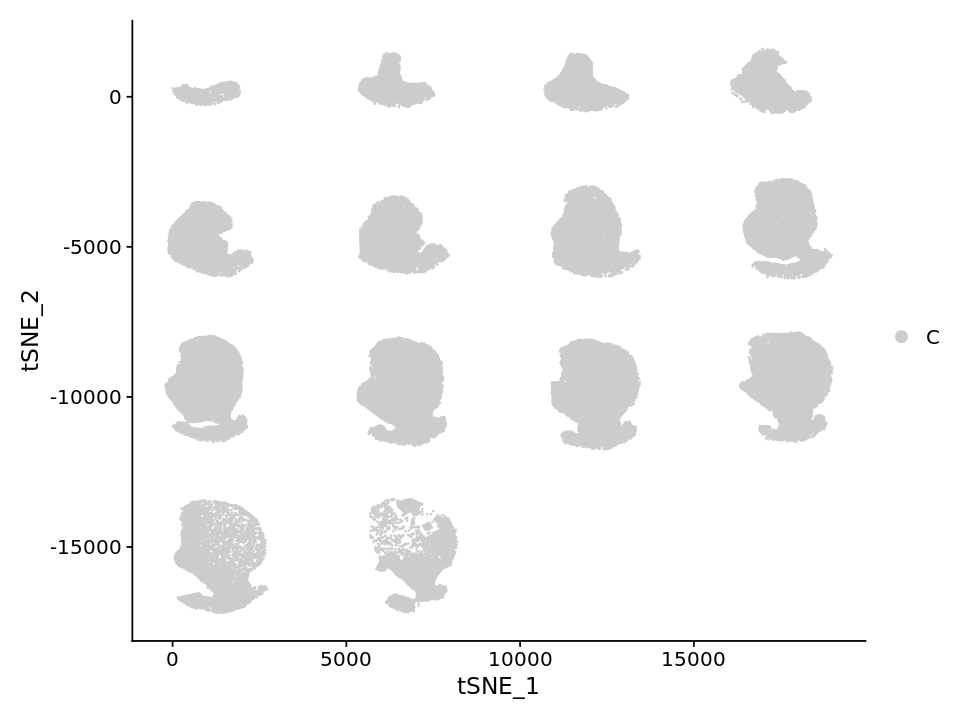

In [855]:
options(repr.plot.height = 6, repr.plot.width = 8)
DimPlot(merFISH_sobj2,reduction="tsne",pt.size=0.1,group.by = "Batch",cols = "grey80")

In [860]:
period_info

,cluster,period,nbDEG
,<fct>,<fct>,<int>
31,D1_1,Maintenance,6
32,D1_2,Maintenance,10
34,D1_4,Maintenance,15
36,D1_6,Maintenance,2
38,D1_8,Maintenance,10
41,D1_11,Maintenance,4
42,D1_12,Maintenance,1


In [864]:
merFISH_sobj2@meta.data$Maintenance_D1 = NULL
merFISH_sobj2@meta.data$withdraw_15d_D1 = NULL
merFISH_sobj2@meta.data$withdraw_15d_D1 = NULL

In [865]:
for(prd in c("Maintenance","withdraw_15d","withdraw_48h")){
  period_info = subset(NAc_D1_sc_merfish_nbDEG_perCluster, period == prd)

  prd_stats = rep(0, ncol(merFISH_sobj2))
  names(prd_stats) = colnames(merFISH_sobj2)
  prd2 = glue::glue("{prd}_D1")
  merFISH_sobj2 <- AddMetaData(
                          object = merFISH_sobj2,
                          metadata = prd_stats,
                          col.name = prd2
                          )

  for(cls in unique(period_info$cluster)){
      cls2 = gsub("D1_","",cls)
      cls2 = as.numeric(cls2) - 1
      cls2 = paste0("D1_",cls2)
      pos <- which(merFISH_sobj2$clusterLabel == cls2)
      merFISH_sobj2@meta.data[pos,prd2] = log2(period_info[period_info$cluster == cls,"nbDEG"]+1)
  }
}

In [869]:
period_info[period_info$cluster == cls,"nbDEG"]

[1] 3

In [868]:
period_info

,cluster,period,nbDEG
,<fct>,<fct>,<int>
1,D1_1,withdraw_48h,22
3,D1_3,withdraw_48h,5
4,D1_4,withdraw_48h,12
5,D1_5,withdraw_48h,4
6,D1_6,withdraw_48h,9
7,D1_7,withdraw_48h,1
8,D1_8,withdraw_48h,7
9,D1_9,withdraw_48h,1
10,D1_10,withdraw_48h,8


In [813]:
head(merFISH_sobj2@meta.data)

,sliceNumber,datasetName,clusterLabel,StriatumCells,cellType,Batch,leiden,clus,OldAnno,NewAnno,nCount_RNA,nFeature_RNA,Maintenance_D1,withdraw_15d_D1,withdraw_48h_D1
,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
103551627122072073245851421418447753725,13,200313_C4,D1_3,Slice13_C,D1,C,3,others,None,D1_15,13.52270,37,0,2,5
268736140669032937428209746906723454236,2,200315_C2,D1_12,Slice2_C,D1,C,6,others,D1_4,"D1_0,2",18.48190,68,1,3,3
81645940757337081112739058805786368214,8,200315_C2,oligodendrocytes,Slice8_C,oligodendrocytes,C,1,others,oligodendrocytes,oligodendrocytes,17.08464,52,0,0,0
197437949745504478723575359089176185027,12,200309_C3,D1_3,Slice12_C,D1,C,5,others,D1_0,"D1_1,0",15.70082,48,0,2,5
10706161249668503295186101042911076593,5,200315_C2,astrocytes,Slice5_C,astrocytes,C,4,others,astrocytes,astrocytes,11.19443,30,0,0,0
145041395275153477475309649172132004106,3,200309_C3,OPCs,Slice3_C,OPCs,C,12,others,OPCs,OPCs,19.38171,86,0,0,0


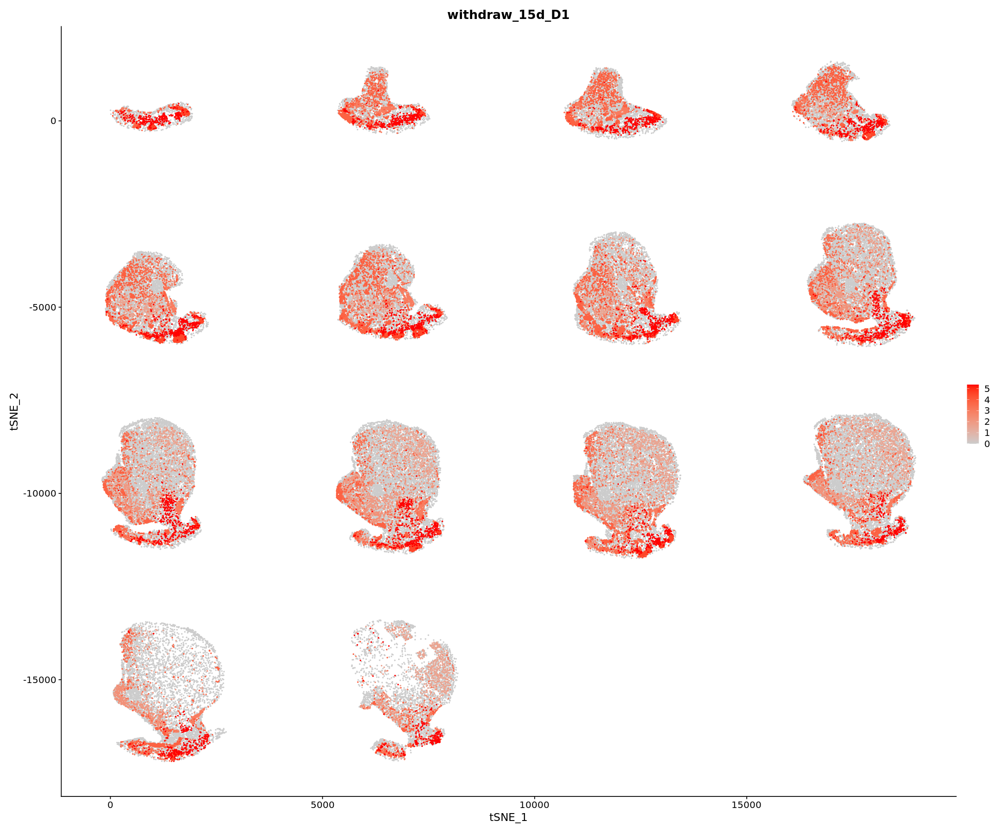

In [837]:
options(repr.plot.height = 15, repr.plot.width = 18)
FeaturePlot(merFISH_sobj2,"withdraw_15d_D1",reduction = "tsne",cols = c("grey80",'red'),pt.size = 0.3,order = TRUE)

In [268]:
tmp_sobj <- subset(D1_scRNASeq_all, NN == clus & Period == period)
tmp_sobj

An object of class Seurat 
26145 features across 613 samples within 1 assay 
Active assay: RNA (26145 features, 1052 variable features)
 3 dimensional reductions calculated: pca, ica, tsne

In [262]:
table(D1_scRNASeq_all@meta.data$NN, paste0( D1_scRNASeq_all@meta.data$Period,"_", D1_scRNASeq_all@meta.data$treatment))

       
        Maintenance_Cocaine Maintenance_Saline withdraw_15d_Cocaine
  D1_1                  234                286                  431
  D1_2                  182                156                  150
  D1_3                   61                102                  361
  D1_4                  131                 94                  149
  D1_5                   19                 25                   87
  D1_6                  114                115                  219
  D1_7                   64                 50                  152
  D1_8                  128                168                  257
  D1_9                   28                 23                   44
  D1_10                  28                 21                   39
  D1_11                  82                109                  164
  D1_12                  68                 54                  139
  D1_13                  99                 53                  178
  D1_14                  37             

In [263]:
table(D1_scRNASeq_all@meta.data$NN,  D1_scRNASeq_all@meta.data$Period)

       
        Maintenance withdraw_15d withdraw_48h
  D1_1          520          666          613
  D1_2          338          206          171
  D1_3          163          497          264
  D1_4          225          238          174
  D1_5           44          116           63
  D1_6          229          332          206
  D1_7          114          208           96
  D1_8          296          357          272
  D1_9           51           55           42
  D1_10          49           66           75
  D1_11         191          266          254
  D1_12         122          222          122
  D1_13         152          284          173
  D1_14         110          331          147
  D1_15          41           61           38

## FIND D1 markers

In [459]:
table(merFISH.hm.D1@meta.data$clusterLabel)


 D1_1  D1_2  D1_3  D1_4  D1_5  D1_6  D1_7  D1_8  D1_9 D1_10 D1_11 D1_12 D1_13 
10863  8053  4858  7120  4253  5852  5162  4818  4820  4722  4199  4309  3928 
D1_14 D1_15 D1_16 D1_17 D1_18 
 3401  3064     0     0     0 

In [460]:
merFISH.hm.D1@meta.data$clusterLabel = factor(merFISH.hm.D1@meta.data$clusterLabel,levels = glue::glue("D1_{1:15}"))

In [34]:
Idents(merFISH.hm.D1) = merFISH.hm.D1@meta.data$clusterLabel
D1_mrks = FindAllMarkers(merFISH.hm.D1)

In [495]:
head(D1_mrks)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
Calb1,0,2.478430,0.861,0.326,0,D1_1,Calb1
Igfbp4,0,2.339353,0.577,0.311,0,D1_1,Igfbp4
Ddit4l,0,2.000909,0.530,0.203,0,D1_1,Ddit4l
Ebf1,0,1.785372,0.506,0.181,0,D1_1,Ebf1
Reln,0,1.766907,0.820,0.333,0,D1_1,Reln
Rgs10,0,1.304186,0.599,0.342,0,D1_1,Rgs10


In [496]:
write.csv(D1_mrks, file="D1_markers.csv")

In [16]:
D1_mrks = readr::read_csv("D1_markers.csv")

Warning message:
“Missing column names filled in: 'X1' [1]”
Parsed with column specification:
cols(
  X1 = col_character(),
  p_val = col_double(),
  avg_log2FC = col_double(),
  pct.1 = col_double(),
  pct.2 = col_double(),
  p_val_adj = col_double(),
  cluster = col_character(),
  gene = col_character()
)



In [18]:
newNames = D1_mrks$cluster
newNames[D1_mrks$cluster == "D1_1"] = "D1_DS1"
newNames[D1_mrks$cluster == "D1_10"] = "D1_DS2"
newNames[D1_mrks$cluster == "D1_15"] = "D1_DS3"
newNames[D1_mrks$cluster == "D1_4"] = "D1_DS4"
newNames[D1_mrks$cluster == "D1_12"] = "D1_NA1"
newNames[D1_mrks$cluster == "D1_13"] = "D1_NA2"
newNames[D1_mrks$cluster == "D1_14"] = "D1_NA3"
newNames[D1_mrks$cluster == "D1_6"] = "D1_NA4"
newNames[D1_mrks$cluster == "D1_2"] = "D1_OT1"
newNames[D1_mrks$cluster == "D1_7"] = "D1_OT2"
newNames[D1_mrks$cluster == "D1_9"] = "D1_OT3"
newNames[D1_mrks$cluster == "D1_3"] = "D1_AT1"
newNames[D1_mrks$cluster == "D1_8"] = "D1_AT2"
newNames[D1_mrks$cluster == "D1_11"] = "D1_AT3"
newNames[D1_mrks$cluster == "D1_5"] = "D1_IC"

D1_mrks$MERFISH_Cluster= newNames
D1_mrks = subset(D1_mrks, avg_log2FC > 0)
D1_mrks$X1=NULL
readr::write_csv(D1_mrks,"MERFISH_D1_markers.csv")

In [19]:
head(D1_mrks)

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene,MERFISH_Cluster
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>
0,2.478430,0.861,0.326,0,D1_1,Calb1,D1_DS1
0,2.339353,0.577,0.311,0,D1_1,Igfbp4,D1_DS1
0,2.000909,0.530,0.203,0,D1_1,Ddit4l,D1_DS1
0,1.785372,0.506,0.181,0,D1_1,Ebf1,D1_DS1
0,1.766907,0.820,0.333,0,D1_1,Reln,D1_DS1
0,1.304186,0.599,0.342,0,D1_1,Rgs10,D1_DS1


In [42]:
D1_selected_markers = subset(D1_mrks, (pct.1-pct.2)/pct.1 > 0.35 )
table(D1_selected_markers$cluster)


 D1_1  D1_2  D1_3  D1_4  D1_5  D1_6  D1_7  D1_8  D1_9 D1_10 D1_11 D1_12 D1_13 
   18     9    38    17    38     6    15    20    29    10    28    17    30 
D1_14 D1_15 
   37    11 

In [45]:
D1_markers = D1_selected_markers$gene


In [46]:
pdf("D1_markers.pdf",width = 25,height = 8 * ceiling(length(D1_markers))/35 )
cols = generateColors(nbCols = length(unique(D1_selected_markers$cluster)))
names(cols) = levels(Idents(merFISH.hm.D1))
plotMarkersHeatmap_v3(
        merFISH.hm.D1,
        markers = D1_markers,
        clustersColors = cols,
      slotToUse = "data",
        #markerClusters = clus_names,
        #identlevels = clus_lvls,
        clusterCols = FALSE
      )
  dev.off()

png 
  2

In [327]:
getwd()

[1] "/nfs2/nadhir/Projects/scRNA_renchao_drug_NAc/MERFISH_combined"

In [47]:
pdf("D1_markers_withoutNames.pdf",width = 8,height = 3 )
cols = generateColors(nbCols = length(unique(D1_selected_markers$cluster)))
names(cols) = levels(Idents(merFISH.hm.D1))
plotMarkersHeatmap_v3(
        merFISH.hm.D1,
        markers = D1_markers,
        clustersColors = cols,
    show_gene_names = FALSE,
      slotToUse = "data",
        #markerClusters = clus_names,
        #identlevels = clus_lvls,
        clusterCols = FALSE
      )
  dev.off()

png 
  2

In [409]:
D1_sim = table(D1_scRNASeq.hm@meta.data$L1_Clustering, D1label.scRNASeq_NN)
D1_sim

      D1label.scRNASeq_NN
       D1_0 D1_1 D1_10 D1_11 D1_12 D1_13 D1_14 D1_2 D1_3 D1_4 D1_5 D1_6 D1_7
  D1_1    1   14     0   106     0     0    12    0   46    0    7    0    0
  D1_2    0   31     0     2     0     0     0    0    0   81  138    4    0
  D1_3    0    1   406     1     0     0     0   47    0    1    0    0  437
  D1_4   13  288     0     0     0     0     0    0  131    0    1    9    1
  D1_5  828    0     0     0     1     0     2    0   77    0    0    0    0
  D1_6  165    0     0     1   353     7     0    0    0    1    0    0    0
  D1_7    1    3     0     0     1   372     0   10    0  112   12   92    0
  D1_8    1    0     4     0     0     1     1  777    0    1    0    0   82
      D1label.scRNASeq_NN
       D1_8 D1_9 NULL
  D1_1    0    8 1577
  D1_2    0    0  899
  D1_3  110    0  751
  D1_4    2    0  869
  D1_5    1   40 1434
  D1_6    0    0  714
  D1_7    0    0 1039
  D1_8    2    0  213

In [397]:
D1_mat = as.data.frame.matrix(D1_sim) %>% data.matrix()
D1_mat

,D1_0,D1_1,D1_10,D1_11,D1_12,D1_13,D1_14,D1_2,D1_3,D1_4,D1_5,D1_6,D1_7,D1_8,D1_9,NULL
D1_1,0,7,0,28,0,0,3,0,25,0,1,0,0,0,2,1705
D1_2,0,17,0,0,0,0,0,0,0,79,35,0,0,0,0,1024
D1_3,0,1,293,0,0,0,0,32,0,1,0,0,311,94,0,1022
D1_4,4,193,0,0,0,0,0,0,73,0,1,1,1,0,0,1041
D1_5,495,0,0,0,0,0,1,0,35,0,0,0,0,0,21,1831
D1_6,99,0,0,0,244,3,0,0,0,1,0,0,0,0,0,894
D1_7,0,3,0,0,0,277,0,7,0,106,0,26,0,0,0,1223
D1_8,1,0,0,0,0,1,0,747,0,1,0,0,51,2,0,279


In [398]:
D1_mat = as.data.frame.matrix(D1_sim) %>% data.matrix()
D1_mat_norm = pheatmap:::scale_rows(D1_mat)
D1_mat_norm

,D1_0,D1_1,D1_10,D1_11,D1_12,D1_13,D1_14,D1_2,D1_3,D1_4,D1_5,D1_6,D1_7,D1_8,D1_9,NULL
D1_1,-0.26029258,-0.2438314,-0.2602926,-0.1944478,-0.2602926,-0.2602926,-0.2532378,-0.2602926,-0.20150261,-0.26029258,-0.2579410,-0.2602926,-0.26029258,-0.26029258,-0.2555894,3.749183
D1_2,-0.28344016,-0.2166906,-0.2834402,-0.2834402,-0.2834402,-0.2834402,-0.2834402,-0.2834402,-0.28344016,0.02674890,-0.1460146,-0.2834402,-0.28344016,-0.28344016,-0.2834402,3.737238
D1_3,-0.41540643,-0.4116171,0.6948703,-0.4154064,-0.4154064,-0.4154064,-0.4154064,-0.2941475,-0.41540643,-0.41161708,-0.4154064,-0.4154064,0.76307839,-0.05920844,-0.4154064,3.457299
D1_4,-0.29983599,0.4255272,-0.3151876,-0.3151876,-0.3151876,-0.3151876,-0.3151876,-0.3151876,-0.03502084,-0.31518760,-0.3113497,-0.3113497,-0.31134970,-0.31518760,-0.3151876,3.680067
D1_5,0.74411032,-0.3202483,-0.3202483,-0.3202483,-0.3202483,-0.3202483,-0.3180981,-0.3202483,-0.24499063,-0.32024831,-0.3202483,-0.3202483,-0.32024831,-0.32024831,-0.2750937,3.616804
D1_6,0.09447543,-0.3418193,-0.3418193,-0.3418193,0.7334929,-0.3285982,-0.3418193,-0.3418193,-0.34181928,-0.33741226,-0.3418193,-0.3418193,-0.34181928,-0.34181928,-0.3418193,3.598054
D1_7,-0.33402563,-0.3242612,-0.3340256,-0.3340256,-0.3340256,0.5675588,-0.3340256,-0.3112419,-0.33402563,0.01098501,-0.3340256,-0.2494004,-0.33402563,-0.33402563,-0.3340256,3.646616
D1_8,-0.34320062,-0.3483518,-0.3483518,-0.3483518,-0.3483518,-0.3432006,-0.3483518,3.4996161,-0.34835185,-0.34320062,-0.3483518,-0.3483518,-0.08563918,-0.33804939,-0.3483518,1.088841


[1] "D1_1" "D1_4" "D1_5" "D1_6" "D1_7" "D1_8" "D1_2" "D1_3"

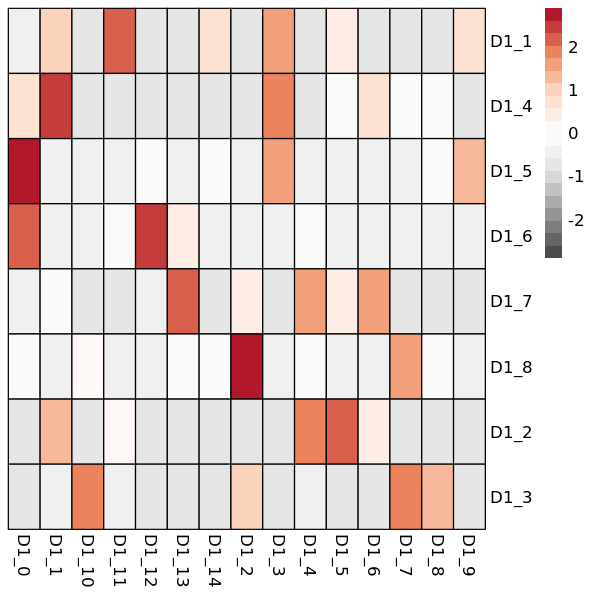

In [418]:
D1_sim = table(D1_scRNASeq.hm@meta.data$L1_Clustering, D1label.scRNASeq_NN)

D1_mat = as.data.frame.matrix(D1_sim) %>% data.matrix()
D1_mat_norm = pheatmap:::scale_rows(D1_mat)
col = colorRampPalette(rev(brewer.pal(n = 7, name ="RdGy")))(20)
options(repr.plot.height = 5, repr.plot.width = 5)

labels_order <- c()
for(cls in colnames(D1_mat)[1:15]){
  D1_mat_norm = D1_mat[order(D1_mat[,cls],decreasing = T),1:15]
  
  pos <- which(D1_mat[,cls]>0)
  
  labels_order <- c(labels_order, rownames(D1_mat)[pos])
}

labels_order = unique(labels_order)
labels_order

#pdf("MainCellTypes_D1_similarity.pdf",width=5,height = 5)
pheatmap(log2(D1_mat+1)[labels_order,1:15],cluster_cols = FALSE,cluster_rows = FALSE,scale = "row",color = col,border_color = "black")
#dev.off()
#pheatmap(log2(D1_mat+1)[,c(1:6,8:9,7)],cluster_cols = FALSE,cluster_rows = FALSE,scale = "row",color = col,border_color = "black")

In [427]:
table(D1_merFISH.hm@meta.data$StriatumCells)


 Slice1_C Slice10_C Slice10_D Slice11_C Slice11_D Slice12_C Slice12_D Slice13_C 
      747      5219      3276      5338      4893      4469      5339      2195 
Slice13_D Slice14_C Slice14_D  Slice2_C  Slice3_C  Slice4_C  Slice4_D  Slice5_C 
     5972      1806      3622      1796      2117      2194       424      3393 
 Slice5_D  Slice6_C  Slice6_D  Slice7_C  Slice7_D  Slice8_C  Slice8_D  Slice9_C 
      709      3714      1522      3991      2049      4536      3571      4240 
 Slice9_D 
     4714 

Warning message:
“This manual palette can handle a maximum of 7 values. You have supplied 10.”


png 
  2

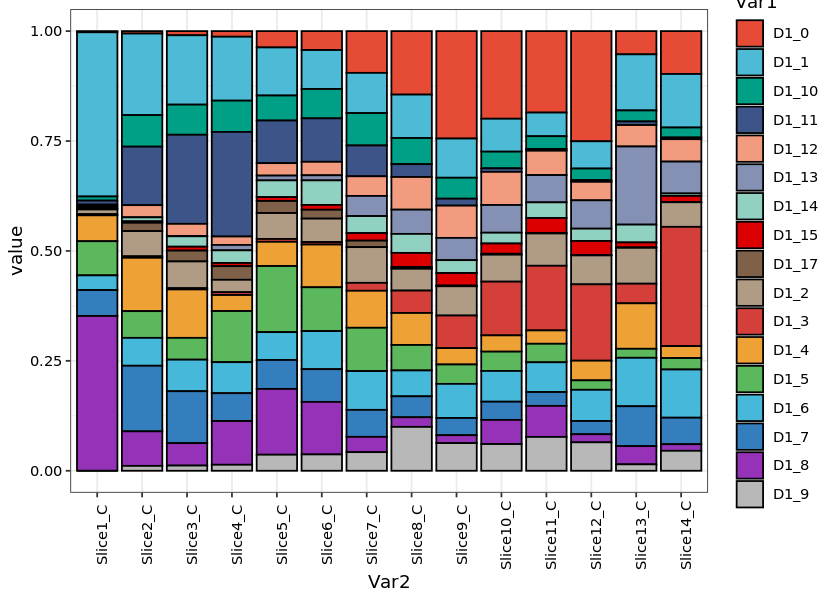

In [450]:
D1_batchC = subset(D1_merFISH.hm, Batch == "C")
tbl = as.matrix(table(D1_batchC@meta.data$clusterLabel, D1_batchC@meta.data$StriatumCells))
tbl_norm = apply(tbl,2,function(x) x/sum(x))
tbl_norm_mrg = reshape2::melt(tbl_norm)
                 
options(repr.plot.height = 5, repr.plot.width = 7)
tbl_norm_mrg$Var2 = factor(tbl_norm_mrg$Var2,levels = glue::glue("Slice{1:14}_C"))

p = ggplot(tbl_norm_mrg, aes(x=Var2, y=value, fill=Var1)) + geom_bar(stat = "identity",color="black") + 
                 scale_fill_manual(values = c(ggsci::pal_npg()(10), ggsci::pal_locuszoom()(10) )) +
                 #ggsci::scale_fill_npg() + 
                 theme_bw() +
theme(axis.text = element_text(color="black"),axis.text.x = element_text(angle = 90))
pdf("D1_dist_perSlice_BatchC.pdf",width = 9,height = 5)
print(p)
dev.off()
p

Warning message:
“This manual palette can handle a maximum of 7 values. You have supplied 10.”


png 
  2

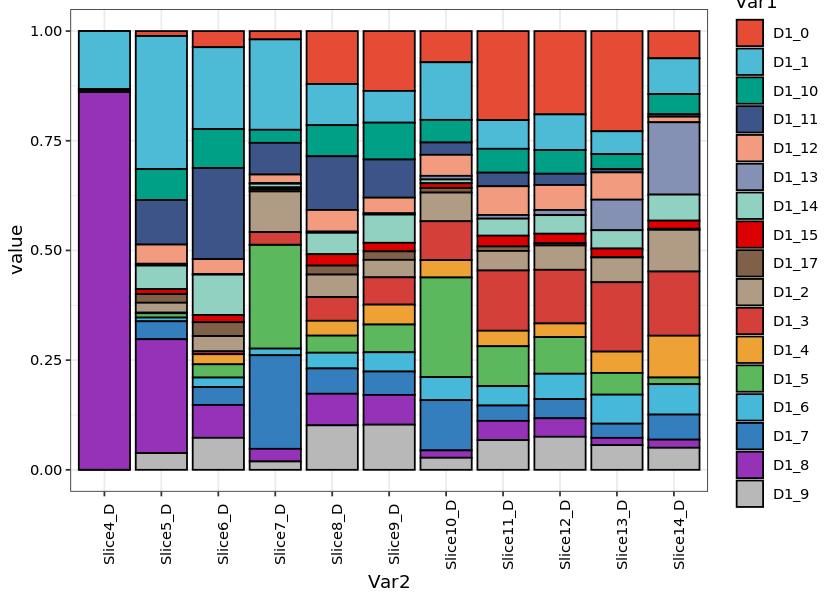

In [449]:
D1_batchD = subset(D1_merFISH.hm, Batch == "D")
tbl = as.matrix(table(D1_batchD@meta.data$clusterLabel, D1_batchD@meta.data$StriatumCells))
tbl_norm = apply(tbl,2,function(x) x/sum(x))
tbl_norm_mrg = reshape2::melt(tbl_norm)
                 
options(repr.plot.height = 5, repr.plot.width = 7)
tbl_norm_mrg$Var2 = factor(tbl_norm_mrg$Var2,levels = glue::glue("Slice{1:14}_D"))

p = ggplot(tbl_norm_mrg, aes(x=Var2, y=value, fill=Var1)) + geom_bar(stat = "identity",color="black") + 
                 scale_fill_manual(values = c(ggsci::pal_npg()(10), ggsci::pal_locuszoom()(10) )) +
                 #ggsci::scale_fill_npg() + 
                 theme_bw() +
theme(axis.text = element_text(color="black"),axis.text.x = element_text(angle = 90))
pdf("D1_dist_perSlice_BatchD.pdf",width = 9,height = 5)
print(p)
dev.off()
p

In [436]:
table(tbl_norm_mrg$Var2)


 Slice1_C Slice10_C Slice11_C Slice12_C Slice13_C Slice14_C  Slice2_C  Slice3_C 
       17        17        17        17        17        17        17        17 
 Slice4_C  Slice5_C  Slice6_C  Slice7_C  Slice8_C  Slice9_C 
       17        17        17        17        17        17 

In [404]:
D1_scRNASeq.hm@meta.data$merFISH_NN = 

,D1_0,D1_1,D1_10,D1_11,D1_12,D1_13,D1_14,D1_2,D1_3,D1_4,D1_5,D1_6,D1_7,D1_8,D1_9,NULL
D1_1,0,7,0,28,0,0,3,0,25,0,1,0,0,0,2,1705
D1_2,0,17,0,0,0,0,0,0,0,79,35,0,0,0,0,1024
D1_3,0,1,293,0,0,0,0,32,0,1,0,0,311,94,0,1022
D1_4,4,193,0,0,0,0,0,0,73,0,1,1,1,0,0,1041
D1_5,495,0,0,0,0,0,1,0,35,0,0,0,0,0,21,1831
D1_6,99,0,0,0,244,3,0,0,0,1,0,0,0,0,0,894
D1_7,0,3,0,0,0,277,0,7,0,106,0,26,0,0,0,1223
D1_8,1,0,0,0,0,1,0,747,0,1,0,0,51,2,0,279


## Markers of merged D1 cluster

In [489]:
grouped_cluster = rep("",nrow(merFISH.hm.D1@meta.data))
grouped_cluster[ merFISH.hm.D1@meta.data$clusterLabel %in% c("D1_1","D1_4","D1_10","D1_15") ] = "D1_0_3_9_14"
grouped_cluster[ merFISH.hm.D1@meta.data$clusterLabel %in% c("D1_2","D1_5","D1_7","D1_9") ] = "D1_1_4_5_8"
grouped_cluster[ merFISH.hm.D1@meta.data$clusterLabel %in% c("D1_6","D1_11","D1_12","D1_13","D1_3","D1_8","D1_14") ] = "D1_5_10_11_12_2_7_13"
table(grouped_cluster)

grouped_cluster
         D1_0_3_9_14           D1_1_4_5_8 D1_5_10_11_12_2_7_13 
               25769                22288                31365 

In [490]:
merFISH.hm.D1@meta.data$merged_D1_clus = grouped_cluster

In [491]:
Idents(merFISH.hm.D1) = merFISH.hm.D1@meta.data$merged_D1_clus
D1_merged_clusters = FindAllMarkers(merFISH.hm.D1)

Calculating cluster D1_0_3_9_14

Calculating cluster D1_5_10_11_12_2_7_13

Calculating cluster D1_1_4_5_8



In [501]:
D1_merged_clusters_selected = subset(D1_merged_clusters, (pct.1-pct.2)/pct.1 > 0.45 )
table(D1_merged_clusters_selected$cluster)


         D1_0_3_9_14 D1_5_10_11_12_2_7_13           D1_1_4_5_8 
                  11                   14                   10 

In [504]:
D1_merged_clus_markers = D1_merged_clusters_selected$gene

pdf("D1_merged_clusters_markers.pdf",width = 25,height = 8 * ceiling(length(D1_merged_clus_markers))/35 )
cols = generateColors(nbCols = length(unique(D1_merged_clusters_selected$cluster)))
names(cols) = levels(Idents(merFISH.hm.D1))
plotMarkersHeatmap_v3(
        merFISH.hm.D1,
        markers = D1_merged_clus_markers,
        clustersColors = cols,
      slotToUse = "data",
        #markerClusters = clus_names,
        #identlevels = clus_lvls,
        clusterCols = FALSE
      )
  dev.off()

png 
  2

In [505]:
write.csv(D1_merged_clusters, file="D1_merged_clusters.csv")

In [515]:
new_clusters

ERROR: Error in eval(expr, envir, enclos): object 'new_clusters' not found


## Compare between (D1_0+D1_3) vs D1_9

In [522]:
new_clusters = rep("others", nrow(merFISH.hm.D1@meta.data))
new_clusters[ merFISH.hm.D1@meta.data$clusterLabel %in% c("D1_1","D1_4") ] = "D1_0_3"
new_clusters[ merFISH.hm.D1@meta.data$clusterLabel %in% c("D1_10") ] = "D1_9"
Idents(merFISH.hm.D1) = new_clusters
mrks_merged2 = FindMarkers(merFISH.hm.D1,ident.1 = "D1_0_3", ident.2 = "D1_9")

In [523]:
table(Idents(merFISH.hm.D1))


D1_0_3 others   D1_9 
 17983  56717   4722 

###### head(mrks_merged2)

In [550]:
mrks_merged_D1_0_3_vs_D1_9_selected = subset(mrks_merged2, ((pct.1-pct.2)/pct.1 > 0.2) || ((pct.2-pct.1)/pct.2 > 0.2) )
mrks_merged_D1_0_3_vs_D1_9_selected = mrks_merged_D1_0_3_vs_D1_9_selected[order(mrks_merged_D1_0_3_vs_D1_9_selected$avg_log2FC),]
head(mrks_merged_D1_0_3_vs_D1_9_selected)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Nnat,0,-2.839895,0.112,0.418,0
Chd7,0,-2.519126,0.075,0.314,0
Oprm1,0,-2.302458,0.307,0.714,0
Tac1,0,-1.968174,0.456,0.854,0
Tshz1,0,-1.730911,0.175,0.485,0
Rab3b,0,-1.704649,0.290,0.559,0


In [551]:
tmp =  merFISH.hm.D1[,Idents(merFISH.hm.D1) %in% c("D1_0_3","D1_9")]

In [530]:
levels(Idents(tmp))

[1] "D1_0_3" "D1_9"

In [552]:
D1_merged_clus_markers = rownames(mrks_merged2)

pdf("mrks_merged_D1_0_3_vs_D1_9_markers.pdf",width = 25,height = 8 * ceiling(length(D1_merged_clus_markers))/35 )
cols = generateColors(nbCols = length(levels(Idents(tmp))))
names(cols) = levels(Idents(tmp))
plotMarkersHeatmap_v3(
        tmp,
        markers = D1_merged_clus_markers,
        clustersColors = cols,
      slotToUse = "data",
        #markerClusters = clus_names,
        #identlevels = clus_lvls,
        clusterCols = FALSE
      )
  dev.off()

png 
  2

## D1 0 vs D12

In [551]:
Idents(merFISH.hm.D1) = merFISH.hm.D1@meta.data$clusterLabel
table(Idents(merFISH.hm.D1))


 D1_1  D1_2  D1_3  D1_4  D1_5  D1_6  D1_7  D1_8  D1_9 D1_10 D1_11 D1_12 D1_13 
10863  8053  4858  7120  4253  5852  5162  4818  4820  4722  4199  4309  3928 
D1_14 D1_15 
 3401  3064 

In [569]:
merFISH.hm.D1 = ScaleData(merFISH.hm.D1)

Centering and scaling data matrix



In [568]:
tmp_sobj = merFISH.hm.D1[, merFISH.hm.D1@meta.data$clusterLabel %in% c("D1_1","D1_13") ]
tmp_sobj = ScaleData(tmp_sobj)

Centering and scaling data matrix



In [578]:
D1_0_Vs_12_clusters = FindAllMarkers(tmp_sobj)

Calculating cluster D1_1

Calculating cluster D1_13



In [579]:
head(D1_0_Vs_12_clusters[D1_0_Vs_12_clusters$gene %in% c("Arhgap36","Calb1"),])

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
Calb1,0.000000e+00,1.387157,0.861,0.557,0.000000e+00,D1_1,Calb1
Arhgap36,1.130241e-164,-1.624990,0.287,0.478,2.848208e-162,D1_1,Arhgap36
Calb1.1,0.000000e+00,-1.387157,0.557,0.861,0.000000e+00,D1_13,Calb1
Arhgap36.1,1.130241e-164,1.624990,0.478,0.287,2.848208e-162,D1_13,Arhgap36


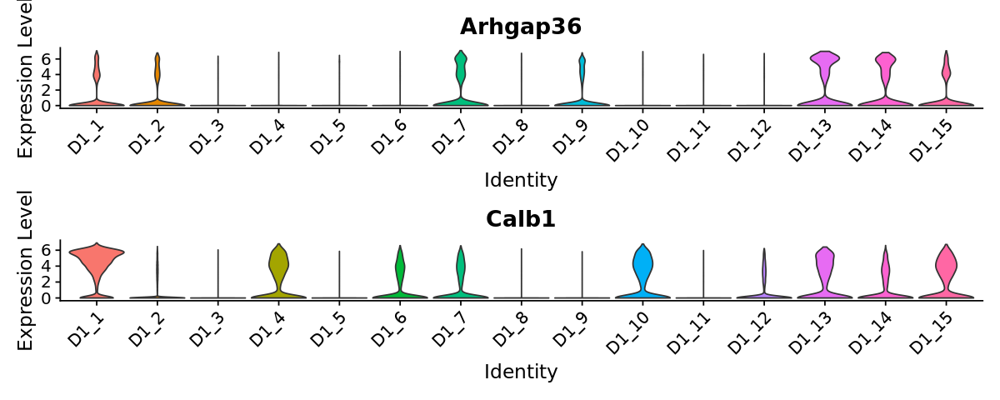

In [572]:
options(repr.plot.height = 4, repr.plot.width = 10)
VlnPlot(merFISH.hm.D1,c("Arhgap36","Calb1"),pt.size = 0,ncol = 1)

In [319]:
#D1_0_Vs_12_clusters$cluster="D1_1"

In [581]:
D1_0_Vs_12_clusters_selected = subset(D1_0_Vs_12_clusters, (pct.1-pct.2)/pct.1 > 0.2) 
#D1_0_Vs_12_clusters_selected = D1_0_Vs_12_clusters_selected[order(D1_0_Vs_12_clusters_selected$avg_log2FC),]


D1_0_Vs_12_clus_markers = D1_0_Vs_12_clusters_selected$gene

pdf("D1_0_Vs_12_clusters_markers.pdf",width = 15,height = 8 * ceiling(length(D1_0_Vs_12_clus_markers))/35 )
cols = generateColors(nbCols = 2)
#tmp = merFISH.hm.D1[, Idents(merFISH.hm.D1) %in% c("D1_1","D1_13")]
names(cols) = levels(Idents(tmp_sobj))
plotMarkersHeatmap_v3(
        tmp_sobj,
        markers = D1_0_Vs_12_clus_markers,
        clustersColors = cols,
      slotToUse = "data",
        #markerClusters = clus_names,
        #identlevels = clus_lvls,
        clusterCols = FALSE
      )
  dev.off()



png 
  2

In [582]:
dim(D1_0_Vs_12_clusters_selected)

[1] 132   7

In [583]:
write.csv(D1_0_Vs_12_clusters, file="D1_0_Vs_12_DEG.csv")

## D1_2 vs D1_7 vs D1_10

In [554]:
tmp =  merFISH.hm.D1[,merFISH.hm.D1@meta.data$clusterLabel %in% c("D1_3","D1_8","D1_11")]
Idents(tmp) = tmp@meta.data$clusterLabel
mrks_D1_2_7_10 = FindAllMarkers(tmp)

In [558]:
mrks_D1_2_7_10_selected = subset(mrks_D1_2_7_10, (pct.1-pct.2)/pct.1 > 0.3 )
table(mrks_D1_2_7_10_selected$cluster)
mrks_D1_2_7_10_genes = mrks_D1_2_7_10_selected$gene


 D1_3  D1_8 D1_11 
   42    17    40 

In [556]:
pdf("mrks_D1_2_Vs_7_Vs_10_markers.pdf",width = 25,height = 8 * ceiling(length(mrks_D1_2_7_10_genes))/35 )
cols = generateColors(nbCols = length(levels(Idents(tmp))))
names(cols) = levels(Idents(tmp))
plotMarkersHeatmap_v3(
        tmp,
        markers = mrks_D1_2_7_10_genes,
        clustersColors = cols,
      slotToUse = "data",
        #markerClusters = clus_names,
        #identlevels = clus_lvls,
        clusterCols = FALSE
      )
  dev.off()

png 
  2

In [559]:
write.csv(mrks_D1_2_7_10,file="mrks_D1_2_7_10.csv")

In [560]:
save(merFISH.hm.D1, file="merFISH.hm.D1.RData")

In [ ]:
SaveH5Seurat(merFISH.hm.D1,filename = "merFISH.hm.D1.H5Seurat")
SeuratDisk::Convert(source="merFISH.hm.D1.H5Seurat", dest="merFISH.hm.D1.h5ad")

## Classify D2 cells

In [603]:
scD2Cells = colnames(subset(hm.integrated, CellType == "D2" & Source == "scRNASeq"))
D2_cells = c(scD2Cells, colnames(merFISH.hm.D2))
D2_cells.hm = hm.integrated[,D2_cells]
D2_cells.hm

An object of class Seurat 
252 features across 44548 samples within 1 assay 
Active assay: RNA (252 features, 252 variable features)
 3 dimensional reductions calculated: pca, harmony, umap

Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 2227400)”
Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony 4/10

Harmony 5/10

Harmony converged after 5 iterations

Warning message:
“Invalid name supplied, making object name syntactically valid. New object name is Seurat..ProjectDim.RNA.harmony; see ?make.names for more details on syntax validity”


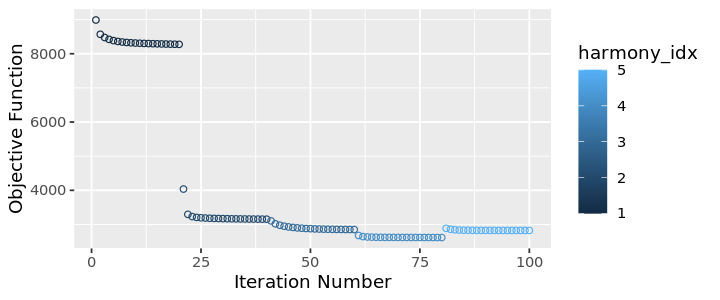

In [604]:
options(repr.plot.height = 2.5, repr.plot.width = 6)
D2.hm.integrated <- RunHarmony(
  object = D2_cells.hm,
  group.by.vars = 'Source',
plot_convergence = TRUE
)

In [605]:
# re-compute the UMAP using corrected LSI embeddings
D2.hm.integrated <- RunUMAP(D2.hm.integrated, dims = 1:20, reduction = 'harmony')


18:59:09 UMAP embedding parameters a = 0.9922 b = 1.112

18:59:09 Read 44548 rows and found 20 numeric columns

18:59:09 Using Annoy for neighbor search, n_neighbors = 30

18:59:09 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

18:59:17 Writing NN index file to temp file /tmp/RtmpH3HXgA/file30b92234fce8

18:59:17 Searching Annoy index using 12 threads, search_k = 3000

18:59:20 Annoy recall = 100%

18:59:22 Commencing smooth kNN distance calibration using 12 threads

18:59:26 Initializing from normalized Laplacian + noise

18:59:29 Commencing optimization for 200 epochs, with 2017710 positive edges

19:00:57 Optimization finished



png 
  2

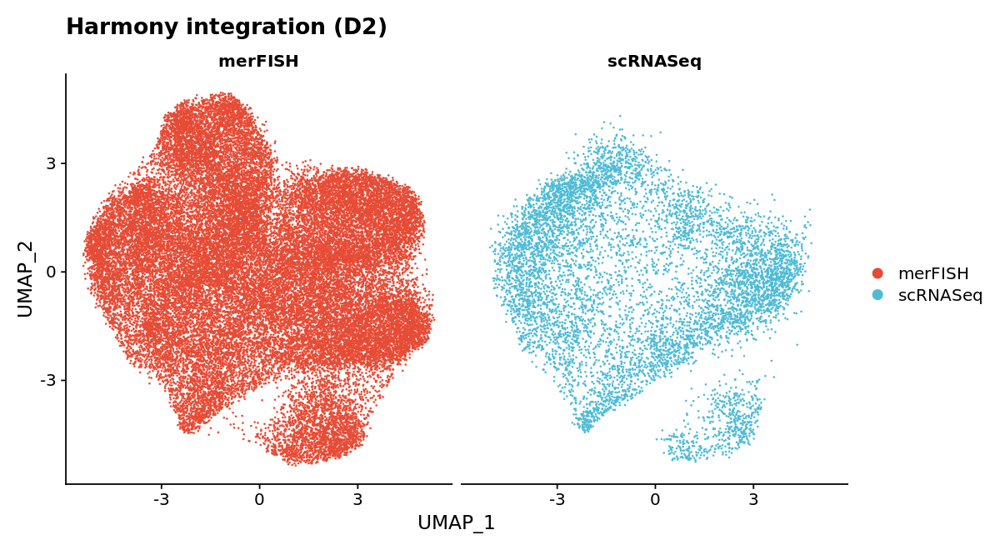

In [290]:
options(repr.plot.height = 5.5, repr.plot.width = 10)
pdf("Interegrated_D2_umap.pdf",width = 10,height = 5.5)
p= DimPlot(D2.hm.integrated, group.by = 'Source',split.by = "Source", pt.size = 0.1,cols = ggsci::pal_npg()(10)) + ggplot2::ggtitle("Harmony integration (D2)")
print(p)
dev.off()
p

In [189]:
sum(is.na(D2.hm.integrated@meta.data$clusterLabel))

[1] 7687

png 
  2

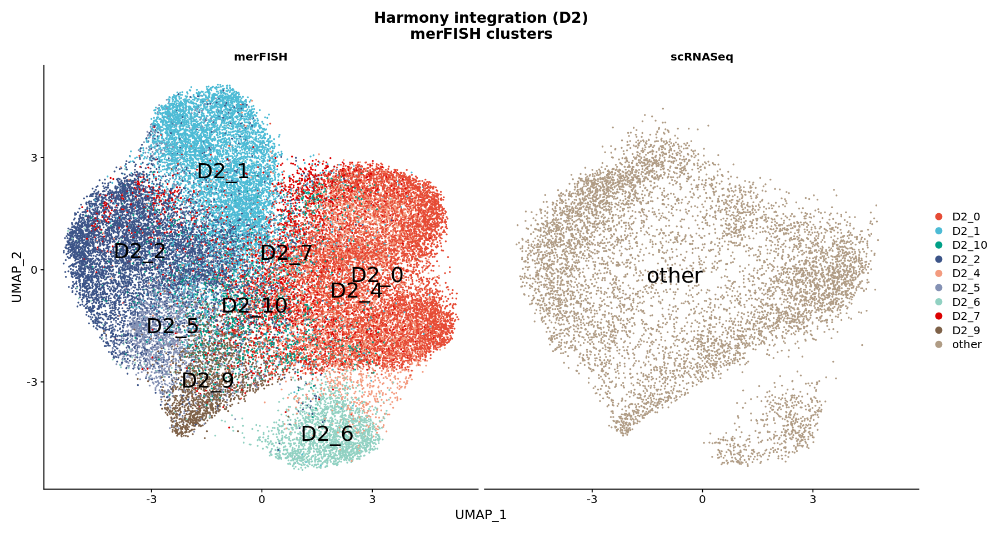

In [609]:
options(repr.plot.height = 8, repr.plot.width = 15)
D2.hm.integrated@meta.data$clusterLabel[is.na(D2.hm.integrated@meta.data$clusterLabel)] = "other"
pdf("Interegrated_D2_merFISH_clusters_UMAP.pdf",width = 10,height = 5.5)
p =DimPlot(D2.hm.integrated, group.by = 'clusterLabel',split.by = "Source", pt.size = 0.3, 
           label=TRUE, cols = c(ggsci::pal_npg()(10), ggsci::pal_rickandmorty()(8)),label.size = 8) + 
ggplot2::ggtitle("Harmony integration (D2)\nmerFISH clusters") + theme(plot.title = element_text(hjust = 0.5))
print(p) 
dev.off()
p

In [199]:
table(D2.hm.integrated@meta.data$L1_Clustering)


D2_1 D2_2 D2_3 D2_4 D2_5 D2_6 D2_7 D2_8 
 169  569 1027 1739  789  968 1639  787 

png 
  2

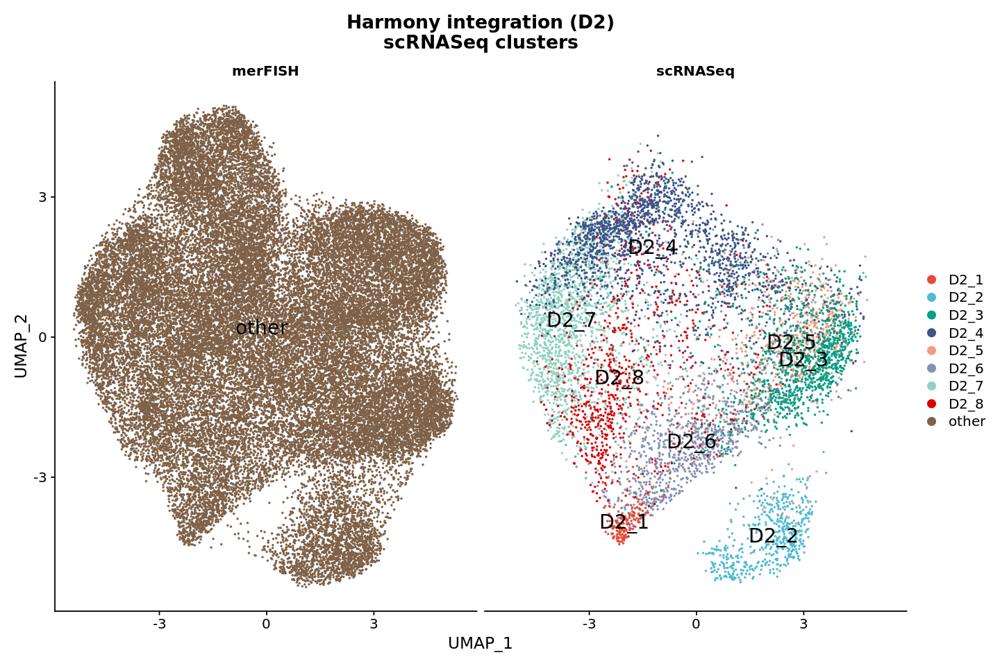

In [610]:
options(repr.plot.height = 8, repr.plot.width = 12)
D2.hm.integrated@meta.data$L1_Clustering[is.na(D2.hm.integrated@meta.data$L1_Clustering)] = "other"
D2.hm.integrated@meta.data$L2_Clustering[is.na(D2.hm.integrated@meta.data$L2_Clustering)] = "other"
pdf("Interegrated_D2_scRNASeq_L1_clusters_UMAP.pdf",width = 10,height = 5.5)
p = DimPlot(D2.hm.integrated, group.by = 'L1_Clustering',split.by = "Source", pt.size = 0.3, label=TRUE, 
        cols = c(ggsci::pal_npg()(10), ggsci::pal_rickandmorty()(8),ggsci::pal_d3("category20c")(20)),
        label.size = 6) + 
ggplot2::ggtitle("Harmony integration (D2)\nscRNASeq clusters") + theme(plot.title = element_text(hjust = 0.5))
print(p)
dev.off()
p

In [312]:
options(repr.plot.height = 5.5, repr.plot.width = 6)
p= DimPlot(D2.hm.integrated, group.by = 'Source', pt.size = 0.3, label=TRUE, 
        cols = c(ggsci::pal_npg()(10), ggsci::pal_rickandmorty()(8),ggsci::pal_d3("category20c")(20)),
        label.size = 6) + ggtitle("Merged D2 merFISH + scRNA-seq")
pdf("D2_merged_merFISH_scRNAseq.pdf",width = 8,height = 6)
print(p)
dev.off()

png 
  2

In [55]:
table(D2.hm.integrated@meta.data$clusterLabel)


 D2_1  D2_2  D2_3  D2_4  D2_5  D2_6  D2_7  D2_8  D2_9 D2_10 D2_11 
 8973  7190  7150     0  3631  2269  2140  2276     0  1773  1459 

In [633]:
D2.hm.integrated@meta.data$clusterLabel = gsub("D2_","",D2.hm.integrated@meta.data$clusterLabel) %>% as.character() %>% as.numeric()
D2.hm.integrated@meta.data$clusterLabel = D2.hm.integrated@meta.data$clusterLabel + 1
D2.hm.integrated@meta.data$clusterLabel = paste0("D2_", D2.hm.integrated@meta.data$clusterLabel)
D2.hm.integrated@meta.data$clusterLabel = factor(D2.hm.integrated@meta.data$clusterLabel,levels = glue::glue("D2_{1:11}"))

Warning message in function_list[[k]](value):
“NAs introduced by coercion”


In [675]:
obj1 = subset(D2.hm.integrated, Source == "scRNASeq")
obj2 = subset(D2.hm.integrated, Source == "merFISH")

png 
  2

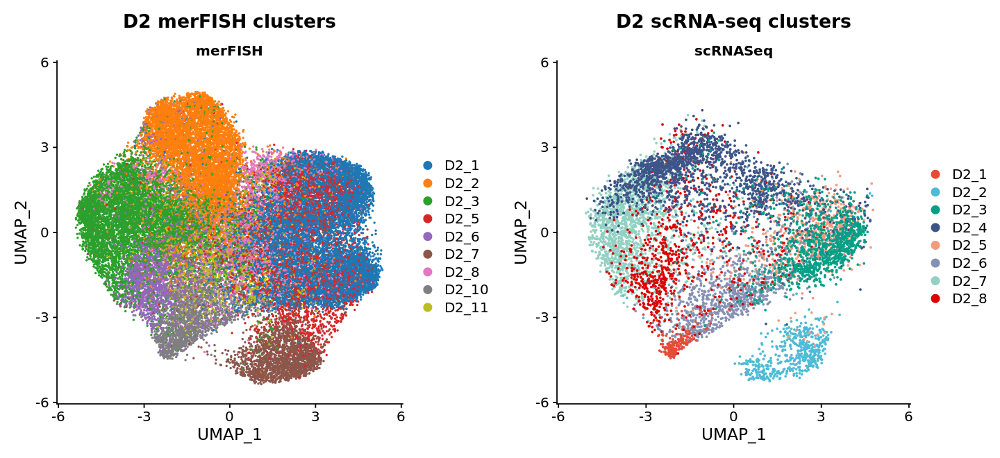

In [683]:
p1 = DimPlot(obj2, 
             group.by = 'clusterLabel',
             split.by = "Source", 
             pt.size = 0.3, 
             label=FALSE, 
             repel = TRUE,
             cols = c(ggsci::pal_d3()(10),"brown", ggsci::pal_simpsons()(10)), #c(ggsci::pal_npg()(10), ggsci::pal_rickandmorty()(8),ggsci::pal_d3("category20c")(20)),
             label.size = 6) + ggtitle("D2 merFISH clusters") + theme(plot.title = element_text(hjust = 0.5)) +
              xlim(-5.5,5.5) + ylim(-5.5,5.5)

p2 = DimPlot(obj1, 
             group.by = 'L1_Clustering',
             split.by = "Source", 
             pt.size = 0.4, 
             label=FALSE, 
             repel = TRUE,
             cols = c(ggsci::pal_npg()(10), ggsci::pal_rickandmorty()(8),ggsci::pal_d3("category20c")(20)),
             label.size = 6) + ggtitle("D2 scRNA-seq clusters") + theme(plot.title = element_text(hjust = 0.5)) +
             xlim(-5.5,5.5) + ylim(-5.5,5.5)

options(repr.plot.height = 5.5, repr.plot.width = 12)
pdf("Interegrated_D2_scRNASeq_L1_clusters_UMAP_noNames.pdf",width = 12,height = 5.5)
cowplot::plot_grid(p1,p2)
dev.off()
cowplot::plot_grid(p1,p2)

In [682]:
min(p1$data$UMAP_2)

[1] -5.354289

In [655]:
p1_legend <- cowplot::get_legend(p1)
p2_legend <- cowplot::get_legend(p2)
grid.newpage()
options(repr.plot.height = 5.5, repr.plot.width = 8)
pdf("Interegrated_D2_scRNASeq_L1_clusters_UMAP_legends.pdf",width = 8,height = 5.5)
cowplot::plot_grid(p1_legend,p2_legend, labels= c("D2 merFISH legends","D2 scRNA-seq legends"))
dev.off()

png 
  2

png 
  2

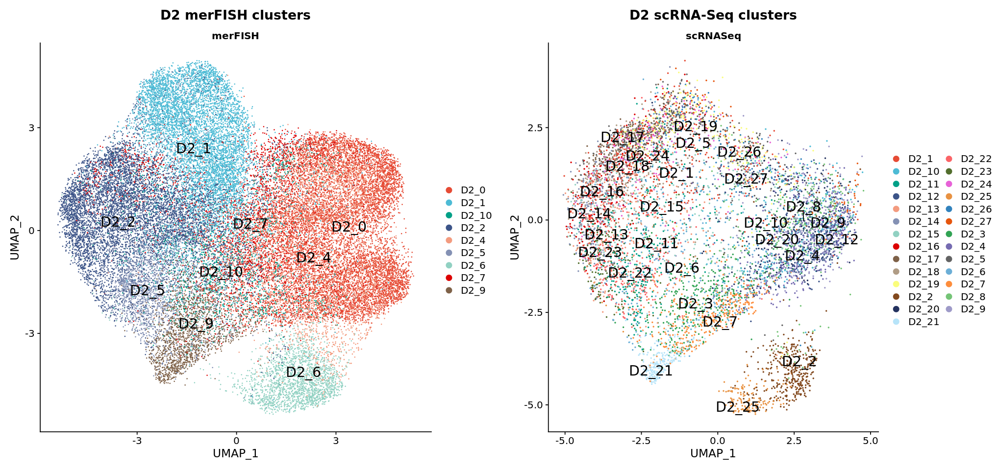

In [613]:
p1 = DimPlot(obj2, 
             group.by = 'clusterLabel',
             split.by = "Source", 
             pt.size = 0.1, 
             label=TRUE, repel = TRUE,
             cols = c(ggsci::pal_npg()(10), ggsci::pal_rickandmorty()(8),ggsci::pal_d3("category20c")(20)),
             label.size = 6) + ggtitle("D2 merFISH clusters") + theme(plot.title = element_text(hjust = 0.5))

p2 = DimPlot(obj1, repel = TRUE,
             group.by = 'L2_Clustering',
             split.by = "Source", 
             pt.size = 0.3, 
             label=TRUE,
             cols = c(ggsci::pal_npg()(10), ggsci::pal_rickandmorty()(8),ggsci::pal_d3("category20c")(20)),
             label.size = 6) + ggtitle("D2 scRNA-Seq clusters") + theme(plot.title = element_text(hjust = 0.5))

options(repr.plot.height = 8, repr.plot.width = 17)
pdf("Interegrated_D2_scRNASeq_L2_clusters_UMAP.pdf",width = 17,height = 8)
cowplot::plot_grid(p1,p2)
dev.off()
cowplot::plot_grid(p1,p2)

## Find the IVSA differentially expressed genes in different stages

In [296]:
D2_scRNASeq.hm = subset(D2.hm.integrated, Source == "scRNASeq")
D2_merFISH.hm = subset(D2.hm.integrated, Source == "merFISH")

In [292]:
getDominatingmerD2FISHLabel <- function(x, thr=0.5){
    nn = D2_merFISH.hm@meta.data$clusterLabel[x]
    pct = table(nn)/length(x)
    res = names(pct)[which(pct>= thr)]
    if(length(res)==0){
        res ="AMBIGIOUS"
    }else{
        res = res[1]
    }
    res
    #pct
}

In [293]:
D2_scRNACells =  colnames(D2.hm.integrated)[which(D2.hm.integrated@meta.data$Source == "scRNASeq")]
D2_merFISHCells =  colnames(D2.hm.integrated)[which(D2.hm.integrated@meta.data$Source == "merFISH")]
D2_NN <- Seurat:::FindNN(
    object = D2.hm.integrated,
    cells1 = D2_scRNACells,
    cells2 = D2_merFISHCells,
    internal.neighbors = NULL,
    dims = 1:20,
    reduction = "harmony",
    #reduction.2 = reduction.2,
    nn.reduction = "harmony",
    k = 30,
    nn.method = "rann",
    eps = 0,
    verbose = TRUE
  )

Finding neighborhoods



In [297]:
D2_neighbors <- GetIntegrationData(object = D2_NN, integration.name = "integrated", slot = 'neighbors')
class(D2_neighbors)

[1] "list"

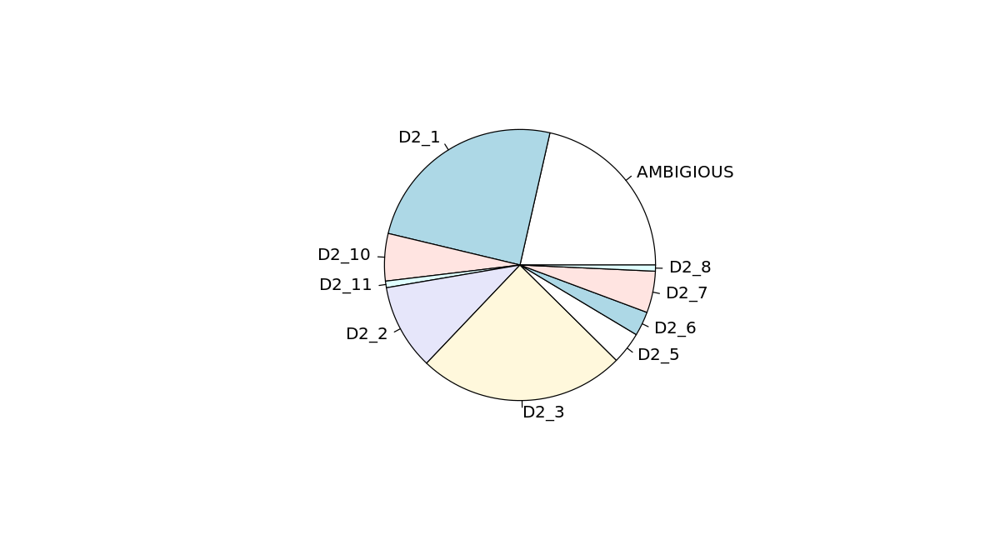

In [298]:
D2label.scRNASeq_NN = apply(D2_neighbors[['nnab']]@nn.idx,1,getDominatingmerD2FISHLabel)
pie(table(D2label.scRNASeq_NN))

png 
  2

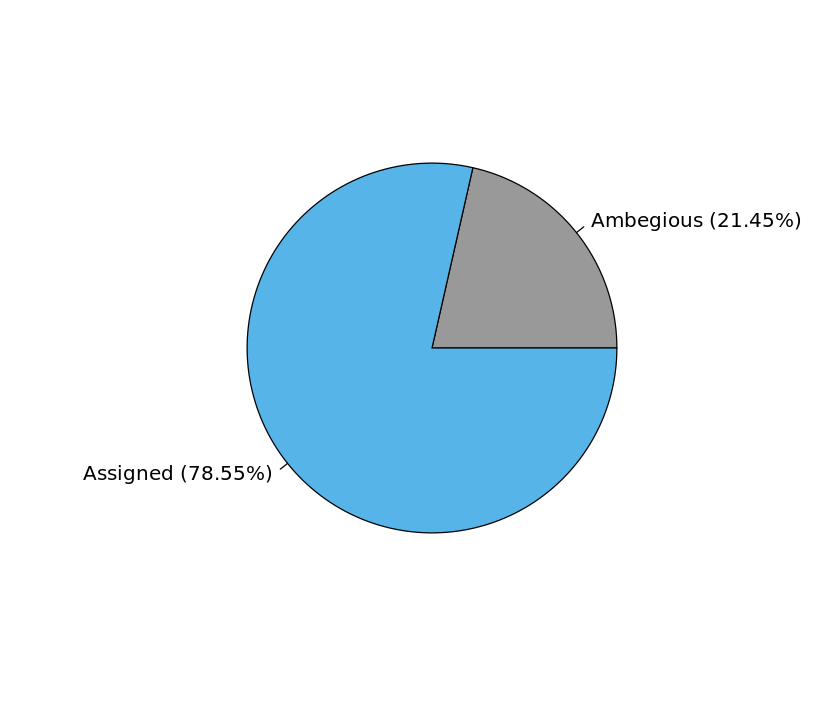

In [779]:
options(repr.plot.height = 6, repr.plot.width = 6.8)
pdf("FigS4H_D2pie.pdf",width = 6.8,height = 6)
D2_prediction_prop = ifelse(D2label.scRNASeq_NN == "AMBIGIOUS", "Ambegious","Assigned")
pct = table(D2_prediction_prop)/length(D2_prediction_prop)
pct =pct = scales::percent(as.numeric(pct),accuracy = 0.01)
lbls = paste0(names(table(D2_prediction_prop))," (",pct,")")
pie(table(D2_prediction_prop),col = c("#999999","#56B4E9"),labels = lbls)
dev.off()
pie(table(D2_prediction_prop),col = c("#999999","#56B4E9"),labels = lbls)

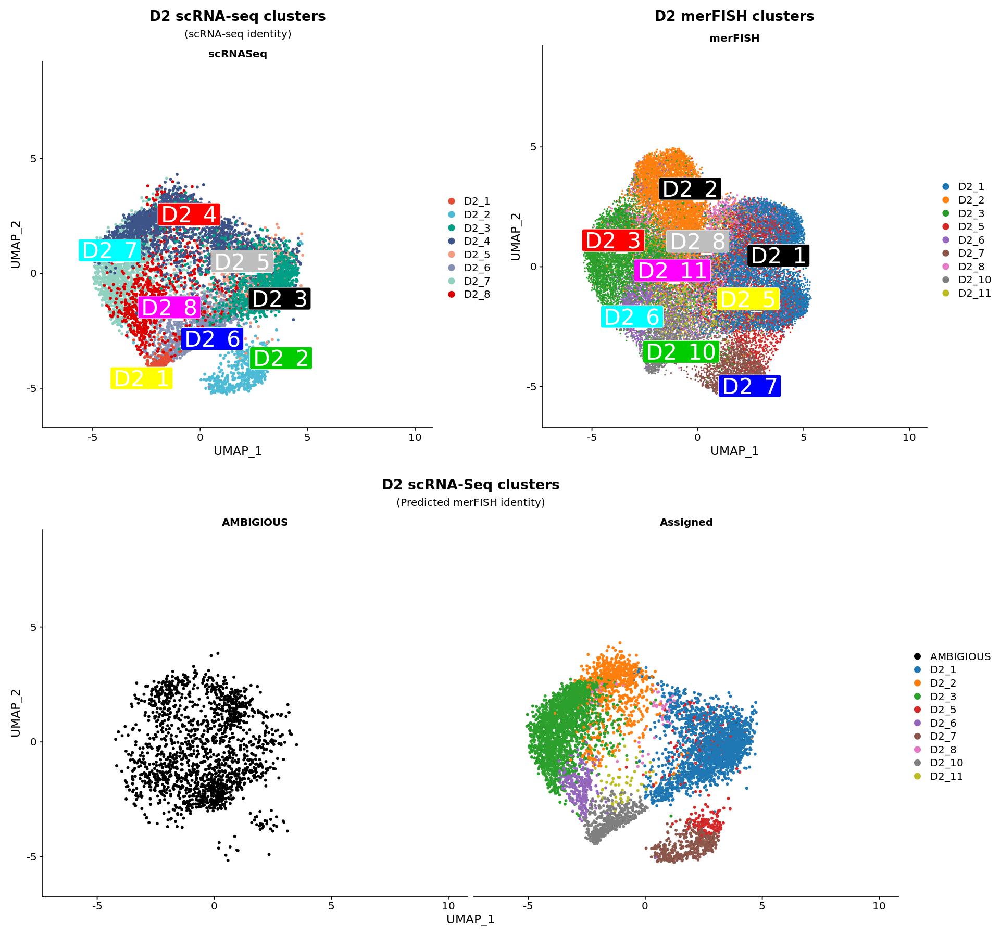

In [719]:
options(repr.plot.height = 15, repr.plot.width = 16)
D2label.scRNASeq_NN = factor(D2label.scRNASeq_NN,levels  = c("AMBIGIOUS",glue::glue("D2_{1:11}")))
Idents(D2_scRNASeq.hm) =  D2label.scRNASeq_NN
D2_scRNASeq.hm@meta.data$NN = D2label.scRNASeq_NN
D2_scRNASeq.hm@meta.data$ambigious = ifelse(D2label.scRNASeq_NN == "AMBIGIOUS","AMBIGIOUS", "Assigned")

p1 = DimPlot(D2_scRNASeq.hm,label.color = "white",label.box = T,
             group.by = 'L1_Clustering',
             split.by = "Source", 
             pt.size = 1, 
             label=TRUE,
             repel = TRUE,
             cols = c(ggsci::pal_npg()(10), ggsci::pal_rickandmorty()(8),ggsci::pal_d3("category20c")(20)),
             label.size = 9) + ggtitle("D2 scRNA-seq clusters", subtitle="(scRNA-seq identity)") + 
             theme(plot.title = element_text(hjust = 0.5),
                   plot.subtitle = element_text(hjust = 0.5)
                  ) + 
             xlim(-6.5,10) + ylim(-6,8.5)


p2 = DimPlot(D2_merFISH.hm, label.box = T,label.color = "white",
             group.by = 'clusterLabel',
             split.by = "Source", 
             pt.size = 0.3, 
             label=TRUE,
             repel = TRUE,
             cols =  c(ggsci::pal_d3()(10),"brown", ggsci::pal_simpsons()(10)), #c(ggsci::pal_npg()(10), ggsci::pal_rickandmorty()(8),ggsci::pal_d3("category20c")(20)),
             label.size = 9) + ggtitle("D2 merFISH clusters") + 
             theme(plot.title = element_text(hjust = 0.5),
                   plot.subtitle = element_text(hjust = 0.5)
                  ) + 
             xlim(-6.5,10) + ylim(-6,8.5)

p3 = DimPlot(D2_scRNASeq.hm, repel = TRUE, ncol = 2,label.box = T,
             group.by = 'NN',
             split.by = "ambigious", 
             pt.size = 1, 
             label=FALSE,
             cols = c("black",ggsci::pal_d3()(10),"brown", ggsci::pal_simpsons()(10)),
             label.size = 7) + ggtitle("D2 scRNA-Seq clusters", subtitle="(Predicted merFISH identity)") + 
             theme(plot.title = element_text(hjust = 0.5),
                   plot.subtitle = element_text(hjust = 0.5)
                  ) +
             xlim(-6.5,10) + ylim(-6,8.5)

#pdf("Predicted_scRNAseq_D2_identity.pdf",width = 20,height = 15)
#toprow = cowplot::plot_grid(p1,p2, ncol = 2)
#cowplot::plot_grid(toprow,p3,ncol = 1)
#dev.off()
toprow = cowplot::plot_grid(p1,p2, ncol = 2)
cowplot::plot_grid(toprow,p3,ncol = 1)



In [702]:
table(D2_scRNASeq.hm@meta.data$NN)/length(D2_scRNASeq.hm@meta.data$NN)


  AMBIGIOUS        D2_1        D2_2        D2_3        D2_4        D2_5 
0.214518017 0.248081176 0.102120463 0.246910368 0.000000000 0.038246390 
       D2_6        D2_7        D2_8        D2_9       D2_10       D2_11 
0.029010017 0.049564199 0.007285027 0.000000000 0.056458957 0.007805386 

In [303]:
D2_similarity = table(D2_scRNASeq.hm@meta.data$NN, D2_scRNASeq.hm@meta.data$L1_Clustering) %>%  as.matrix() %>% apply(MARGIN = 2,FUN = function(x) x/sum(x))
save(D2_similarity, file="D2_similarity.RData")                                                                                                            

In [304]:
options(repr.plot.height = 6, repr.plot.width = 6)
hcols <- c("white",colorRampPalette(brewer.pal(n = 9, name ="Reds"))(10))
cl = colorRamp2(seq(0, 0.7, length.out = length(hcols)), hcols)

o1 = glue::glue("D2_{c(10,1,5,7,6,2,3,4,8,9,11)}")
o2 = glue::glue("D2_{c(1,6,3,5,2,8,4,7)}")

H = Heatmap(D2_similarity[o1,o2], col = cl, name="Similarity",
            border = TRUE,cluster_columns = F,cluster_rows = F,
            rect_gp = gpar(col = "black", lwd = 1)
)
draw(H)

In [305]:
D2_scRNASeq_all = NAc_cells_all_filtered[,colnames(D2_scRNASeq.hm)]
all(colnames(D2_scRNASeq_all) == colnames(D2_scRNASeq.hm))

[1] TRUE

In [306]:
D2_scRNASeq_all@meta.data$NN = D2_scRNASeq.hm@meta.data$NN
D2_scRNASeq_all= SetSamplesLabels_metaData(D2_scRNASeq_all)

D2_scRNASeq_all = D2_scRNASeq_all[,D2_scRNASeq_all@meta.data$NN !="AMBIGIOUS"]
D2_scRNASeq_all

An object of class Seurat 
26145 features across 6038 samples within 1 assay 
Active assay: RNA (26145 features, 1052 variable features)
 3 dimensional reductions calculated: pca, ica, tsne

## Cocaine treatment

In [947]:
head(D2_scRNASeq_all@meta.data)

,orig.ident,percent.mito,Sample,tree.ident,CellType,L2_Clustering,L1_Clustering,nCount_RNA,nFeature_RNA,NN,treatment,Period
,<fct>,<dbl>,<fct>,<int>,<fct>,<fct>,<fct>,<dbl>,<int>,<fct>,<chr>,<chr>
AAACCTGAGTGAACGC.NAc_Sample1,D2_2,0.03336185,NAc_Sample1,6,D2,D2_2,D2_2,4676,2065,D2_7,Cocaine,Maintenance
AACCGCGTCAGCTCTC.NAc_Sample1,D2_2,0.02126563,NAc_Sample1,6,D2,D2_2,D2_2,7759,2721,D2_7,Cocaine,Maintenance
ACACCCTAGCTGAACG.NAc_Sample1,D2_2,0.02026795,NAc_Sample1,6,D2,D2_2,D2_2,5822,2387,D2_7,Cocaine,Maintenance
CCGTGGAAGCTACCGC.NAc_Sample1,D2_2,0.02747928,NAc_Sample1,6,D2,D2_2,D2_2,6514,2656,D2_7,Cocaine,Maintenance
CCTCAGTTCTTCCTTC.NAc_Sample1,D2_2,0.01888489,NAc_Sample1,6,D2,D2_2,D2_2,7784,2768,D2_7,Cocaine,Maintenance
CCTCTGAGTATATGAG.NAc_Sample1,D2_2,0.03979717,NAc_Sample1,6,D2,D2_2,D2_2,6508,2644,D2_7,Cocaine,Maintenance


In [307]:
D2_scRNASeq_all@meta.data$NN = droplevels(D2_scRNASeq_all@meta.data$NN)
levels(D2_scRNASeq_all@meta.data$NN)

[1] "D2_1"  "D2_2"  "D2_3"  "D2_5"  "D2_6"  "D2_7"  "D2_8"  "D2_10" "D2_11"

In [848]:
tmp = paste0(D2_scRNASeq_all$NN,"_",D2_scRNASeq_all$Period)
res= table(tmp, D2_scRNASeq_all$treatment)
res = res %>% as.data.frame()
write.csv(res, file='Number_of_D2_cell_perTreatment.csv')

In [308]:
NAc_D2_sc_merfish_DEG <- list()
for(clus in levels(D2_scRNASeq_all@meta.data$NN) ){
  NAc_D2_sc_merfish_DEG[[clus]] <- list()
  for(period in unique(D2_scRNASeq_all@meta.data$Period)){
      message(paste("cluster",clus,"period",period))
      NAc_D2_sc_merfish_DEG[[clus]][[period]] <- list()
      tmp_sobj <- subset(D2_scRNASeq_all, NN == clus & Period == period)
      
    Y = as.matrix(tmp_sobj[['RNA']]@counts)
    # remove extreme values
    #outlayer = quantile(Y,0.99)
    nbCells = apply(Y,1,function(x) sum(x>0))
    Y = Y[nbCells>=3,]
    #qt = apply(Y, 2, quantile,0.90)
    #Y = Y[,qt>0]
    
    # Remove problematic cells
    Cell0 = colMeans(Y == 0)
    par1 = apply(Y, 2, function(yy) {
                          yy = yy[yy <= 15]
                          SC2P:::RobustPoi0(yy)
                          })
       
    pi0.hat = Cell0/(par1[1, ] + (1 - par1[1, ]) * dpois(0, par1[2,]))
    
    tokeep = which(pi0.hat<=1)  
    Y = Y[,tokeep]
    
    qt = apply(Y, 2, quantile,0.99)
    Y = Y[,qt>1]
    
    design = tmp_sobj@meta.data[,c("nCount_RNA","treatment")]
    design$treatment = factor(design$treatment,levels = c("Saline","Cocaine"))
    design$class = as.numeric(design$treatment)
    design = design[colnames(Y),]
    
    if(min(table(design$treatment))>3){
      
      #tmp_sobj <- SetIdent(tmp_sobj,ident.use = tmp_sobj@meta.data$treatment)
      #ae = AverageDetectionRate(tmp_sobj)[rownames(Y),]
      #rm = apply(ae, 1, max)
      #Y = Y[rm>=0.1,]
      NAc_D2_sc_merfish_DEG[[clus]][[period]] =tryCatch({
      phenoData <- new("AnnotatedDataFrame", data=design)
      eset <- ExpressionSet(assayData=Y, phenoData=phenoData)
      data <- eset2Phase(eset,low.prob = 0.9)
      twoPhaseDE(data, design=c("treatment"), test.which=1, offset="sf")
      }, error = function(cond){return(NA)})
    }
  }
}

cluster D2_1 period Maintenance

Warning message:
“Partial NA coefficients for 234 probe(s)”
cluster D2_1 period withdraw_48h

Warning message:
“Partial NA coefficients for 269 probe(s)”
cluster D2_1 period withdraw_15d

Warning message:
“Partial NA coefficients for 256 probe(s)”
cluster D2_2 period Maintenance

Warning message:
“Partial NA coefficients for 211 probe(s)”
cluster D2_2 period withdraw_48h

Warning message:
“Partial NA coefficients for 263 probe(s)”
cluster D2_2 period withdraw_15d

Warning message:
“Partial NA coefficients for 284 probe(s)”
cluster D2_3 period Maintenance

Warning message:
“Partial NA coefficients for 200 probe(s)”
cluster D2_3 period withdraw_48h

Warning message:
“Partial NA coefficients for 191 probe(s)”
cluster D2_3 period withdraw_15d

Warning message:
“Zero sample variances detected, have been offset away from zero”
Warning message:
“Partial NA coefficients for 292 probe(s)”
cluster D2_5 period Maintenance

Warning message:
“Partial NA coefficients

In [907]:
dir.create("D2_DEG",showWarnings = FALSE)
NAc_D2_sc_merfish_DEG_sig = list()

for(cellType in names(NAc_D2_sc_merfish_DEG)){
  
  NAc_D2_sc_merfish_DEG_sig[[cellType]] =  list()
  for(period in names(NAc_D2_sc_merfish_DEG[[cellType]])){
    
    NAc_D2_sc_merfish_DEG_sig[[cellType]][[period]] = list()
    
    if(is.data.frame(NAc_D2_sc_merfish_DEG[[cellType]][[period]])){
      df1  = topGene(NAc_D2_sc_merfish_DEG[[cellType]][[period]],phase = "both",
          number = 30000,p.value = 0.05)
      NAc_D2_sc_merfish_DEG_sig[[cellType]][[period]] <- subset(df1, Phase2 == "Y")
      fname = paste0("D2_DEG/",cellType, "_",period, "_DEG.csv")
      write.csv(NAc_D2_sc_merfish_DEG_sig[[cellType]][[period]],fname)
    }
  }
}

In [908]:
NAc_D2_sc_merfish_nbDEG_perCluster <- data.frame()

for(period in names(NAc_D2_sc_merfish_DEG[[1]])){
  for(clus in names(NAc_D2_sc_merfish_DEG)){
    
    if(is.data.frame(NAc_D2_sc_merfish_DEG[[clus]][[period]])){
      df1  = topGene(NAc_D2_sc_merfish_DEG[[clus]][[period]],phase = "both",
          number = 30000,p.value = 0.05)
      tmp1 <- subset(df1, Phase2 == "Y")
      
      df = data.frame(cluster=clus, period = period, nbDEG=nrow(tmp1))
      
      NAc_D2_sc_merfish_nbDEG_perCluster <- rbind(NAc_D2_sc_merfish_nbDEG_perCluster,df)  
    }
  }
}

ERROR: Error in head(NAc_D2_sc_merfish_DEG[[clus]][[period]]): object 'NAc_D2_sc_merfish_DEG' not found


In [914]:
NAc_D2_sc_merfish_nbDEG_perCluster$cluster <- factor(NAc_D2_sc_merfish_nbDEG_perCluster$cluster, 
                                               levels = paste0("D2_",c(1:3,5:8,10:11)))

NAc_D2_sc_merfish_nbDEG_perCluster <- subset(NAc_D2_sc_merfish_nbDEG_perCluster, nbDEG > 0)

In [891]:
levels(NAc_D2_sc_merfish_nbDEG_perCluster$cluster)

[1] "D2_1"  "D2_2"  "D2_3"  "D2_5"  "D2_6"  "D2_7"  "D2_8"  "D2_10" "D2_11"

In [903]:
write.csv(NAc_D2_sc_merfish_nbDEG_perCluster, file="NAc_D2_nbDEG_perCluster.csv")

In [916]:
NAc_D2_sc_merfish_nbDEG_perCluster

,cluster,period,nbDEG
,<fct>,<fct>,<int>
1,D2_1,Maintenance,30
2,D2_2,Maintenance,2
3,D2_3,Maintenance,123
5,D2_6,Maintenance,1
9,D2_1,withdraw_48h,37
10,D2_2,withdraw_48h,22
11,D2_3,withdraw_48h,21
12,D2_5,withdraw_48h,2
14,D2_7,withdraw_48h,5


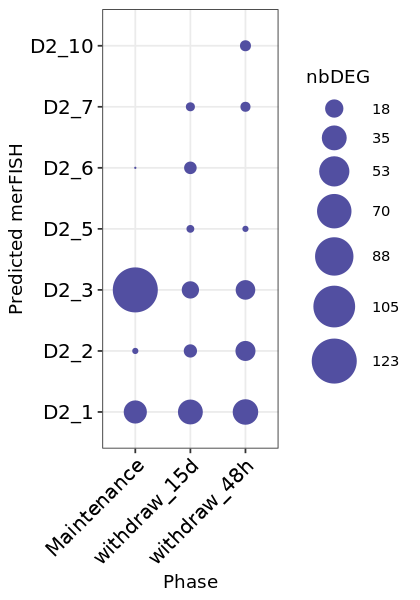

In [915]:
options(repr.plot.height = 5, repr.plot.width = 3.5)
NAc_D2_sc_merfish_nbDEG_perCluster$period =  factor(NAc_D2_sc_merfish_nbDEG_perCluster$period, c("Maintenance","withdraw_15d","withdraw_48h"))
NAc_D2_sc_merfish_nbDEG_perCluster = subset(NAc_D2_sc_merfish_nbDEG_perCluster, !is.na(cluster))
p = ggplot(NAc_D2_sc_merfish_nbDEG_perCluster, aes(x=period, y=cluster)) + 
    geom_point(aes(size=nbDEG),color="#524FA1") + 
    scale_size(breaks = round(seq(0,max(NAc_D2_sc_merfish_nbDEG_perCluster$nbDEG),length.out = 8)), range = c(0,12)) +
    theme_bw() + 
    scale_color_viridis_c(option = "B") + 
    theme(axis.text = element_text(colour = "black",size = 12),axis.text.x = element_text(angle = 45,hjust = 1)) + 
    xlab("Phase") + ylab("Predicted merFISH") 
    #scale_size(breaks = seq(10,to = 130,by = 30),range = c(1,8))
#pdf("D2_merFISH_clusters_DEG.pdf",width = 3.5,height = 5,useDingbats = FALSE)
#print(p)
#dev.off()
p

In [844]:
write.csv(NAc_D1_sc_merfish_nbDEG_perCluster, file="NAc_D1_sc_merfish_nbDEG_perCluster.csv")
write.csv(NAc_D2_sc_merfish_nbDEG_perCluster, file="NAc_D2_sc_merfish_nbDEG_perCluster.csv")

In [870]:
for(prd in c("Maintenance","withdraw_15d","withdraw_48h")){
  period_info = subset(NAc_D2_sc_merfish_nbDEG_perCluster, period == prd)

  prd_stats = rep(0, ncol(merFISH_sobj2))
  names(prd_stats) = colnames(merFISH_sobj2)
  prd2 = glue::glue("{prd}_D2")
  merFISH_sobj2 <- AddMetaData(
                          object = merFISH_sobj2,
                          metadata = prd_stats,
                          col.name = prd2
                          )

  for(cls in unique(period_info$cluster)){
      cls2 = gsub("D2_","",cls)
      cls2 = as.numeric(cls2) - 1
      cls2 = paste0("D2_",cls2)
      pos <- which(merFISH_sobj2$clusterLabel == cls2)
      merFISH_sobj2@meta.data[pos,prd2] = log2(period_info[period_info$cluster == cls,"nbDEG"]+1)
  }
}

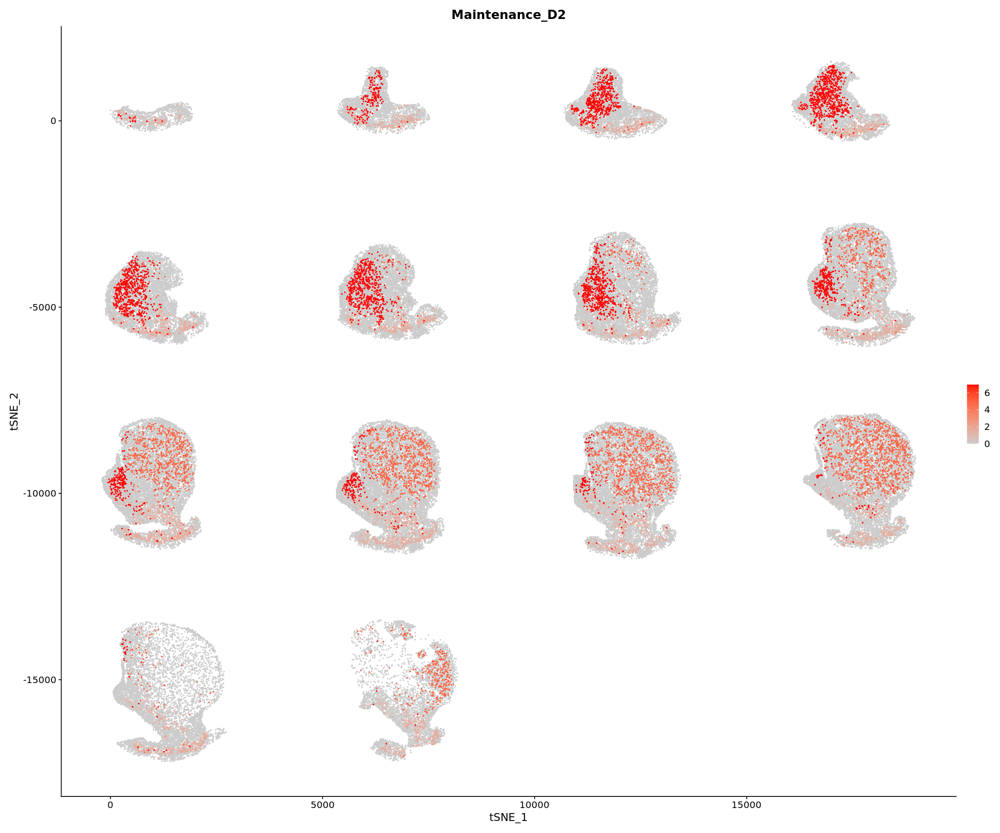

In [871]:
options(repr.plot.height = 15, repr.plot.width = 18)
FeaturePlot(merFISH_sobj2,"Maintenance_D2",reduction = "tsne",cols = c("grey80",'red'),pt.size = 0.3,order = TRUE)

In [872]:
save(merFISH_sobj2, file="merFISH_sobj_cocaineDEG.RData")

#### Get the direction of genes in D2 clusters

In [65]:
NAc_D2_sc_merfish_DEGDirection_perCluster <- data.frame()

for(period in names(NAc_D2_sc_merfish_DEG[[1]])){
  for(clus in names(NAc_D2_sc_merfish_DEG)){
    
    if(is.data.frame(NAc_D2_sc_merfish_DEG[[clus]][[period]])){
      df1  = topGene(NAc_D2_sc_merfish_DEG[[clus]][[period]],phase = "both",
          number = 30000,p.value = 0.05)
      tmp1 <- subset(df1, Phase2 == "Y")
      if(nrow(tmp1)>0){
          tmp1$marLogFC = as.numeric(tmp1$marLogFC)
         tmp1$Direction = ifelse(tmp1$marLogFC>0,1,-1)
          tmp1$Cluster = clus
          tmp1$Period = period

          NAc_D2_sc_merfish_DEGDirection_perCluster <- rbind(NAc_D2_sc_merfish_DEGDirection_perCluster,tmp1)    
      }
      
    }
  }
}

In [66]:
head(NAc_D2_sc_merfish_DEGDirection_perCluster)

,Gene.name,p1,p2,Ph1.coef,Ph1.fdr,m1,m2,Ph2.coef,marLogFC,Ph2.fdr,Phase1,Phase2,Comb.fdr,Category,Direction,Cluster,Period
,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<dbl>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<dbl>,<chr>,<chr>
1,Hspa8,0.9256,0.9223,-0.05,0.92507,4.4,4.7,0.24,0.07419,3.5e-09,N,Y,9.6e-09,-+,1,D2_1,Maintenance
2,Pcp4,0.9515,0.9272,-0.43,0.44935,5.4,5.2,-0.19,-0.37256,1.1e-05,N,Y,2.9e-05,--,-1,D2_1,Maintenance
3,Tac1,0.0097,0.0049,-0.70,0.66346,4.5,2.2,-2.31,0.03509,1.3e-05,N,Y,3.4e-05,--,1,D2_1,Maintenance
4,mt-Nd2,0.3463,0.2961,-0.23,0.42131,3.4,3.7,0.31,-0.13555,3.6e-05,N,Y,9.9e-05,-+,-1,D2_1,Maintenance
6,Junb,0.0162,0.0340,0.76,0.37262,3.4,4.5,1.08,-0.01607,8.4e-05,N,Y,1.9e-04,++,-1,D2_1,Maintenance
7,Scg2,0.3301,0.3350,0.02,0.93386,3.7,4.0,0.28,0.09143,9.0e-05,N,Y,2.1e-04,++,1,D2_1,Maintenance


In [67]:
all_DEG_genes = rbind(NAc_D1_sc_merfish_DEGDirection_perCluster,NAc_D2_sc_merfish_DEGDirection_perCluster)
all_DEG_genes$grp = paste0(all_DEG_genes$Period,"_",all_DEG_genes$Direction)
head(all_DEG_genes)

,Gene.name,p1,p2,Ph1.coef,Ph1.fdr,m1,m2,Ph2.coef,marLogFC,Ph2.fdr,Phase1,Phase2,Comb.fdr,Category,Direction,Cluster,Period,grp
,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<dbl>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<dbl>,<chr>,<chr>,<chr>
1,Fkbp1a,0.668,0.868,1.19,1.2e-06,3.8,4.1,0.31,0.445,6.5e-13,Y,Y,1.7e-12,++,1,D1_1,withdraw_48h,withdraw_48h_1
2,Ppp1r1b,0.763,0.919,1.26,1.5e-05,4.2,4.5,0.30,0.513,4.0e-11,Y,Y,1.1e-10,++,1,D1_1,withdraw_48h,withdraw_48h_1
3,Rab3a,0.664,0.836,0.95,1.2e-04,3.7,4.0,0.26,0.405,4.2e-11,Y,Y,1.1e-10,++,1,D1_1,withdraw_48h,withdraw_48h_1
4,Hspa8,0.950,0.941,-0.18,8.4e-01,5.1,4.8,-0.26,-0.245,4.2e-11,N,Y,1.1e-10,--,-1,D1_1,withdraw_48h,withdraw_48h_-1
5,Rpl13,0.589,0.844,1.33,2.8e-09,3.7,3.9,0.21,0.468,4.5e-05,Y,Y,1.1e-09,++,1,D1_1,withdraw_48h,withdraw_48h_1
6,Rtn1,0.896,0.973,1.43,4.6e-03,4.4,4.6,0.23,0.316,3.4e-09,Y,Y,7.3e-09,++,1,D1_1,withdraw_48h,withdraw_48h_1


In [68]:
all_DEG_genes$grp = factor(all_DEG_genes$grp, levels = c("Maintenance_1","withdraw_48h_1","withdraw_15d_1","Maintenance_-1","withdraw_48h_-1","withdraw_15d_-1"))

In [114]:
library(circlize)
col_fun = colorRamp2(c(-1, 0, 1), c("blue", "white", "red"))

DE_direction_hts = NULL

for(cls in c("D1_2","D1_3","D1_8","D1_11","D1_1","D1_4","D1_12","D1_13","D1_14","D1_6",
             "D2_1"
             
             ,"D2_2","D2_3","D2_10")){
    cls_DE_genes = subset(all_DEG_genes, Cluster == cls)
    mat = cls_DE_genes %>% complete(grp = grp) %>% pivot_wider(id_cols = grp,names_from = Gene.name, values_from = Direction,values_fill = 0)
    mat$`NA` = NULL
    mat2 = data.matrix(mat[,-1])
    rownames(mat2)= mat$grp
    
    h = ComplexHeatmap::Heatmap(mat2,cluster_rows = FALSE,
                                #col = col_fun,
                                col = structure(c("blue", "white", "red"), names = c(-1,0,1)),
                                show_column_names = T,column_title_rot = 0,
                                column_title = cls,border = TRUE,rect_gp = gpar(col = "black", lwd = 1
                                                                               ),show_column_dend = F )
    
    if(is.null(DE_direction_hts)){
        DE_direction_hts = h
    }else{
        DE_direction_hts = DE_direction_hts+ h
    }
}

In [115]:
options(repr.plot.height = 2, repr.plot.width = 16)
pdf("Cocaine_DE_genes_Bydirection_Named.pdf",width = 110,height = 3)
draw(DE_direction_hts,split=factor(rep(c("Up","Down"),each=3),levels = c("Up","Down")),cluster_row_slices=F)
dev.off()

png 
  2

In [70]:
cls_DE_genes %>% complete(grp = grp)

grp,Gene.name,p1,p2,Ph1.coef,Ph1.fdr,m1,m2,Ph2.coef,marLogFC,Ph2.fdr,Phase1,Phase2,Comb.fdr,Category,Direction,Cluster,Period
<fct>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<dbl>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<dbl>,<chr>,<chr>
Maintenance_1,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
withdraw_48h_1,Tmsb4x,NA,NA,NA,NA,5.5,5.7,0.25,0.28,5.6e-03,NA,Y,1.3e-02,NA,1,D2_10,withdraw_48h
withdraw_48h_1,Nts,0.28,0.39,0.52,0.564,4.8,4.4,-0.38,0.53,3.2e-02,N,Y,5.1e-02,+-,1,D2_10,withdraw_48h
withdraw_15d_1,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
Maintenance_-1,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
withdraw_48h_-1,Malat1,NA,NA,NA,NA,8.7,8.4,-0.32,-0.29,2.6e-05,NA,Y,7.4e-05,NA,-1,D2_10,withdraw_48h
withdraw_48h_-1,Hspa8,0.94,0.93,-0.26,0.845,4.6,4.3,-0.33,-0.31,2.6e-05,N,Y,7.4e-05,--,-1,D2_10,withdraw_48h
withdraw_48h_-1,Hsp90aa1,0.93,0.82,-1.02,0.498,4.2,4.0,-0.26,-0.33,5.6e-03,N,Y,1.3e-02,--,-1,D2_10,withdraw_48h
withdraw_48h_-1,Tsc22d1,0.80,0.66,-0.72,0.512,4.1,3.8,-0.27,-0.31,1.1e-02,N,Y,2.0e-02,--,-1,D2_10,withdraw_48h


## Predicted MERFISH expression

### D1

In [1065]:
require("future.apply")

Loading required package: future.apply



In [1066]:
PredictD1merFISHexpr <- function(x){
	
	cellNames = colnames(D1_scRNASeq.hm)[x]
	counts <- NAc_cells_all_filtered[['RNA']]@counts[,cellNames]
	expr = rowMeans(counts)
	expr = round(expr)
	expr
}

In [1069]:
D1label.scRNASeq_NN = future_apply(D1_neighbors[['nnba']]@nn.idx,1,PredictD1merFISHexpr)
colnames(D1label.scRNASeq_NN) = D1_merFISHCells

In [1070]:
dim(D1label.scRNASeq_NN)

[1] 26145 79422

In [1076]:
table(D1.hm.integrated@meta.data[colnames(D1label.scRNASeq_NN),"clusterLabel"])


 D1_1  D1_2  D1_3  D1_4  D1_5  D1_6  D1_7  D1_8  D1_9 D1_10 D1_11 D1_12 D1_13 
10863  8053  4858  7120  4253  5852  5162  4818  4820  4722  4199  4309  3928 
D1_14 D1_15 D1_16 D1_17 D1_18 
 3401  3064     0     0     0 

### D2

In [1072]:
PredictD2merFISHexpr <- function(x){
	
	cellNames = colnames(D2_scRNASeq.hm)[x]
	counts <- NAc_cells_all_filtered[['RNA']]@counts[,cellNames]
	expr = rowMeans(counts)
	expr = round(expr)
	expr
}

In [1073]:
D2label.scRNASeq_NN = future_apply(D2_neighbors[['nnba']]@nn.idx,1,PredictD2merFISHexpr)
colnames(D2label.scRNASeq_NN) = D2_merFISHCells

In [1074]:
dim(D2label.scRNASeq_NN)

[1] 26145 36861

In [1077]:
table(D2.hm.integrated@meta.data[colnames(D2label.scRNASeq_NN),"clusterLabel"])


 D2_1  D2_2  D2_3  D2_4  D2_5  D2_6  D2_7  D2_8  D2_9 D2_10 D2_11 
 8973  7190  7150     0  3631  2269  2140  2276     0  1773  1459 

### IN

In [998]:
scINCells = colnames(subset(hm.integrated, CellType == "IN"))
table(hm.integrated[,scINCells]$Source)


 merFISH scRNASeq 
   12221     1330 

In [1000]:
IN_cells.hm = hm.integrated[,scINCells]
IN_cells.hm

An object of class Seurat 
252 features across 13551 samples within 1 assay 
Active assay: RNA (252 features, 252 variable features)
 3 dimensional reductions calculated: pca, harmony, umap

Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony converged after 3 iterations

Warning message:
“Invalid name supplied, making object name syntactically valid. New object name is Seurat..ProjectDim.RNA.harmony; see ?make.names for more details on syntax validity”


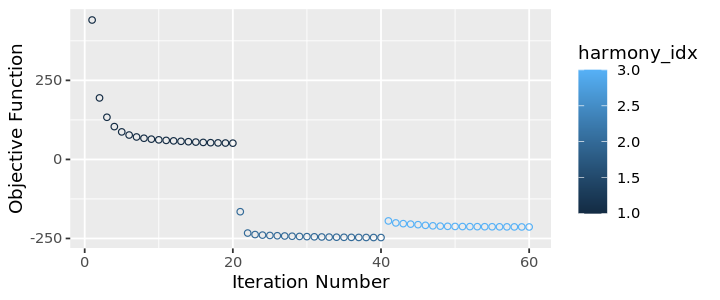

In [1001]:
options(repr.plot.height = 2.5, repr.plot.width = 6)
IN.hm.integrated <- RunHarmony(
  object = IN_cells.hm,
  group.by.vars = 'Source',
plot_convergence = TRUE
)

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
23:04:07 UMAP embedding parameters a = 0.9922 b = 1.112

23:04:07 Read 13551 rows and found 20 numeric columns

23:04:07 Using Annoy for neighbor search, n_neighbors = 30

23:04:07 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

23:04:09 Writing NN index file to temp file /tmp/RtmpWd2D7v/fileb1a1c2fabb9

23:04:09 Searching Annoy index using 18 threads, search_k = 3000

23:04:10 Annoy recall = 100%

23:04:11 Commencing smooth kNN distance calibration using 18 threads

23:04:12 Initializing

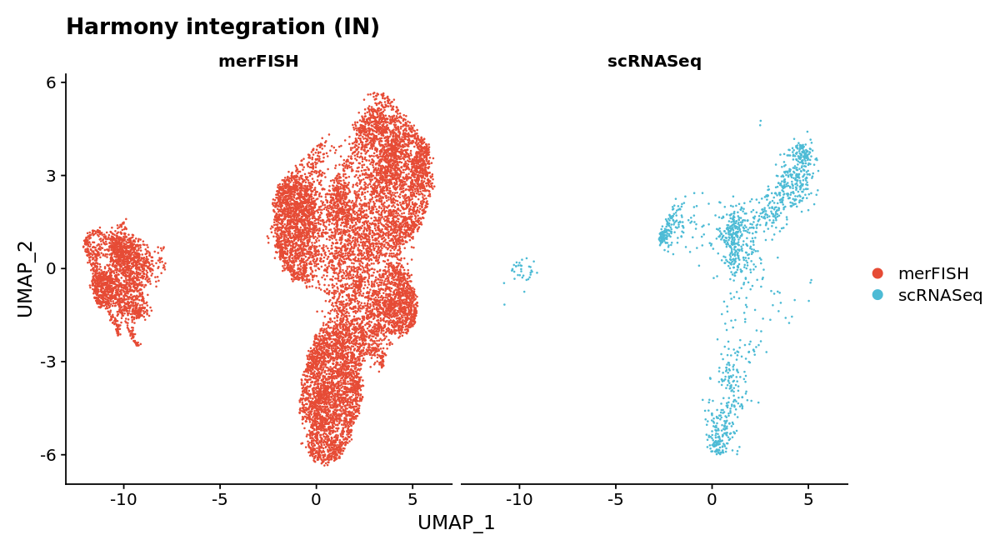

In [1002]:
# re-compute the UMAP using corrected LSI embeddings
IN.hm.integrated <- RunUMAP(IN.hm.integrated, dims = 1:20, reduction = 'harmony')

png 
  2

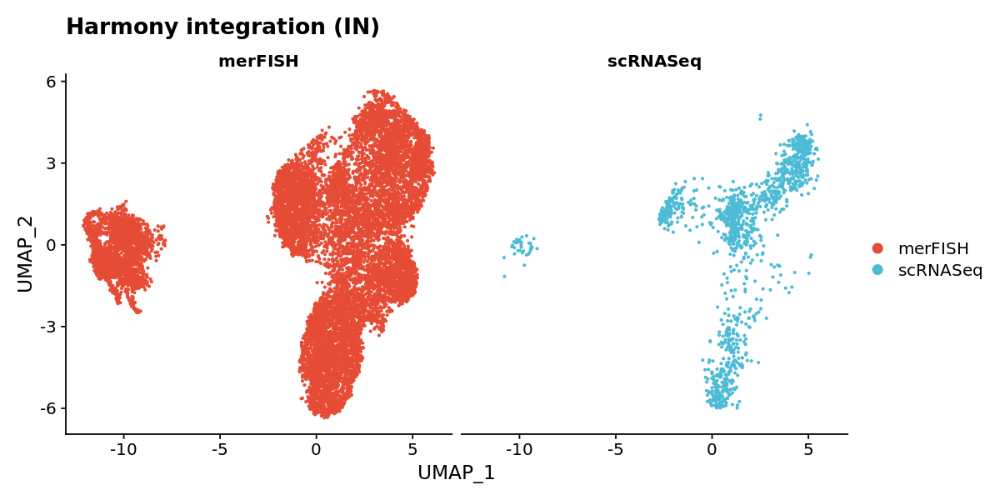

In [1007]:
options(repr.plot.height = 5, repr.plot.width = 10)
pdf("Interegrated_IN_umap.pdf",width = 10,height = 5)
p= DimPlot(IN.hm.integrated, group.by = 'Source',split.by = "Source", pt.size = 0.5,cols = ggsci::pal_npg()(10)) + ggplot2::ggtitle("Harmony integration (IN)")
print(p)
dev.off()
p

png 
  2

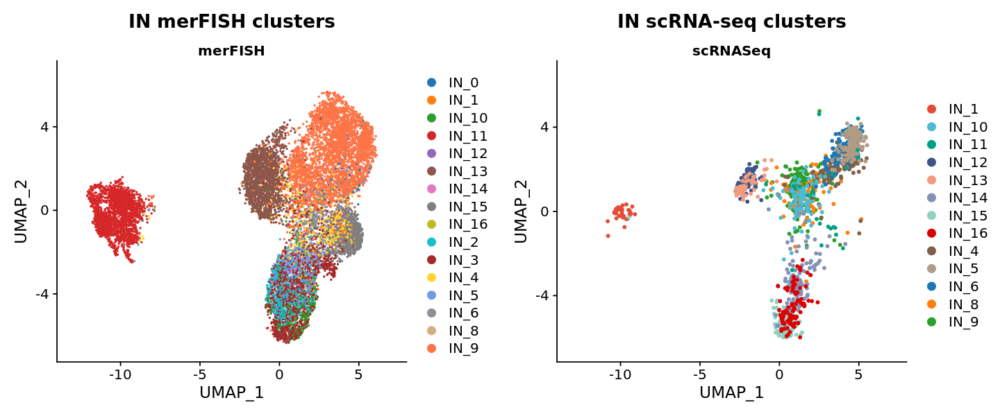

In [1018]:
obj1 = subset(IN.hm.integrated, Source == "scRNASeq")
obj2 = subset(IN.hm.integrated, Source == "merFISH")

p1 = DimPlot(obj2, 
             group.by = 'clusterLabel',
             split.by = "Source", 
             pt.size = 0.3, 
             label=FALSE, 
             repel = TRUE,
             cols = c(ggsci::pal_d3()(10),"brown", ggsci::pal_simpsons()(10)), #c(ggsci::pal_npg()(10), ggsci::pal_rickandmorty()(8),ggsci::pal_d3("category20c")(20)),
             label.size = 6) + ggtitle("IN merFISH clusters") + theme(plot.title = element_text(hjust = 0.5)) +
              xlim(-13,7) + ylim(-6.6,6.5)

p2 = DimPlot(obj1, 
             group.by = 'L1_Clustering',
             split.by = "Source", 
             pt.size = 1, 
             label=FALSE, 
             repel = TRUE,
             cols = c(ggsci::pal_npg()(10), ggsci::pal_d3()(10)),
             label.size = 6) + ggtitle("IN scRNA-seq clusters") + theme(plot.title = element_text(hjust = 0.5)) +
             xlim(-13,7) + ylim(-6.5,6.5)

options(repr.plot.height = 5, repr.plot.width = 12)
pdf("Interegrated_IN_scRNASeq_L1_clusters_UMAP_noNames.pdf",width = 12,height = 5.5)
cowplot::plot_grid(p1,p2)
dev.off()
cowplot::plot_grid(p1,p2)

png 
  2

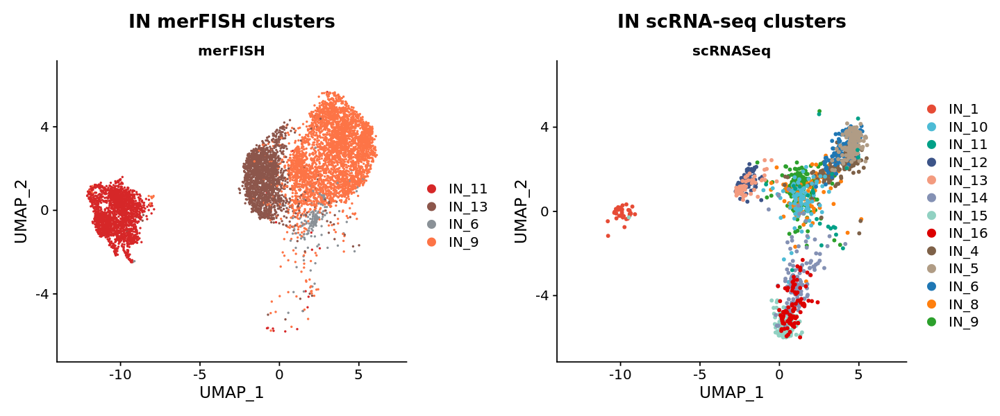

In [1021]:
obj1 = subset(IN.hm.integrated, Source == "scRNASeq")
obj2 = subset(IN.hm.integrated, Source == "merFISH")
obj2 = subset(obj2,clusterLabel %in% c("IN_6","IN_9","IN_11","IN_13"))

p1 = DimPlot(obj2, 
             group.by = 'clusterLabel',
             split.by = "Source", 
             pt.size = 0.3, 
             label=FALSE, 
             repel = TRUE,
             cols = c(ggsci::pal_d3()(10),"brown", ggsci::pal_simpsons()(10))[c(4,6,14,16)], #c(ggsci::pal_npg()(10), ggsci::pal_rickandmorty()(8),ggsci::pal_d3("category20c")(20)),
             label.size = 6) + ggtitle("IN merFISH clusters") + theme(plot.title = element_text(hjust = 0.5)) +
              xlim(-13,7) + ylim(-6.6,6.5)

p2 = DimPlot(obj1, 
             group.by = 'L1_Clustering',
             split.by = "Source", 
             pt.size = 1, 
             label=FALSE, 
             repel = TRUE,
             cols = c(ggsci::pal_npg()(10), ggsci::pal_d3()(10)),
             label.size = 6) + ggtitle("IN scRNA-seq clusters") + theme(plot.title = element_text(hjust = 0.5)) +
             xlim(-13,7) + ylim(-6.5,6.5)

options(repr.plot.height = 5, repr.plot.width = 12)
pdf("Interegrated_IN_Filtered_scRNASeq_L1_clusters_UMAP_noNames.pdf",width = 12,height = 5.5)
cowplot::plot_grid(p1,p2)
dev.off()
cowplot::plot_grid(p1,p2)

In [1022]:
## Get nearest neighbours
IN_scRNACells =  colnames(IN.hm.integrated)[which(IN.hm.integrated@meta.data$Source == "scRNASeq")]
IN_merFISHCells =  colnames(IN.hm.integrated)[which(IN.hm.integrated@meta.data$Source == "merFISH")]
IN_NN <- Seurat:::FindNN(
    object = IN.hm.integrated,
    cells1 = IN_scRNACells,
    cells2 = IN_merFISHCells,
    internal.neighbors = NULL,
    dims = 1:20,
    reduction = "harmony",
    #reduction.2 = reduction.2,
    nn.reduction = "harmony",
    k = 5,
    nn.method = "rann",
    eps = 0,
    verbose = TRUE
  )

Finding neighborhoods



In [1024]:
IN_neighbors <- GetIntegrationData(object = IN_NN, integration.name = "integrated", slot = 'neighbors')

In [1023]:
IN_scRNASeq.hm = subset(IN.hm.integrated, Source == "scRNASeq")
IN_merFISH.hm = subset(IN.hm.integrated, Source == "merFISH")

In [1034]:
save.image("01012021_image.RData")

In [1050]:
PredictINmerFISHexpr <- function(x){
	
	cellNames = colnames(IN_scRNASeq.hm)[x]
	counts <- NAc_cells_all_filtered[['RNA']]@counts[,cellNames]
	expr = rowMeans(counts)
	expr = round(expr)
	expr
}

In [1053]:
INlabel.scRNASeq_NN = apply(IN_neighbors[['nnba']]@nn.idx,1,PredictINmerFISHexpr)

In [1054]:
dim(INlabel.scRNASeq_NN)

[1] 26145 12221

In [1058]:
colnames(INlabel.scRNASeq_NN) = IN_merFISHCells

In [1057]:
head(rownames(INlabel.scRNASeq_NN))

[1] "2.22029500591606e+38" "7.18016453755857e+37" "1.0676354480639e+38" 
[4] "2.6531140720693e+38"  "2.97056666066055e+38" "1.97125003737245e+37"

In [1078]:
table(IN.hm.integrated@meta.data[colnames(INlabel.scRNASeq_NN),"clusterLabel"])


 IN_0  IN_1 IN_10 IN_11 IN_12 IN_13 IN_14 IN_15 IN_16  IN_2  IN_3  IN_4  IN_5 
   61   125   344  2014    23  1826    53   792    18   531  1396   555   640 
 IN_6  IN_8  IN_9 
  179    39  3625 

#### Merge predicted expressions

In [1079]:
predicted_expr = cbind(D1label.scRNASeq_NN, D2label.scRNASeq_NN)
predicted_expr = cbind(predicted_expr, INlabel.scRNASeq_NN)
dim(predicted_expr)

[1]  26145 128504

In [1093]:
colnames(D1.hm.integrated@meta.data)

[1] "orig.ident"      "percent.mito"    "Sample"          "tree.ident"     
 [5] "CellType"        "L2_Clustering"   "L1_Clustering"   "nCount_RNA"     
 [9] "nFeature_RNA"    "Source"          "sliceNumber"     "datasetName"    
[13] "clusterLabel"    "StriatumCells"   "cellType"        "Batch"          
[17] "leiden"          "clus"            "OldAnno"         "NewAnno"        
[21] "batchCInfo"      "RNA_snn_res.0.8" "seurat_clusters"

In [1097]:
lbls = c(as.character(D1.hm.integrated@meta.data[colnames(D1label.scRNASeq_NN),"clusterLabel"]),
	     as.character(D2.hm.integrated@meta.data[colnames(D2label.scRNASeq_NN),"clusterLabel"]),
	     as.character(IN.hm.integrated@meta.data[colnames(INlabel.scRNASeq_NN),"clusterLabel"])
	     )

In [1100]:
slice = c(as.character(D1.hm.integrated@meta.data[colnames(D1label.scRNASeq_NN),"sliceNumber"]),
	     as.character(D2.hm.integrated@meta.data[colnames(D2label.scRNASeq_NN),"sliceNumber"]),
	     as.character(IN.hm.integrated@meta.data[colnames(INlabel.scRNASeq_NN),"sliceNumber"])
	     )

In [1099]:
batch = c(as.character(D1.hm.integrated@meta.data[colnames(D1label.scRNASeq_NN),"Batch"]),
	     as.character(D2.hm.integrated@meta.data[colnames(D2label.scRNASeq_NN),"Batch"]),
	     as.character(IN.hm.integrated@meta.data[colnames(INlabel.scRNASeq_NN),"Batch"])
	     )

In [1101]:
annot_lbl = data.frame(clusterLabel = lbls, sliceNumber = slice, Batch= batch)
rownames(annot_lbl) = colnames(predicted_expr)
head(annot_lbl)

,clusterLabel,sliceNumber,Batch
,<fct>,<fct>,<fct>
1.03551627122072e+38,D1_4,13,C
1.39072088797649e+38,D1_15,12,D
2.68736140669033e+38,D1_13,2,C
1.97437949745504e+38,D1_4,12,C
1.36055939133604e+38,D1_3,14,D
1.94110149165846e+38,D1_13,9,C


In [1113]:
merFISH_BathC_filtered_sobj2 = subset(merFISH_sobj, Batch == "C")
merFISH_BathC_filtered_sobj2 = subset(merFISH_BathC_filtered_sobj2,cellType %in% c("D1","D2","IN"))
merFISH_BathC_filtered_sobj2 = merFISH_BathC_filtered_sobj2[,! merFISH_BathC_filtered_sobj2$clusterLabel %in% c("D1_15","D1_17","D2_8","D2_11",glue::glue("IN_{c(0:5,7,8,10,12,14:16)}"))] 
merFISH_BathC_filtered_sobj2

An object of class Seurat 
253 features across 72436 samples within 1 assay 
Active assay: RNA (253 features, 252 variable features)
 3 dimensional reductions calculated: harmony, umap, tsne

In [1114]:
str(merFISH_BathC_filtered_sobj2[['tsne']])

Formal class 'DimReduc' [package "Seurat"] with 9 slots
  ..@ cell.embeddings           : num [1:72436, 1:2] 522 6497 18110 117 183 ...
  .. ..- attr(*, "dimnames")=List of 2
  .. .. ..$ : chr [1:72436] "1.03551627122072e+38" "2.68736140669033e+38" "1.97437949745504e+38" "1.94110149165846e+38" ...
  .. .. ..$ : chr [1:2] "tSNE_1" "tSNE_2"
  ..@ feature.loadings          : num[0 , 0 ] 
  ..@ feature.loadings.projected: num[0 , 0 ] 
  ..@ assay.used                : chr "RNA"
  ..@ global                    : logi TRUE
  ..@ stdev                     : num(0) 
  ..@ key                       : chr "tSNE_"
  ..@ jackstraw                 :Formal class 'JackStrawData' [package "Seurat"] with 4 slots
  .. .. ..@ empirical.p.values     : num[0 , 0 ] 
  .. .. ..@ fake.reduction.scores  : num[0 , 0 ] 
  .. .. ..@ empirical.p.values.full: num[0 , 0 ] 
  .. .. ..@ overall.p.values       : num[0 , 0 ] 
  ..@ misc                      : list()


In [1115]:
predicted_expr_filtered = predicted_expr[, colnames(predicted_expr) %in% colnames(merFISH_BathC_filtered_sobj2)]
dim(predicted_expr_filtered)

[1] 26145 69143

In [1117]:
annot_lbl_filtered = annot_lbl[colnames(predicted_expr_filtered),]
dim(annot_lbl_filtered)

[1] 69143     3

In [1116]:
predicted_expr_filtered_tsne = merFISH_BathC_filtered_sobj2[['tsne']]@cell.embeddings[colnames(predicted_expr_filtered),]
dim(predicted_expr_filtered_tsne)

[1] 69143     2

In [1083]:
saveRDS(predicted_expr, file = "predicted_D1_D2_IN_expr.Rds")

In [1084]:
saveRDS(annot_lbl, file = "annot_lbl_D1_D2_IN.Rds")

In [1118]:
saveRDS(predicted_expr_filtered, file = "predicted_filtered_D1_D2_IN_expr.Rds")

In [1119]:
saveRDS(annot_lbl_filtered, file = "annot_lbl_filtered_D1_D2_IN.Rds")

In [1120]:
saveRDS(predicted_expr_filtered_tsne, file = "location_filtered_D1_D2_IN.Rds")

In [ ]:
save.image("01022021_image.RData")

## GWAS realted genes enrichment

In [ ]:
GWAS_associations <- data.table::fread("gwas_catalog_v1.0.2-associations_e93_r2018-08-21.tsv")

PFC_disease_GWAS <- list()

pos <- unique(grep("Schizophrenia",GWAS_associations$`DISEASE/TRAIT`,value = T))
pos2 <-  unique(grep("Bipolar",GWAS_associations$`DISEASE/TRAIT`,value = T))
pos2 <- grep("schizophrenia",pos2,value = T)
PFC_disease_GWAS[["Schizophrenia"]] <- subset(GWAS_associations,`DISEASE/TRAIT` %in% c(pos,pos2))

pos3 <-  unique(grep("Bipolar",GWAS_associations$`DISEASE/TRAIT`,value = T,ignore.case=T))
pos3 <- grep("schizophrenia",pos3,value = T,invert = T,,ignore.case=T)
PFC_disease_GWAS[["Bipolar"]] <- subset(GWAS_associations,`DISEASE/TRAIT` %in% c(pos3))

pos4 <-  unique(grep("Alcohol dependence|Alcoholism",GWAS_associations$`DISEASE/TRAIT`,value = T,ignore.case=T))
pos4 <- grep("liver",pos4, value = T,invert = T,,ignore.case=T)
PFC_disease_GWAS[["Alcohol"]] <- subset(GWAS_associations,`DISEASE/TRAIT` %in% c(pos3))

PFC_disease_GWAS[["Cocaine dependence"]] <- subset(GWAS_associations,`DISEASE/TRAIT` %in% c("Cocaine dependence"))

pos <- unique(grep("Nicotine",GWAS_associations$`DISEASE/TRAIT`,value = T))
PFC_disease_GWAS[["Nicotine"]] <- subset(GWAS_associations,`DISEASE/TRAIT` %in% c("Nicotine dependence","Alcohol and nicotine co-dependence","Nicotine use"))

PFC_disease_GWAS[["Addiction"]] <- subset(GWAS_associations,`DISEASE/TRAIT` %in% c("Addiction"))

pos <- unique(grep("Huntington",GWAS_associations$`DISEASE/TRAIT`,value = T))
PFC_disease_GWAS[["Huntington"]] <- subset(GWAS_associations,`DISEASE/TRAIT` %in% c(pos))

pos <- unique(grep("Parkinson",GWAS_associations$`DISEASE/TRAIT`,value = T))
PFC_disease_GWAS[["Parkinson"]] <- subset(GWAS_associations,`DISEASE/TRAIT` %in% c(pos))



pos <- unique(grep("Obsessive-compulsive disorder",GWAS_associations$`DISEASE/TRAIT`,value = T))
PFC_disease_GWAS[["Obsessive-compulsive disorder"]] <- subset(GWAS_associations,`DISEASE/TRAIT` %in% c(pos))

PFC_disease_GWAS[["Depression"]] <- subset(GWAS_associations,`DISEASE/TRAIT` %in% c("Depression","Depression (quantitative trait)","Response to selective serotonin reuptake inhibitors and depression","Depression (broad)"))


getwd()

In [917]:
names(PFC_disease_GWAS)

ERROR: Error in eval(expr, envir, enclos): object 'PFC_disease_GWAS' not found


In [ ]:
require(biomaRt)

NAc_disease_GWAS_genes <- list()

for(disease in names(NAc_disease_GWAS)){
  tmp_genes <- unique(unlist(strsplit(NAc_disease_GWAS[[disease]]$`REPORTED GENE(S)`,split = ",")))
  tmp_genes <- gsub("^\\s+","",tmp_genes)
  tmp_genes <- setdiff(tmp_genes,c("intergenic","NR"))
  tmp_genes_mouse <- convertHumanGeneList(tmp_genes)
  NAc_disease_GWAS_genes[[disease]] = tmp_genes_mouse
}


In [919]:
load("NAc_disease_GWAS_genes.RData")

In [920]:
names(NAc_disease_GWAS_genes)

[1] "Schizophrenia"                 "Bipolar"                      
 [3] "Alcohol"                       "Cocaine dependence"           
 [5] "Nicotine"                      "Addiction"                    
 [7] "Huntington"                    "Parkinson"                    
 [9] "Obsessive-compulsive disorder" "Depression"

In [921]:
require("SamSPECTRAL")

In [922]:
options(future.globals.maxSize= 20 * 2^1024)

In [923]:
NAc_MSN_scRNASeq_all_sobj = merge(D1_scRNASeq_all, D2_scRNASeq_all) %>% ScaleData( verbose = FALSE)
NAc_MSN_scRNASeq_all_sobj

An object of class Seurat 
26145 features across 15298 samples within 1 assay 
Active assay: RNA (26145 features, 0 variable features)

In [948]:
head(NAc_MSN_scRNASeq_all_sobj@meta.data)

,orig.ident,percent.mito,Sample,tree.ident,CellType,L2_Clustering,L1_Clustering,nCount_RNA,nFeature_RNA,NN,treatment,Period
,<chr>,<dbl>,<chr>,<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<chr>,<chr>,<chr>
TTAGTTCGTCTGCGGT.NAc_Sample7,D1_3,0.03019250,NAc_Sample6,6,D1,D1_28,D1_3,4935,2129,D1_11,Cocaine,withdraw_48h
CACATTTGTCCGAAGA.NAc_Sample12,D1_3,0.04535061,NAc_Sample11,6,D1,D1_28,D1_3,5248,2183,D1_11,Saline,withdraw_15d
ATAGACCTCAAACAAG.NAc_Sample1,D1_3,0.02899432,NAc_Sample1,6,D1,D1_28,D1_3,4932,2070,D1_11,Cocaine,Maintenance
ATTTCTGAGATGAGAG.NAc_Sample1,D1_3,0.02695167,NAc_Sample1,6,D1,D1_28,D1_3,4304,2032,D1_8,Cocaine,Maintenance
GAACATCCAGTCAGCC.NAc_Sample1,D1_3,0.02317544,NAc_Sample1,6,D1,D1_28,D1_3,4919,2116,D1_11,Cocaine,Maintenance
GATCGCGTCGGTTAAC.NAc_Sample1,D1_3,0.02808599,NAc_Sample1,6,D1,D1_28,D1_3,5768,2402,D1_8,Cocaine,Maintenance


In [924]:
NAc_disease_GWAS_genes_association = list()

rs = apply(NAc_MSN_scRNASeq_all_sobj[['RNA']]@data,1,max)

NAc_MSN_scRNASeq_all_sobj = NAc_MSN_scRNASeq_all_sobj[rs>0,]
NAc_MSN_scRNASeq_all_sobj

An object of class Seurat 
19448 features across 15298 samples within 1 assay 
Active assay: RNA (19448 features, 0 variable features)

In [966]:
RobustAverageExpression <- function(sobj, assay ="RNA",slot="data"){
  
  sobj_expr = expm1(sobj[['RNA']]@data)
  #if(assay != "RNA"){
  #  sobj_expr <- GetAssayData(sobj, assay.type = assay, slot = slot)
  #  sobj_expr = expm1(sobj_expr)
  #}else{
  #  sobj_expr = expm1(sobj[['RNA']]@data)    
  #}
  
  AE_expression <- matrix(0,nrow = nrow(sobj_expr), ncol = length(levels(sobj@active.ident)))
  rownames(AE_expression)= rownames(sobj_expr)
  colnames(AE_expression) <- levels(sobj@active.ident)
  
  for(clus in levels(sobj@active.ident)){
    
    pos <- which(sobj@active.ident == clus)
    
    cls_mean  <- apply(sobj_expr[,pos],1,function(x){
      q99= as.numeric(quantile(x,probs = 0.99))
      x = x[x<=q99]
      if(length(x)>0){
        mean(x)  
      }else{
        0
      }
    })
    
    AE_expression[,clus]= cls_mean
    print(paste0("Finished processing cluster: ",clus))
  }
  
  #AE_expression = log2(AE_expression+1)
  AE_expression
}

In [967]:
RobustAverageDetection <- function(sobj, assay ="RNA",slot="data"){
  
  sobj_expr = expm1(sobj[["RNA"]]@data)
  #if(assay != "RNA"){
  #  sobj_expr <- GetAssayData(sobj, assay.type = assay, slot = slot)
  #  sobj_expr = expm1(sobj_expr)
  #}else{
  #  sobj_expr = expm1(sobj@data)  
  #}
  
  AE_detection <- matrix(0,nrow = nrow(sobj_expr), ncol = length(levels(sobj@active.ident)))
  rownames(AE_detection)= rownames(sobj_expr)
  colnames(AE_detection) <- levels(sobj@active.ident)
  
  for(clus in levels(sobj@active.ident)){
    
    pos <- which(sobj@active.ident == clus)
    
    cls_percent  <- apply(sobj_expr[,pos],1,function(x){
      
      q99= as.numeric(quantile(x,probs = 0.99))
      x = x[x<q99]
      if(length(x)>0){
        sum(x>=1)/length(x)        
      }else{
        0
      }
      
    })
    
    AE_detection[,clus]= cls_percent
    print(paste0("Finished processing cluster: ",clus))
  }
  
  AE_detection
}

In [927]:
AE_expression = RobustAverageExpression(NAc_MSN_scRNASeq_all_sobj)

[1] "Finished processing cluster: D1_1"
[1] "Finished processing cluster: D1_2"
[1] "Finished processing cluster: D1_3"
[1] "Finished processing cluster: D1_4"
[1] "Finished processing cluster: D1_5"
[1] "Finished processing cluster: D1_6"
[1] "Finished processing cluster: D1_7"
[1] "Finished processing cluster: D1_8"
[1] "Finished processing cluster: D2_1"
[1] "Finished processing cluster: D2_2"
[1] "Finished processing cluster: D2_3"
[1] "Finished processing cluster: D2_4"
[1] "Finished processing cluster: D2_5"
[1] "Finished processing cluster: D2_6"
[1] "Finished processing cluster: D2_7"
[1] "Finished processing cluster: D2_8"


In [928]:
all_cells_AE_detection <-  RobustAverageDetection(NAc_MSN_scRNASeq_all_sobj)

[1] "Finished processing cluster: D1_1"
[1] "Finished processing cluster: D1_2"
[1] "Finished processing cluster: D1_3"
[1] "Finished processing cluster: D1_4"
[1] "Finished processing cluster: D1_5"
[1] "Finished processing cluster: D1_6"
[1] "Finished processing cluster: D1_7"
[1] "Finished processing cluster: D1_8"
[1] "Finished processing cluster: D2_1"
[1] "Finished processing cluster: D2_2"
[1] "Finished processing cluster: D2_3"
[1] "Finished processing cluster: D2_4"
[1] "Finished processing cluster: D2_5"
[1] "Finished processing cluster: D2_6"
[1] "Finished processing cluster: D2_7"
[1] "Finished processing cluster: D2_8"


In [929]:
NAc_disease_GWAS_genes$Addiction = NULL

In [933]:
NAc_disease_GWAS_genes$Nicotine %in% rownames(NAc_MSN_scRNASeq_all_sobj)

[1]  TRUE  TRUE  TRUE FALSE  TRUE FALSE  TRUE FALSE  TRUE  TRUE  TRUE  TRUE
[13]  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE
[25]  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE FALSE

In [953]:
NAc_disease_GWAS_genes_association[["e-5"]] = getDiseaseAssociation(NAc_disease_GWAS_genes,
                          NAc_MSN_scRNASeq_all_sobj,
                          groups = levels(NAc_MSN_scRNASeq_all_sobj@active.ident),
                          gpval = 1e-3,
                          lpval = 0.05, 
                          perpval = 1e-3,
                          all_mrks = NULL,
                          AE_expression = AE_expression,
                          AE_detection = all_cells_AE_detection)

[1] "Schizophrenia"
[1] "selected_genes"
 [1] "Reln"          "Coro7"         "Lrrn3"         "Abcb9"        
 [5] "Mef2c"         "Msi2"          "Npas3"         "Syt13"        
 [9] "Ptpru"         "Tcf4"          "Nrn1l"         "Lingo2"       
[13] "Psmb10"        "Cntn4"         "Cdh13"         "Atp2a2"       
[17] "Zswim6"        "Ptn"           "Nos1"          "Esam"         
[21] "Ecm1"          "Sgk1"          "Drd2"          "Chrm4"        
[25] "Adam23"        "Zfyve21"       "Cntn5"         "Pitpnm2"      
[29] "As3mt"         "Ddc"           "Zfp804a"       "Nrgn"         
[33] "Wdr1"          "Prkd1"         "Msra"          "Col25a1"      
[37] "Coq10b"        "Grik3"         "Kcnv1"         "Mchr1"        
[41] "Ppp2r2a"       "St3gal1"       "Ephx2"         "1700010I14Rik"
[45] "Flrt2"         "Cacng5"        "Dpyd"          "Dclk3"        
[49] "Ndst3"         "Ptprf"         "Csdc2"         "Spats2l"      
[53] "Nrp1"          "Doc2a"         "Dgkz"          "Zdbf2"  

In [954]:
sapply(NAc_disease_GWAS_genes_association[["e-5"]], nrow)

Schizophrenia                       Bipolar 
                           64                            24 
                      Alcohol            Cocaine dependence 
                           24                             0 
                     Nicotine                    Huntington 
                            3                             2 
                    Parkinson Obsessive-compulsive disorder 
                           14                             4 
                   Depression 
                           10

In [955]:
NAc_disease_GWAS_expressed_classes <- list()

for(disease in names(NAc_disease_GWAS_genes_association[["e-5"]])){
  print(disease)
  if(nrow(NAc_disease_GWAS_genes_association[["e-5"]][[disease]])>0){
    NAc_disease_GWAS_expressed_classes[["e-5"]][[disease]]= getExpressedClasses2(NAc_disease_GWAS_genes_association[["e-5"]][[disease]])
  }
}

[1] "Schizophrenia"
[1] "Bipolar"
[1] "Alcohol"
[1] "Cocaine dependence"
[1] "Nicotine"
[1] "Huntington"
[1] "Parkinson"
[1] "Obsessive-compulsive disorder"
[1] "Depression"


In [988]:
dir.create("GWAS",showWarnings = F)
dir.create("GWAS/FinalAssociation",showWarnings = F)

dir.create("GWAS/FinalAssociation/Heatmaps",showWarnings = F)
dir.create("GWAS/FinalAssociation/csv",showWarnings = F)
dir.create("GWAS/FinalAssociation/csv_melted",showWarnings = F)

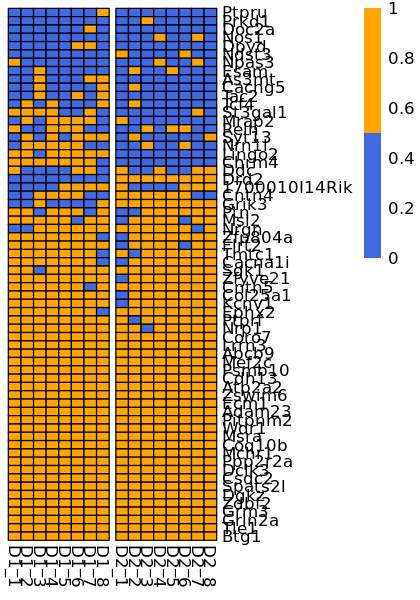

In [986]:
disease='Schizophrenia'
  fname = paste0("GWAS/FinalAssociation/Heatmaps/",disease,"_heatmap2.pdf")
  
  gaps = gsub("_\\d+","",colnames(NAc_disease_GWAS_genes_association[["e-5"]][[disease]]))
  gaps = factor(gaps)
  gaps = diff(as.numeric(gaps))
  gaps = which(gaps==1)
  h = ceiling(nrow(NAc_disease_GWAS_genes_association[["e-5"]][[disease]])/6)
  h = ifelse(h<4,4,h)
  rs = rowSums(NAc_disease_GWAS_genes_association[["e-5"]][[disease]])
  ord = order(rs)
  #pdf(fname,width =  14,height = h)
  #touse.genes = unique(subset(NAc_disease_GWAS_expressed_classes[["e-5"]][[disease]], category != "cluster-Specific")$gene)
  pheatmap::pheatmap(NAc_disease_GWAS_genes_association[["e-5"]][[disease]][ord,],  #[touse.genes,],
                   cluster_rows = F,
                   cluster_cols = F,
                   gaps_col = gaps,
                   color = c("royalblue", "orange"),
                   border_color = "black",
                   clustering_method = "ward.D2",silent = FALSE)
  #dev.off()

In [958]:
disease

[1] "Depression"

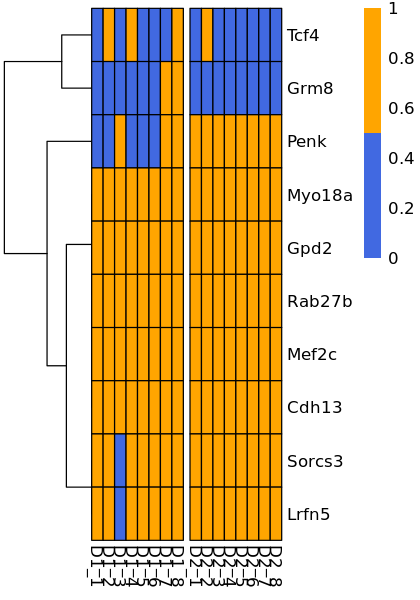

In [957]:
pheatmap::pheatmap(NAc_disease_GWAS_genes_association[["e-5"]][[disease]],#[touse.genes,],
                   cluster_cols = F,
                   gaps_col = gaps,
                   color = c("royalblue", "orange"),
                   border_color = "black",
                   clustering_method = "ward.D2",silent = FALSE)

In [991]:
require(reshape2)
NAc_disease_GWAS_genes_association[["e-5"]]$`Cocaine dependence` = NULL
for(disease in names(NAc_disease_GWAS_genes_association[["e-5"]])){
    print(disease)
  graphics.off()
  fname = paste0("GWAS/FinalAssociation/Heatmaps/",disease,"_heatmap.pdf")
  
  gaps = gsub("_\\d+","",colnames(NAc_disease_GWAS_genes_association[["e-5"]][[disease]]))
  gaps = factor(gaps)
  gaps = diff(as.numeric(gaps))
  gaps = which(gaps==1)
  h = ceiling(nrow(NAc_disease_GWAS_genes_association[["e-5"]][[disease]])/6)
  h = ifelse(h<4,4,h)
  pdf(fname,width =  5,height = h)
  rs = rowSums(NAc_disease_GWAS_genes_association[["e-5"]][[disease]])
  ord = order(rs)
  #touse.genes = unique(subset(NAc_disease_GWAS_expressed_classes[["e-5"]][[disease]], category != "cluster-Specific")$gene)
  ph= pheatmap::pheatmap(NAc_disease_GWAS_genes_association[["e-5"]][[disease]][ord,],#[touse.genes,],
                   cluster_rows = F,
                   cluster_cols = F,
                   gaps_col = gaps,
                   color = c("royalblue", "orange"),
                   border_color = "black",
                   clustering_method = "ward.D2",silent = FALSE)
  dev.off()

  
  fname = paste0("GWAS/FinalAssociation/csv/",disease,"_heatmap.csv")
  write.csv(NAc_disease_GWAS_genes_association[["e-5"]][[disease]][ord,], file=fname)
  
  tmp =NAc_disease_GWAS_genes_association[["e-5"]][[disease]][ord,]
  tmp = data.frame(tmp)
  tmp$gene = rownames(tmp)
  mlt= melt(tmp)
  colnames(mlt)= c("gene","cluster","value")
  fname = paste0("GWAS/FinalAssociation/csv_melted/",disease,"_heatmap.csv")
  write.csv(mlt, file=fname,row.names = F)
}

[1] "Schizophrenia"


Using gene as id variables



[1] "Bipolar"


Using gene as id variables



[1] "Alcohol"


Using gene as id variables



[1] "Nicotine"


Using gene as id variables



[1] "Huntington"


Using gene as id variables



[1] "Parkinson"


Using gene as id variables



[1] "Obsessive-compulsive disorder"


Using gene as id variables



[1] "Depression"


Using gene as id variables



## GWAS for MERFISH clusters.

In [965]:
Idents(NAc_MSN_scRNASeq_all_sobj) = NAc_MSN_scRNASeq_all_sobj$NN
NAc_MSN_scRNASeq_all_sobj

An object of class Seurat 
19448 features across 15298 samples within 1 assay 
Active assay: RNA (19448 features, 0 variable features)

In [129]:
DimPlot(NAc_MSN_scRNASeq_all_sobj)

ERROR: Error: Unable to find a DimReduc matching one of 'umap', 'tsne', or 'pca', please specify a dimensional reduction to use


In [968]:
MERFISH_AE_expression <- RobustAverageExpression(NAc_MSN_scRNASeq_all_sobj)

[1] "Finished processing cluster: D1_11"
[1] "Finished processing cluster: D1_8"
[1] "Finished processing cluster: D1_9"
[1] "Finished processing cluster: D1_3"
[1] "Finished processing cluster: D1_2"
[1] "Finished processing cluster: D1_12"
[1] "Finished processing cluster: D1_5"
[1] "Finished processing cluster: D1_10"
[1] "Finished processing cluster: D1_1"
[1] "Finished processing cluster: D1_4"
[1] "Finished processing cluster: D1_7"
[1] "Finished processing cluster: D1_6"
[1] "Finished processing cluster: D1_15"
[1] "Finished processing cluster: D1_14"
[1] "Finished processing cluster: D1_13"
[1] "Finished processing cluster: D2_7"
[1] "Finished processing cluster: D2_5"
[1] "Finished processing cluster: D2_1"
[1] "Finished processing cluster: D2_3"
[1] "Finished processing cluster: D2_6"
[1] "Finished processing cluster: D2_2"
[1] "Finished processing cluster: D2_11"
[1] "Finished processing cluster: D2_8"
[1] "Finished processing cluster: D2_10"


In [969]:
MERFISH_AE_detection <-  RobustAverageDetection(NAc_MSN_scRNASeq_all_sobj)

[1] "Finished processing cluster: D1_11"
[1] "Finished processing cluster: D1_8"
[1] "Finished processing cluster: D1_9"
[1] "Finished processing cluster: D1_3"
[1] "Finished processing cluster: D1_2"
[1] "Finished processing cluster: D1_12"
[1] "Finished processing cluster: D1_5"
[1] "Finished processing cluster: D1_10"
[1] "Finished processing cluster: D1_1"
[1] "Finished processing cluster: D1_4"
[1] "Finished processing cluster: D1_7"
[1] "Finished processing cluster: D1_6"
[1] "Finished processing cluster: D1_15"
[1] "Finished processing cluster: D1_14"
[1] "Finished processing cluster: D1_13"
[1] "Finished processing cluster: D2_7"
[1] "Finished processing cluster: D2_5"
[1] "Finished processing cluster: D2_1"
[1] "Finished processing cluster: D2_3"
[1] "Finished processing cluster: D2_6"
[1] "Finished processing cluster: D2_2"
[1] "Finished processing cluster: D2_11"
[1] "Finished processing cluster: D2_8"
[1] "Finished processing cluster: D2_10"


In [982]:
NAc_MERFISH_GWAS_genes_association <- list()
NAc_MERFISH_GWAS_genes_association[["e-5"]] <- getDiseaseAssociation(NAc_disease_GWAS_genes,
                          NAc_MSN_scRNASeq_all_sobj,
                          groups = levels(NAc_MSN_scRNASeq_all_sobj@active.ident),
                          gpval = 1e-3,
                          lpval = 0.05, 
                          perpval = 1e-3,
                          all_mrks = NULL,
                          AE_expression = MERFISH_AE_expression,
                          AE_detection = MERFISH_AE_detection)

[1] "Schizophrenia"
[1] "selected_genes"
 [1] "Reln"          "Coro7"         "Ngef"          "Lrrn3"        
 [5] "Abcb9"         "Mef2c"         "Msi2"          "Npas3"        
 [9] "Syt13"         "Ptpru"         "Tcf4"          "Nrn1l"        
[13] "Erc2"          "Lingo2"        "Psmb10"        "Cntn4"        
[17] "Ncan"          "Adcy1"         "Cdh11"         "Cdh13"        
[21] "Atp2a2"        "Zswim6"        "Ptn"           "Nos1"         
[25] "Esam"          "Ecm1"          "Sgk1"          "Drd2"         
[29] "Fut9"          "Chrm4"         "Nt5dc2"        "Adam23"       
[33] "Zfyve21"       "Cntn5"         "Pitpnm2"       "As3mt"        
[37] "Mapk3"         "Ddc"           "Zfp804a"       "Nrgn"         
[41] "Wdr1"          "AI593442"      "Prkd1"         "Msra"         
[45] "Zdhhc2"        "Col25a1"       "Grik3"         "Kcnv1"        
[49] "Snx8"          "Mchr1"         "Ppp2r2a"       "St3gal1"      
[53] "Ephx2"         "1700010I14Rik" "Flrt2"         "Cacng5" 

In [983]:
sapply(NAc_MERFISH_GWAS_genes_association[["e-5"]], nrow)

$Schizophrenia
[1] 80

$Bipolar
[1] 39

$Alcohol
[1] 39

$`Cocaine dependence`
NULL

$Nicotine
[1] 4

$Huntington
[1] 4

$Parkinson
[1] 20

$`Obsessive-compulsive disorder`
[1] 6

$Depression
[1] 12

In [992]:
dir.create("GWAS_MERFISH",showWarnings = F)
dir.create("GWAS_MERFISH/FinalAssociation",showWarnings = F)

dir.create("GWAS_MERFISH/FinalAssociation/Heatmaps",showWarnings = F)
dir.create("GWAS_MERFISH/FinalAssociation/csv",showWarnings = F)
dir.create("GWAS_MERFISH/FinalAssociation/csv_melted",showWarnings = F)

In [994]:
require(reshape2)
NAc_MERFISH_GWAS_genes_association[["e-5"]]$`Cocaine dependence` = NULL
for(disease in names(NAc_MERFISH_GWAS_genes_association[["e-5"]])){
  graphics.off()
  fname = paste0("GWAS_MERFISH/FinalAssociation/Heatmaps/",disease,"_heatmap.pdf")
  
  gaps = gsub("_\\d+","",colnames(NAc_MERFISH_GWAS_genes_association[["e-5"]][[disease]]))
  gaps = factor(gaps)
  gaps = diff(as.numeric(gaps))
  gaps = which(gaps==1)
  h = ceiling(nrow(NAc_MERFISH_GWAS_genes_association[["e-5"]][[disease]])/6)
  h = ifelse(h<4,4,h)
  pdf(fname,width =  5,height = h)
  rs = rowSums(NAc_MERFISH_GWAS_genes_association[["e-5"]][[disease]])
  ord = order(rs)
  ph= pheatmap::pheatmap(NAc_MERFISH_GWAS_genes_association[["e-5"]][[disease]][ord,],#[touse.genes,],
                   cluster_rows = F,      
                   cluster_cols = F,
                   gaps_col = gaps,
                   color = c("royalblue", "orange"),
                   border_color = "black",
                   clustering_method = "ward.D2",silent = FALSE)
  dev.off()

  
  fname = paste0("GWAS_MERFISH/FinalAssociation/csv/",disease,"_heatmap.csv")
  write.csv(NAc_MERFISH_GWAS_genes_association[["e-5"]][[disease]][ord,], file=fname)
  
  tmp =NAc_MERFISH_GWAS_genes_association[["e-5"]][[disease]][ord,]
  tmp = data.frame(tmp)
  tmp$gene = rownames(tmp)
  mlt= melt(tmp)
  colnames(mlt)= c("gene","cluster","value")
  fname = paste0("GWAS_MERFISH/FinalAssociation/csv_melted/",disease,"_heatmap.csv")
  write.csv(mlt, file=fname,row.names = F)
}

Using gene as id variables

Using gene as id variables

Using gene as id variables

Using gene as id variables

Using gene as id variables

Using gene as id variables

Using gene as id variables

Using gene as id variables



## D2 markers

In [622]:
table(merFISH.hm.D2@meta.data$clusterLabel)


 D2_1  D2_2  D2_3  D2_4  D2_5  D2_6  D2_7  D2_8  D2_9 D2_10 D2_11 D2_12 
 8973  7190  7150     0  3631  2269  2140  2276     0  1773  1459     0 

In [623]:
Idents(merFISH.hm.D2) = merFISH.hm.D2@meta.data$clusterLabel
D2_mrks = FindAllMarkers(merFISH.hm.D2)
head(D2_mrks)

Calculating cluster D2_1

Calculating cluster D2_2

Calculating cluster D2_3

Calculating cluster D2_5

Calculating cluster D2_6

Calculating cluster D2_7

Calculating cluster D2_8

Calculating cluster D2_10

Calculating cluster D2_11



,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
Ddit4l,0,2.840808,0.509,0.163,0,D2_1,Ddit4l
Rgs4,0,2.236535,0.940,0.482,0,D2_1,Rgs4
Reln,0,2.151268,0.753,0.305,0,D2_1,Reln
Cnr1,0,1.806836,0.635,0.263,0,D2_1,Cnr1
Nrgn,0,1.505097,0.932,0.499,0,D2_1,Nrgn
Calb1,0,1.373771,0.748,0.429,0,D2_1,Calb1


In [624]:
head(D2_mrks)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
Ddit4l,0,2.840808,0.509,0.163,0,D2_1,Ddit4l
Rgs4,0,2.236535,0.940,0.482,0,D2_1,Rgs4
Reln,0,2.151268,0.753,0.305,0,D2_1,Reln
Cnr1,0,1.806836,0.635,0.263,0,D2_1,Cnr1
Nrgn,0,1.505097,0.932,0.499,0,D2_1,Nrgn
Calb1,0,1.373771,0.748,0.429,0,D2_1,Calb1


In [626]:
D2_selected_markers = subset(D2_mrks, (pct.1-pct.2)/pct.1 > 0.2 )
table(D2_selected_markers$cluster)

D2_markers = D2_selected_markers$gene
cols = generateColors(nbCols = length(unique(D2_selected_markers$cluster)))
names(cols) = unique(D2_selected_markers$cluster)

pdf("D2_markers.pdf",width = 25,height = 8 * ceiling(length(D2_markers))/35 )
  plotMarkersHeatmap_v3(
        merFISH.hm.D2,
        markers = D2_markers,
        clustersColors = cols,slotToUse = "data",
        #markerClusters = clus_names,
        #identlevels = clus_lvls,
        clusterCols = FALSE
      )
  dev.off()


 D2_1  D2_2  D2_3  D2_5  D2_6  D2_7  D2_8 D2_10 D2_11 
   28    31    56    23    72    52    17    57    31 

png 
  2

In [625]:
write.csv(D2_mrks, file="D2_markers.csv")

In [12]:
D2_mrks = readr::read_csv("D2_markers.csv")
head(D2_mrks)

Warning message:
“Missing column names filled in: 'X1' [1]”
Parsed with column specification:
cols(
  X1 = col_character(),
  p_val = col_double(),
  avg_log2FC = col_double(),
  pct.1 = col_double(),
  pct.2 = col_double(),
  p_val_adj = col_double(),
  cluster = col_character(),
  gene = col_character()
)



X1,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
Ddit4l,0,2.840808,0.509,0.163,0,D2_1,Ddit4l
Rgs4,0,2.236535,0.940,0.482,0,D2_1,Rgs4
Reln,0,2.151268,0.753,0.305,0,D2_1,Reln
Cnr1,0,1.806836,0.635,0.263,0,D2_1,Cnr1
Nrgn,0,1.505097,0.932,0.499,0,D2_1,Nrgn
Calb1,0,1.373771,0.748,0.429,0,D2_1,Calb1


In [13]:
newNames = D2_mrks$cluster
newNames[D2_mrks$cluster == "D2_1"] = "D2_DS1"
newNames[D2_mrks$cluster == "D2_2"] = "D2_OT"
newNames[D2_mrks$cluster == "D2_3"] = "D2_NA1"
newNames[D2_mrks$cluster == "D2_5"] = "D2_DS2"
newNames[D2_mrks$cluster == "D2_6"] = "D2_NA4"
newNames[D2_mrks$cluster == "D2_7"] = "D2_AT"
newNames[D2_mrks$cluster == "D2_8"] = "D2_DS3"
newNames[D2_mrks$cluster == "D2_10"] = "D2_NA2"
newNames[D2_mrks$cluster == "D2_11"] = "D2_DS4"

D2_mrks$MERFISH_Cluster= newNames
D2_mrks = subset(D2_mrks, avg_log2FC > 0)
D2_mrks$X1=NULL
readr::write_csv(D2_mrks,"MERFISH_D2_markers.csv")

In [56]:
D2_selected_markers = subset(D2_mrks, (pct.1-pct.2)/pct.1 > 0.35 )
table(D2_selected_markers$cluster)


 D2_1  D2_2  D2_3  D2_5  D2_6  D2_7  D2_8 D2_10 D2_11 
   10    14    26    11    43    33     5    30    15 

In [58]:
pdf("D2_markers_withoutNames.pdf",width = 6,height = 3 )
cols = generateColors(nbCols = length(unique(D2_selected_markers$cluster)))
names(cols) = levels(Idents(merFISH.hm.D2))
plotMarkersHeatmap_v3(
        merFISH.hm.D2,
        markers = D2_markers,
        clustersColors = cols,
    show_gene_names = FALSE,
      slotToUse = "data",
        #markerClusters = clus_names,
        #identlevels = clus_lvls,
        clusterCols = FALSE
      )
  dev.off()

png 
  2

In [188]:
save(D2.hm.integrated, file="D2.hm.integrated.RData")

In [453]:
head(D2.hm.integrated@meta.data)

,orig.ident,percent.mito,Sample,tree.ident,CellType,L2_Clustering,L1_Clustering,nCount_RNA,nFeature_RNA,Source,sliceNumber,datasetName,clusterLabel,StriatumCells,cellType,Batch,leiden,clus,OldAnno,NewAnno
,<chr>,<dbl>,<chr>,<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>
AAACCTGAGTGAACGC.NAc_Sample1,D2_2,0.03336185,NAc_Sample1,6,D2,D2_2,D2_2,177,55,scRNASeq,NA,NA,other,NA,NA,NA,NA,NA,NA,NA
AACCGCGTCAGCTCTC.NAc_Sample1,D2_2,0.02126563,NAc_Sample1,6,D2,D2_2,D2_2,267,54,scRNASeq,NA,NA,other,NA,NA,NA,NA,NA,NA,NA
ACACCCTAGCTGAACG.NAc_Sample1,D2_2,0.02026795,NAc_Sample1,6,D2,D2_2,D2_2,180,65,scRNASeq,NA,NA,other,NA,NA,NA,NA,NA,NA,NA
CCGTGGAAGCTACCGC.NAc_Sample1,D2_2,0.02747928,NAc_Sample1,6,D2,D2_2,D2_2,212,54,scRNASeq,NA,NA,other,NA,NA,NA,NA,NA,NA,NA
CCTCAGTTCTTCCTTC.NAc_Sample1,D2_2,0.01888489,NAc_Sample1,6,D2,D2_2,D2_2,323,61,scRNASeq,NA,NA,other,NA,NA,NA,NA,NA,NA,NA
CCTCTGAGTATATGAG.NAc_Sample1,D2_2,0.03979717,NAc_Sample1,6,D2,D2_2,D2_2,226,67,scRNASeq,NA,NA,other,NA,NA,NA,NA,NA,NA,NA


## Compare D2 D2_0 vs D2_4

In [533]:
table(Idents(merFISH.hm.D2))


D2_0_4_6_7_10      D2_2_9_5          D2_1 
        18479         11192          7190 

In [568]:
tmp =  merFISH.hm[, merFISH.hm@meta.data$clusterLabel %in% c(glue::glue("D1_{0:18}"),"D2_1","D2_5" )]

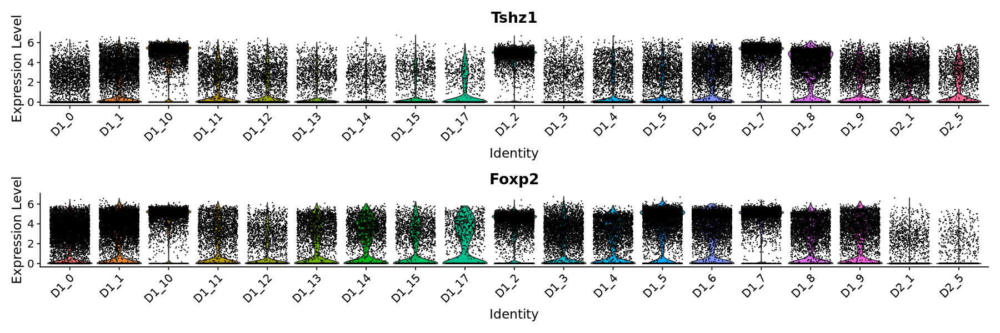

In [570]:
options(repr.plot.height = 5, repr.plot.width = 15)
VlnPlot(tmp, c("Tshz1","Foxp2"),group.by = "clusterLabel",ncol = 1,pt.size = 0.01)

In [535]:
Idents(merFISH.hm.D2) = merFISH.hm.D2@meta.data$clusterLabel
mrks_merged_D2_0_Vs_4 = FindMarkers(merFISH.hm.D2, ident.1 ="D2_1", ident.2="D2_5")

In [536]:
head(mrks_merged_D2_0_Vs_4)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Rgs4,0.000000e+00,1.1258714,0.940,0.777,0.000000e+00
Tshz1,0.000000e+00,-2.4526401,0.137,0.480,0.000000e+00
Nnat,0.000000e+00,-3.5313358,0.084,0.499,0.000000e+00
Ppp3ca,0.000000e+00,0.8090769,0.972,0.852,0.000000e+00
Ddit4l,3.360209e-301,2.6805241,0.509,0.158,8.467727e-299
Gnas,4.624056e-296,-2.2952350,0.096,0.361,1.165262e-293


In [545]:
mrks_merged_D2_0_Vs_4_selected = subset(mrks_merged_D2_0_Vs_4, ((pct.1-pct.2)/pct.1 > 0.3) | ((pct.2-pct.1)/pct.2 > 0.3))
mrks_merged_D2_0_Vs_4_selected = mrks_merged_D2_0_Vs_4_selected[order(mrks_merged_D2_0_Vs_4_selected$avg_log2FC),]

In [546]:
D2_0_Vs_4_markers = rownames(mrks_merged_D2_0_Vs_4_selected)

pdf("mrks_D2_0_Vs_4.pdf",width = 25,height = 8 * ceiling(length(D2_0_Vs_4_markers))/35 )
tmp = merFISH.hm.D2[,Idents(merFISH.hm.D2) %in% c("D2_1","D2_5")]
cols = generateColors(nbCols = length(levels(Idents(tmp))))
names(cols) = levels(Idents(tmp))
plotMarkersHeatmap_v3(
        tmp,
        markers = D2_0_Vs_4_markers,
        clustersColors = cols,
      slotToUse = "data",
        #markerClusters = clus_names,
        #identlevels = clus_lvls,
        clusterCols = FALSE
      )
  dev.off()


  write.csv(mrks_merged_D2_0_Vs_4, file="mrks_D2_0_Vs_4.csv")

png 
  2

## Cluster markers of D2_0 vs D2_9

In [334]:
Idents(merFISH.hm.D2) = merFISH.hm.D2@meta.data$clusterLabel
mrks_merged_D2_0_Vs_9 = FindMarkers(merFISH.hm.D2, ident.1 ="D2_1", ident.2="D2_10")

mrks_merged_D2_0_Vs_9_selected = subset(mrks_merged_D2_0_Vs_9, ((pct.1-pct.2)/pct.1 > 0.3) | ((pct.2-pct.1)/pct.2 > 0.3))
mrks_merged_D2_0_Vs_9_selected = mrks_merged_D2_0_Vs_9_selected[order(mrks_merged_D2_0_Vs_9_selected$avg_log2FC),]


D2_0_Vs_9_markers = rownames(mrks_merged_D2_0_Vs_9_selected)

pdf("mrks_D2_0_Vs_9.pdf",width = 25,height = 8 * ceiling(length(D2_0_Vs_9_markers))/35 )
tmp = merFISH.hm.D2[,Idents(merFISH.hm.D2) %in% c("D2_1","D2_10")]
cols = generateColors(nbCols = length(levels(Idents(tmp))))
names(cols) = levels(Idents(tmp))
plotMarkersHeatmap_v3(
        tmp,
        markers = D2_0_Vs_9_markers,
        clustersColors = cols,
      slotToUse = "data",
        #markerClusters = clus_names,
        #identlevels = clus_lvls,
        clusterCols = FALSE
      )
  dev.off()


  write.csv(mrks_merged_D2_0_Vs_9, file="mrks_D2_0_Vs_9.csv")

png 
  2

## Markers of D1_0+D2_0 vs D1_12+D2_9

In [585]:
new_clusters = rep("others", nrow(merFISH.hm.D1@meta.data))
new_clusters[ merFISH.hm@meta.data$clusterLabel %in% c("D1_1","D2_1") ] = "D1_0_D2_0"
new_clusters[ merFISH.hm@meta.data$clusterLabel %in% c("D1_13","D2_10") ] = "D1_12_D2_9"
Idents(merFISH.hm) = new_clusters
tmp2_sobj = merFISH.hm[, new_clusters != "others"]
tmp2_sobj = ScaleData(tmp2_sobj)

Centering and scaling data matrix



In [586]:
mrks_D1_D2_merged = FindAllMarkers(tmp2_sobj)

Calculating cluster D1_12_D2_9

Calculating cluster D1_0_D2_0



In [587]:
mrks_D1_D2_merged_selected = subset(mrks_D1_D2_merged, (pct.1-pct.2)/pct.1 > 0.2 )
#mrks_D1_D2_merged_selected = mrks_D1_D2_merged_selected[order(mrks_D1_D2_merged_selected$avg_log2FC),]
head(mrks_D1_D2_merged_selected)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
Dlk1,0,4.266310,0.590,0.134,0,D1_12_D2_9,Dlk1
Cpne7,0,4.217609,0.422,0.122,0,D1_12_D2_9,Cpne7
Gnas,0,3.074089,0.512,0.108,0,D1_12_D2_9,Gnas
Fxyd6,0,3.045960,0.509,0.117,0,D1_12_D2_9,Fxyd6
Nnat,0,2.981272,0.820,0.201,0,D1_12_D2_9,Nnat
Oprm1,0,2.904955,0.553,0.140,0,D1_12_D2_9,Oprm1


In [592]:
mrks_D1_D2_merged_selected["Tshz1",]

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
Tshz1.1,8.161822e-127,1.158208,0.477,0.304,2.056779e-124,D1_0_D2_0,Tshz1


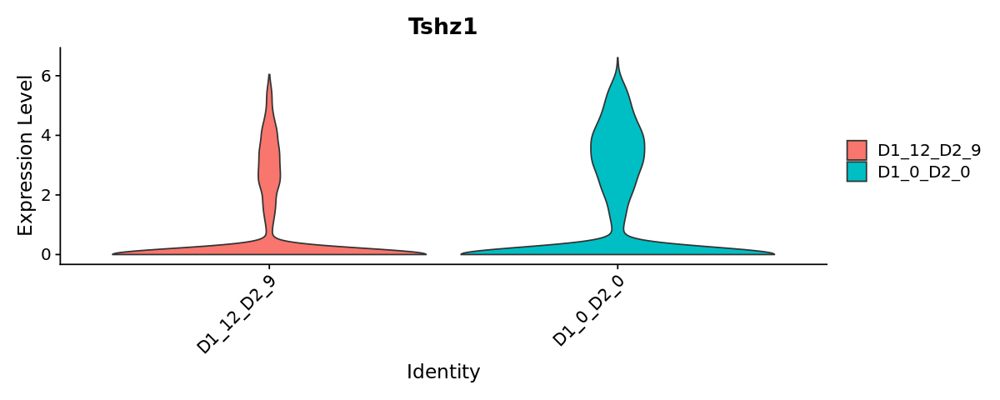

In [591]:
VlnPlot(tmp2_sobj,"Tshz1",pt.size=0)

In [340]:
levels(Idents(merFISH.hm))

[1] "others"     "D1_12_D2_9" "D1_0_D2_0"

In [593]:
D1_D2_merged_selected_genes = mrks_D1_D2_merged_selected$gene

#tmp =  merFISH.hm[,Idents(merFISH.hm) %in% c("D1_12_D2_9","D1_0_D2_0")]

pdf("mrks_D1_0_D2_0_VS_D1_12_D2_9_merged_markers.pdf",width = 25,height = 8 * ceiling(length(D1_D2_merged_selected_genes))/35 )
cols = generateColors(nbCols = length(levels(Idents(tmp2_sobj))))
names(cols) = levels(Idents(tmp2_sobj))
plotMarkersHeatmap_v3(
        tmp2_sobj,
        markers = D1_D2_merged_selected_genes,
        clustersColors = cols,
      slotToUse = "data",
        #markerClusters = clus_names,
        #identlevels = clus_lvls,
        clusterCols = FALSE
      )
  dev.off()

png 
  2

In [594]:
 write.csv(mrks_D1_D2_merged, file="D1_0_D2_0_VS_D1_12_D2_9_DEG.csv")

## D2 BatchC

In [454]:
D2_batchC = subset(D2.hm.integrated.RData, Batch == "C")

ERROR: Error in subset(D2.hm.integrated.RData, Batch == "C"): object 'D2.hm.integrated.RData' not found


Warning message:
“This manual palette can handle a maximum of 7 values. You have supplied 10.”


png 
  2

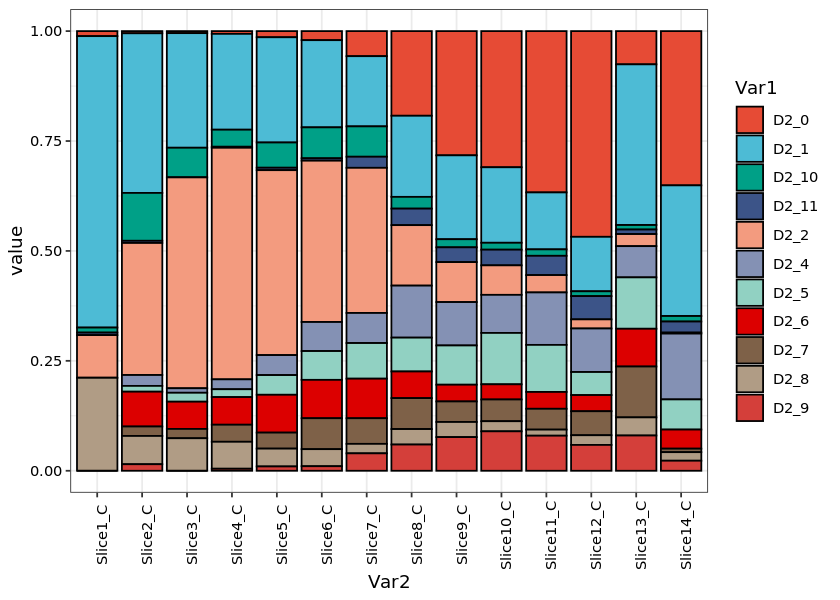

In [456]:
D2_batchC = subset(D2.hm.integrated, Batch == "C")
tbl = as.matrix(table(D2_batchC@meta.data$clusterLabel, D2_batchC@meta.data$StriatumCells))
tbl_norm = apply(tbl,2,function(x) x/sum(x))
tbl_norm_mrg = reshape2::melt(tbl_norm)
                 
options(repr.plot.height = 5, repr.plot.width = 7)
tbl_norm_mrg$Var2 = factor(tbl_norm_mrg$Var2,levels = glue::glue("Slice{1:14}_C"))

p = ggplot(tbl_norm_mrg, aes(x=Var2, y=value, fill=Var1)) + geom_bar(stat = "identity",color="black") + 
                 scale_fill_manual(values = c(ggsci::pal_npg()(10), ggsci::pal_locuszoom()(10) )) +
                 #ggsci::scale_fill_npg() + 
                 theme_bw() +
theme(axis.text = element_text(color="black"),axis.text.x = element_text(angle = 90))
pdf("D2_dist_perSlice_BatchC.pdf",width = 9,height = 5)
print(p)
dev.off()
p

Warning message:
“This manual palette can handle a maximum of 7 values. You have supplied 10.”


png 
  2

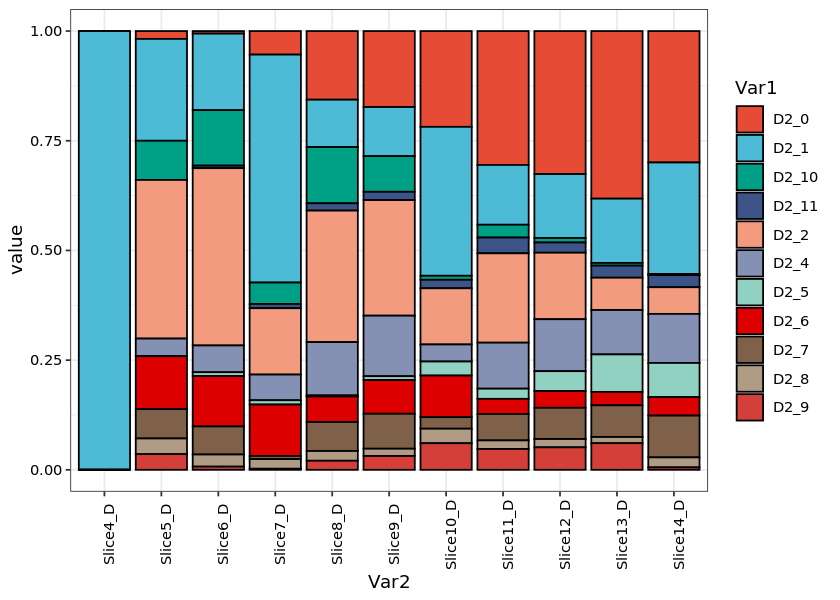

In [457]:
D2_batchD = subset(D2.hm.integrated, Batch == "D")
tbl = as.matrix(table(D2_batchD@meta.data$clusterLabel, D2_batchD@meta.data$StriatumCells))
tbl_norm = apply(tbl,2,function(x) x/sum(x))
tbl_norm_mrg = reshape2::melt(tbl_norm)
                 
options(repr.plot.height = 5, repr.plot.width = 7)
tbl_norm_mrg$Var2 = factor(tbl_norm_mrg$Var2,levels = glue::glue("Slice{1:14}_D"))

p = ggplot(tbl_norm_mrg, aes(x=Var2, y=value, fill=Var1)) + geom_bar(stat = "identity",color="black") + 
                 scale_fill_manual(values = c(ggsci::pal_npg()(10), ggsci::pal_locuszoom()(10) )) +
                 #ggsci::scale_fill_npg() + 
                 theme_bw() +
theme(axis.text = element_text(color="black"),axis.text.x = element_text(angle = 90))
pdf("D2_dist_perSlice_BatchD.pdf",width = 9,height = 5)
print(p)
dev.off()
p

## D2 merged markers

In [506]:
D2_grouped_cluster = rep("",nrow(merFISH.hm.D2@meta.data))
D2_grouped_cluster[ merFISH.hm.D2@meta.data$clusterLabel %in% c("D2_1","D2_5","D2_7","D2_8","D2_11") ] = "D2_0_4_6_7_10"
D2_grouped_cluster[ merFISH.hm.D2@meta.data$clusterLabel %in% c("D2_2") ] = "D2_1"
D2_grouped_cluster[ merFISH.hm.D2@meta.data$clusterLabel %in% c("D2_3","D2_10","D2_6") ] = "D2_2_9_5"
table(D2_grouped_cluster)

D2_grouped_cluster
D2_0_4_6_7_10          D2_1      D2_2_9_5 
        18479          7190         11192 

In [507]:
merFISH.hm.D2@meta.data$merged_D2_clus = D2_grouped_cluster
Idents(merFISH.hm.D2) = merFISH.hm.D2@meta.data$merged_D2_clus
D2_merged_clusters = FindAllMarkers(merFISH.hm.D2)

Calculating cluster D2_0_4_6_7_10

Calculating cluster D2_2_9_5

Calculating cluster D2_1



In [508]:
D2_merged_clusters_selected = subset(D2_merged_clusters, (pct.1-pct.2)/pct.1 > 0.45 )
table(D2_merged_clusters_selected$cluster)


D2_0_4_6_7_10      D2_2_9_5          D2_1 
            8            28             7 

In [509]:
D2_merged_clus_markers = D2_merged_clusters_selected$gene

In [510]:
pdf("D2_merged_clusters_markers.pdf",width = 25,height = 8 * ceiling(length(D2_merged_clus_markers))/35 )
cols = generateColors(nbCols = length(unique(D2_merged_clusters_selected$cluster)))
names(cols) = levels(Idents(merFISH.hm.D2))
plotMarkersHeatmap_v3(
        merFISH.hm.D2,
        markers = D2_merged_clus_markers,
        clustersColors = cols,
      slotToUse = "data",
        #markerClusters = clus_names,
        #identlevels = clus_lvls,
        clusterCols = FALSE
      )
  dev.off()

png 
  2

In [511]:
write.csv(D2_merged_clusters, file="D2_merged_clusters.csv")

In [561]:
save(merFISH.hm.D2, file="merFISH.hm.D2.RData")

## Select MSN specific groups

In [618]:
msn_grouped_cluster = rep("Others",nrow(merFISH.hm@meta.data))
msn_grouped_cluster[ merFISH.hm@meta.data$clusterLabel %in% c("D1_0","D1_3","D1_9","D1_14") ] = "D1_0_3_9_14"
msn_grouped_cluster[ merFISH.hm@meta.data$clusterLabel %in% c("D2_0","D2_4","D2_6","D2_7","D2_10") ] = "D2_0_4_6_7_10"
msn_grouped_cluster[ merFISH.hm@meta.data$clusterLabel %in% c("D1_5","D1_10","D1_11","D1_12","D1_2","D1_7","D1_13") ] = "D1_5_10_11_12_2_7_13"
msn_grouped_cluster[ merFISH.hm@meta.data$clusterLabel %in% c("D1_1","D1_4","D1_6","D1_8") ] = "D1_1_4_6_8"
msn_grouped_cluster[ merFISH.hm@meta.data$clusterLabel %in% c("D2_2","D2_9","D2_5") ] = "D2_2_9_5"
msn_grouped_cluster[ merFISH.hm@meta.data$clusterLabel %in% c("D2_1") ] = "D2_1"
table(msn_grouped_cluster)

msn_grouped_cluster
         D1_0_3_9_14           D1_1_4_6_8 D1_5_10_11_12_2_7_13 
               26254                23364                33306 
       D2_0_4_6_7_10                 D2_1             D2_2_9_5 
               19195                 7515                12001 
              Others 
               68855 

In [619]:
merFISH.hm@meta.data$grouped = msn_grouped_cluster
merFISH.hm.grouped = merFISH.hm[,msn_grouped_cluster != "Others"]
merFISH.hm.grouped

An object of class Seurat 
252 features across 121635 samples within 1 assay 
Active assay: RNA (252 features, 252 variable features)
 3 dimensional reductions calculated: pca, harmony, umap

In [620]:
save(merFISH.hm.grouped, file="merFISH.hm.grouped.RData")

## Plot dynamics of different clusters

In [507]:
merFISH_colors = c('#FFFF00', '#1CE6FF', '#FF34FF', '#FF4A46', '#008941', '#006FA6',
'#A30059', '#FFDBE5', '#7A4900', '#0000A6', '#63FFAC', '#B79762',
'#004D43', '#8FB0FF', '#997D87', '#5A0007', '#809693', '#6A3A4C',
'#1B4400', '#4FC601', '#3B5DFF', '#4A3B53', '#FF2F80', '#61615A',
'#BA0900', '#6B7900', '#00C2A0', '#FFAA92', '#FF90C9', '#B903AA',
'#D16100', '#DDEFFF', '#000035', '#7B4F4B', '#A1C299', '#300018',
'#0AA6D8', '#013349', '#00846F', '#372101', '#FFB500', '#C2FFED',
'#A079BF', '#CC0744', '#C0B9B2', '#C2FF99', '#001E09', '#00489C',
'#6F0062', '#0CBD66')

cluserOrders = c('astrocytes',
				'D1_0', 'D1_1','D1_10','D1_11', 'D1_12', 'D1_13', 'D1_14', 'D1_15', 'D1_17',
				'D1_2', 'D1_3', 'D1_4', 'D1_5', 'D1_6', 'D1_7', 'D1_8','D1_9',
				'D2_0','D2_1',  'D2_10', 'D2_11','D2_2', 'D2_4', 'D2_5', 'D2_6', 'D2_7', 'D2_8', 'D2_9',
				"Endothelial","Ependymal",
				'IN_0','IN_1','IN_10','IN_11','IN_12','IN_13','IN_14','IN_15','IN_16',
				'IN_2','IN_3','IN_4','IN_5','IN_6','IN_8','IN_9',
				'microglia', 'oligodendrocytes','OPCs')
names(merFISH_colors)= cluserOrders

In [520]:
merFISH_colors[c("D1_5","D1_10","D1_11","D1_12","D1_13")]

D1_5     D1_10     D1_11     D1_12     D1_13 
"#8FB0FF" "#FF4A46" "#008941" "#006FA6" "#A30059"

,Var1,Var2,value
,<int>,<fct>,<dbl>
1,1,D1_1,0.2474699
2,2,D1_1,0.5228437
3,3,D1_1,0.8974716
4,4,D1_1,1.0144900
5,5,D1_1,3.1091030
6,6,D1_1,3.9293147


`geom_smooth()` using method = 'loess' and formula 'y ~ x'



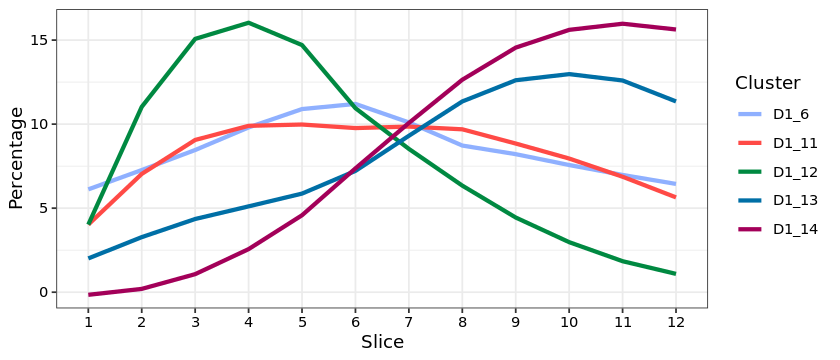

In [544]:
tbl = table(merFISH.hm.D1_filtered$clusterLabel, merFISH.hm.D1_filtered$sliceNumber)
tbl = tbl %>% as.matrix()
tbl = apply(tbl,2,function(x) 100 * x/sum(x))
tbl = apply(tbl,1,function(x) 100 * x/sum(x))
#tbl[glue::glue("D1_{c(9,2,8,12,6,11,5,15,10,13,1,3,7,14,4)}"),]
tbl_mlt = reshape2::melt(tbl)   
colnames(tbl_mlt) = c("Slice","Cluster","Percentage")  
tbl_mlt = subset(tbl_mlt, Cluster %in% c("D1_6","D1_11","D1_12","D1_13","D1_14"))  
tbl_mlt$CellType = gsub("_\\d+","",tbl_mlt$Cluster)
tbl_mlt$Cluster = factor(tbl_mlt$Cluster, levels=  c("D1_6","D1_11","D1_12","D1_13","D1_14"))            
tbl_mlt$Slice = factor(tbl_mlt$Slice,levels = 1:12 )

options(repr.plot.height = 3, repr.plot.width = 7)    
p=ggplot(tbl_mlt, aes(x=Slice, y=Percentage, color=Cluster, group=Cluster)) + 
                geom_smooth(size=1.2,se = FALSE,span=0.9) + 
                scale_color_manual(values =as.character(merFISH_colors[c("D1_5","D1_10","D1_11","D1_12","D1_13")]) ) +
                 #ggsci::scale_fill_npg() + 
                 theme_bw() +
                theme(axis.text = element_text(color="black"))
p

In [545]:
pdf("Fig6C_D1.pdf",width = 7,height = 3)
print(p)
dev.off()

`geom_smooth()` using method = 'loess' and formula 'y ~ x'



png 
  2

`geom_smooth()` using method = 'loess' and formula 'y ~ x'



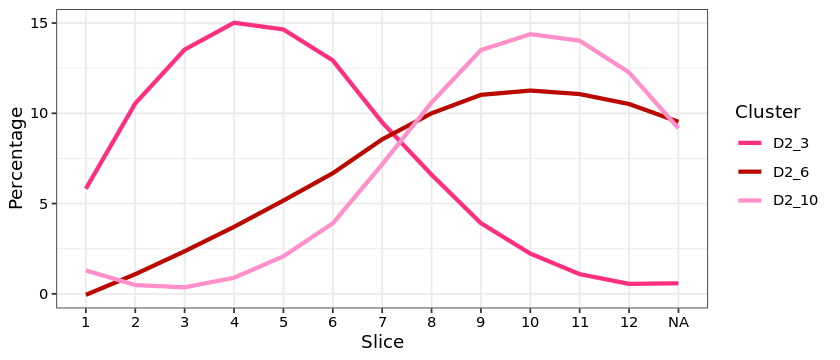

In [547]:
tbl = table(merFISH.hm.D2_filtered$clusterLabel, merFISH.hm.D2_filtered$sliceNumber)
tbl = tbl %>% as.matrix()
tbl = apply(tbl,2,function(x) 100 * x/sum(x))
tbl = apply(tbl,1,function(x) 100 * x/sum(x))
#tbl[glue::glue("D1_{c(9,2,8,12,6,11,5,15,10,13,1,3,7,14,4)}"),]
tbl_mlt = reshape2::melt(tbl)   
colnames(tbl_mlt) = c("Slice","Cluster","Percentage")  
tbl_mlt = subset(tbl_mlt, Cluster %in% c("D2_3","D2_6","D2_10"))  
tbl_mlt$CellType = gsub("_\\d+","",tbl_mlt$Cluster)
tbl_mlt$Cluster = factor(tbl_mlt$Cluster, levels=  c("D2_3","D2_6","D2_10"))            
tbl_mlt$Slice = factor(tbl_mlt$Slice,levels = 1:12 )

options(repr.plot.height = 3, repr.plot.width = 7)    
p2= ggplot(tbl_mlt, aes(x=Slice, y=Percentage, color=Cluster, group=Cluster)) + 
                geom_smooth(size=1.2,se = FALSE,span=0.9) + 
                scale_color_manual(values =as.character(merFISH_colors[c("D2_2","D2_5","D2_9")]) ) +
                 #ggsci::scale_fill_npg() + 
                 theme_bw() +
                theme(axis.text = element_text(color="black"))
p2            

In [548]:
pdf("Fig6C_D2.pdf",width = 7,height = 3)
print(p2)
dev.off()

`geom_smooth()` using method = 'loess' and formula 'y ~ x'



png 
  2

## Fig.6G

In [595]:
selected_mrks = c("Pde1a","Scn4b","Rgs9","Dlk1","Htr2c","Cacna1i","Ppp3ca","Adora2a","Calcr")

In [623]:
Fig6G_sobj = merFISH.hm[,merFISH.hm@meta.data$clusterLabel %in% c("D1_1","D1_13","D2_1","D2_10")]
Fig6G_sobj = ScaleData(Fig6G_sobj)

Centering and scaling data matrix



In [ ]:
Fig6G_sobj@assays$RNA@

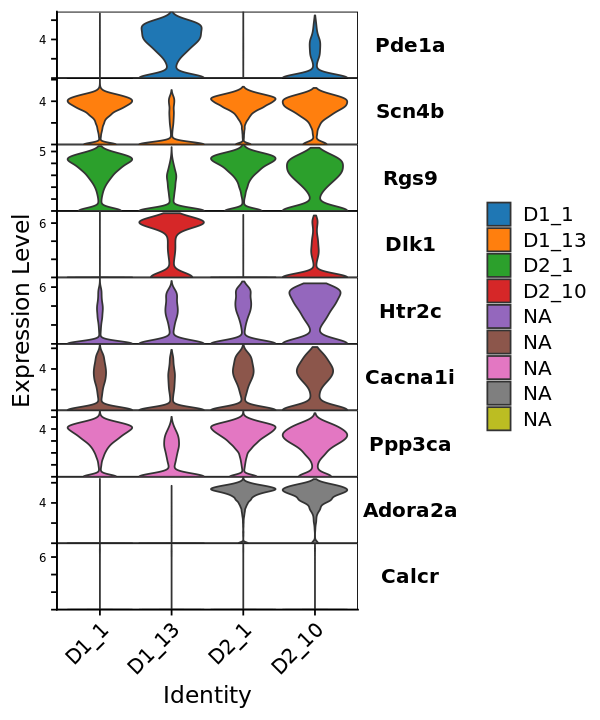

In [646]:
options(repr.plot.height = 6, repr.plot.width = 5)
Idents(Fig6G_sobj) = factor(Fig6G_sobj@meta.data$clusterLabel,levels=c("D1_1","D1_13","D2_1","D2_10"))
#VlnPlot(Fig6G_sobj,features = selected_mrks,cols = as.character(merFISH_colors[c("D1_0","D1_12","D2_0","D2_9")]),pt.size=0,group.by = "clusterLabel",stack =TRUE)
VlnPlot(Fig6G_sobj,features = selected_mrks,cols = ggsci::pal_d3()(10),pt.size=0.1,stack =TRUE,flip = T, adjust=1.1) 

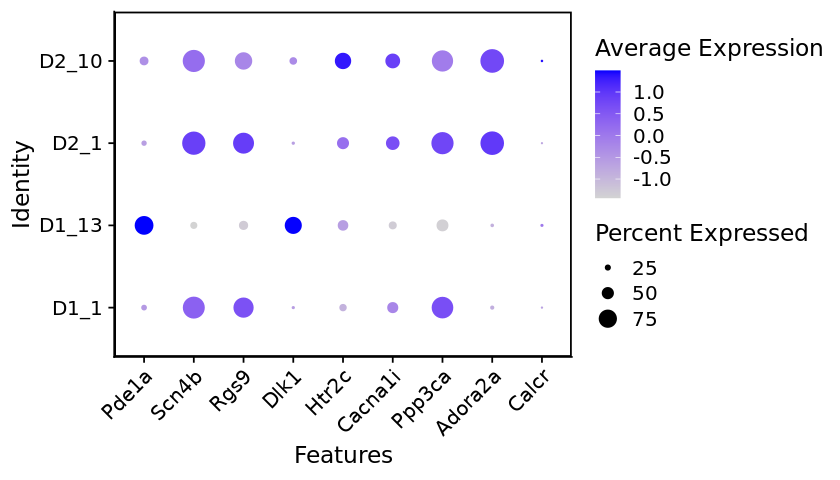

In [651]:
options(repr.plot.height = 4, repr.plot.width = 7)
DotPlot(Fig6G_sobj, features = selected_mrks,) + RotatedAxis() + cowplot::panel_border(color = "black")

In [639]:
pdf("Fig6G_violin.pdf",width=5,height = 6)
plot(VlnPlot(Fig6G_sobj,features = selected_mrks,cols = ggsci::pal_d3()(10),pt.size=0.1,stack =TRUE,flip = T,slot="scale.data") )
dev.off()

png 
  2

## Additional plots

In [677]:
table(merFISH.hm.D1_filtered$Batch)


    C     D 
40427 25651 

In [678]:
merFISH.hm.D1_BatchC_filtered = merFISH.hm.D1_filtered[,merFISH.hm.D1_filtered$Batch == "C"]
merFISH.hm.D1_BatchC_filtered

An object of class Seurat 
252 features across 40427 samples within 1 assay 
Active assay: RNA (252 features, 251 variable features)
 3 dimensional reductions calculated: pca, harmony, umap

In [659]:
newClus = as.character(merFISH.hm.D1_filtered@meta.data$clusterLabel)
newClus[!newClus %in% c("D1_3","D1_8","D1_11")] ="Other D1"
Idents(merFISH.hm.D1_filtered) = newClus#factor(newClus, levels = c("D1_3","D1_8","D1_11","Other D1")

In [660]:
grou1_expr = AverageExpression(merFISH.hm.D1_filtered)

Finished averaging RNA for cluster Other D1

Finished averaging RNA for cluster D1_8

Finished averaging RNA for cluster D1_3

Finished averaging RNA for cluster D1_11



In [676]:
grou1_expr$RNA[c("Tshz1","Foxp2","Foxp1","Isl1"),]

,Other D1,D1_8,D1_3,D1_11
,<dbl>,<dbl>,<dbl>,<dbl>
Tshz1,22.38646,186.647388,136.303610,181.874912
Foxp2,45.44372,155.774773,92.581069,157.842009
Foxp1,41.53633,4.107248,1.362527,6.646245
Isl1,81.89070,6.114488,4.179772,6.113697


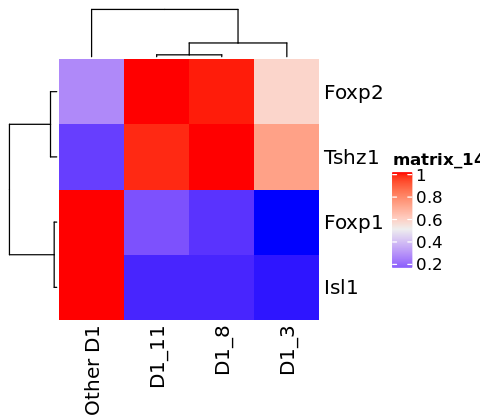

In [668]:
options(repr.plot.height = 3.5, repr.plot.width = 4)
tmp = apply(grou1_expr$RNA[c("Tshz1","Foxp2","Foxp1","Isl1"),],1,function(x) x/max(x)) %>% t()
Heatmap(tmp )

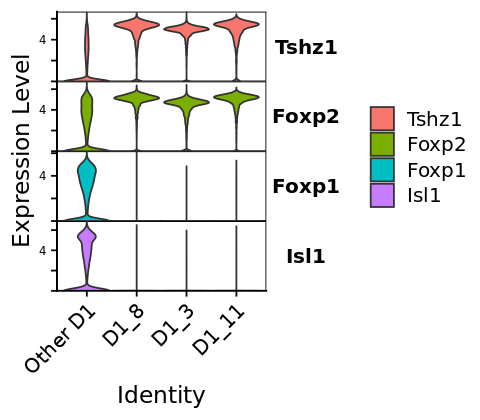

In [671]:
VlnPlot(merFISH.hm.D1_filtered, features = c("Tshz1","Foxp2","Foxp1","Isl1"),stack = T,flip = T)

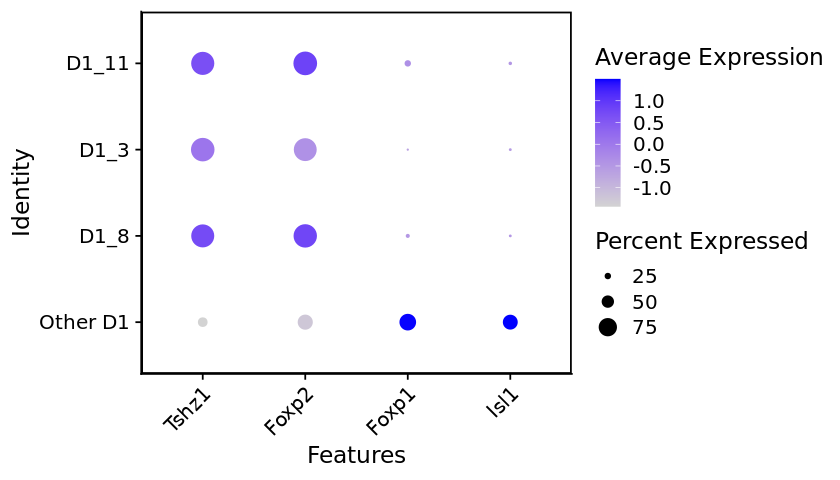

In [675]:
options(repr.plot.height = 4, repr.plot.width = 7)
DotPlot(merFISH.hm.D1_filtered, features = c("Tshz1","Foxp2","Foxp1","Isl1"),scale.by = 'radius') + RotatedAxis() + cowplot::panel_border(color = "black")

In [720]:
save.image("12192020_image.RData")

## Load MSN samples

In [131]:
load("NAc_MSN_sobj.RData")

In [132]:
NAc_MSN_sobj = UpdateSeuratObject(NAc_MSN_sobj)

Updating from v2.X to v3.X

Validating object structure

Updating object slots

Ensuring keys are in the proper strucutre

Ensuring feature names don't have underscores or pipes

Object representation is consistent with the most current Seurat version



In [139]:
table(D1_scRNASeq.hm@meta.data$NN)


AMBIGIOUS      D1_1      D1_2      D1_3      D1_4      D1_5      D1_6      D1_7 
     3082      1799       715       924       637       223       767       418 
     D1_8      D1_9     D1_10     D1_11     D1_12     D1_13     D1_14     D1_15 
      925       148       190       711       466       609       588       140 

In [146]:
table(D2_scRNASeq.hm@meta.data$NN)


AMBIGIOUS      D2_1      D2_2      D2_3      D2_4      D2_5      D2_6      D2_7 
     1649      1907       785      1898         0       294       223       381 
     D2_8      D2_9     D2_10     D2_11 
       56         0       434        60 

In [151]:
NAc_MSN_sobj@meta.data$MERFISH_cluster = "OTHER"

In [143]:
all(colnames(D1_scRNASeq.hm) %in% colnames(NAc_MSN_sobj))

[1] TRUE

In [147]:
all(colnames(D2_scRNASeq.hm) %in% colnames(NAc_MSN_sobj))

[1] TRUE

In [152]:
pos1 = match(colnames(D1_scRNASeq.hm), colnames(NAc_MSN_sobj))
NAc_MSN_sobj@meta.data$MERFISH_cluster[pos1] = as.character(D1_scRNASeq.hm@meta.data$NN)

In [153]:
pos2 = match(colnames(D2_scRNASeq.hm), colnames(NAc_MSN_sobj))
NAc_MSN_sobj@meta.data$MERFISH_cluster[pos2] = as.character(D2_scRNASeq.hm@meta.data$NN)

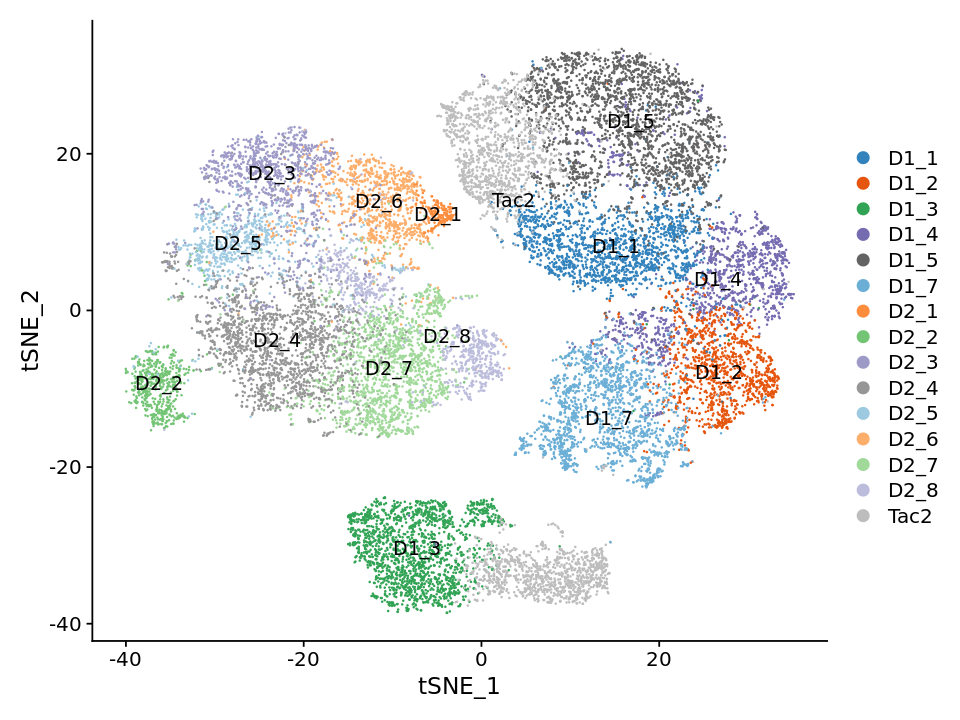

In [136]:
DimPlot(NAc_MSN_sobj,cols = ggsci::pal_d3("category20c")(20),label = T)

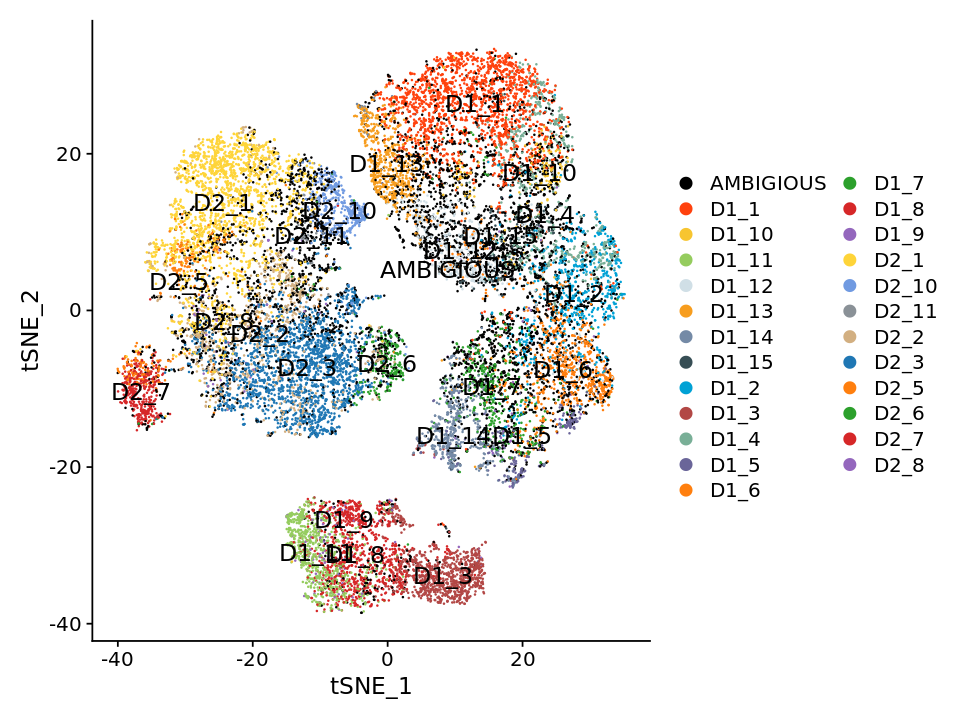

In [159]:
cols = c("black", ggsci::pal_tron()(7)[-2], ggsci::pal_jama()(6)[-2], ggsci::pal_d3()(5)[-1], ggsci::pal_simpsons()(4), ggsci::pal_d3()(10),"brown", ggsci::pal_simpsons()(10))
DimPlot(NAc_MSN_sobj,label = T,group.by = "MERFISH_cluster",cols = cols, label.size = 5)

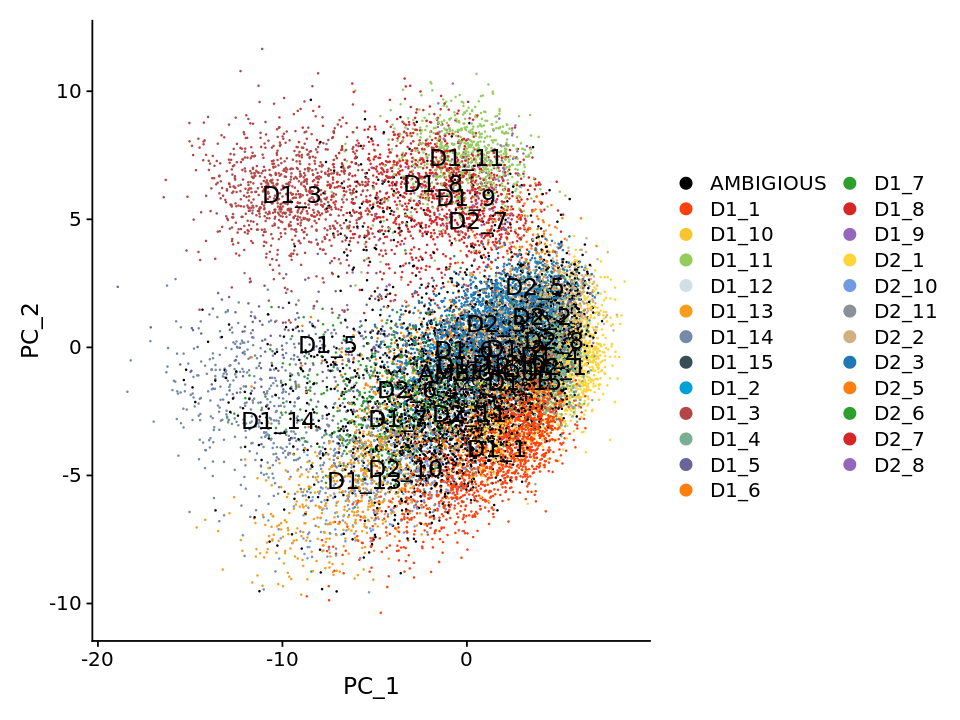

In [166]:
cols = c("black", ggsci::pal_tron()(7)[-2], ggsci::pal_jama()(6)[-2], ggsci::pal_d3()(5)[-1], ggsci::pal_simpsons()(4), ggsci::pal_d3()(10),"brown", ggsci::pal_simpsons()(10))
NAc_MSN_sobj =
DimPlot(NAc_MSN_sobj,label = T,group.by = "MERFISH_cluster",cols = cols, label.size = 5,reduction = "pca")

In [170]:
cols

[1] "black"     "#FF410DFF" "#F7C530FF" "#95CC5EFF" "#D0DFE6FF" "#F79D1EFF"
 [7] "#748AA6FF" "#374E55FF" "#00A1D5FF" "#B24745FF" "#79AF97FF" "#6A6599FF"
[13] "#FF7F0EFF" "#2CA02CFF" "#D62728FF" "#9467BDFF" "#FED439FF" "#709AE1FF"
[19] "#8A9197FF" "#D2AF81FF" "#1F77B4FF" "#FF7F0EFF" "#2CA02CFF" "#D62728FF"
[25] "#9467BDFF" "#8C564BFF" "#E377C2FF" "#7F7F7FFF" "#BCBD22FF" "#17BECFFF"
[31] "brown"     "#FED439FF" "#709AE1FF" "#8A9197FF" "#D2AF81FF" "#FD7446FF"
[37] "#D5E4A2FF" "#197EC0FF" "#F05C3BFF" "#46732EFF" "#71D0F5FF"

In [160]:
save(NAc_MSN_sobj,file="NAc_MSN_plus_merfish.sobj")

In [167]:
NAc_MSN_sobj = RunPCA(NAc_MSN_sobj)

PC_ 1 
Positive:  Gng2, Pde1a, Fxyd6, Vsnl1, Hpcal1, AW551984, Tubb2b, Resp18, Eef1a1, Stmn1 
	   Ngb, Nap1l5, Cpne7, Gpr150, Sphkap, Atp2b4, Elavl4, Tagln3, Wdr6, Nfix 
	   Tac2, Ahi1, Tox2, Camk2d, Tubb2a, Olfm1, Baiap3, Peg10, Rwdd2a, Sez6l 
Negative:  Rasgrp2, Arpp19, Hpca, Ppp1r1b, Rgs9, Ppp3ca, Pcp4l1, Tpm1, Foxp1, Scn4b 
	   Pde10a, Atp2b1, Pcsk2, Camk4, Sepw1, Adora2a, Ppp1ca, Fabp5, Gpr6, Snca 
	   Dmkn, Ptn, Ntm, Drd2, Chchd10, Camk2n1, Gnb5, Gucy1a3, Hist1h2bc, Ndrg4 
PC_ 2 
Positive:  Wfs1, Calb1, Dlk1, Ramp3, Crym, Pea15a, Arl4a, Foxp1, Isl1, 6330527O06Rik 
	   Igfbp4, Etv1, Ncdn, Rgs2, Itm2a, Fth1, Ebf1, Chga, Mrap2, Camk4 
	   Kctd4, Zcwpw1, Spink8, Gpr150, Peg10, Arhgap36, Gabrg1, Htr2c, March1, Arhgdib 
Negative:  Rab3b, Tshz1, Stmn1, Mt1, Lrpprc, Ivns1abp, Foxp2, Edn1, Elavl4, Rxrg 
	   Nfix, Casz1, Mfge8, Ntm, Vwc2l, S100a16, Rbp1, Tekt5, Pcdh15, Pcdh8 
	   Otof, Mdfic, 4930452B06Rik, Gabra3, Cacng5, As3mt, Ccdc109b, Ralyl, Nptx1, Sphkap 
PC_ 3 
Positive:  Adora2a, D

In [169]:
NAc_MSN_sobj@reductions$pca

PC_ 1 
Positive:  Gng2, Pde1a, Fxyd6, Vsnl1, Hpcal1, AW551984, Tubb2b, Resp18, Eef1a1, Stmn1 
	   Ngb, Nap1l5, Cpne7, Gpr150, Sphkap, Atp2b4, Elavl4, Tagln3, Wdr6, Nfix 
Negative:  Rasgrp2, Arpp19, Hpca, Ppp1r1b, Rgs9, Ppp3ca, Pcp4l1, Tpm1, Foxp1, Scn4b 
	   Pde10a, Atp2b1, Pcsk2, Camk4, Sepw1, Adora2a, Ppp1ca, Fabp5, Gpr6, Snca 
PC_ 2 
Positive:  Wfs1, Calb1, Dlk1, Ramp3, Crym, Pea15a, Arl4a, Foxp1, Isl1, 6330527O06Rik 
	   Igfbp4, Etv1, Ncdn, Rgs2, Itm2a, Fth1, Ebf1, Chga, Mrap2, Camk4 
Negative:  Rab3b, Tshz1, Stmn1, Mt1, Lrpprc, Ivns1abp, Foxp2, Edn1, Elavl4, Rxrg 
	   Nfix, Casz1, Mfge8, Ntm, Vwc2l, S100a16, Rbp1, Tekt5, Pcdh15, Pcdh8 
PC_ 3 
Positive:  Adora2a, Drd2, Gpr6, Upb1, Gucy1a3, Adk, Gnas, Nnat, Cartpt, Grik3 
	   March1, Htr2c, Stard5, Nts, Ddc, Unc5d, Cbln4, Trhr, Zbtb20, Mgat4c 
Negative:  Tac1, Drd1a, Accn4, Nrxn1, Pdyn, Foxp2, Stmn2, Fxyd7, Isl1, Gnb4 
	   Slc35d3, Rgs4, Lingo2, Sfxn1, Rab3b, Cdh13, Ebf1, Mdk, Gpr83, Oprk1 
PC_ 4 
Positive:  Nrgn, Kctd4, Ctsz, Tmeff

## Add the Entrez gene summary to the description of the marker genes 

In [ ]:
Merfish_D1)M